# _Pads Paper Codebase_
#### Bradley A. Gay, PhD | Jet Propulsion Laboratory, California Institute of Technology
#### Date: 08/20/2023 (Updated: 27 Sep 2024)
Companion codebase to supplement manuscript and supporting information:
</br>
> Miner, K., et al. (2024). _Frozen no more: Permafrost impacts of oil and gas withdrawal above the Arctic Circle_, Scientific Reports. Under Review.

### Libraries and Functions

In [1]:
#!pip install dataframe_image
#import dataframe_image as dfi
import pandas as pd
import numpy as np
import xarray as xr
from scipy.stats import pearsonr,spearmanr
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.cluster.hierarchy import cut_tree
from sklearn import preprocessing
from sklearn.linear_model import LassoCV, RidgeCV, LinearRegression, ElasticNetCV
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.metrics import mean_squared_error
import statsmodels
from statsmodels.regression.linear_model import OLS
from statsmodels.stats.diagnostic import het_breuschpagan
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
import matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import radviz
from pandas.plotting import bootstrap_plot
from pandas.plotting import autocorrelation_plot
from pandas.plotting import andrews_curves
from statsmodels.tsa.stattools import grangercausalitytests
from astropy.table import Table
from IPython.display import display,HTML
import pandas.compat
from io import StringIO
import os
import sys
import datetime
from datetime import timedelta, datetime as dt
import re
import glob
import requests
import warnings
import bs4
import eofs
import pyts
import pyarrow
import numpy as np
import pandas as pd
import pickle
import math
import time
import cftime
import xbatcher
import sklearn
import tensorflow as tf
from tensorflow import keras
from keras import backend as K, optimizers, layers, models
from keras.layers import Dense, InputLayer, Dropout, Flatten, BatchNormalization, Conv1D, Bidirectional, MaxPool1D, Reshape
import keras_tuner
from keras_tuner import HyperModel
from keras_tuner.tuners import RandomSearch, BayesianOptimization, Hyperband
import statsmodels
from statsmodels.tsa.arima.model import ARIMA
import pyrsgis
from pyrsgis import ml, raster, convert
import torch
from torch.utils.data import DataLoader, Dataset, DFIterDataPipe
import torch.autograd as autograd
from torch import Tensor
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import DataParallel
import torch.optim as optim
from torch.jit import script, trace
from torchvision import datasets, models, transforms
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import io
from itertools import groupby, islice
from operator import itemgetter
from pathlib import Path
import geopandas as gpd
import rioxarray as rxr
import spectral
import earthpy as et
#import xesmf as xe
import xarray as xr
from libpysal.weights import lat2W
from esda.moran import Moran
import pydot
import pydotplus
import graphviz
import rasterio
from rasterio.enums import Resampling
import netCDF4 as nc
from netCDF4 import Dataset
import tiledb
import h5py
from shapely import geometry
from rasterio.mask import mask
import zipfile
import getpass
from osgeo import gdal 
import codecs
import netrc
from rasterio.plot import show, show_hist
import intake
from dateutil.rrule import DAILY, rrule
from dask.diagnostics import ProgressBar
from skimage import data, io
from skimage.color import rgb2gray
import pystac
from tqdm import tqdm
import pytest
import geopandas as gpd
from functools import partial
import datashader
from importlib.metadata import version as imp_version
# Geospatial libraries
import pystac
import planetary_computer
import requests
import pystac
import folium
import shapely.geometry
from IPython.display import Image
import rioxarray
from statsmodels.tsa.stattools import grangercausalitytests, adfuller
from sklearn.preprocessing import MinMaxScaler

from scipy.stats import norm
import itertools
import scipy.stats as stats
from scipy.stats import pearsonr, spearmanr
import csv

# Deep Learning libraries
import torch
import geopandas as gpd
import matplotlib.dates as mdates
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from numpy import vstack
from pandas import read_csv
from sklearn.metrics import accuracy_score
from torch.utils.data import Dataset, DataLoader, random_split, Subset, TensorDataset
from torch.utils.data import random_split
from torch import Tensor
import torch.nn.functional as F
from torch.autograd import Variable

import lightning.pytorch as pl
from lightning.pytorch.loggers import TensorBoardLogger
from lightning.pytorch.callbacks import EarlyStopping, LearningRateMonitor
from lightning.pytorch.tuner import Tuner
import pytorch_lightning
#from pytorch_forecasting import TimeSeriesDataSet, TemporalFusionTransformer, QuantileLoss

import keras
import tensorflow as tf
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Masking, Embedding
from tensorflow.keras import layers, models
from keras import backend as K 
from keras.layers import LSTM, Bidirectional, RepeatVector, TimeDistributed, Dense, Flatten, ConvLSTM1D, MaxPooling2D, \
Conv1DTranspose, Conv2DTranspose, Conv2D, MaxPooling1D, ConvLSTM2D
from keras.models import Sequential
import keras_tuner
from keras_tuner import HyperModel, RandomSearch 
from keras_tuner.engine.hyperparameters import HyperParameters
from keras_tuner.tuners import *
from keras.layers import Embedding
from keras_tuner import HyperParameters as hp
from keras_tuner import Hyperband, HyperModel, BayesianOptimization
from keras.layers import Conv3D, MaxPooling3D, ConvLSTM3D, Conv3DTranspose, LeakyReLU, UpSampling1D, UpSampling2D, UpSampling3D

import cartopy.crs as ccrs
import matplotlib as mpl
import matplotlib.pyplot as plt
import xarray as xr
import matplotlib.ticker as ticker

import dataframe_image as dfi

import xcdat

%config InlineBackend.figure_format='retina'

def fmt(x, pos):
    a, b = '{:.2e}'.format(x).split('e')
    b = int(b)
    return r'${} \times 10^{{{}}}$'.format(a, b)
    
import xcdat as xc

#!python -m pip install basemap
from mpl_toolkits.basemap import Basemap


### FUNCTIONS ###
################################################################################################

import math
def divisorGenerator(n):
    large_divisors = []
    for i in range(1, int(math.sqrt(n) + 1)):
        if n % i == 0:
            yield i
            if i*i != n:
                large_divisors.append(n / i)
    for divisor in reversed(large_divisors):
        yield divisor

def series_to_supervised(data, lags = 1, forecasting_steps = 1, dropna=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    for i in range(lags, 0, -1):
        cols.append(df.shift(i))
        names += [(df.columns[j], str('t-%d') %  i) for j in range(n_vars)]
    for a in range(0, forecasting_steps):
        cols.append(df.shift(-a))
        if a == 0:
            names += [(df.columns[b], str('t')) for b in range(n_vars)]
        else:
            names += [(df.columns[b], str('t+%d') %  a) for b in range(n_vars)]
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    agg = agg.loc[:,~agg.columns.duplicated()]
    if dropna:
        agg.dropna(inplace=True)
    return agg

def convert360_180(ds):
    """
    convert longitude from 0-360 to -180 -- 180 deg
    """
    # check if already 
    attrs = ds['longitude'].attrs
    if ds['longitude'].min() >= 0:
        with xr.set_options(keep_attrs=True): 
            ds.coords['longitude'] = (ds['longitude'] + 180) % 360 - 180
        ds = ds.sortby('longitude')
    return ds

def computeHCF(x, y):
    if x > y:
        smaller = y
    else:
        smaller = x
    for i in range(1, smaller+1):
        if((x % i == 0) and (y % i == 0)):
            
            hcf = i
    return hcf

def compute_vif(features):
    X = features.iloc[:,:]
    X['intercept'] = 1
    vif = pd.DataFrame()
    vif["Variable"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    vif = vif[vif['Variable']!='intercept']
    return vif

def show_boxplot_data(df):
    plt.subplots(1,1,figsize=(10,6))
    sns.boxplot(data = df, orient="v")
    plt.title("Outliers Distribution, Scaled Data", fontsize = 16)
    plt.ylabel("Range")
    plt.xlabel("Attributes")
    plt.tight_layout()
    plt.savefig('boxplot_outliers_dfsc_scaleddata.png',dpi=1000)

def show_boxplot_abiotics(df):
    plt.subplots(1,1,figsize=(10,6))
    sns.boxplot(data = df, orient="v")
    plt.title("Outliers Distribution, Scaled Abiotics", fontsize = 16)
    plt.ylabel("Range")
    plt.xlabel("Attributes")
    plt.tight_layout()
    plt.savefig('boxplot_outliers_dfsc_scaledabiotics.png',dpi=1000)

def remove_outliers(data):
    df = data.copy()
    for col in list(df.columns):
        Q1 = df[str(col)].quantile(0.05)
        Q3 = df[str(col)].quantile(0.95)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5*IQR
        upper_bound = Q3 + 1.5*IQR
        df = df[(df[str(col)] >= lower_bound) & (df[str(col)] <= upper_bound)]
    return df

print("Tensorflow:", tf.version.VERSION)
print("Xarray:", xr.__version__)
print("netCDF4:", nc.__version__)
print("PyTorch:", torch.__version__)

Tensorflow: 2.16.1
Xarray: 2024.6.0
netCDF4: 1.6.0
PyTorch: 2.0.0


### Data Wrangling

#### Pre-processing

In [2]:
# Read-in field data (.csv)
data=pd.read_csv('/Users/bgay/Library/CloudStorage/OneDrive-JPL/pads/pads_data.csv')
data2=pd.read_csv('/Users/bgay/Library/CloudStorage/OneDrive-JPL/pads/pads_abiotics.csv')
df=pd.DataFrame(data)
df2=pd.DataFrame(data2)

In [ ]:
# Display dataframes
display(df)

In [ ]:
df.info()

In [ ]:
# Display dataframes
display(df2)

In [ ]:
df2.info()

In [ ]:
#display(df.set_index(['Site']))#.iloc[:,:-1])

In [ ]:
#(df2.set_index(['Site','Date Time']).iloc[:,:-1]).to_html('temp.html',justify='center',index_names=True)

In [ ]:
#display(df2.set_index(['Site','Date Time']).iloc[:,:-1])

In [ ]:
# display(HTML(df2.to_html('pads_abiotics.png')))

In [ ]:
# x = cos(lat) * cos(lon)
# y = cos(lat) * sin(lon), 
# z = sin(lat) 

In [3]:
df=df.sort_values(['Longitude','Latitude'],ascending=False).set_index(['Site'])

In [4]:
df2['Site']=np.array(['PB1', 'PB1', 'PB1','DH1', 'DH1', 'DH1', 'DH1', 'DH1', 'DH1','DH2', 'DH2','DH2', 'DH2', 'DH2', 'DH2', 'DH2', 'DH2','DH3', 'DH3', 'DH3', 'DH3', 'DH3'])
#df2

In [5]:
df2=pd.concat([df2.sort_values(['Date Time'],ascending=False).set_index(['Site']).iloc[8:].sort_values(['Date Time'],ascending=True),
           df2.sort_values(['Date Time'],ascending=False).set_index(['Site']).iloc[:8].sort_values(['Date Time'],ascending=False)])

In [ ]:
#data
df

In [ ]:
#display(HTML(df3.reset_index().set_index(['Latitude','Longitude','Site']).to_html()))
dfi.export(df.reset_index().set_index(['Site','Latitude','Longitude']), "data.png", table_conversion="matplotlib")

In [ ]:
#Abiotics
df2

In [ ]:
#display(HTML(df4.reset_index().set_index(['Site','Date Time']).iloc[:,:-1].to_html()))
dfi.export(df2.reset_index().set_index(['Site','Date Time']).iloc[:,:-1], "abiotics.png", table_conversion="matplotlib")

In [ ]:
# df['Distance from Pad (m)']=df['Distance from Pad (m)'].astype('float64')
# df['Depth (cm)']=df['Depth (cm)'].astype('float64')
# df.Site=np.array([0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,3,3,3,3,3,3,3,3,3])
# df.Site[:5] #[0,0,0,0,0]
# df.Site[5:16] #[1,1,1,1,1,1,1,1,1,1,1]
# df.Site[16:31] #[2,2,2,2,2,2,2,2,2,2,2,2,2,2,2]
# df.Site[31:] #[3,3,3,3,3,3,3,3,3]

In [ ]:
#All Sites
#sns.heatmap(df.corr().iloc[3:,3:],cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#PB1 Site
#sns.heatmap(df[0:5].corr().iloc[3:,3:],cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#DH1 Site
#sns.heatmap(df[5:16].corr().iloc[3:,3:],cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#DH2 Site
#sns.heatmap(df[16:31].corr().iloc[3:,3:],cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#DH3 Site
#sns.heatmap(df[31:].corr().iloc[3:,3:],cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#df2=pd.concat([df2.sort_index()[-3:],df2.sort_index()[:-3]])

In [ ]:
df

In [ ]:
df.count()

In [6]:
d={'PB1':0, 'DH1':1, 'DH2':2, 'DH3':3}
k = np.array(list(d.keys()))
v = np.array(list(d.values()))

out = np.zeros_like(df.reset_index().Site)
for key,val in zip(k,v):
    out[df.reset_index().Site==key] = val

df=df.reset_index()
df.Site=out
df=df.set_index('Site')
#df

In [ ]:
df.count()

In [ ]:
df2

In [ ]:
df2.count()

In [7]:
d={'PB1':0, 'DH1':1, 'DH2':2, 'DH3':3}
k = np.array(list(d.keys()))
v = np.array(list(d.values()))

out = np.zeros_like(df2.reset_index().Site)
for key,val in zip(k,v):
    out[df2.reset_index().Site==key] = val

df2=df2.reset_index()
df2.Site=out
df2=df2.set_index('Site')
#df2

In [ ]:
df2.count()

In [8]:
df=df.sort_index()
df2=df2.sort_index()

In [9]:
df=df.reset_index()
df.columns=['loc','lon','lat','dis','dep','sot','som','sph']
df=df.set_index('loc')
#df

In [ ]:
df2

In [10]:
df2=df2.reset_index()
df2.columns=['loc','dat','tem','wet','rh','bp','alt','stp','wsp','hin','dew','dal','wch','dt']
df2=df2.set_index('loc')
#df2

In [11]:
d={'point':0}
k = np.array(list(d.keys()))
v = np.array(list(d.values()))

out = np.zeros_like(df2.reset_index().dt)
for key,val in zip(k,v):
    out[df2.reset_index().dt==key] = val

df2=df2.reset_index()
df2.dt=out
df2=df2.set_index('loc')
#df2

In [12]:
ls=[]
for i in range(len(df2.dat)):
    ls=np.append(ls,float(df2.reset_index().dat[i].replace('/', '').replace(':', '').replace(' ','')))
df2.dat=np.array(ls)
#df2

In [13]:
ls=[]
for i in range(len(df2.alt)):
    ls=np.append(ls,float(df2.reset_index().alt[i]))
df2.alt=np.array(ls)
#df2

In [14]:
df.index.name='loc'
df2.index.name='loc'

In [ ]:
#sns.heatmap(df4.corr(),cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#PB1 Site
#sns.heatmap(df4[:3].corr(),cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#DH1 Site
#sns.heatmap(df4[3:9].corr(),cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#DH2 Site
#sns.heatmap(df4[9:17].corr(),cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [ ]:
#DH3 Site
#sns.heatmap(df4[17:].corr(),cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True));

In [15]:
df

,lon,lat,dis,dep,sot,som,sph
loc,,,,,,,
0,-148.428659,70.190194,2,5,15.60,70.4,5.86
0,-148.428659,70.190194,2,15,10.70,43.1,5.85
0,-148.429310,70.190288,0,5,19.90,0.0,8.40
0,-148.429703,70.190318,10,5,17.30,51.3,6.70
0,-148.429703,70.190318,10,15,14.60,44.8,6.65
1,-148.639671,70.031828,0,5,17.60,0.0,8.50
1,-148.640033,70.031725,10,5,12.60,58.0,5.65
1,-148.640033,70.031725,10,15,7.90,19.5,6.70
1,-148.640074,70.031769,5,5,14.20,55.0,5.50


In [16]:
df2

,dat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dt
loc,,,,,,,,,,,,,
0,720231226.0,15.8,12.6,69.7,1014.7,-13.0,1014.6,4.3,15.1,10.3,64.0,15.8,0
0,720231227.0,15.9,12.8,69.9,1015.0,-16.0,1015.0,4.3,15.2,10.5,66.0,15.9,0
0,720231436.0,18.0,13.1,58.1,1014.0,-8.0,1014.0,5.0,16.6,9.6,146.0,18.0,0
1,720231256.0,19.8,15.6,64.9,1010.5,19.0,1010.6,2.0,19.3,13.0,229.0,19.0,0
1,720231257.0,19.0,16.0,73.5,1011.2,15.0,1011.1,3.4,18.7,14.2,311.0,21.2,0
1,720231302.0,21.2,17.2,67.6,1011.0,16.0,1011.0,0.0,21.3,15.0,360.0,22.6,0
1,720231310.0,22.6,18.8,69.5,1011.7,10.0,1011.8,0.0,23.0,16.8,451.0,23.6,0
1,721231058.0,23.7,18.7,62.5,1006.2,55.0,1006.3,7.6,23.7,16.1,413.0,22.8,0
1,721231059.0,22.9,17.4,58.8,1006.5,54.0,1006.5,5.5,22.7,14.4,NaN,NaN,0


#### Standardization

In [17]:
x = df.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
dfsc = pd.DataFrame(x_scaled)
#dfsc

In [18]:
dfsc.columns=df.columns.tolist()
dfsc.index=df.index.tolist()
#dfsc

In [ ]:
#dfsc=dfsc.reset_index()

In [19]:
x2 = df2.values #returns a numpy array
min_max_scaler2 = preprocessing.MinMaxScaler()
x_scaled2 = min_max_scaler2.fit_transform(x2)
df2sc = pd.DataFrame(x_scaled2)
#df2sc

In [20]:
df2sc.columns=df2.columns.tolist()
df2sc.index=df2.index.tolist()
#df2sc

In [ ]:
#df2sc=df2sc.reset_index()

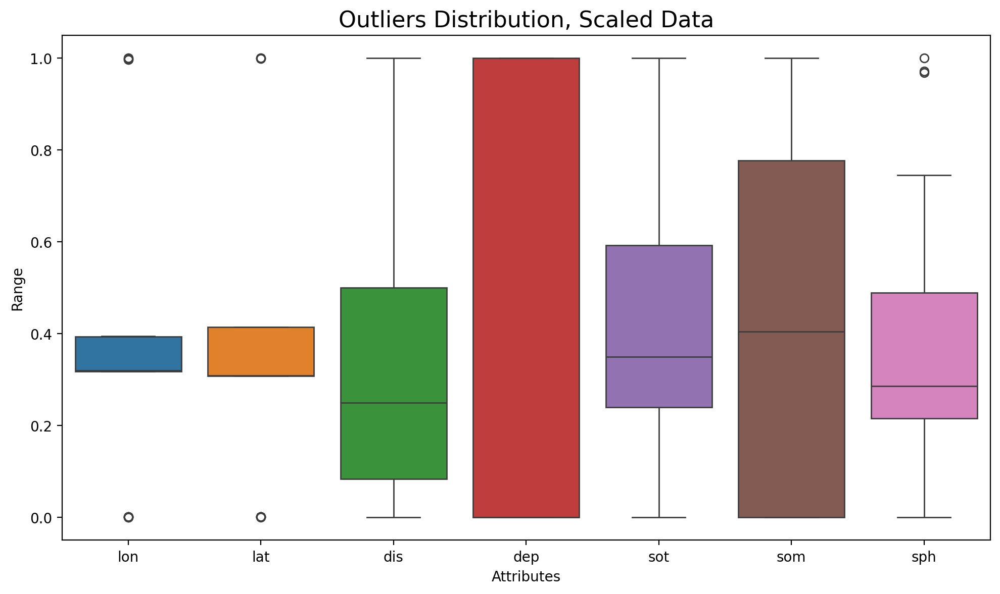

In [29]:
show_boxplot_data(dfsc)

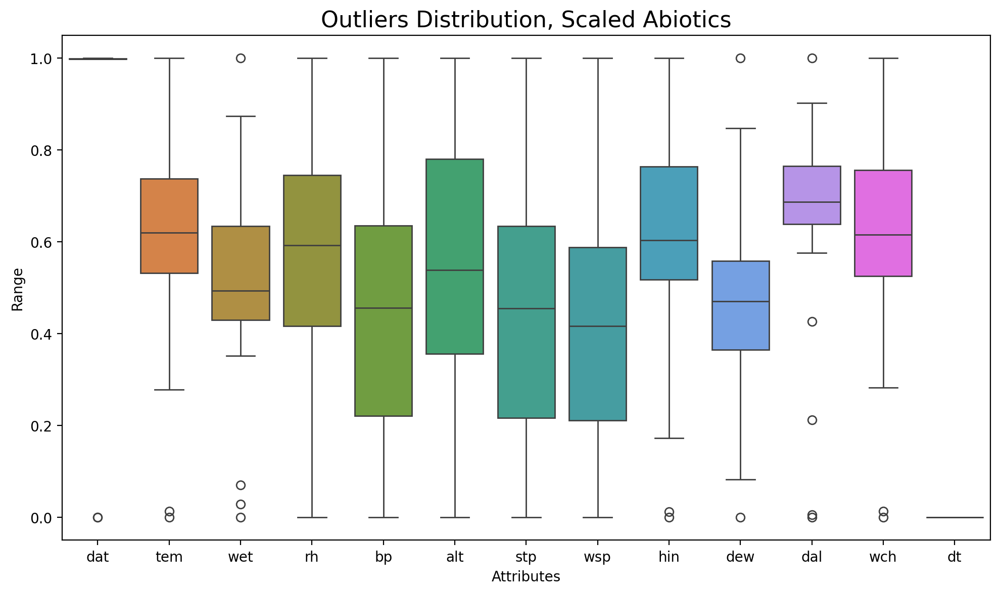

In [30]:
show_boxplot_abiotics(df2sc)

In [21]:
dfsc.index.name='loc'
without_outliers = remove_outliers(dfsc)

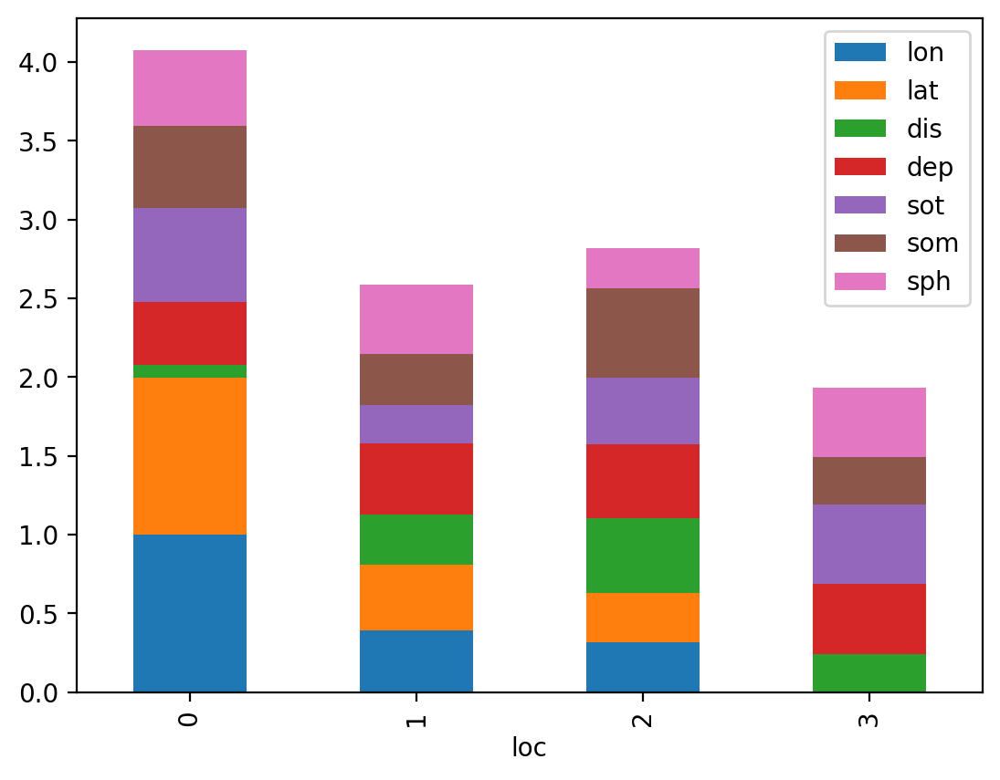

In [32]:
without_outliers.groupby('loc').mean(without_outliers.columns.tolist()).plot(kind = 'bar',stacked=True, legend='best');

In [22]:
df2sc.index.name='loc'
without_outliers2 = remove_outliers(df2sc)

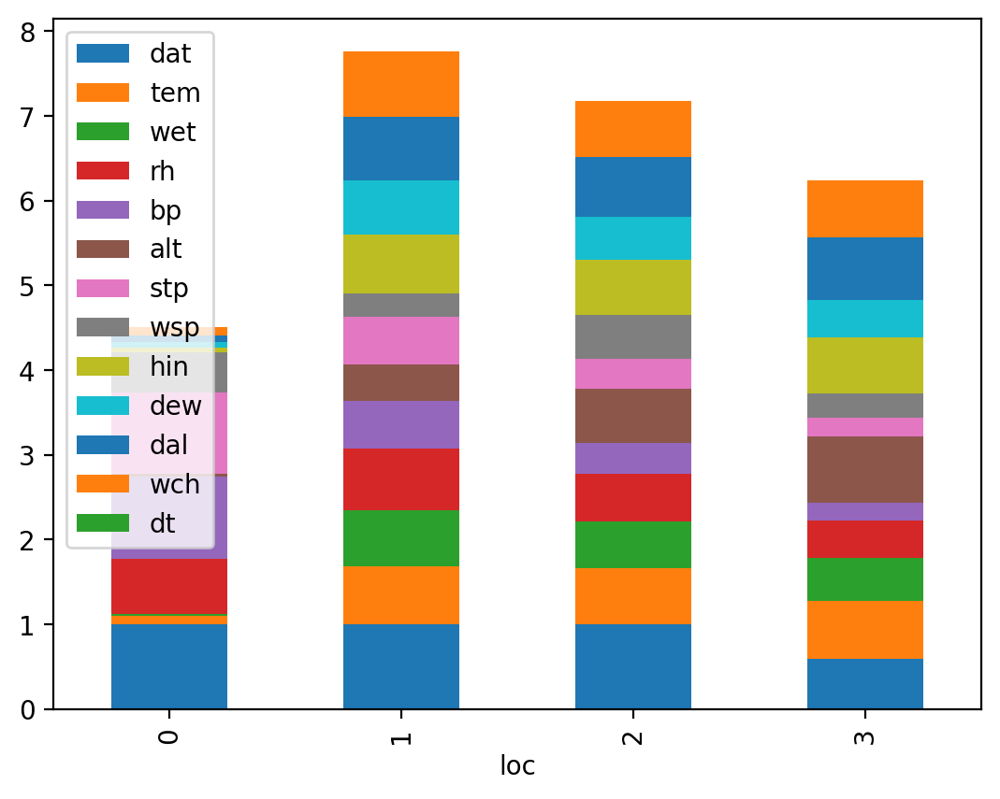

In [34]:
without_outliers2.groupby('loc').mean(without_outliers2.columns.tolist()).plot(kind = 'bar',stacked=True, legend='best');

In [581]:
df2sc.reset_index().merge(dfsc.reset_index()).set_index(['loc']).columns
#df2sc

Index(['dat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew',
       'dal', 'wch', 'dt', 'lon', 'lat', 'dis', 'dep', 'sot', 'som', 'sph'],
      dtype='object')

In [34]:
# xr.DataArray(features, dims=['lat', 'lon'])
# #plt.plot(features.interpolate('linear',limit_direction='forward')['Soil Temperature (C)'])
# plt.plot(features['Soil Temperature (C)'].interpolate('linear'));
# plt.scatter(features['Distance from Pad (m)'],features['Soil Temperature (C)']);

In [61]:
#['linear', 'time', 'index', 'values', 'nearest', 'zero', 'slinear', 'quadratic', 'cubic', 'barycentric', 'krogh', 'spline', 
#'polynomial', 'from_derivatives', 'piecewise_polynomial', 'pchip', 'akima', 'cubicspline']
#ds['dal'].plot();
#ds['dal'].interpolate(method='nearest').plot(linestyle='dotted');
#ds['wch'].plot();
#ds['wch'].interpolate(method='nearest').plot(linestyle='dotted');
#ds['dal']=ds['dal'].interpolate(method='nearest')
#ds['wch']=ds['wch'].interpolate(method='nearest')

In [37]:
#display(HTML(ds.to_html()))

In [1022]:
#dfsc.columns.values.tolist()
#df2sc.columns.values.tolist()
#data2.columns.values.tolist()

In [852]:
without_outliers.columns

Index(['lon', 'lat', 'dis', 'dep', 'sot', 'som', 'sph'], dtype='object')

In [853]:
without_outliers2.columns

Index(['dat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew',
       'dal', 'wch', 'dt'],
      dtype='object')

In [854]:
without_outliers_ds=without_outliers.reset_index().merge(without_outliers2.reset_index()).set_index(['loc'])[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin','dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph', 'dt']]

In [855]:
without_outliers_ds

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [856]:
without_outliers_ds.loc[:, without_outliers_ds.isna().any()].columns.tolist()

[]

In [857]:
without_outliers_ds2=without_outliers_ds.iloc[:,:-1]
without_outliers_ds2

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


#### Optimization

In [831]:
from scipy.optimize import curve_fit

#without_outliers
without_outliers_ds2.interpolate(method='nearest', xis=0, inplace=True)
# Display result
print ('Interpolated data:')
print ()
print (without_outliers_ds2)
print ()

# Function to curve fit to the data
def func(x, a, b, c, d, e):
    return a * (x ** 4) + b * (x ** 3) + c * (x ** 2) + d * x + e
# Initial parameter guess, just to kick off the optimization
guess = (0.5, 0.5, 0.5, 0.5, 0.5)
# Create copy of data to remove NaNs for curve fitting
fit_df = without_outliers_ds2.dropna()
# Place to store function parameters for each column
col_params = {}
# Curve fit each column
for col in fit_df.columns:
    # Get x & y
    x = fit_df.index.astype(float).values
    y = fit_df[col].values
    # Curve fit column and get curve parameters
    params = curve_fit(func, x, y, guess)
    # Store optimized parameters
    col_params[col] = params[0]

# Extrapolate each column
for col in without_outliers_ds2.columns:
    # Get the index values for NaNs in the column
    x = without_outliers_ds2[pd.isnull(without_outliers_ds2[col])].index.astype(float).values
    # Extrapolate those points with the fitted function
    without_outliers_ds2[col][x] = func(x, *col_params[col])
# Display result
print ('Extrapolated data:')
print ()
print ('Data was extrapolated with these column functions:')
for col in col_params:
    print ('f_{}(x) = {:0.3e} x^4 + {:0.3e} x^3 + {:0.4f} x^2 + {:0.4f} x + {:0.4f}'.format(col, *col_params[col]))

Interpolated data:

              dat  lon       lat       tem       wet        rh        bp  \
loc                                                                        
0    9.984597e-01  1.0  0.999543  0.000000  0.000000  0.824885  0.973451   
0    9.984597e-01  1.0  0.999543  0.012658  0.028169  0.834101  1.000000   
0    9.984600e-01  1.0  0.999543  0.278481  0.070423  0.290323  0.911504   
0    9.984597e-01  1.0  0.999543  0.000000  0.000000  0.824885  0.973451   
0    9.984597e-01  1.0  0.999543  0.012658  0.028169  0.834101  1.000000   
..            ...  ...       ...       ...       ...       ...       ...   
3    9.984600e-01  0.0  0.000680  0.708861  0.352113  0.000000  0.309735   
3    7.702889e-09  0.0  0.000680  0.620253  0.492958  0.511521  0.026549   
3    0.000000e+00  0.0  0.000680  0.670886  0.535211  0.506912  0.000000   
3    9.984598e-01  0.0  0.000680  0.620253  0.507042  0.534562  0.353982   
3    9.984598e-01  0.0  0.000680  0.746835  0.676056  0.631336  0.38

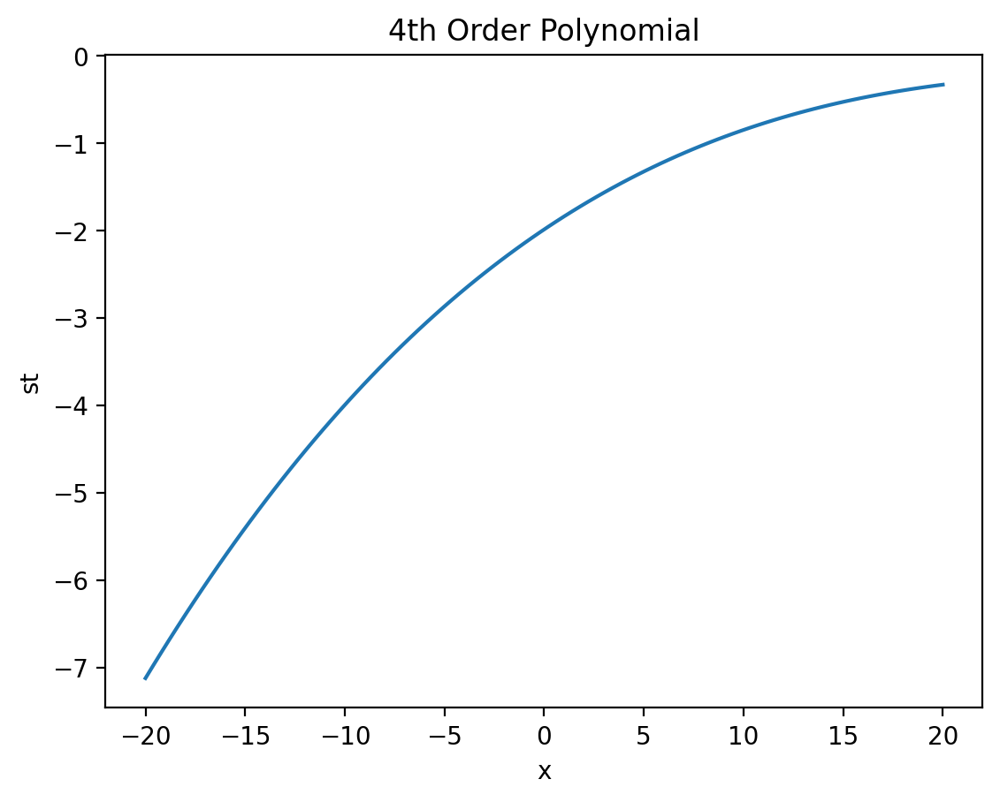

In [832]:
#4.151e-05 x^4 + -4.348e-03 x^3 + 0.1532 x^2 + -1.9866 x + 18.9308
x = np.linspace(-20, 20, 100)
coefficients = [4.151e-05, -4.348e-03, 0.1532, -1.9866]
y = np.polyval(coefficients, x)
plt.plot(x, y)

# Set the title and labels
plt.title("4th Order Polynomial")
plt.xlabel("x")
plt.ylabel("st")

# Show the plot
plt.show()

In [ ]:
# for i, j in ds.iterrows():
#     print(i, j)
#     print()

In [ ]:
# def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
#     """Check Granger Causality of all possible combinations of the Time series.
#     The rows are the response variable, columns are predictors. The values in the table 
#     are the P-Values. P-Values lesser than the significance level (0.05), implies 
#     the Null Hypothesis that the coefficients of the corresponding past values is 
#     zero, that is, the X does not cause Y can be rejected.

#     data      : pandas dataframe containing the time series variables
#     variables : list containing names of the time series variables.
#     """
#     df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
#     for c in df.columns:
#         for r in df.index:
#             test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
#             p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
#             if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
#             min_p_value = np.min(p_values)
#             df.loc[r, c] = min_p_value
#     df.columns = [var + '_x' for var in variables]
#     df.index = [var + '_y' for var in variables]
#     return df

# maxlag=1
# grangers_causation_matrix(ds,ds.columns,verbose=True)

# maxlag=1
# grangers_causation_matrix(features,features.columns,verbose=True)

#### Statistics | Andrews Curves

In [796]:
#Andrews curves allow one to plot multivariate data as a large number of curves that are created using the attributes of samples as coefficients for 
#Fourier series, see the Wikipedia entry for more information. By coloring these curves differently for each class it is possible to visualize data 
#clustering. Curves belonging to samples of the same class will usually be closer together and form larger structures

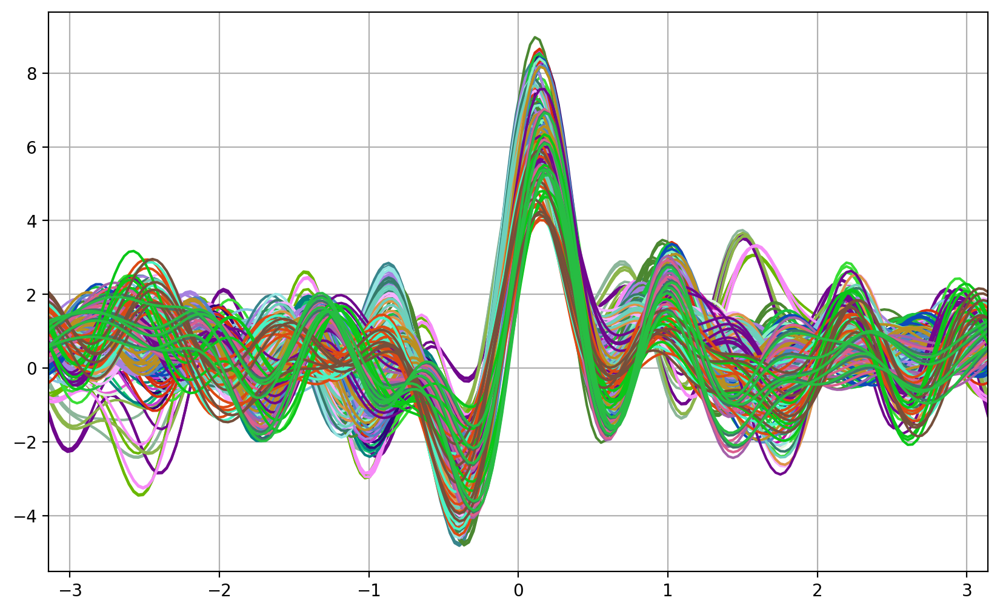

In [835]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
#andrews_curves(without_outliers[:15], "sot")#,colormap="winter");
andrews_curves(without_outliers_ds2, "sot")#,colormap="winter");
#andrews_curves(without_outliers[81:201], "sot")#,colormap="winter");
#andrews_curves(without_outliers[201:], "sot")#,colormap="winter");
#andrews_curves(without_outliers, "lon",colormap="Reds");
#andrews_curves(without_outliers, "lat",colormap="Blues");
#andrews_curves(without_outliers, "dis",colormap="jet");
#andrews_curves(without_outliers, "som",colormap="Reds");
#andrews_curves(without_outliers, "sph",colormap="Purples");
#plt.title('Soil Temperature, Fourier Transform | Visualizing Data Clustering via Andrew Curves)')
#andrews_curves(without_outliers, "sm");
#andrews_curves(without_outliers, "ph");
ax.legend()
ax.get_legend().remove()

In [837]:
without_outliers_ds2.columns

Index(['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp',
       'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph'],
      dtype='object')

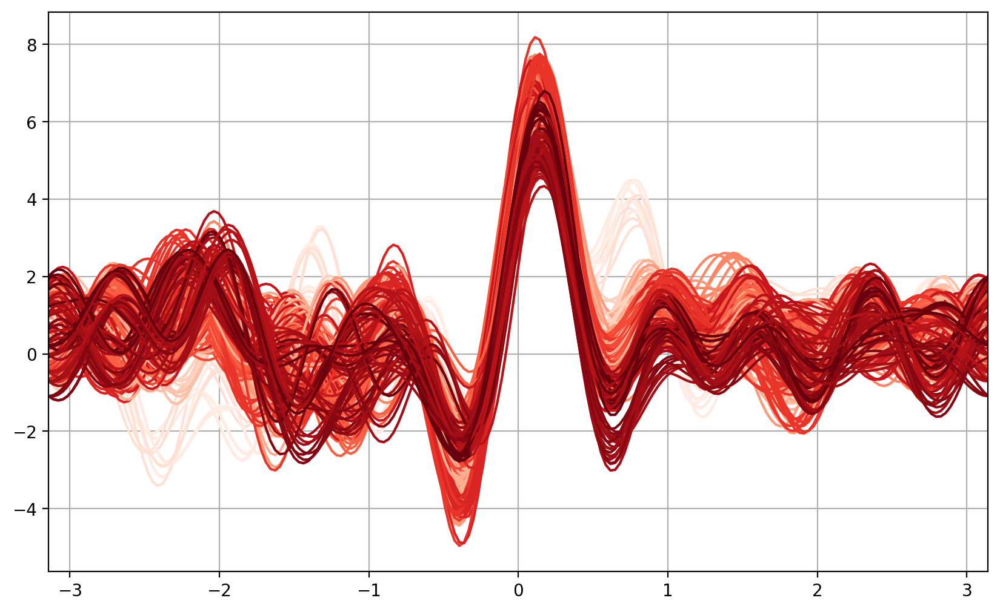

In [838]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
#andrews_curves(without_outliers2, "tem")#,colormap="winter");
andrews_curves(without_outliers_ds2, "tem",colormap="Reds");
#andrews_curves(without_outliers2[15:81], "wsp",colormap="Blues");
#plt.title('Soil Temperature, Fourier Transform | Visualizing Data Clustering via Andrew Curves)')
#andrews_curves(without_outliers, "sm");
#andrews_curves(without_outliers, "ph");
ax.legend()
ax.get_legend().remove()

##### Extra

In [ ]:
# #ds.to_latex
# latex_code = pd.DataFrame(ds).to_latex(
#     longtable=True,  # Enable longtable format
#     index=False,  # Do not include the DataFrame index
#     column_format='|' + '|'.join(['c'] * len(df.columns)) + '|',  # Center align columns with borders
#     header=True,  # Include the header row
#     bold_rows=True,  # Bold the header row
#     escape=False  # Do not escape LaTeX special characters
# )

# # Adding additional horizontal borders
# latex_code = latex_code.replace('\\toprule', '\\hline')
# latex_code = latex_code.replace('\\midrule', '\\hline')
# latex_code = latex_code.replace('\\bottomrule', '\\hline')

# print(latex_code)
# with open('ds.tex', 'w') as f:
#     f.write(latex_code)

In [ ]:
# newdf=newdf.reset_index()

# with open('mytable.tex','w') as tf:
#     tf.write(newdf.to_latex(index=False))

# from astropy.table import Table
# tab = Table.read('mytable.tex').to_pandas()

In [ ]:
# import pandas as pd
# import pylatex as pl

# doc = pl.Document()

# doc.packages.append(pl.Package('booktabs'))
# doc.packages.append(pl.Package('longtable'))

# with doc.create(pl.Section('Table 1: Study-Level Baseline Statistics ')):
#     doc.append(pl.NoEscape(newdf.to_latex(longtable=True,caption='Study-level comprehensive baseline field dataset acquired from four sample locations near Prudhoe Bay, AK (20-21 July 2023)')))

# doc.generate_pdf(filepath=f'Study-Level Baseline Statistic', clean_tex=False)

In [ ]:
# dfi.export(features2, "features2.png", table_conversion="latex")

In [ ]:
# with open('mytable3.tex','w') as tf:
#     tf.write(features2.to_latex())

In [ ]:
# with open('mytable.tex') as input_file:
#     text = ""
#     for line in input_file:
#         if '&' in line:
#             text += line.replace('\\', '') + '\n'
# data = StringIO(text)
# newdf = pd.read_csv(data, sep="&")
# data.close()

In [ ]:
# tab = Table.read('mytable.tex').to_pandas()

In [ ]:
# dfi.export(fdf3, "previf_scaledds2fdf3_pearsonspearmancoeffpvalues_lteq0.05p_97div246rships.png", table_conversion="latex")

In [ ]:
# df.columns = pd.MultiIndex.from_tuples([
#     ("Numeric", "Integers"),
#     ("Numeric", "Floats"),
#     ("Non-Numeric", "Strings")
# ])
# df.index = pd.MultiIndex.from_tuples([
#     ("L0", "ix1"), ("L0", "ix2"), ("L1", "ix3")
# ])
# s = df.style.highlight_max(
#     props='cellcolor:[HTML]{FFFF00}; color:{red}; itshape:; bfseries:;'
# )

In [ ]:
# latex_table = fdf3.to_latex(
#     index=True,  # To not include the DataFrame index as a column in the table
#     caption="Study-level comprehensive baseline field dataset acquired from four sample locations near Prudhoe Bay, AK (20-21 July 2023). These sites are designated as the following: PB1, DH1, DH2 and DH3. Abiotic (top) observations were retrieved (i.e., Device Name: ENVIRO - 2836531; Device Model: 5000L; Serial Number: 2836531) alongside biotic (bottom) covariates of interest.",  # The caption to appear above the table in the LaTeX document
#     #label="tab:study-level-baseline-ds",  # A label used for referencing the table within the LaTeX document
#     label="table:Table 1",
#     #position="p",  # The preferred positions where the table should be placed in the document ('here', 'top', 'bottom', 'page')
#     column_format="rrrrr",  # The format of the columns: left-aligned with vertical lines between them
#     position="h",
#     #position_float="centering",
#     #hrules=True,
#     escape=False,  # Disable escaping LaTeX special characters in the DataFrame
#     multirow_align="t",
#     multicol_align="r",
#     float_format="{:0.4f}".format  # Formats floats to two decimal places
# )

# print(latex_table)

In [ ]:
#print(fdf3.to_markdown(index=False))

In [ ]:
#rls, pls

In [ ]:
#sls,p2ls

In [ ]:
#fdf.columns=['Pearson Correlation Coefficient','Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value', 'First Covariate', 'Second Covariate']
fdf=pd.DataFrame([rls,pls,sls,p2ls,arr[::2],arr[1::2]]).T
fdf.columns=['pcc','pcc_p', 'scc', 'scc_p', 'cov1', 'cov2']

In [ ]:
#fdf.iloc[np.where([fdf.iloc[:,1]<=0.05])[1].tolist(),:]
#vmax=np.abs(fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)].iloc[:,:-2].corr()).max().max()
#sns.heatmap(fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)].iloc[:,:-2].corr(),vmin=-vmax,vmax=vmax)
fdf2=fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)]
fdf2.columns=['Pearson Correlation Coefficient','Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value', 'First Covariate', 'Second Covariate']

In [ ]:
#pd.DataFrame([fdf2.iloc[:,-2].tolist(),fdf2.iloc[:,-1].tolist()]).T

#fdf2.iloc[:,-2].str.split(',')
#final_list = [x for xs in fdf2.iloc[:,-2].str.split(',').tolist() for x in xs]

fdf2['Covariates'] = fdf2.iloc[:,-2].fillna('') + ',' + fdf2.iloc[:,-1].fillna('')
fdf2['Covariates'] = fdf2['Covariates'].str.strip(',')
#print(fdf2)

In [ ]:
fdf3=fdf2.drop(columns=['First Covariate','Second Covariate'])[['Covariates', 'Pearson Correlation Coefficient', 'Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value']]

In [ ]:
fdf3.columns
#fdf3

In [ ]:
fdf3=fdf3.sort_values(['Pearson P-Value'],ascending=True).set_index(['Covariates'])

In [ ]:
dfi.export(fdf3, "features2ftf3_pearsonspearmancoeffpvalues_lteq0.05p_45div247rships.png", table_conversion="matplotlib")

In [ ]:
#rls, pls
#sls,p2ls

#### Dendrograms

In [806]:
#without_outliers

{'icoord': [[5.0, 5.0, 15.0, 15.0],
  [25.0, 25.0, 35.0, 35.0],
  [45.0, 45.0, 55.0, 55.0],
  [30.0, 30.0, 50.0, 50.0],
  [10.0, 10.0, 40.0, 40.0],
  [75.0, 75.0, 85.0, 85.0],
  [65.0, 65.0, 80.0, 80.0],
  [95.0, 95.0, 105.0, 105.0],
  [115.0, 115.0, 125.0, 125.0],
  [135.0, 135.0, 145.0, 145.0],
  [120.0, 120.0, 140.0, 140.0],
  [100.0, 100.0, 130.0, 130.0],
  [72.5, 72.5, 115.0, 115.0],
  [25.0, 25.0, 93.75, 93.75],
  [155.0, 155.0, 165.0, 165.0],
  [175.0, 175.0, 185.0, 185.0],
  [160.0, 160.0, 180.0, 180.0],
  [195.0, 195.0, 205.0, 205.0],
  [215.0, 215.0, 225.0, 225.0],
  [200.0, 200.0, 220.0, 220.0],
  [170.0, 170.0, 210.0, 210.0],
  [235.0, 235.0, 245.0, 245.0],
  [255.0, 255.0, 265.0, 265.0],
  [285.0, 285.0, 295.0, 295.0],
  [275.0, 275.0, 290.0, 290.0],
  [315.0, 315.0, 325.0, 325.0],
  [305.0, 305.0, 320.0, 320.0],
  [282.5, 282.5, 312.5, 312.5],
  [260.0, 260.0, 297.5, 297.5],
  [240.0, 240.0, 278.75, 278.75],
  [190.0, 190.0, 259.375, 259.375],
  [345.0, 345.0, 355.0, 355.

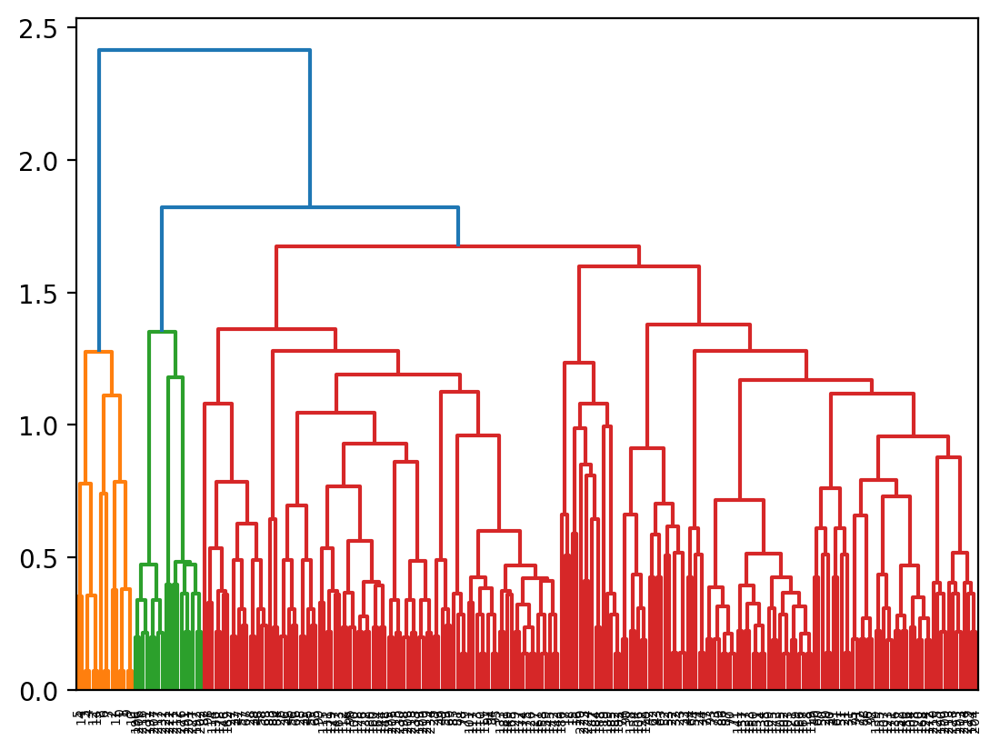

In [839]:
# Compute the linkage matrix
Z = linkage(without_outliers_ds2, 'average')
# Create a dendrogram
dendrogram(Z)

[5, 14, 3, 4, 12, 13, 8, 6, 7, 2, 11, 0, 1, 9, 10, 196, 206, 216, 231, 197, 207, 217, 232, 221, 222, 211, 212, 226, 191, 201, 227, 192, 202, 82, 98, 114, 130, 178, 146, 162, 27, 37, 47, 57, 67, 28, 38, 48, 58, 68, 83, 80, 84, 26, 36, 46, 56, 66, 25, 35, 45, 55, 65, 99, 115, 131, 179, 147, 163, 112, 116, 96, 100, 128, 176, 132, 180, 160, 164, 144, 148, 195, 205, 215, 230, 198, 208, 218, 233, 199, 209, 219, 234, 29, 39, 49, 59, 69, 85, 81, 78, 79, 101, 117, 113, 110, 111, 97, 94, 95, 133, 181, 149, 165, 129, 177, 174, 175, 126, 127, 161, 158, 159, 145, 142, 143, 186, 17, 18, 15, 16, 220, 223, 224, 187, 184, 188, 19, 189, 185, 182, 183, 74, 90, 138, 154, 106, 122, 170, 42, 62, 43, 63, 52, 53, 22, 32, 23, 33, 44, 64, 54, 24, 34, 77, 93, 73, 89, 86, 87, 70, 71, 141, 157, 137, 153, 150, 151, 134, 135, 109, 125, 173, 105, 102, 103, 121, 169, 166, 167, 118, 119, 40, 60, 50, 20, 30, 41, 61, 51, 21, 31, 75, 91, 72, 88, 76, 92, 139, 155, 107, 123, 171, 136, 152, 140, 156, 104, 108, 120, 168, 124,

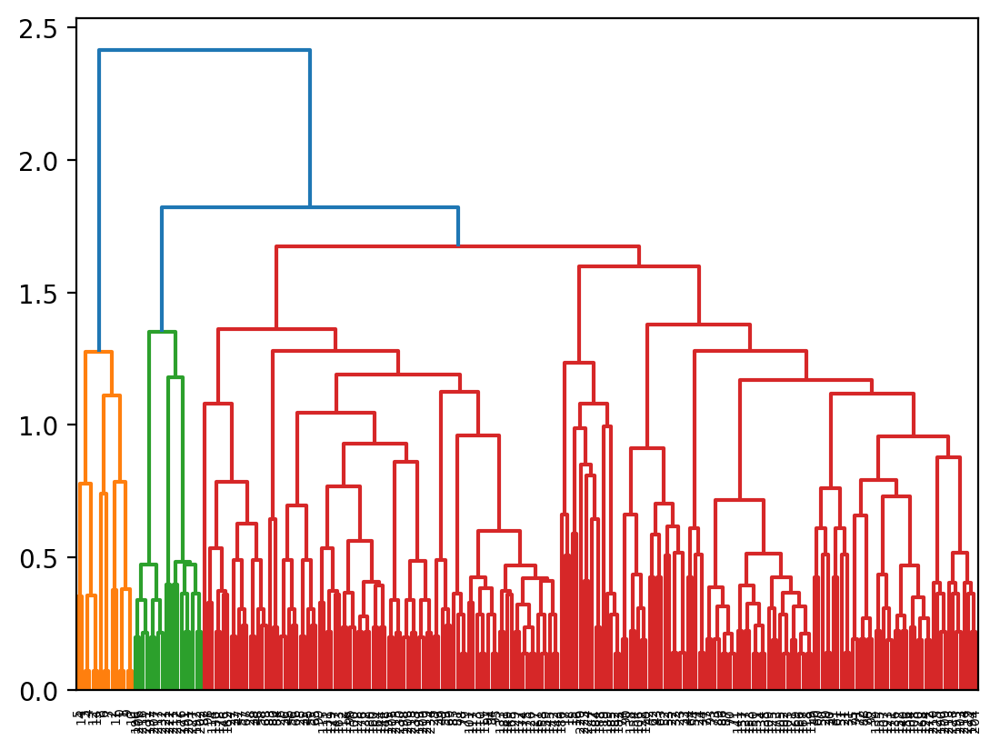

In [840]:
# Cut the dendrogram at a height of 2 to get 3 clusters
labels = dendrogram(Z, no_plot=False)['leaves']

# Print the cluster labels
print(labels)

In [841]:
complete_clustering=linkage(without_outliers_ds2,method="complete", metric="euclidean")
average_clustering = linkage(without_outliers_ds2, method="average", metric="euclidean")
single_clustering = linkage(without_outliers_ds2, method="single", metric="euclidean")

In [816]:
#dendrogram(complete_clustering)

In [817]:
#dendrogram(average_clustering)

In [818]:
#dendrogram(single_clustering)

[8, 6, 7, 5, 14, 3, 4, 12, 13, 2, 11, 0, 1, 9, 10, 197, 207, 217, 232, 196, 206, 216, 231, 221, 222, 191, 201, 192, 202, 211, 226, 212, 227, 223, 224, 220, 187, 184, 188, 19, 189, 185, 182, 183, 74, 90, 138, 154, 106, 122, 170, 186, 17, 18, 42, 62, 43, 63, 52, 53, 22, 32, 23, 33, 82, 98, 114, 130, 178, 146, 162, 27, 37, 28, 38, 47, 57, 67, 48, 58, 68, 29, 39, 49, 59, 69, 44, 64, 54, 24, 34, 25, 35, 26, 36, 45, 55, 65, 46, 56, 66, 15, 16, 40, 60, 41, 61, 50, 20, 30, 51, 21, 31, 77, 93, 73, 89, 86, 87, 70, 71, 141, 157, 137, 153, 150, 151, 134, 135, 109, 125, 173, 105, 102, 103, 121, 169, 166, 167, 118, 119, 85, 81, 78, 79, 101, 117, 97, 113, 110, 111, 94, 95, 133, 181, 149, 165, 129, 177, 174, 175, 126, 127, 161, 158, 159, 145, 142, 143, 195, 205, 215, 230, 198, 208, 218, 233, 199, 209, 219, 234, 99, 115, 131, 179, 147, 163, 112, 116, 96, 100, 128, 176, 132, 180, 144, 148, 160, 164, 139, 155, 107, 123, 171, 136, 152, 140, 156, 104, 108, 120, 168, 124, 172, 190, 200, 210, 225, 193, 203, 

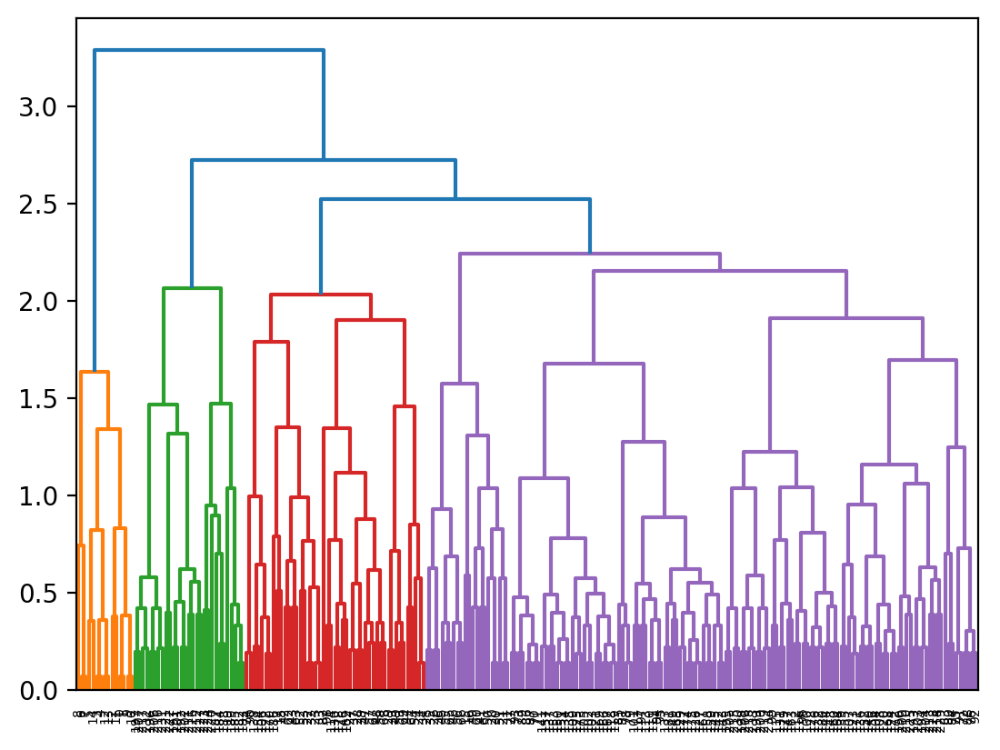

In [843]:
labels = dendrogram(complete_clustering, no_plot=False)['leaves']
print(labels) #4 clusters

[5, 14, 3, 4, 12, 13, 8, 6, 7, 2, 11, 0, 1, 9, 10, 196, 206, 216, 231, 197, 207, 217, 232, 221, 222, 211, 212, 226, 191, 201, 227, 192, 202, 82, 98, 114, 130, 178, 146, 162, 27, 37, 47, 57, 67, 28, 38, 48, 58, 68, 83, 80, 84, 26, 36, 46, 56, 66, 25, 35, 45, 55, 65, 99, 115, 131, 179, 147, 163, 112, 116, 96, 100, 128, 176, 132, 180, 160, 164, 144, 148, 195, 205, 215, 230, 198, 208, 218, 233, 199, 209, 219, 234, 29, 39, 49, 59, 69, 85, 81, 78, 79, 101, 117, 113, 110, 111, 97, 94, 95, 133, 181, 149, 165, 129, 177, 174, 175, 126, 127, 161, 158, 159, 145, 142, 143, 186, 17, 18, 15, 16, 220, 223, 224, 187, 184, 188, 19, 189, 185, 182, 183, 74, 90, 138, 154, 106, 122, 170, 42, 62, 43, 63, 52, 53, 22, 32, 23, 33, 44, 64, 54, 24, 34, 77, 93, 73, 89, 86, 87, 70, 71, 141, 157, 137, 153, 150, 151, 134, 135, 109, 125, 173, 105, 102, 103, 121, 169, 166, 167, 118, 119, 40, 60, 50, 20, 30, 41, 61, 51, 21, 31, 75, 91, 72, 88, 76, 92, 139, 155, 107, 123, 171, 136, 152, 140, 156, 104, 108, 120, 168, 124,

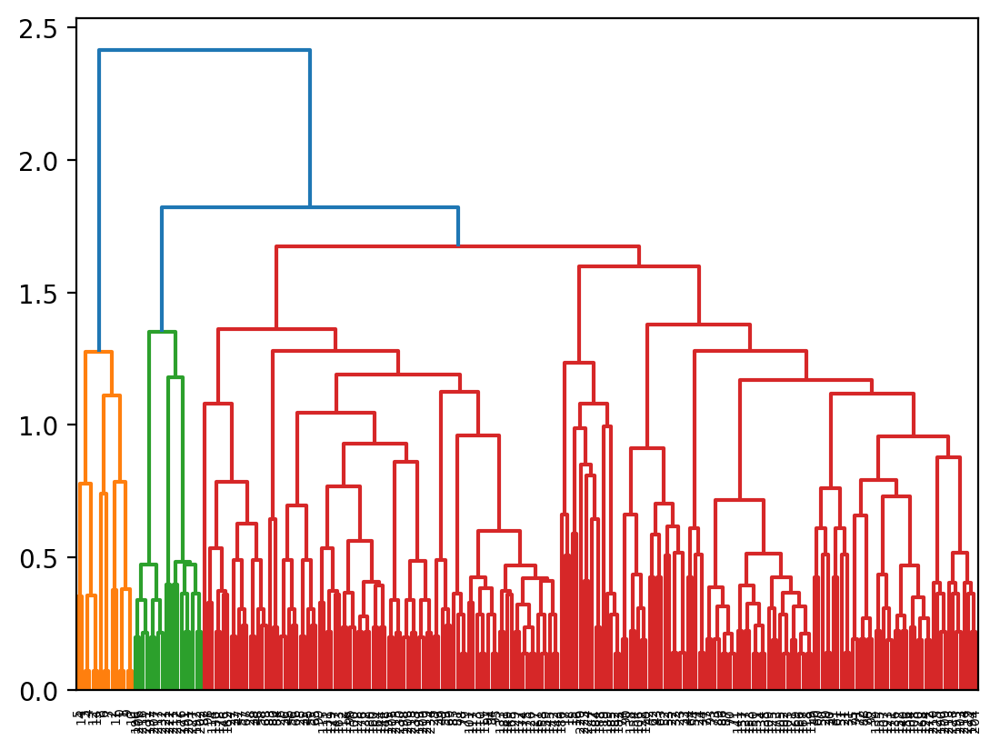

In [844]:
labels = dendrogram(average_clustering, no_plot=False)['leaves']

print(labels) #3 clusters

[12, 13, 3, 4, 5, 14, 0, 1, 9, 10, 2, 11, 8, 6, 7, 29, 39, 49, 59, 69, 85, 81, 78, 79, 149, 145, 142, 143, 101, 97, 94, 95, 117, 113, 110, 111, 126, 127, 174, 175, 129, 177, 161, 158, 159, 165, 133, 181, 195, 205, 215, 230, 82, 146, 98, 114, 162, 130, 178, 27, 37, 47, 57, 67, 28, 38, 48, 58, 68, 198, 208, 218, 233, 199, 209, 219, 234, 83, 80, 84, 26, 36, 46, 56, 66, 147, 99, 115, 163, 131, 179, 25, 35, 45, 55, 65, 144, 148, 96, 100, 112, 116, 160, 164, 128, 176, 132, 180, 54, 64, 44, 24, 34, 166, 167, 118, 119, 150, 151, 134, 135, 121, 169, 137, 153, 105, 102, 103, 109, 125, 173, 141, 157, 77, 93, 86, 87, 70, 71, 73, 89, 210, 225, 190, 200, 74, 90, 106, 122, 170, 138, 154, 52, 62, 42, 22, 32, 53, 63, 43, 23, 33, 213, 228, 193, 203, 214, 229, 194, 204, 51, 61, 41, 21, 31, 75, 91, 107, 123, 171, 139, 155, 72, 88, 76, 92, 120, 168, 136, 152, 124, 172, 140, 156, 104, 108, 50, 60, 40, 20, 30, 19, 189, 185, 182, 183, 220, 186, 17, 18, 223, 224, 16, 187, 15, 184, 188, 196, 206, 216, 231, 197,

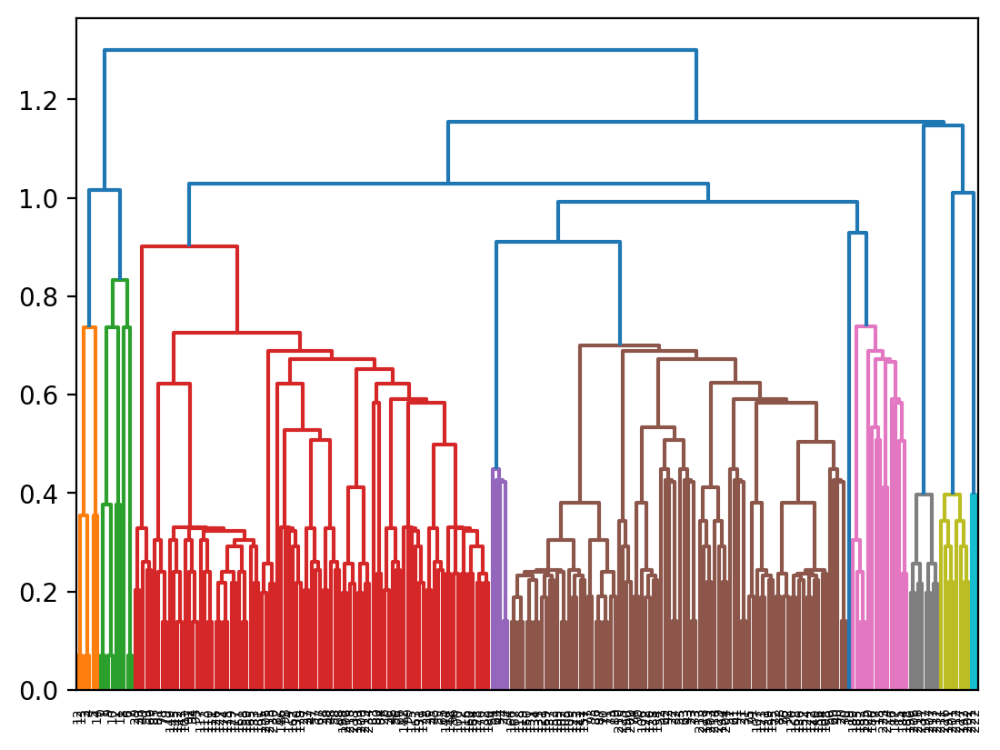

In [846]:
labels = dendrogram(single_clustering, no_plot=False)['leaves']

print(labels) #8 clusters

#### Statistics | Cluster Analysis, Box and Scatter Plots and Correlation

In [ ]:
# features=features.drop(columns=['cluster'])
# without_outliers=without_outliers.drop(columns=['cluster'])

In [973]:
cluster_labels = cut_tree(complete_clustering, n_clusters=4).reshape(-1, )
#features["cluster"] = cluster_labels
without_outliers_ds2["cluster"] = cluster_labels

2024-09-27 20:25:01,378 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:25:01,378 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:25:01,382 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:25:01,382 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024

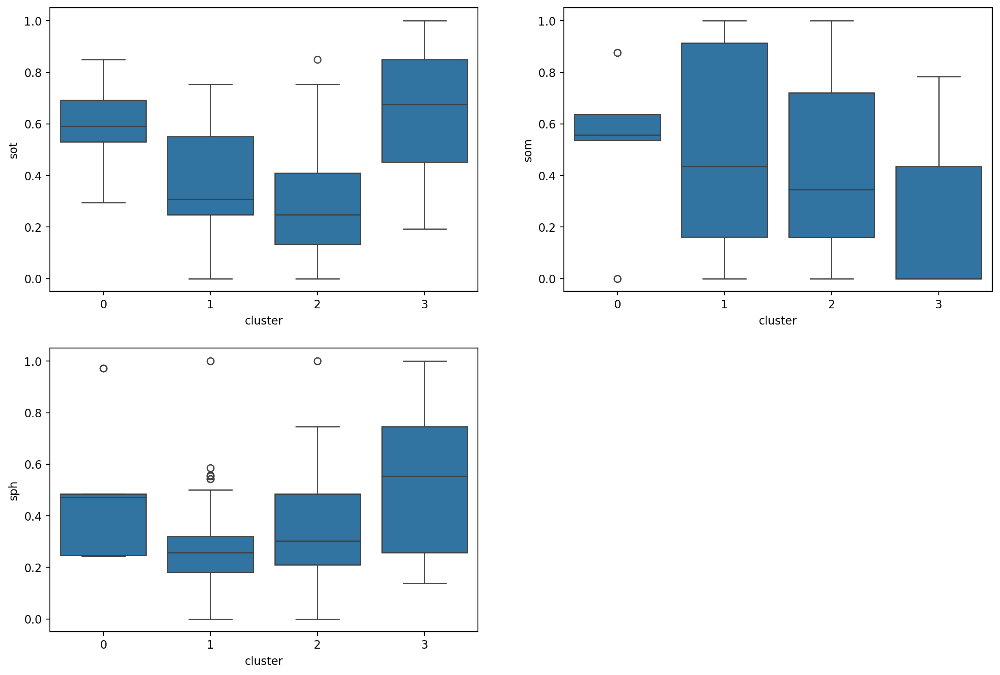

In [974]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.boxplot(x='cluster', y='sot', data=without_outliers_ds2,legend = "full");
plt.subplot(2,2,2)
sns.boxplot(x='cluster', y='som', data=without_outliers_ds2,legend = "full");
plt.subplot(2,2,3)
sns.boxplot(x='cluster', y='sph', data=without_outliers_ds2,legend = "full");

plt.show() 

In [975]:
without_outliers_ds2.cluster.value_counts()

cluster
1    144
2     47
3     29
0     15
Name: count, dtype: int64

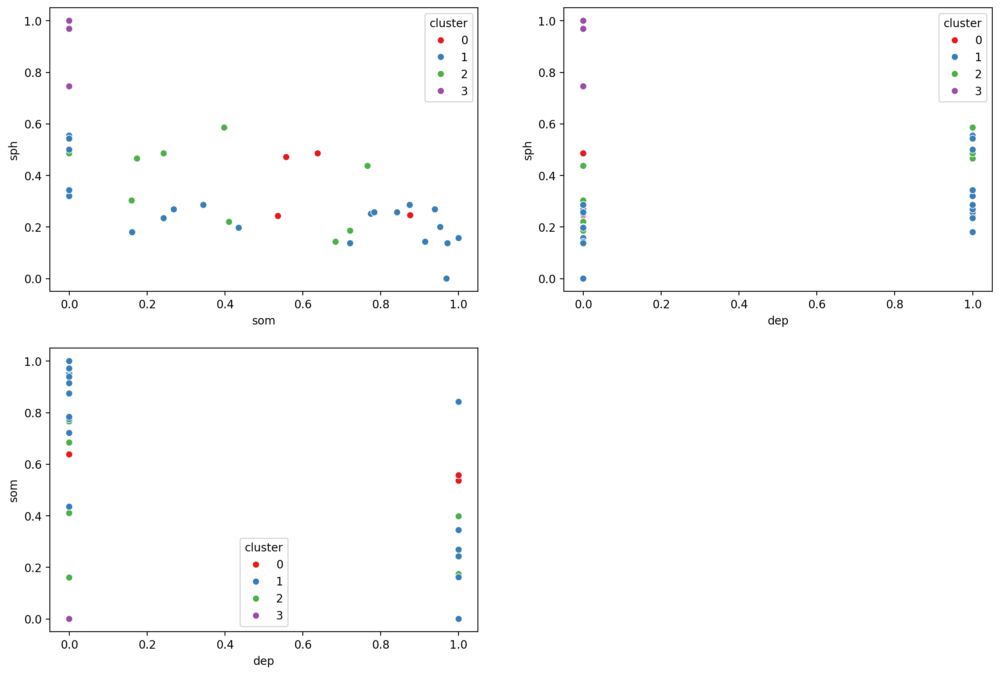

In [976]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.scatterplot(x = "som" , y = "sph", hue = 'cluster', data = without_outliers_ds2, palette = "Set1", legend = "full")
plt.subplot(2,2,2)
sns.scatterplot(x = "dep" , y = "sph", hue = 'cluster', data = without_outliers_ds2, palette = "Set1",legend = "full")
plt.subplot(2,2,3)
sns.scatterplot(x = "dep" , y = "som", hue = 'cluster', data = without_outliers_ds2, palette = "Set1", legend = "full")

plt.show() 

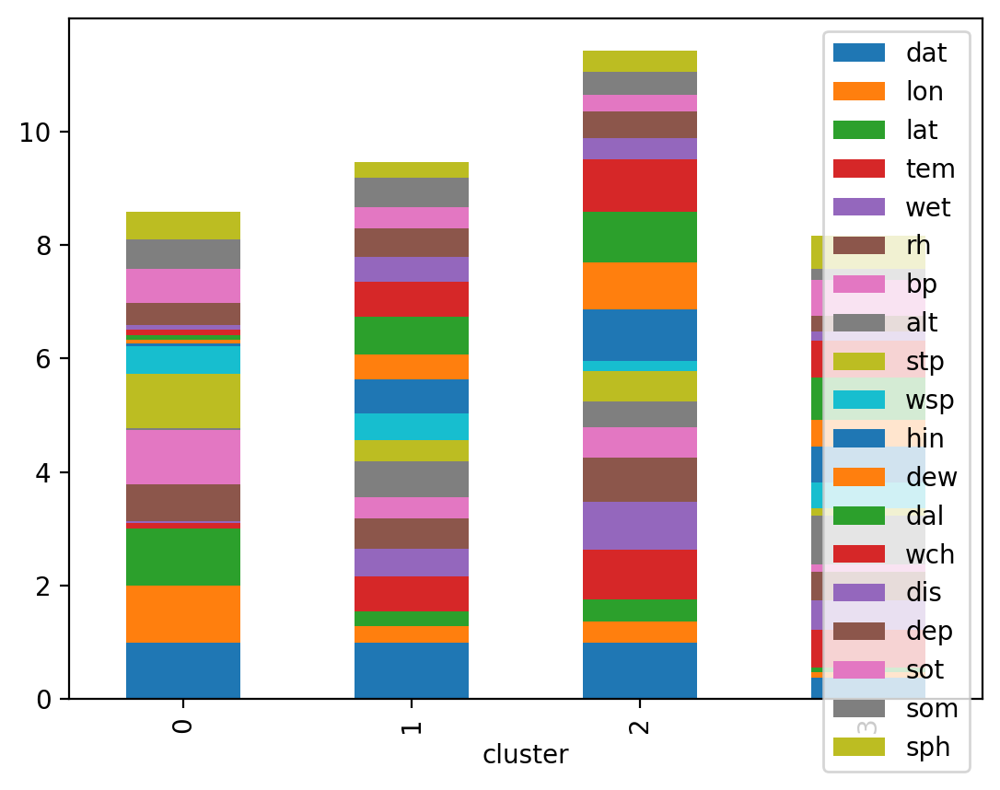

In [977]:
without_outliers_ds2.groupby('cluster').mean(['dis','dep','sot','som','sph']).plot(kind = 'bar',stacked=True);

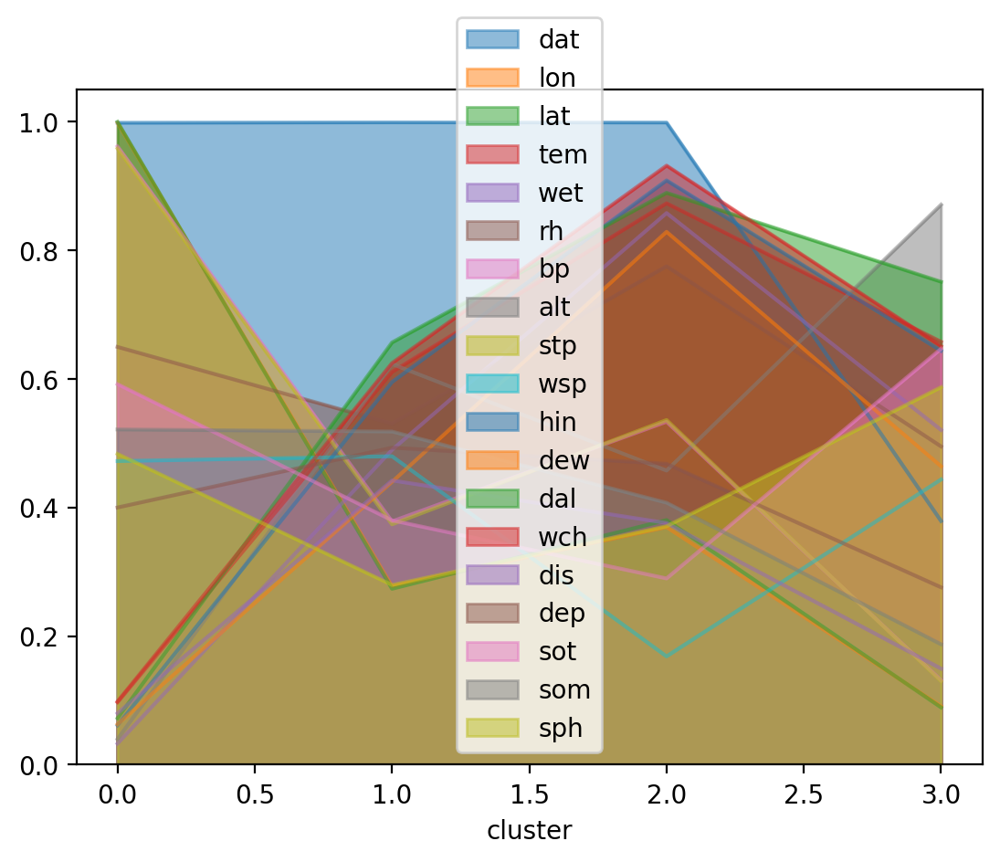

In [978]:
without_outliers_ds2.groupby('cluster').mean(['dis','dep','sot','som','sph']).plot.area(stacked=False);

In [934]:
cluster_labels = cut_tree(average_clustering, n_clusters=3).reshape(-1, )
#features["cluster"] = cluster_labels
without_outliers_ds2["cluster"] = cluster_labels

2024-09-27 20:20:08,795 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:20:08,795 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:20:08,799 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:20:08,799 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024

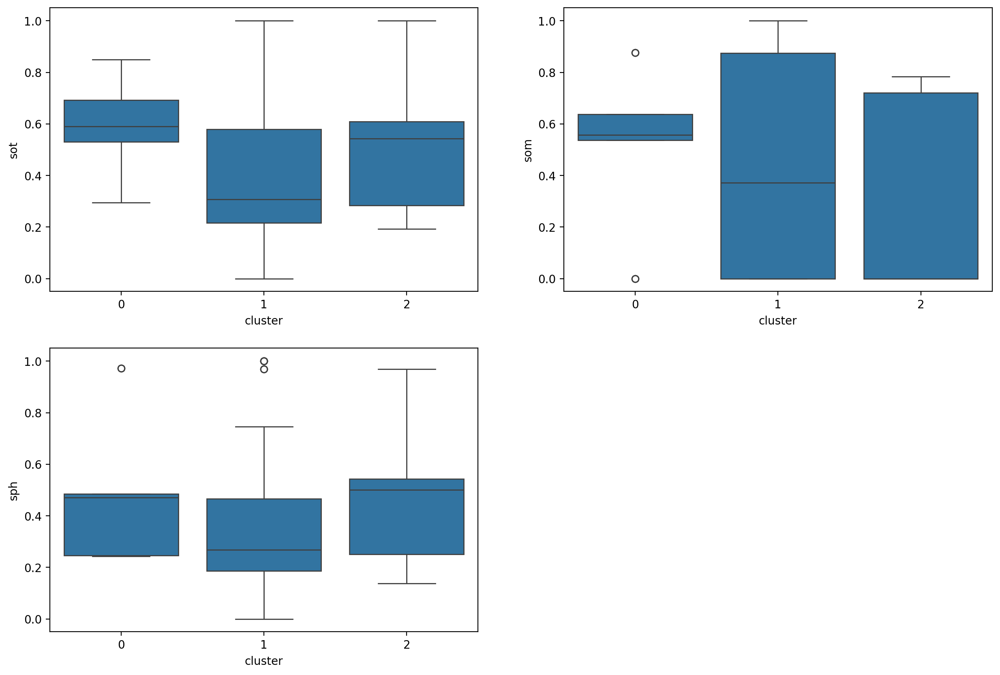

In [935]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.boxplot(x='cluster', y='sot', data=without_outliers_ds2,legend = "full");
plt.subplot(2,2,2)
sns.boxplot(x='cluster', y='som', data=without_outliers_ds2,legend = "full");
plt.subplot(2,2,3)
sns.boxplot(x='cluster', y='sph', data=without_outliers_ds2,legend = "full");

plt.show()

In [936]:
without_outliers_ds2.cluster.value_counts()

cluster
1    202
2     18
0     15
Name: count, dtype: int64

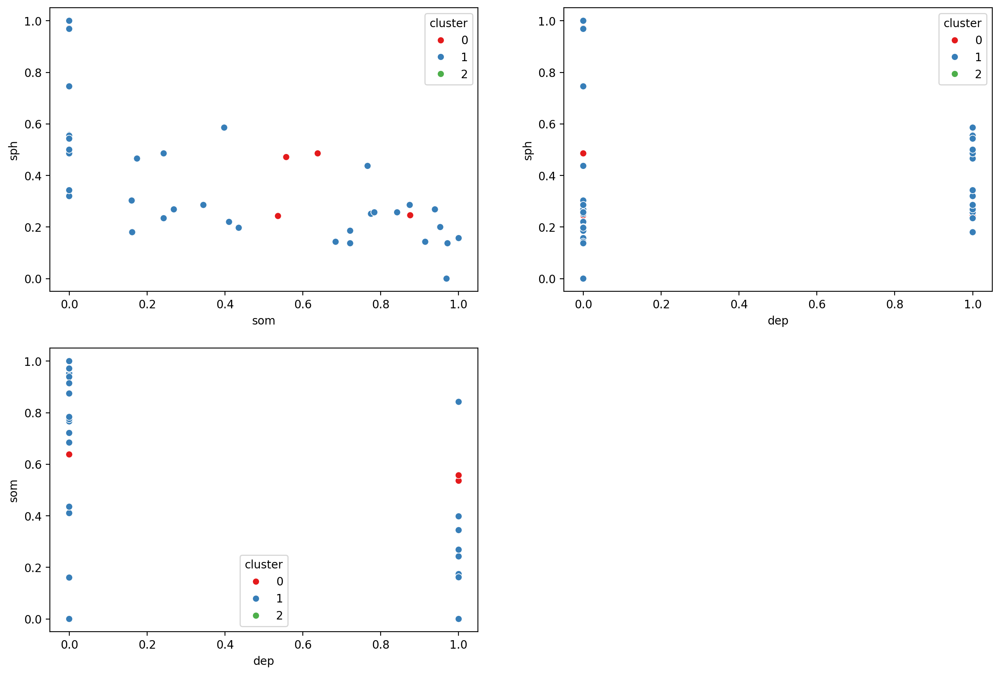

In [937]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.scatterplot(x = "som" , y = "sph", hue = 'cluster', data = without_outliers_ds2, palette = "Set1", legend = "full")
plt.subplot(2,2,2)
sns.scatterplot(x = "dep" , y = "sph", hue = 'cluster', data = without_outliers_ds2, palette = "Set1",legend = "full")
plt.subplot(2,2,3)
sns.scatterplot(x = "dep" , y = "som", hue = 'cluster', data = without_outliers_ds2, palette = "Set1", legend = "full")

plt.show() 

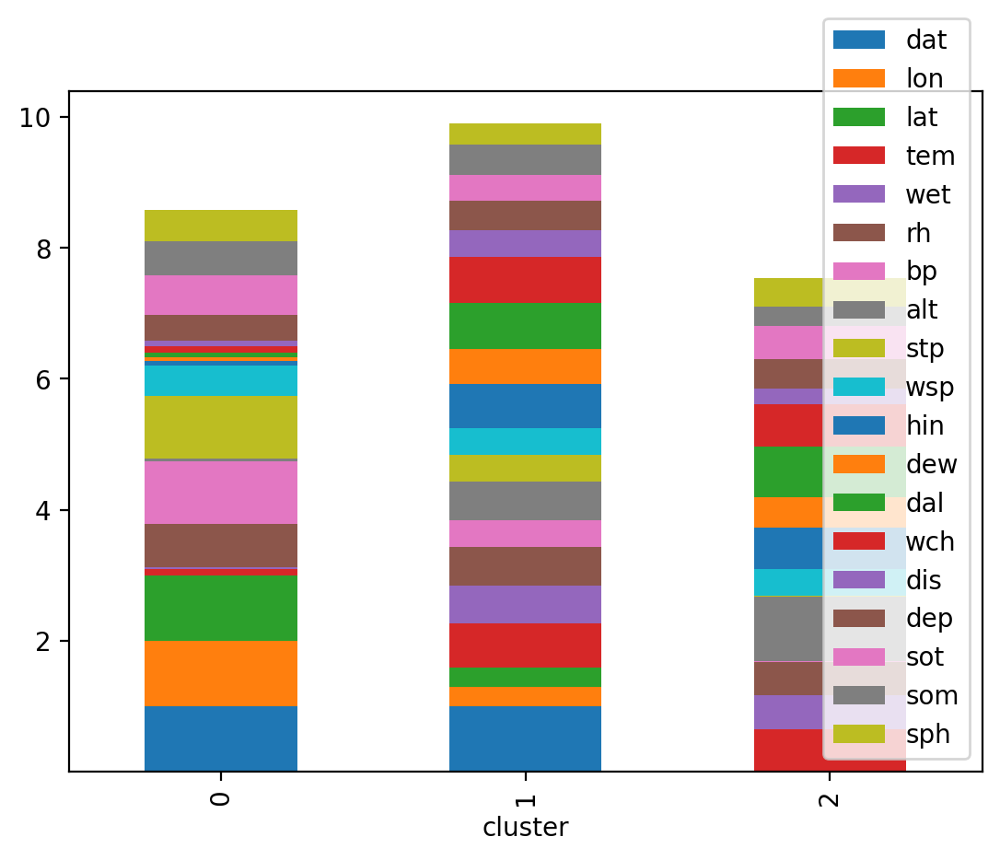

In [938]:
without_outliers_ds2.groupby('cluster').mean(['dis','dep','sot','som','sph']).plot(kind = 'bar',stacked=True);

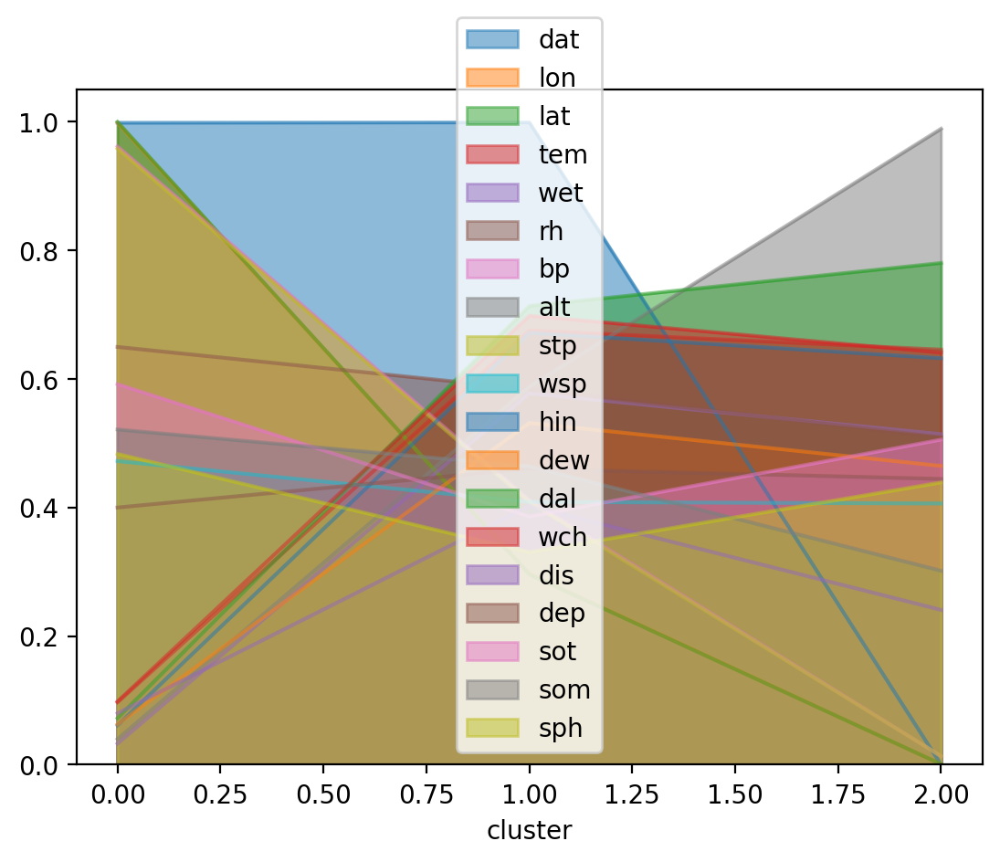

In [939]:
without_outliers_ds2.groupby('cluster').mean(['dis','dep','sot','som','sph']).plot.area(stacked=False);

In [940]:
cluster_labels = cut_tree(single_clustering, n_clusters=10).reshape(-1, )
#features["cluster"] = cluster_labels
without_outliers_ds2["cluster"] = cluster_labels

2024-09-27 20:20:19,393 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:20:19,393 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:20:19,395 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:20:19,395 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024

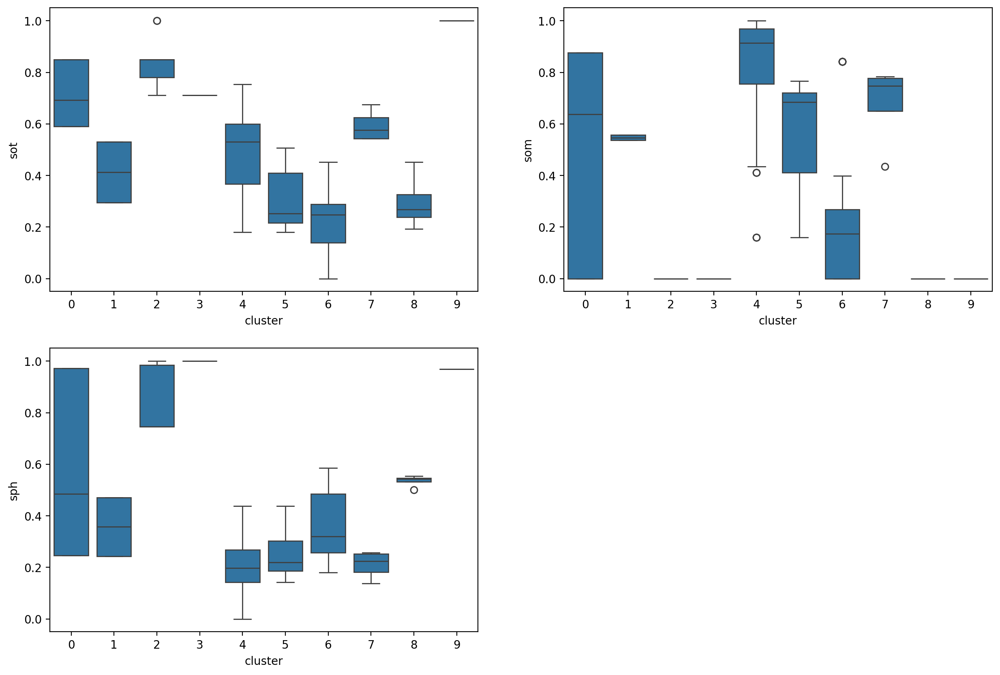

In [941]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.boxplot(x='cluster', y='sot', data=without_outliers_ds2,legend = "full");
plt.subplot(2,2,2)
sns.boxplot(x='cluster', y='som', data=without_outliers_ds2,legend = "full");
plt.subplot(2,2,3)
sns.boxplot(x='cluster', y='sph', data=without_outliers_ds2,legend = "full");

plt.show()

In [942]:
#sns.swarmplot((features.dist,features.st,features.cluster));

In [943]:
without_outliers_ds2.cluster.value_counts()

cluster
6    93
4    88
2    15
0     9
7     8
8     8
1     6
5     5
9     2
3     1
Name: count, dtype: int64

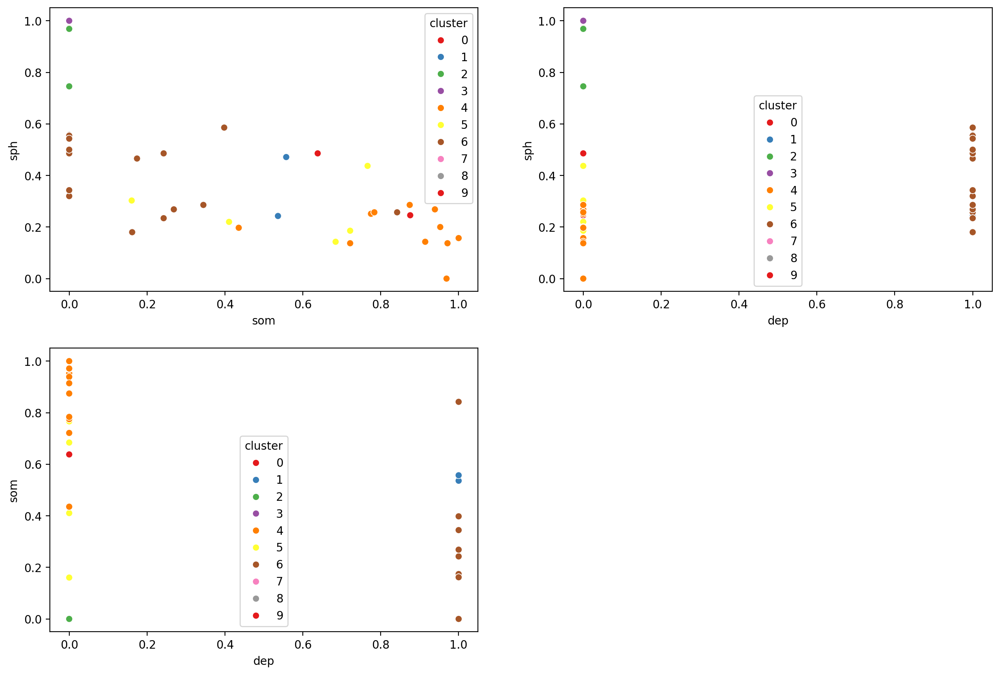

In [944]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.scatterplot(x = "som" , y = "sph", hue = 'cluster', data = without_outliers_ds2, palette = "Set1", legend = "full")
plt.subplot(2,2,2)
sns.scatterplot(x = "dep" , y = "sph", hue = 'cluster', data = without_outliers_ds2, palette = "Set1",legend = "full")
plt.subplot(2,2,3)
sns.scatterplot(x = "dep" , y = "som", hue = 'cluster', data = without_outliers_ds2, palette = "Set1", legend = "full")

plt.show()

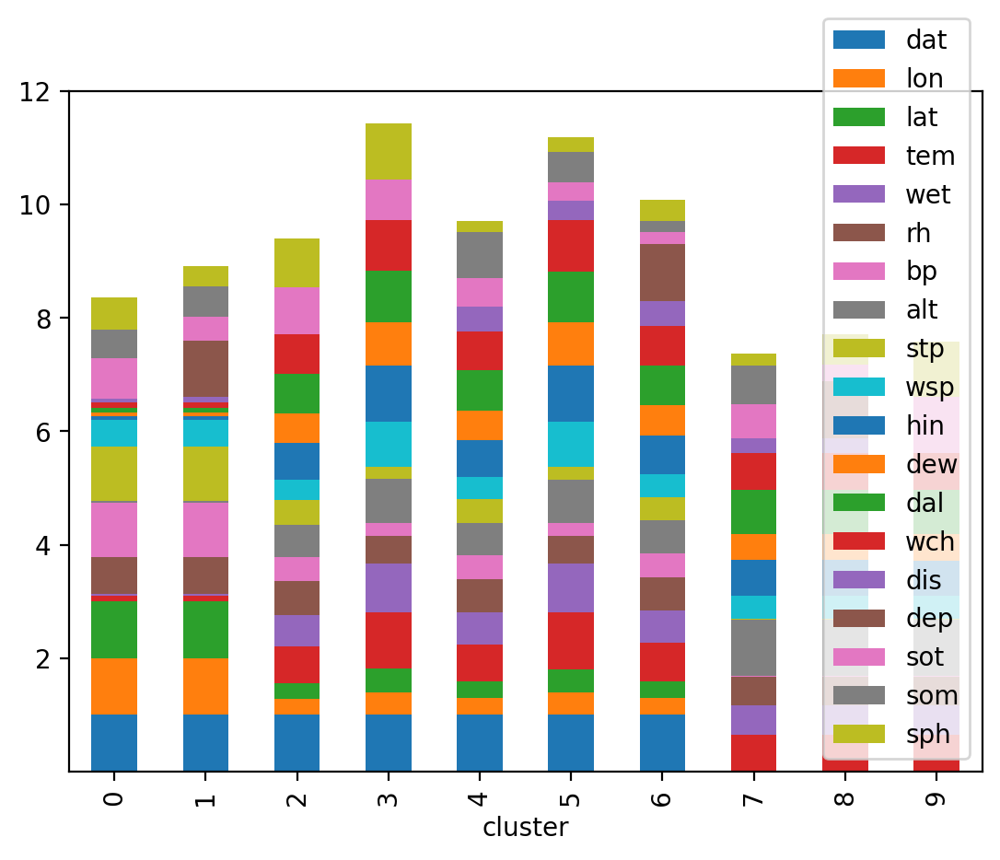

In [945]:
without_outliers_ds2.groupby('cluster').mean(['dis','dep','sot','som','sph']).plot(kind = 'bar',stacked=True);

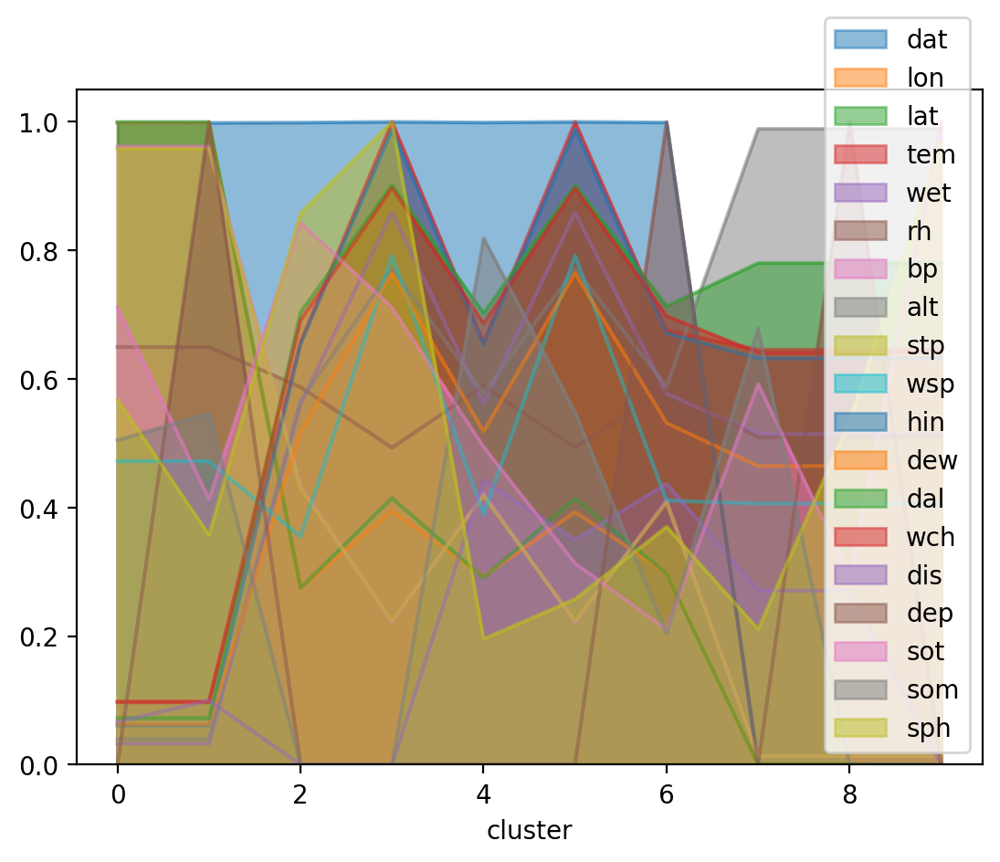

In [946]:
without_outliers_ds2.groupby('cluster').mean(['dis','dep','sot','som','sph']).plot.area(stacked=False);

In [1048]:
cluster_labels = cut_tree(complete_clustering, n_clusters=4).reshape(-1, )
#features["cluster"] = cluster_labels
without_outliers_ds2["cluster"] = cluster_labels

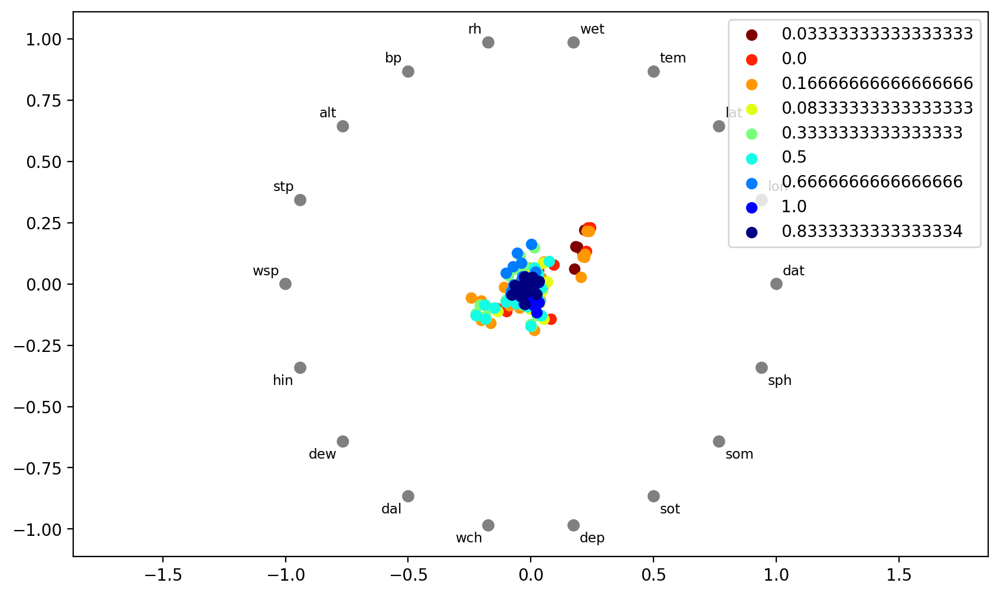

In [1016]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
radviz(without_outliers_ds2.iloc[:,:-1], 'dis',colormap='jet_r')
ax.legend();
#ax.get_legend().remove()

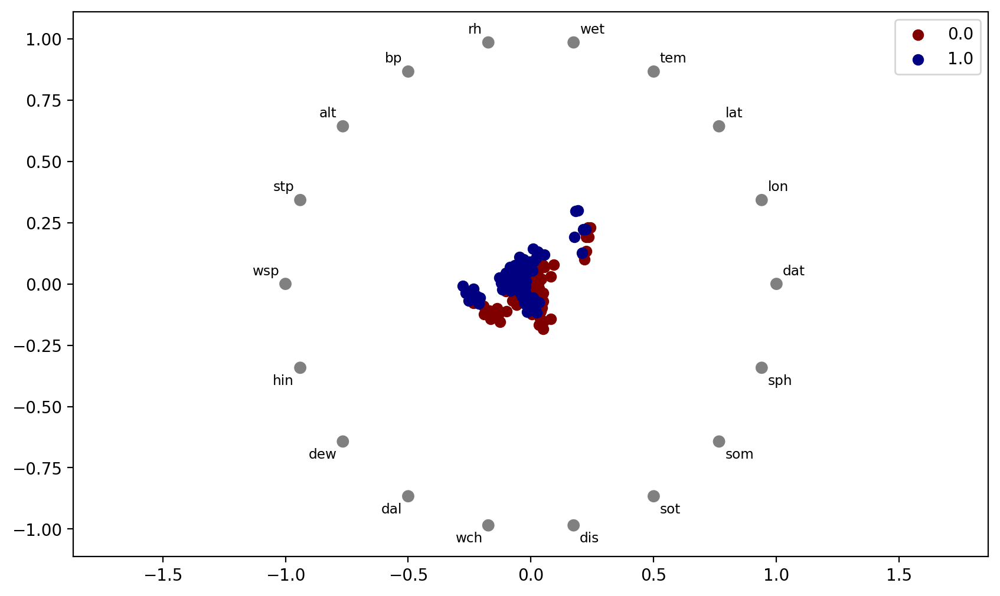

In [1017]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
radviz(without_outliers_ds2.iloc[:,:-1], 'dep',colormap='jet_r')
ax.legend();
#ax.get_legend().remove()

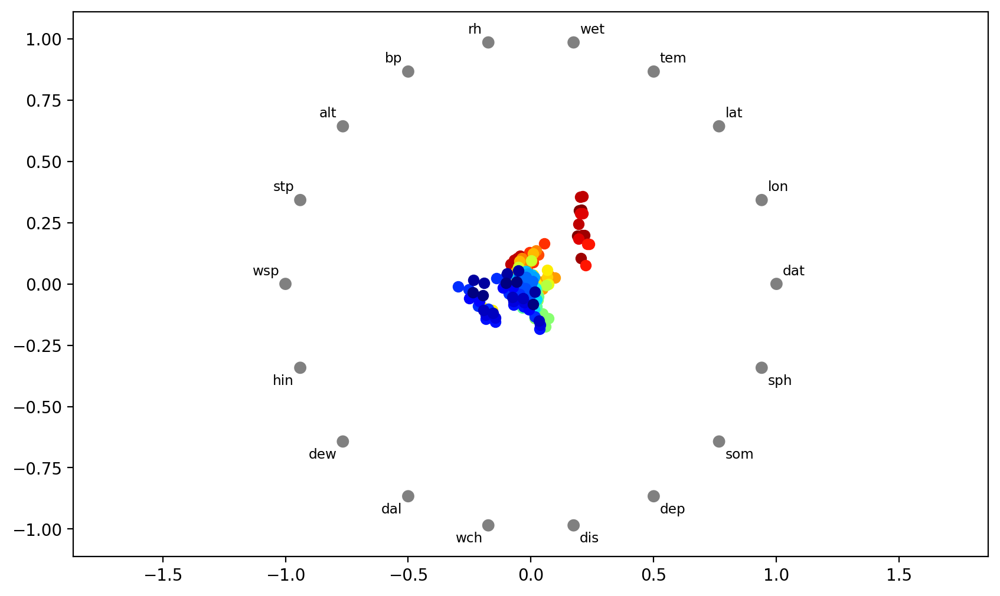

In [1018]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
radviz(without_outliers_ds2.iloc[:,:-1], 'sot',colormap='jet_r')
ax.legend();
ax.get_legend().remove()

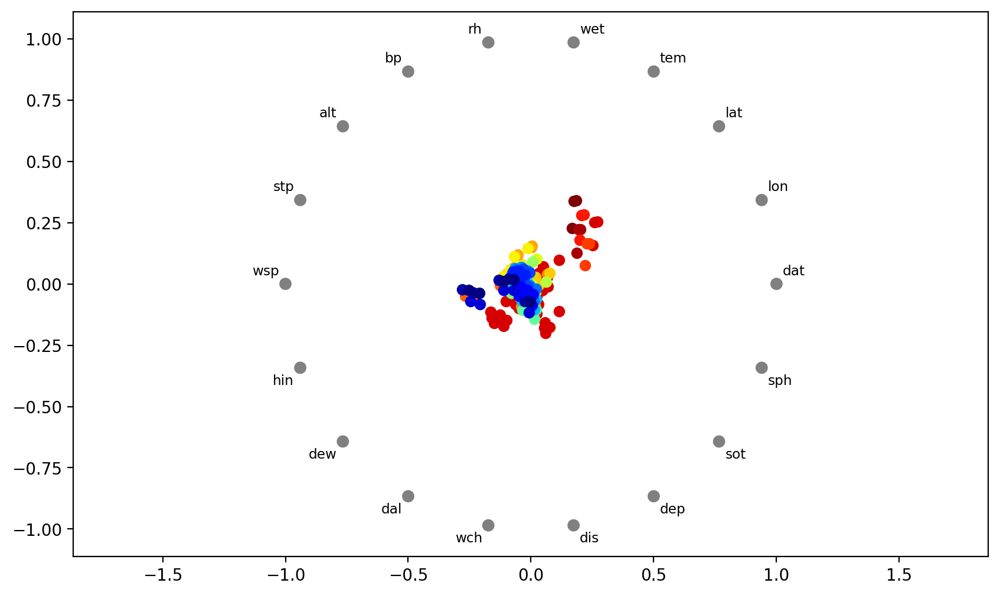

In [1019]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
radviz(without_outliers_ds2.iloc[:,:-1], 'som',colormap='jet_r')
ax.legend();
ax.get_legend().remove()

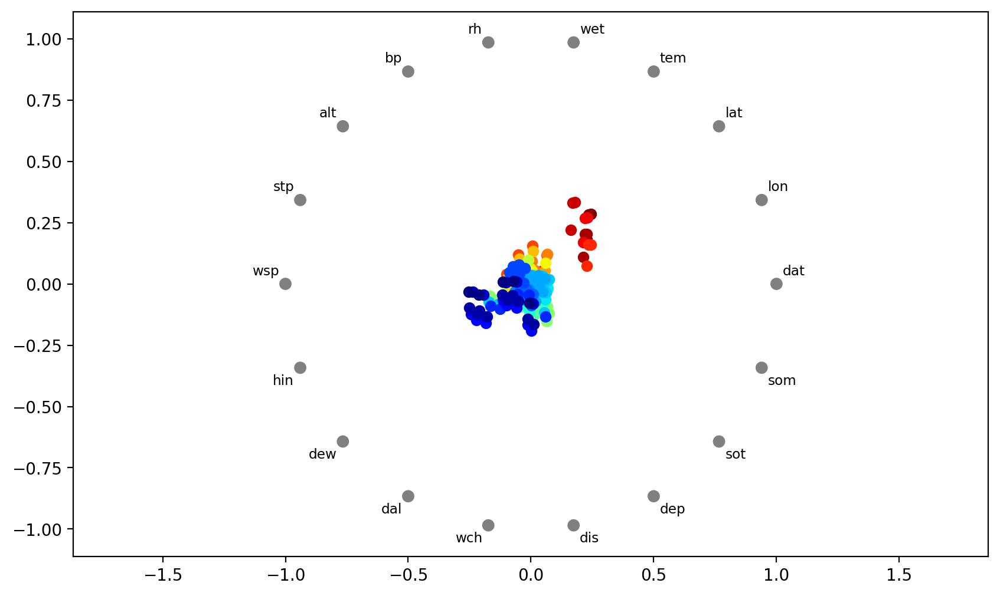

In [1020]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
radviz(without_outliers_ds2.iloc[:,:-1], 'sph',colormap='jet_r')
ax.legend();
ax.get_legend().remove()

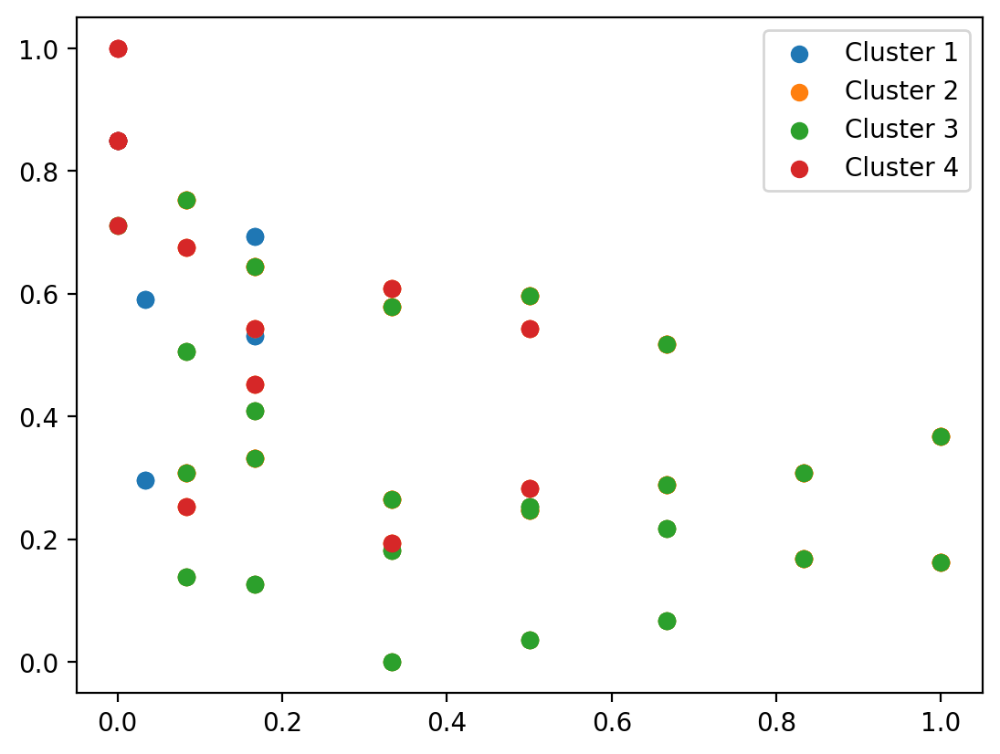

In [1037]:
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==0].dis,without_outliers_ds2[without_outliers_ds2.cluster==0].sot,label='Cluster 1');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==1].dis,without_outliers_ds2[without_outliers_ds2.cluster==1].sot, label='Cluster 2');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==2].dis,without_outliers_ds2[without_outliers_ds2.cluster==2].sot, label='Cluster 3');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==3].dis,without_outliers_ds2[without_outliers_ds2.cluster==3].sot, label='Cluster 4');
plt.legend()

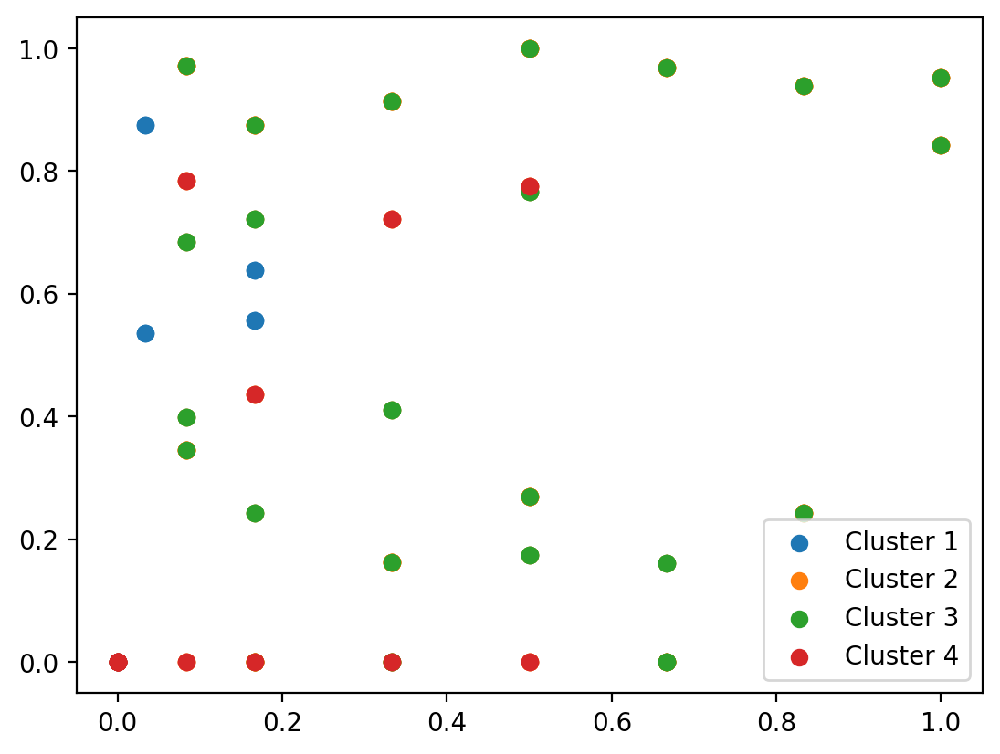

In [1036]:
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==0].dis,without_outliers_ds2[without_outliers_ds2.cluster==0].som,label='Cluster 1');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==1].dis,without_outliers_ds2[without_outliers_ds2.cluster==1].som, label='Cluster 2');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==2].dis,without_outliers_ds2[without_outliers_ds2.cluster==2].som, label='Cluster 3');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==3].dis,without_outliers_ds2[without_outliers_ds2.cluster==3].som, label='Cluster 4');
plt.legend()
plt.show()

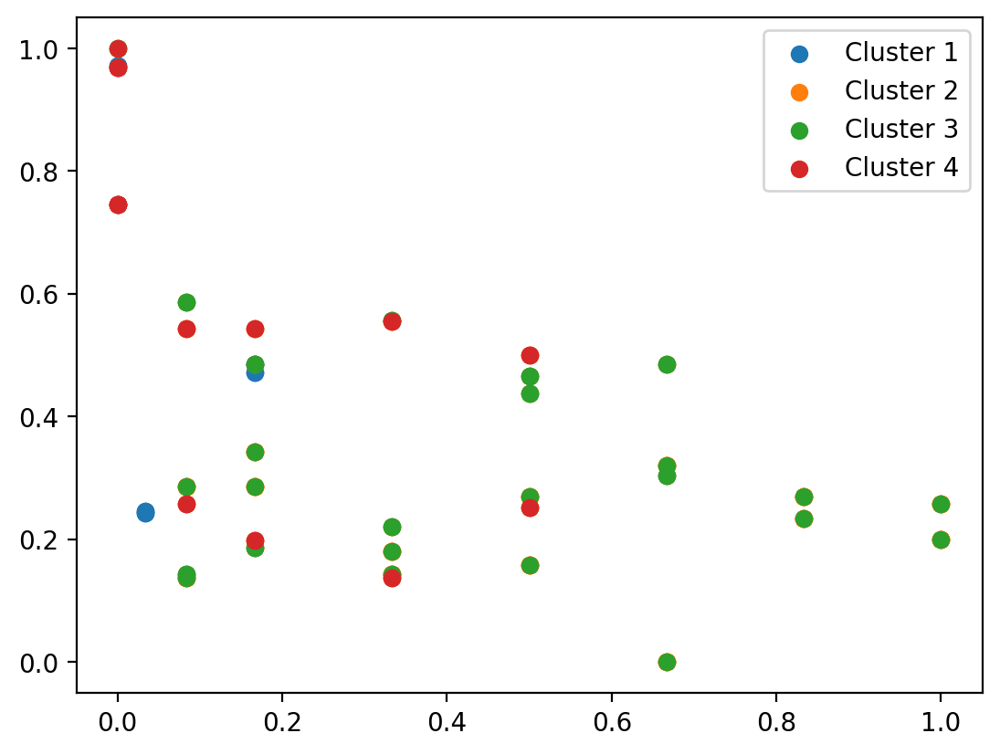

In [1035]:
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==0].dis,without_outliers_ds2[without_outliers_ds2.cluster==0].sph,label='Cluster 1');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==1].dis,without_outliers_ds2[without_outliers_ds2.cluster==1].sph, label='Cluster 2');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==2].dis,without_outliers_ds2[without_outliers_ds2.cluster==2].sph, label='Cluster 3');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==3].dis,without_outliers_ds2[without_outliers_ds2.cluster==3].sph, label='Cluster 4');
plt.legend()
plt.show()

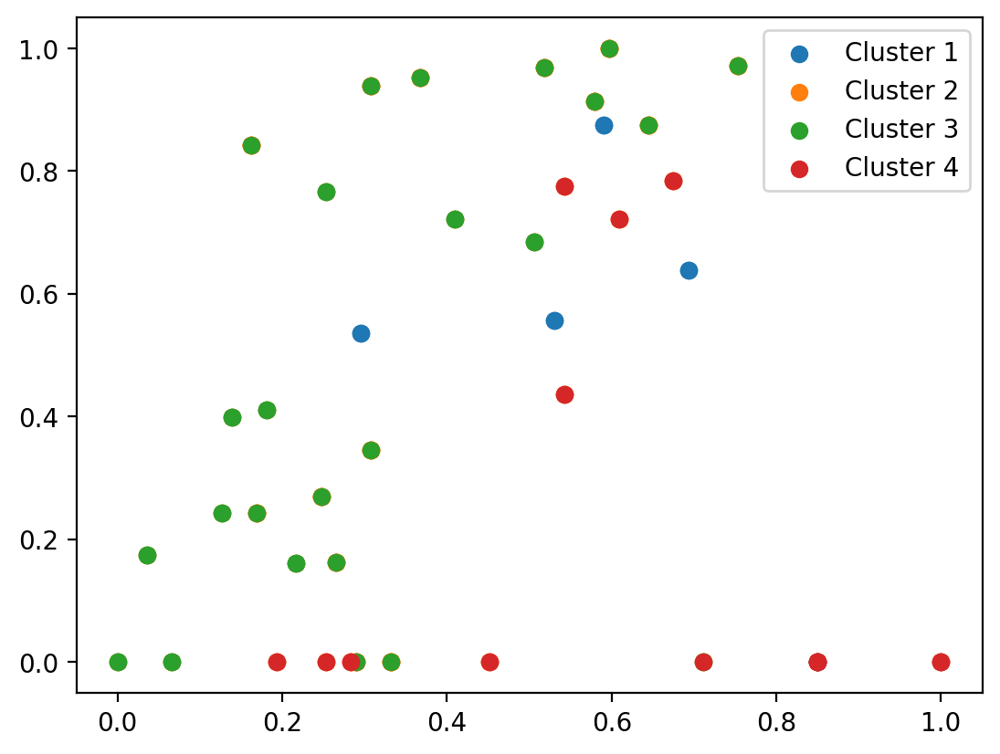

In [1031]:
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==0].sot,without_outliers_ds2[without_outliers_ds2.cluster==0].som,label='Cluster 1');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==1].sot,without_outliers_ds2[without_outliers_ds2.cluster==1].som, label='Cluster 2');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==2].sot,without_outliers_ds2[without_outliers_ds2.cluster==2].som, label='Cluster 3');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==3].sot,without_outliers_ds2[without_outliers_ds2.cluster==3].som, label='Cluster 4');
plt.legend()
plt.show()

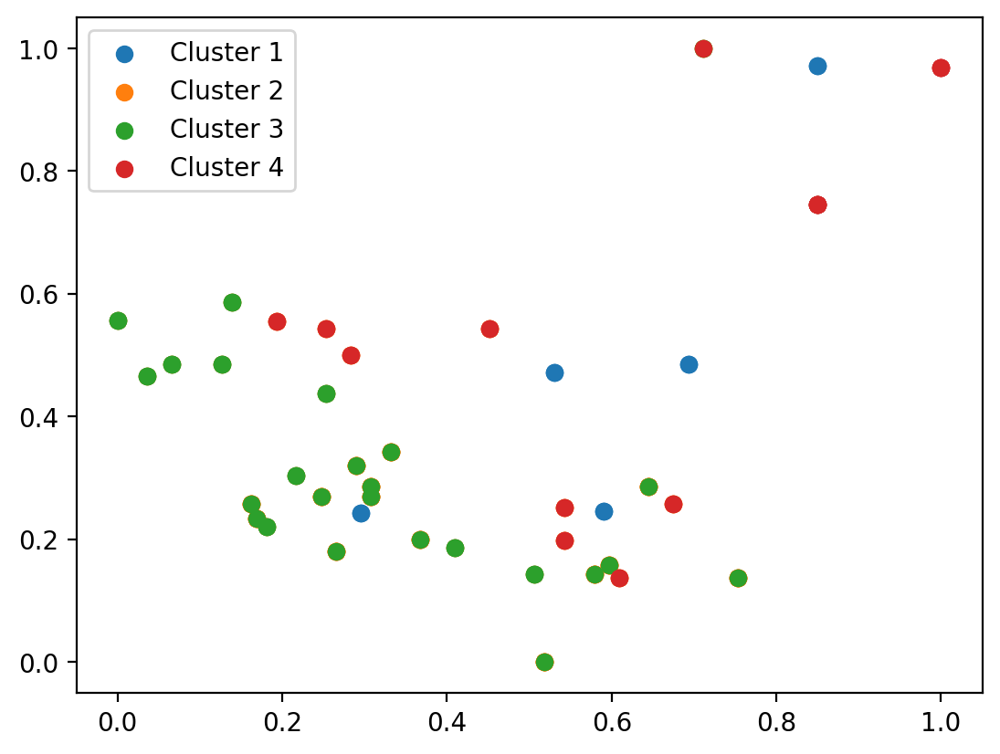

In [1032]:
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==0].sot,without_outliers_ds2[without_outliers_ds2.cluster==0].sph,label='Cluster 1');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==1].sot,without_outliers_ds2[without_outliers_ds2.cluster==1].sph, label='Cluster 2');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==2].sot,without_outliers_ds2[without_outliers_ds2.cluster==2].sph, label='Cluster 3');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==3].sot,without_outliers_ds2[without_outliers_ds2.cluster==3].sph, label='Cluster 4');
plt.legend()
plt.show()

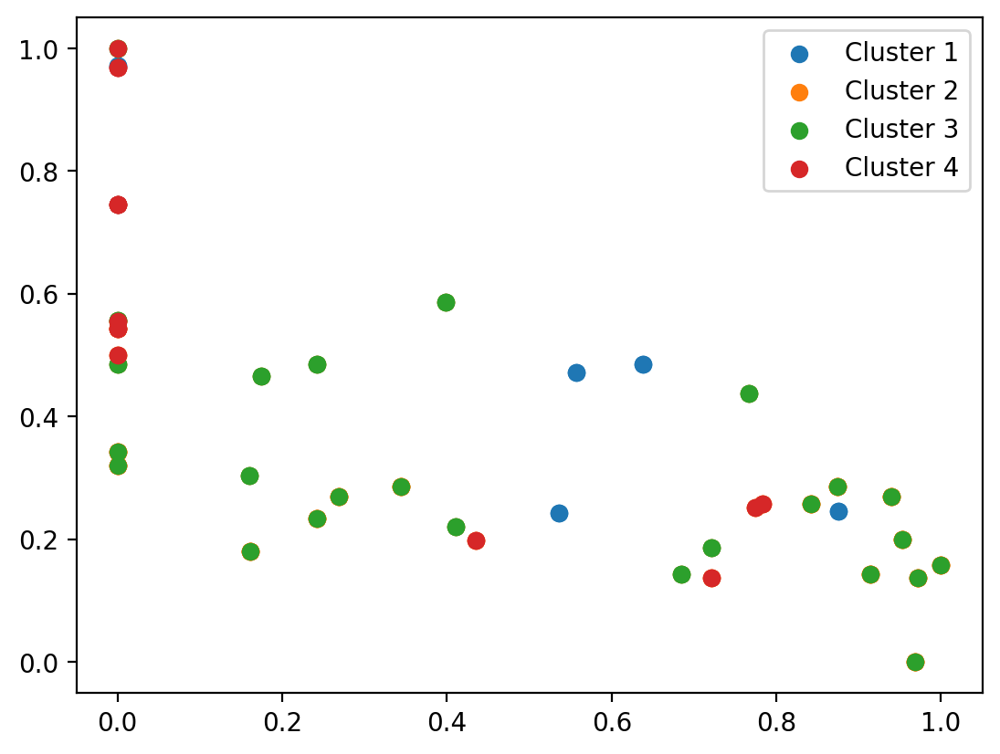

In [1039]:
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==0].som,without_outliers_ds2[without_outliers_ds2.cluster==0].sph,label='Cluster 1');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==1].som,without_outliers_ds2[without_outliers_ds2.cluster==1].sph, label='Cluster 2');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==2].som,without_outliers_ds2[without_outliers_ds2.cluster==2].sph, label='Cluster 3');
plt.scatter(without_outliers_ds2[without_outliers_ds2.cluster==3].som,without_outliers_ds2[without_outliers_ds2.cluster==3].sph, label='Cluster 4');
plt.legend()
plt.show()

2024-09-27 20:33:17,275 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:33:17,275 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:33:17,279 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-09-27 20:33:17,279 [INFO]: category.py(update:223) >> Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024

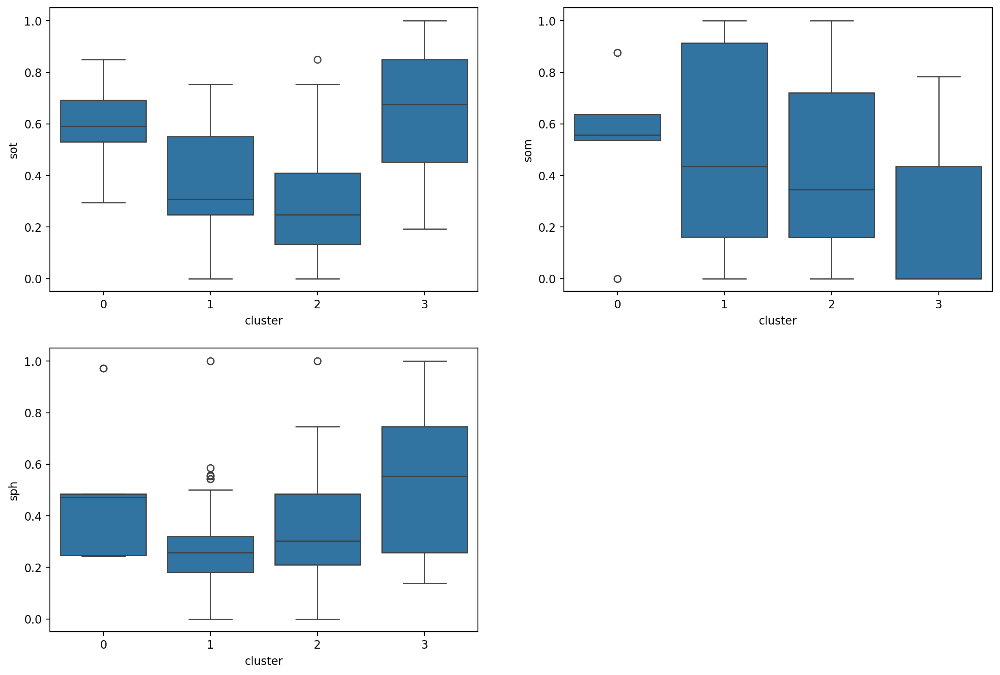

In [1041]:
plt.figure(figsize = [15,10])
plt.subplot(2,2,1)
sns.boxplot(x='cluster', y = 'sot', data = without_outliers_ds2 )
plt.subplot(2,2,2)
sns.boxplot(x='cluster', y = 'som', data = without_outliers_ds2 )
plt.subplot(2,2,3)
sns.boxplot(x='cluster', y = 'sph', data = without_outliers_ds2 )
plt.show()

In [1043]:
without_outliers_ds2[without_outliers_ds2['cluster'] == 0]\
.sort_values(by = ['sot','som', 'sph'], ascending = [True,True,False])#['dist']

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,cluster
loc,,,,,,,,,,,,,,,,,,,,
0,0.99846,1.000000,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857,0
0,0.99846,1.000000,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857,0
0,0.99846,1.000000,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,1.0,0.295359,0.536070,0.242857,0
0,0.99846,0.997006,1.000000,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.166667,1.0,0.530440,0.557214,0.471429,0
0,0.99846,0.997006,1.000000,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.166667,1.0,0.530440,0.557214,0.471429,0
0,0.99846,0.997006,1.000000,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.166667,1.0,0.530440,0.557214,0.471429,0
0,0.99846,1.000000,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0
0,0.99846,1.000000,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714,0
0,0.99846,1.000000,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714,0


In [1044]:
without_outliers_ds2[without_outliers_ds2['cluster'] == 1]\
.sort_values(by = ['sot','som', 'sph'], ascending = [True,True,False])#['dist']

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,cluster
loc,,,,,,,,,,,,,,,,,,,,
1,0.99846,0.392955,0.414025,0.506329,0.422535,0.603687,0.601770,0.380435,0.607143,0.208333,0.482759,0.400000,0.426357,0.410256,0.333333,1.0,0.000000,0.000000,0.557143,1
1,0.99846,0.392955,0.414025,0.405063,0.478873,1.000000,0.663717,0.336957,0.651786,0.354167,0.413793,0.541176,0.638243,0.692308,0.333333,1.0,0.000000,0.000000,0.557143,1
1,0.99846,0.392608,0.413693,0.506329,0.422535,0.603687,0.601770,0.380435,0.607143,0.208333,0.482759,0.400000,0.426357,0.410256,0.500000,1.0,0.036166,0.174129,0.465714,1
1,0.99846,0.392608,0.413693,0.405063,0.478873,1.000000,0.663717,0.336957,0.651786,0.354167,0.413793,0.541176,0.638243,0.692308,0.500000,1.0,0.036166,0.174129,0.465714,1
1,0.99846,0.392444,0.413553,0.506329,0.422535,0.603687,0.601770,0.380435,0.607143,0.208333,0.482759,0.400000,0.426357,0.410256,0.666667,1.0,0.066305,0.000000,0.485714,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2,0.99846,0.318268,0.308259,0.594937,0.422535,0.391705,0.548673,0.445652,0.544643,0.354167,0.574713,0.352941,0.576227,0.602564,0.083333,0.0,0.753466,0.971393,0.137143,1
2,1.00000,0.318268,0.308259,0.531646,0.492958,0.728111,0.061947,0.945652,0.053571,0.791667,0.517241,0.494118,0.689922,0.525641,0.083333,0.0,0.753466,0.971393,0.137143,1
2,0.99846,0.318268,0.308259,0.911392,0.591549,0.101382,0.548673,0.456522,0.544643,0.145833,0.862069,0.423529,0.808786,0.910256,0.083333,0.0,0.753466,0.971393,0.137143,1


In [1045]:
without_outliers_ds2[without_outliers_ds2['cluster'] == 2]\
.sort_values(by = ['sot','som', 'sph'], ascending = [True,True,False])#['dist']

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,cluster
loc,,,,,,,,,,,,,,,,,,,,
1,0.99846,0.392955,0.414025,0.683544,0.647887,0.728111,0.646018,0.347826,0.642857,0.000000,0.712644,0.635294,0.764858,0.871795,0.333333,1.0,0.000000,0.000000,0.557143,2
1,0.99846,0.392955,0.414025,0.860759,0.873239,0.815668,0.707965,0.282609,0.714286,0.000000,0.908046,0.847059,1.000000,1.000000,0.333333,1.0,0.000000,0.000000,0.557143,2
1,1.00000,0.392955,0.414025,1.000000,0.859155,0.493088,0.221239,0.771739,0.223214,0.791667,0.988506,0.764706,0.901809,0.897436,0.333333,1.0,0.000000,0.000000,0.557143,2
1,0.99846,0.392608,0.413693,0.683544,0.647887,0.728111,0.646018,0.347826,0.642857,0.000000,0.712644,0.635294,0.764858,0.871795,0.500000,1.0,0.036166,0.174129,0.465714,2
1,0.99846,0.392608,0.413693,0.860759,0.873239,0.815668,0.707965,0.282609,0.714286,0.000000,0.908046,0.847059,1.000000,1.000000,0.500000,1.0,0.036166,0.174129,0.465714,2
1,1.00000,0.392608,0.413693,1.000000,0.859155,0.493088,0.221239,0.771739,0.223214,0.791667,0.988506,0.764706,0.901809,0.897436,0.500000,1.0,0.036166,0.174129,0.465714,2
1,0.99846,0.392444,0.413553,0.683544,0.647887,0.728111,0.646018,0.347826,0.642857,0.000000,0.712644,0.635294,0.764858,0.871795,0.666667,1.0,0.066305,0.000000,0.485714,2
1,0.99846,0.392444,0.413553,0.860759,0.873239,0.815668,0.707965,0.282609,0.714286,0.000000,0.908046,0.847059,1.000000,1.000000,0.666667,1.0,0.066305,0.000000,0.485714,2
1,1.00000,0.392444,0.413553,1.000000,0.859155,0.493088,0.221239,0.771739,0.223214,0.791667,0.988506,0.764706,0.901809,0.897436,0.666667,1.0,0.066305,0.000000,0.485714,2


In [1046]:
without_outliers_ds2[without_outliers_ds2['cluster'] == 3]\
.sort_values(by = ['sot','som', 'sph'], ascending = [True,True,False])#['dist']

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,cluster
loc,,,,,,,,,,,,,,,,,,,,
3,7.702889e-09,0.000932,0.000931,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.333333,1.0,0.192887,0.000000,0.554286,3
3,0.000000e+00,0.000932,0.000931,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.333333,1.0,0.192887,0.000000,0.554286,3
3,7.702889e-09,0.000000,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857,3
3,0.000000e+00,0.000000,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857,3
3,7.702889e-09,0.001538,0.001152,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.500000,1.0,0.283303,0.000000,0.500000,3
3,0.000000e+00,0.001538,0.001152,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.500000,1.0,0.283303,0.000000,0.500000,3
3,7.702889e-09,0.000772,0.000739,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.166667,1.0,0.452080,0.000000,0.542857,3
3,0.000000e+00,0.000772,0.000739,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.166667,1.0,0.452080,0.000000,0.542857,3
3,7.702889e-09,0.000772,0.000739,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.166667,0.0,0.542495,0.435323,0.197143,3


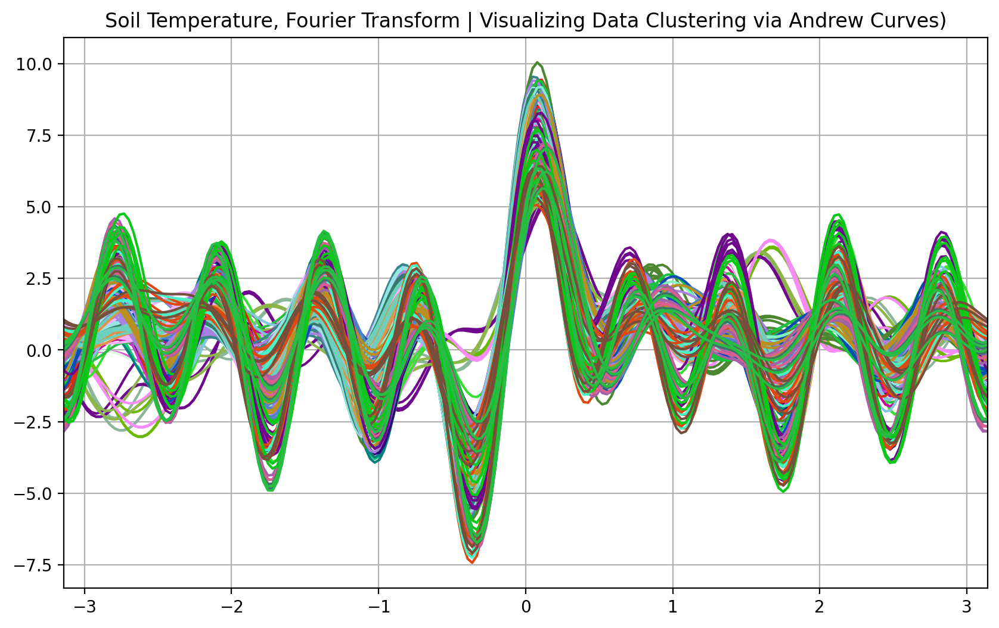

In [980]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
andrews_curves(without_outliers_ds2, "sot")#,colormap="winter");
plt.title('Soil Temperature, Fourier Transform | Visualizing Data Clustering via Andrew Curves)')
#andrews_curves(without_outliers, "sm");
#andrews_curves(without_outliers, "ph");
ax.legend()
ax.get_legend().remove()
#Andrews curves allow one to plot multivariate data as a large number of curves that are created using the attributes of samples as coefficients for 
#Fourier series, see the Wikipedia entry for more information. By coloring these curves differently for each class it is possible to visualize data 
#clustering. Curves belonging to samples of the same class will usually be closer together and form larger structures

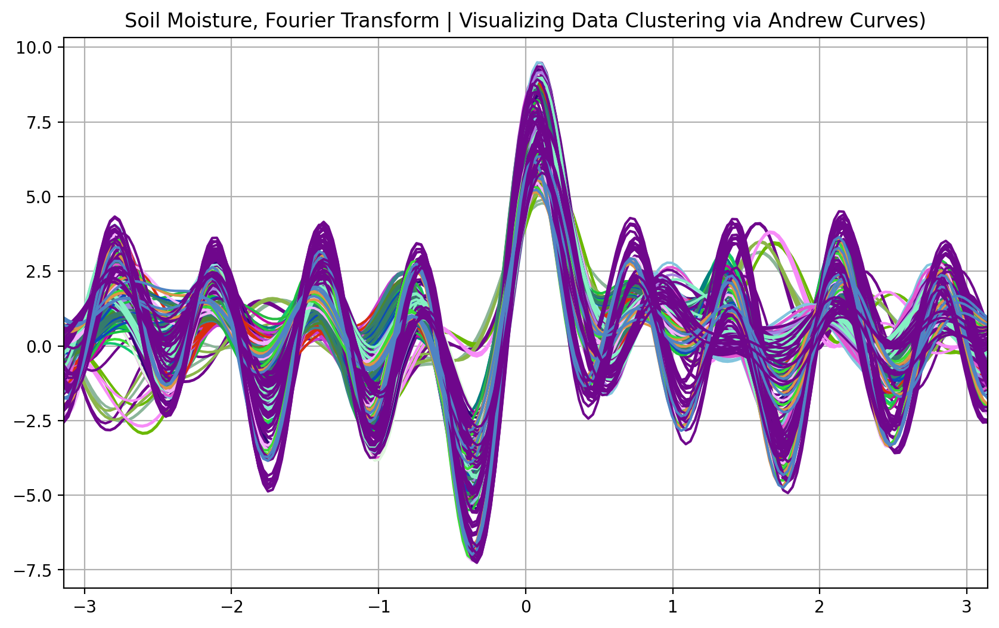

In [981]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
#andrews_curves(without_outliers, "st");
andrews_curves(without_outliers_ds2, "som");
plt.title('Soil Moisture, Fourier Transform | Visualizing Data Clustering via Andrew Curves)')
#andrews_curves(without_outliers, "ph");
ax.legend()
ax.get_legend().remove()

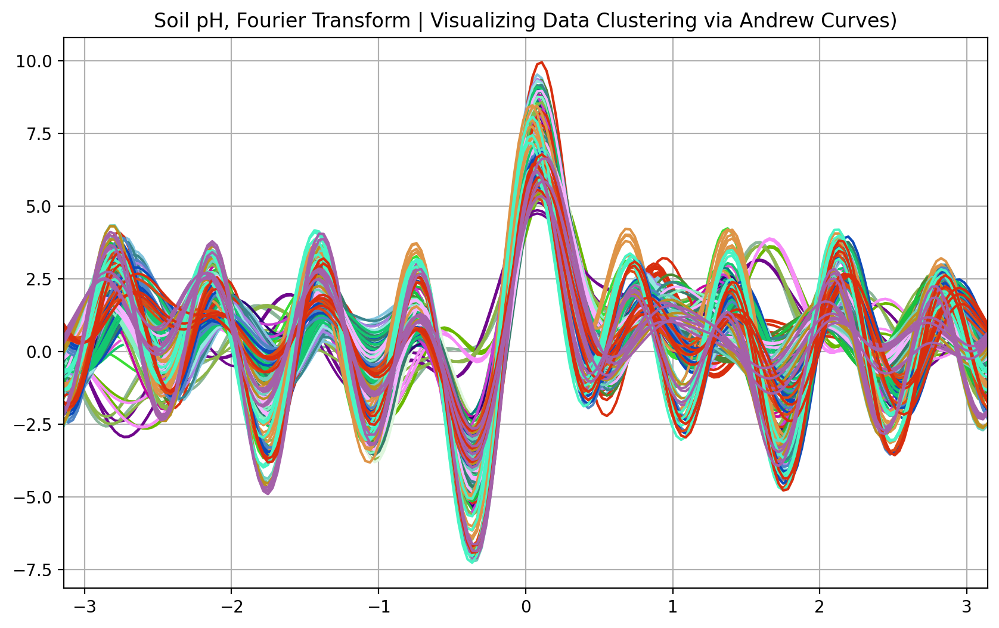

In [982]:
fig,ax=plt.subplots(1,1,figsize=(10,6))
#andrews_curves(without_outliers, "st");
#andrews_curves(without_outliers, "sm");
andrews_curves(without_outliers_ds2, "sph");
plt.title('Soil pH, Fourier Transform | Visualizing Data Clustering via Andrew Curves)')
ax.legend()
ax.get_legend().remove()

In [983]:
def df_autocorr(df, lag=1, axis=0):
    """Compute full-sample column-wise autocorrelation for a DataFrame."""
    return df.apply(lambda col: col.autocorr(lag), axis=axis)

def df_rolling_autocorr(df, window, lag=1):
    """Compute rolling column-wise autocorrelation for a DataFrame."""

    return (df.rolling(window=window)
        .corr(df.shift(lag))) # could .dropna() here

In [985]:
#Original
df_autocorr(without_outliers)

lon    0.926390
lat    0.930825
dis    0.830902
dep   -0.813841
sot    0.139596
som   -0.420872
sph   -0.095478
dtype: float64

In [986]:
#Original
df_autocorr(without_outliers2)

dat    0.444919
tem    0.697182
wet    0.626853
rh     0.059416
bp     0.623734
alt    0.619816
stp    0.616751
wsp   -0.089795
hin    0.694907
dew    0.486277
dal    0.853240
wch    0.755503
dt          NaN
dtype: float64

In [987]:
df_autocorr(without_outliers_ds)

dat    0.458880
lon    0.979964
lat    0.981227
tem    0.582086
wet    0.464813
rh     0.026084
bp     0.456408
alt    0.448597
stp    0.447782
wsp    0.090256
hin    0.579185
dew    0.314717
dal    0.681208
wch    0.597895
dis    0.974534
dep    0.698457
sot    0.846358
som    0.781717
sph    0.796748
dt          NaN
dtype: float64

In [988]:
df_autocorr(without_outliers_ds2.iloc[:,:-1])

dat    0.458880
lon    0.979964
lat    0.981227
tem    0.582086
wet    0.464813
rh     0.026084
bp     0.456408
alt    0.448597
stp    0.447782
wsp    0.090256
hin    0.579185
dew    0.314717
dal    0.681208
wch    0.597895
dis    0.974534
dep    0.698457
sot    0.846358
som    0.781717
sph    0.796748
dtype: float64

In [989]:
df_rolling_autocorr(without_outliers_ds2.iloc[:,:-1], window=3).dropna().head()

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,,,
0,-0.498785,0.5,0.5,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,-0.500000,0.5,0.5,0.5,0.5,0.5
1,-0.603945,0.5,0.5,0.590795,0.680855,-0.360100,0.519861,0.569411,0.569176,-0.185343,0.607512,0.496427,0.999900,0.915001,0.5,0.5,0.5,0.5,0.5
1,-0.499960,0.5,0.5,0.395207,0.418866,-0.378792,-0.567076,-0.583324,-0.595355,-0.853574,0.466321,0.298936,0.221535,0.072512,0.5,0.5,0.5,0.5,0.5
1,-0.499960,0.5,0.5,0.395207,0.418866,-0.378792,-0.567076,-0.583324,-0.595355,-0.853574,0.466321,0.298936,0.221535,0.072512,0.5,0.5,0.5,0.5,0.5
1,-0.499960,0.5,0.5,0.395207,0.418866,-0.378792,-0.567076,-0.583324,-0.595355,-0.853574,0.466321,0.298936,0.221535,0.072512,0.5,0.5,0.5,0.5,0.5


In [912]:
#Updated DF (Features)
#df_autocorr(features)

In [913]:
#df_autocorr(features2)

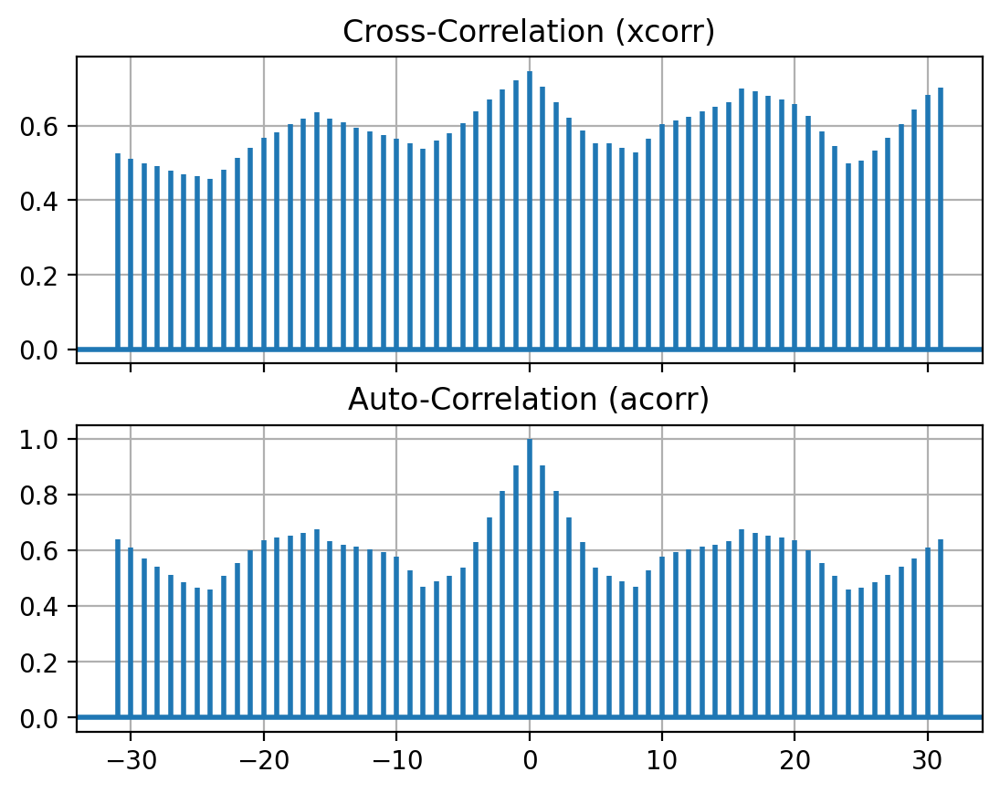

In [990]:
import matplotlib.pyplot as plt
import numpy as np

fig, [ax1, ax2] = plt.subplots(2, 1, sharex=True)
ax1.xcorr(without_outliers_ds2.iloc[:,:-1].sot, without_outliers_ds2.iloc[:,:-1].som, usevlines=True, maxlags=31, normed=True, lw=2)
ax1.grid(True)
ax1.set_title('Cross-Correlation (xcorr)')

ax2.acorr(without_outliers_ds2.iloc[:,:-1].som, usevlines=True, normed=True, maxlags=31, lw=2)
ax2.grid(True)
ax2.set_title('Auto-Correlation (acorr)')

plt.show()

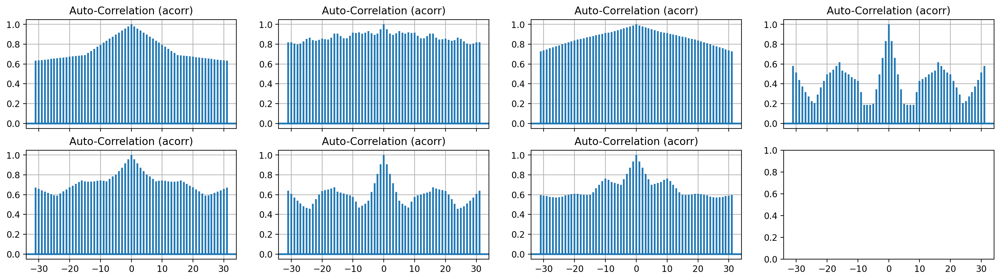

In [991]:
import matplotlib.pyplot as plt
import numpy as np

fig, axes = plt.subplots(2, 4, figsize=(20,5), sharex=True)

axes[0,0].acorr(without_outliers_ds2.iloc[:,:-1].lon, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,0].grid(True)
axes[0,0].set_title('Auto-Correlation (acorr)')

axes[0,1].acorr(without_outliers_ds2.iloc[:,:-1].hin, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,1].grid(True)
axes[0,1].set_title('Auto-Correlation (acorr)')

axes[0,2].acorr(without_outliers_ds2.iloc[:,:-1].dis, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,2].grid(True)
axes[0,2].set_title('Auto-Correlation (acorr)')

axes[0,3].acorr(without_outliers_ds2.iloc[:,:-1].dep, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,3].grid(True)
axes[0,3].set_title('Auto-Correlation (acorr)')

axes[1,0].acorr(without_outliers_ds2.iloc[:,:-1].sot, usevlines=True, normed=True, maxlags=31, lw=2)
axes[1,0].grid(True)
axes[1,0].set_title('Auto-Correlation (acorr)')

axes[1,1].acorr(without_outliers_ds2.iloc[:,:-1].som, usevlines=True, normed=True, maxlags=31, lw=2)
axes[1,1].grid(True)
axes[1,1].set_title('Auto-Correlation (acorr)')

axes[1,2].acorr(without_outliers_ds2.iloc[:,:-1].sph, usevlines=True, normed=True, maxlags=31, lw=2)
axes[1,2].grid(True)
axes[1,2].set_title('Auto-Correlation (acorr)')

plt.show()

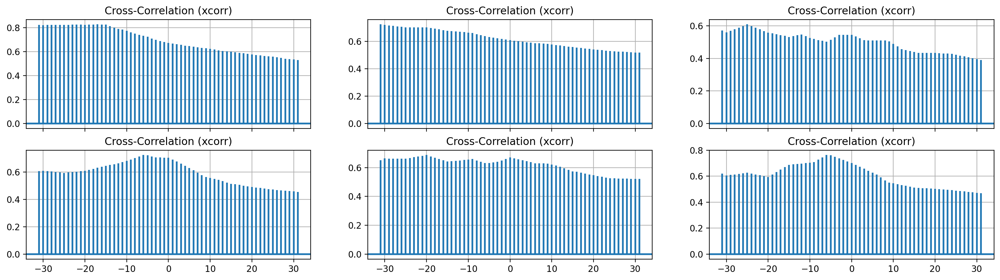

In [992]:
import matplotlib.pyplot as plt
import numpy as np

fig, axes = plt.subplots(2, 3, figsize=(20,5), sharex=True)

axes[0,0].xcorr(without_outliers_ds2.iloc[:,:-1].lon,without_outliers_ds2.iloc[:,:-1].hin, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,0].grid(True)
axes[0,0].set_title('Cross-Correlation (xcorr)')

axes[0,1].xcorr(without_outliers_ds2.iloc[:,:-1].lon,without_outliers_ds2.iloc[:,:-1].dis, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,1].grid(True)
axes[0,1].set_title('Cross-Correlation (xcorr)')

axes[0,2].xcorr(without_outliers_ds2.iloc[:,:-1].lon,without_outliers_ds2.iloc[:,:-1].dep, usevlines=True, normed=True, maxlags=31, lw=2)
axes[0,2].grid(True)
axes[0,2].set_title('Cross-Correlation (xcorr)')

axes[1,0].xcorr(without_outliers_ds2.iloc[:,:-1].lon,without_outliers_ds2.iloc[:,:-1].sot, usevlines=True, normed=True, maxlags=31, lw=2)
axes[1,0].grid(True)
axes[1,0].set_title('Cross-Correlation (xcorr)')

axes[1,1].xcorr(without_outliers_ds2.iloc[:,:-1].lon,without_outliers_ds2.iloc[:,:-1].som, usevlines=True, normed=True, maxlags=31, lw=2)
axes[1,1].grid(True)
axes[1,1].set_title('Cross-Correlation (xcorr)')

axes[1,2].xcorr(without_outliers_ds2.iloc[:,:-1].lon,without_outliers_ds2.iloc[:,:-1].sph, usevlines=True, normed=True, maxlags=31, lw=2)
axes[1,2].grid(True)
axes[1,2].set_title('Cross-Correlation (xcorr)')

plt.show()

In [ ]:
# # Calculate the autocorrelation
# acf = np.correlate(features.ph, features.ph, mode='full')

# # Plot the autocorrelation
# plt.plot(acf)
# plt.xlabel('Lag')
# plt.ylabel('Autocorrelation')
# plt.title('Autocorrelation Plot')
# plt.show()

[1.         0.97000278 0.94000556 0.91000835 0.88027593 0.85054351
 0.8227971  0.79584036 0.76888361 0.74987089 0.73326504 0.71254295
 0.69049685 0.66845075 0.64640465 0.62462336 0.60244486 0.58059736
 0.55874987 0.53425436 0.50975886 0.48462501 0.46015317 0.43568133
 0.41120949 0.38263324 0.35897946 0.33664969 0.31431992 0.28934214
 0.26436436 0.23738874]
[1.         0.97000278 0.94000556 0.91000835 0.88027593 0.85054351
 0.8227971  0.79584036 0.76888361 0.74987089 0.73326504 0.71254295
 0.69049685 0.66845075 0.64640465 0.62462336 0.60244486 0.58059736
 0.55874987 0.53425436 0.50975886 0.48462501 0.46015317 0.43568133
 0.41120949 0.38263324 0.35897946 0.33664969 0.31431992 0.28934214
 0.26436436 0.23738874]


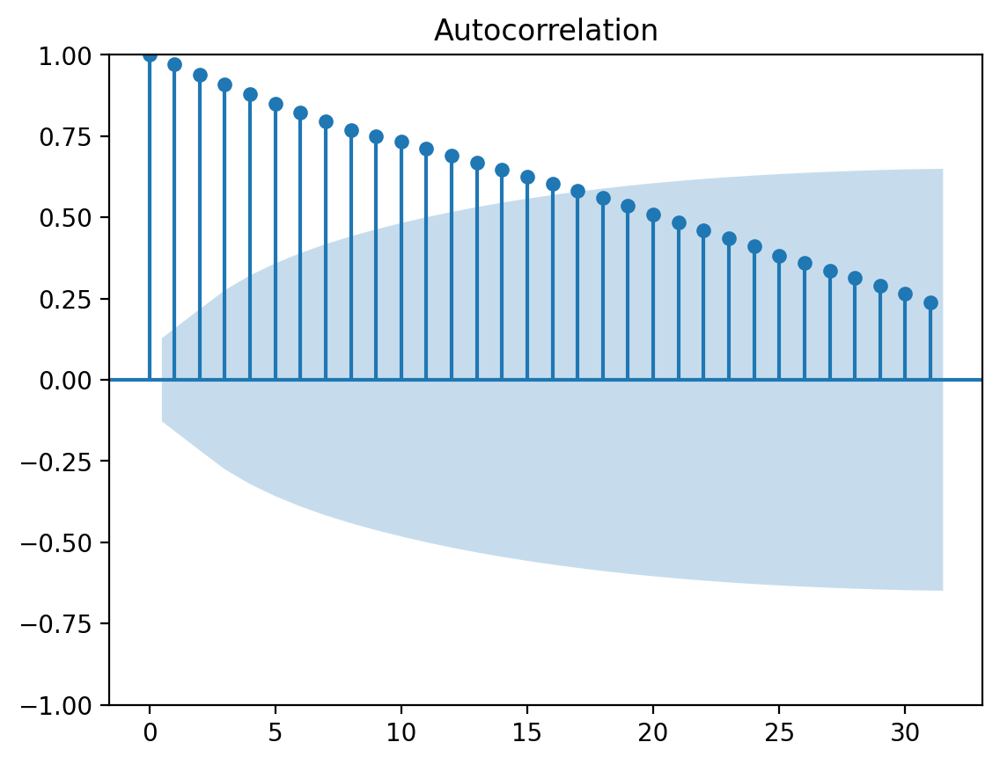

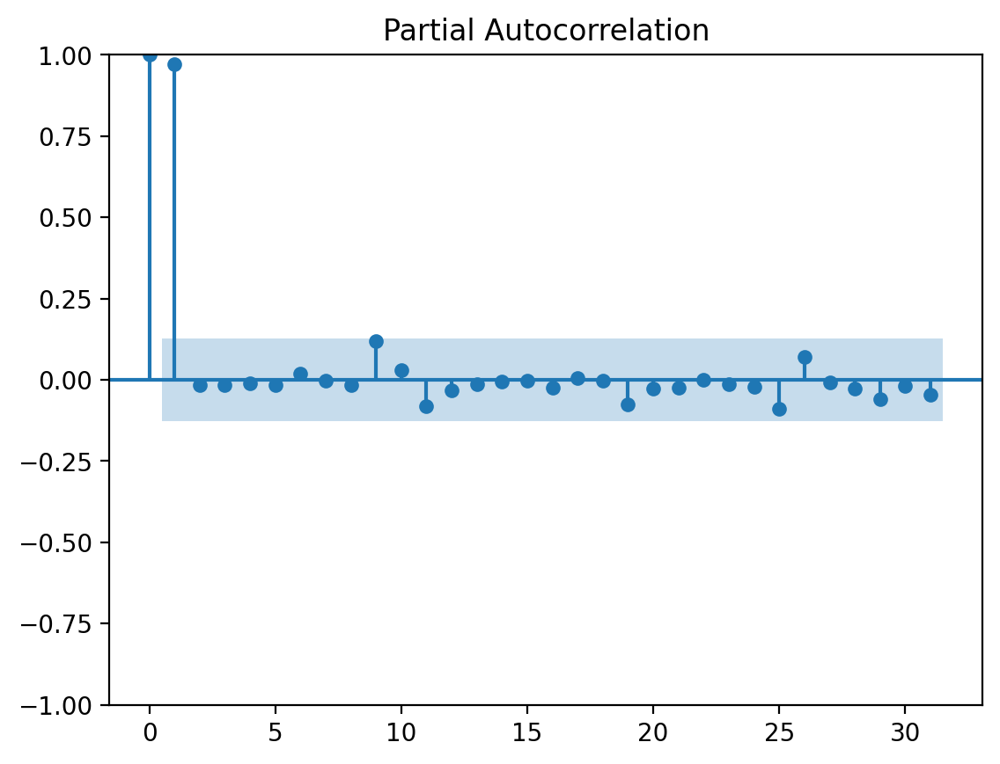

In [1006]:
import statsmodels.api as sm
# autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].dis, nlags=31))
# partial autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].dis, nlags=31))

sm.graphics.tsa.plot_acf(without_outliers_ds2.iloc[:,:-1].dis, lags=31)
plt.show()

sm.graphics.tsa.plot_pacf(without_outliers_ds2.iloc[:,:-1].dis, lags=31)
plt.show()

[ 1.00000000e+00  8.44489438e-01  6.88978876e-01  5.33468314e-01
  4.01499531e-01  2.69530749e-01  2.08167659e-01  1.44607026e-01
  8.10463938e-02  1.35474870e-01  1.80762141e-01  2.02974867e-01
  2.21582839e-01  2.46531313e-01  2.77169750e-01  3.20563467e-01
  3.88158389e-01  3.46532070e-01  2.98112179e-01  2.42712931e-01
  1.99303646e-01  1.35130606e-01  7.09631126e-02  4.09660518e-04
 -5.95458180e-02 -3.51001662e-02  9.27974555e-03  5.50516466e-02
  1.09383449e-01  1.52598749e-01  2.14669679e-01  2.86481489e-01]
[ 1.00000000e+00  8.44489438e-01  6.88978876e-01  5.33468314e-01
  4.01499531e-01  2.69530749e-01  2.08167659e-01  1.44607026e-01
  8.10463938e-02  1.35474870e-01  1.80762141e-01  2.02974867e-01
  2.21582839e-01  2.46531313e-01  2.77169750e-01  3.20563467e-01
  3.88158389e-01  3.46532070e-01  2.98112179e-01  2.42712931e-01
  1.99303646e-01  1.35130606e-01  7.09631126e-02  4.09660518e-04
 -5.95458180e-02 -3.51001662e-02  9.27974555e-03  5.50516466e-02
  1.09383449e-01  1.5259

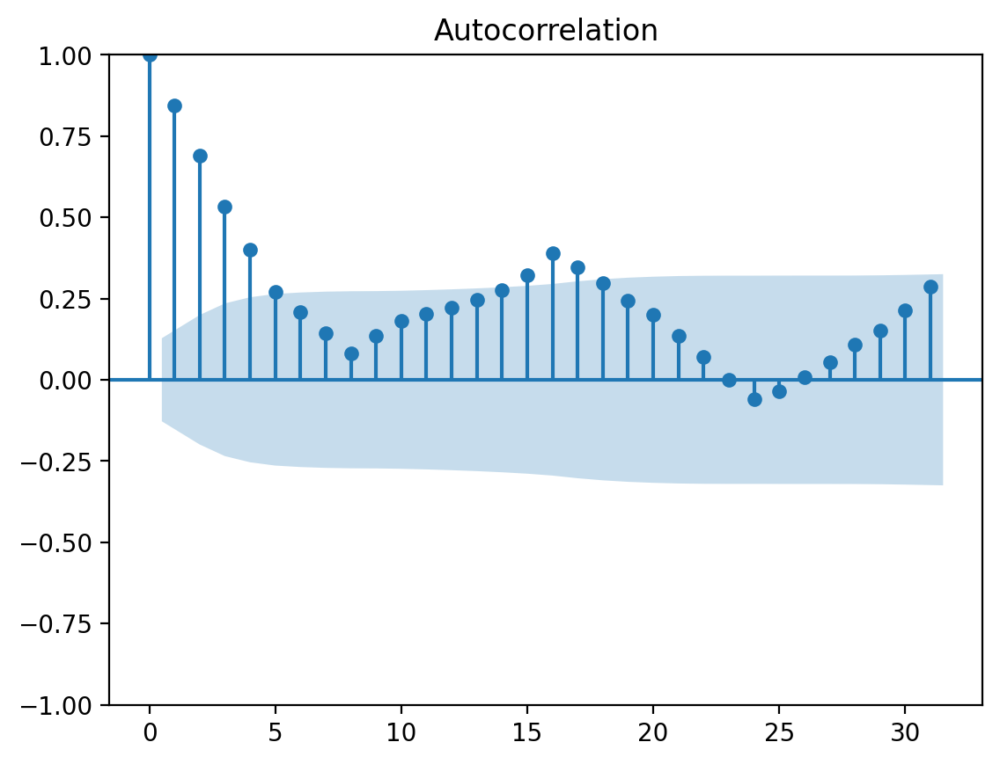

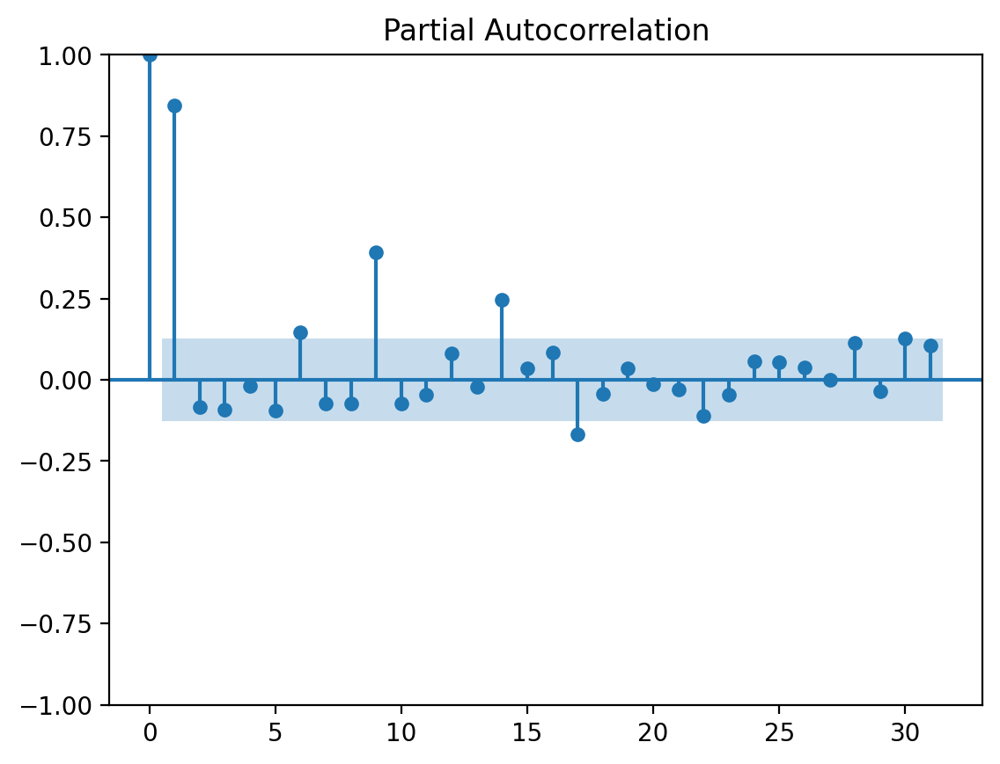

In [1007]:
import statsmodels.api as sm
# autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].sot, nlags=31))
# partial autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].sot, nlags=31))

sm.graphics.tsa.plot_acf(without_outliers_ds2.iloc[:,:-1].sot, lags=31)
plt.show()

sm.graphics.tsa.plot_pacf(without_outliers_ds2.iloc[:,:-1].sot, lags=31)
plt.show()

[ 1.          0.77730396  0.55460792  0.33191188  0.11822145 -0.09546899
 -0.15892769 -0.20042524 -0.24192279 -0.09724863  0.03011918  0.0721288
  0.1007338   0.12481815  0.14360914  0.17366209  0.2709802   0.23616067
  0.20847459  0.18518084  0.15441148  0.07875466 -0.02163399 -0.12675777
 -0.23786052 -0.21109475 -0.16888876 -0.10551992 -0.03778491  0.03449912
  0.11969197  0.21067494]
[ 1.          0.77730396  0.55460792  0.33191188  0.11822145 -0.09546899
 -0.15892769 -0.20042524 -0.24192279 -0.09724863  0.03011918  0.0721288
  0.1007338   0.12481815  0.14360914  0.17366209  0.2709802   0.23616067
  0.20847459  0.18518084  0.15441148  0.07875466 -0.02163399 -0.12675777
 -0.23786052 -0.21109475 -0.16888876 -0.10551992 -0.03778491  0.03449912
  0.11969197  0.21067494]


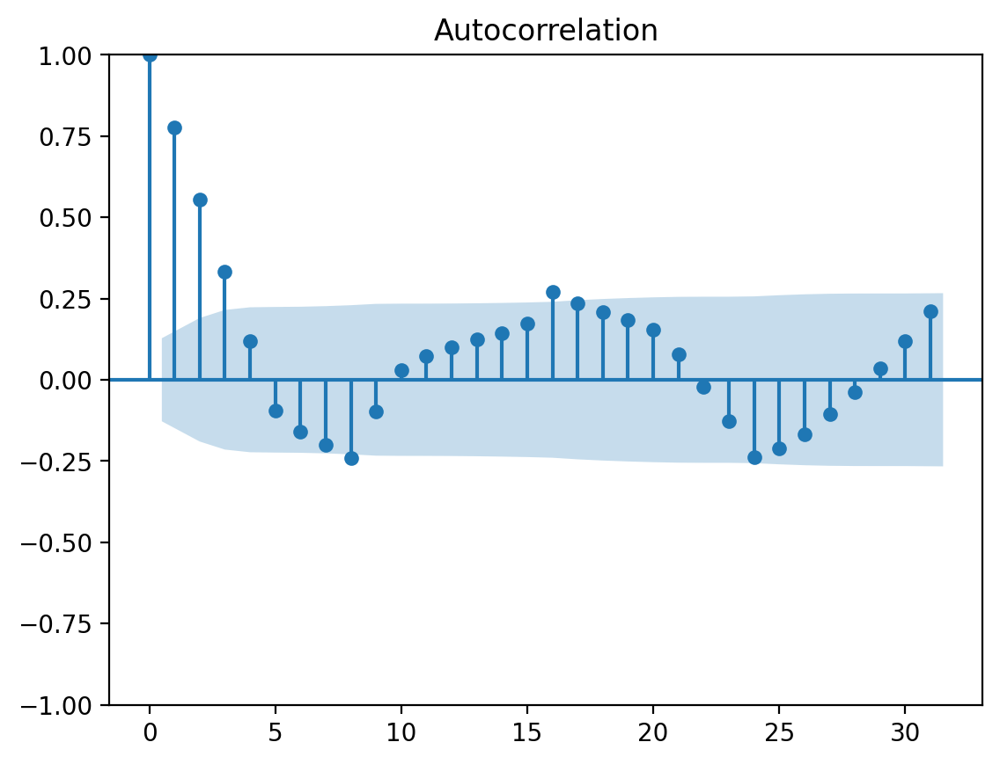

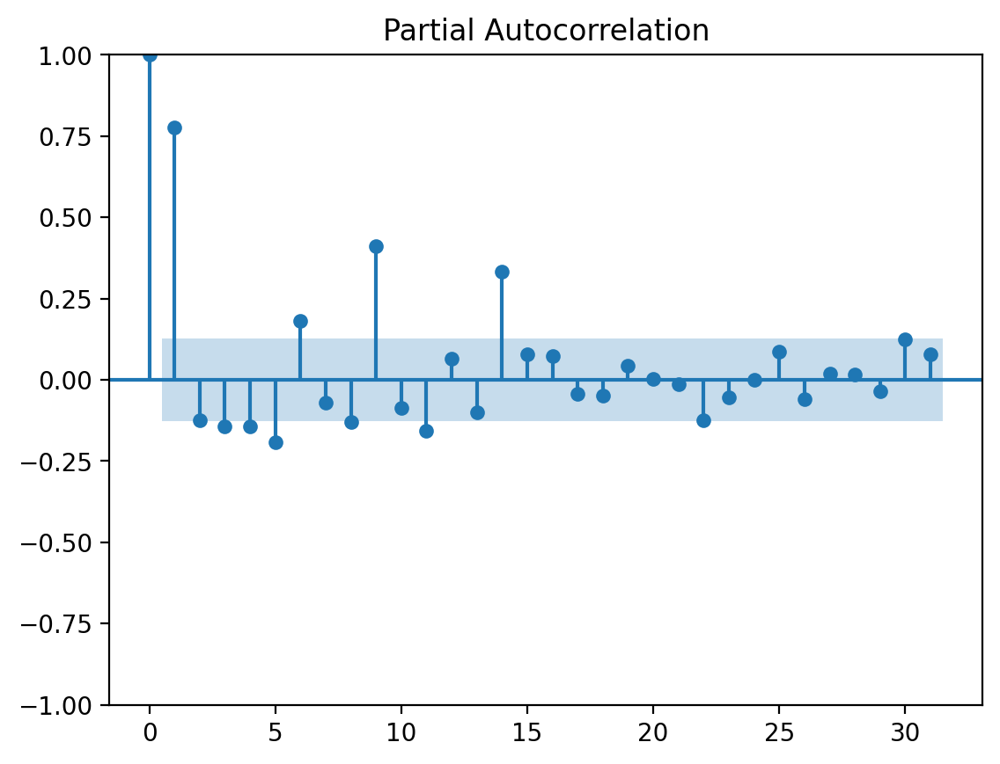

In [1008]:
import statsmodels.api as sm
# autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].som, nlags=31))
# partial autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].som, nlags=31))

sm.graphics.tsa.plot_acf(without_outliers_ds2.iloc[:,:-1].som, lags=31)
plt.show()

sm.graphics.tsa.plot_pacf(without_outliers_ds2.iloc[:,:-1].som, lags=31)
plt.show()

[ 1.00000000e+00  7.95090024e-01  5.90180048e-01  3.85270072e-01
  2.10789807e-01  3.63095419e-02  6.65145059e-02  1.25829568e-01
  1.85144631e-01  2.83173895e-01  3.44033418e-01  2.86283475e-01
  1.94752906e-01  1.03225600e-01 -8.38536288e-04 -5.42317331e-02
 -2.70992388e-02  1.48695392e-02  5.66396076e-02  1.16318637e-01
  1.57329426e-01  1.49802151e-01  1.27084400e-01  1.04439859e-01
  6.20407970e-02  4.03577308e-02  5.26914283e-02  8.47071341e-02
  1.16639173e-01  1.65967014e-01  1.92518555e-01  2.19991148e-01]
[ 1.00000000e+00  7.95090024e-01  5.90180048e-01  3.85270072e-01
  2.10789807e-01  3.63095419e-02  6.65145059e-02  1.25829568e-01
  1.85144631e-01  2.83173895e-01  3.44033418e-01  2.86283475e-01
  1.94752906e-01  1.03225600e-01 -8.38536288e-04 -5.42317331e-02
 -2.70992388e-02  1.48695392e-02  5.66396076e-02  1.16318637e-01
  1.57329426e-01  1.49802151e-01  1.27084400e-01  1.04439859e-01
  6.20407970e-02  4.03577308e-02  5.26914283e-02  8.47071341e-02
  1.16639173e-01  1.6596

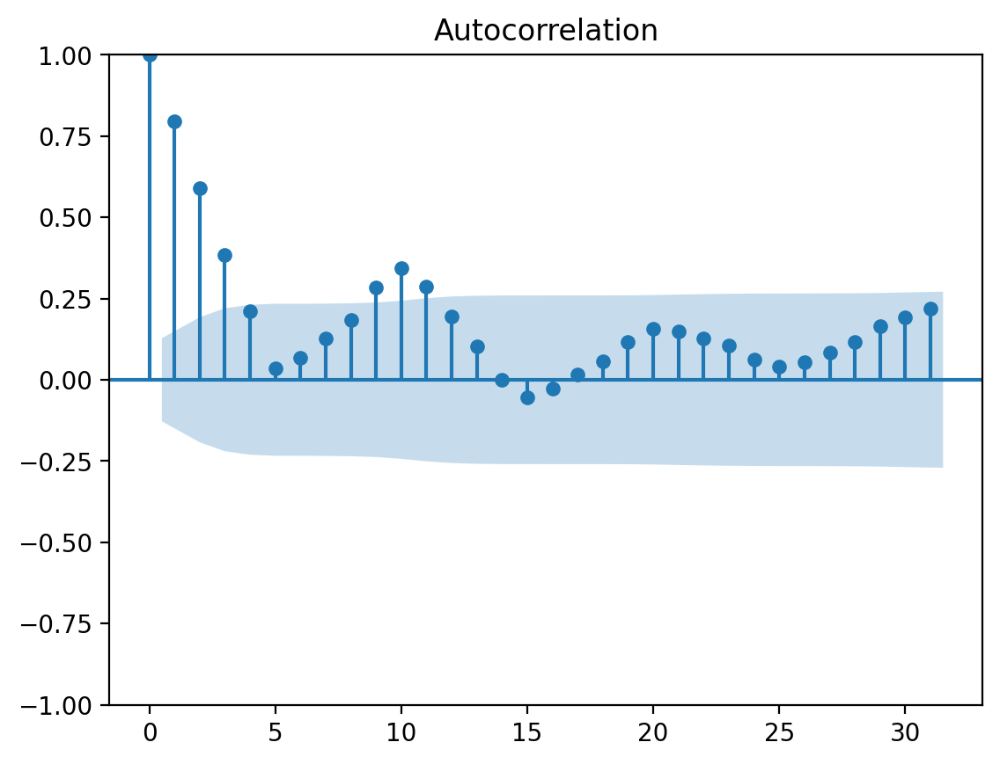

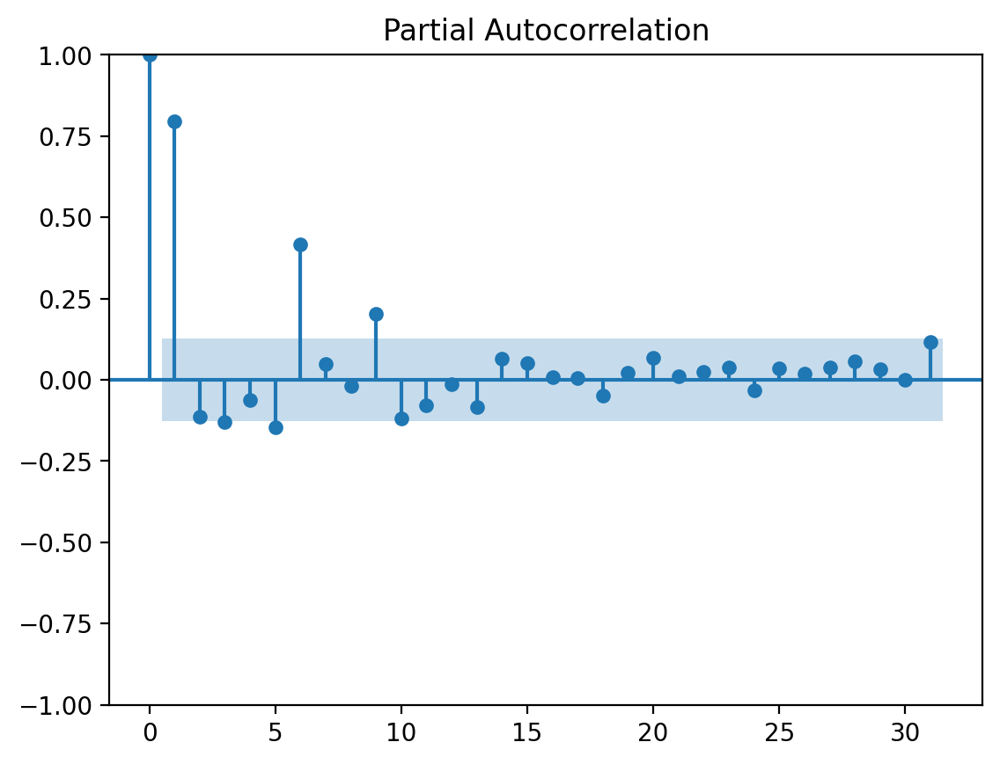

In [1009]:
import statsmodels.api as sm
# autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].sph, nlags=31))
# partial autocorrelation
print(sm.graphics.tsa.acf(without_outliers_ds2.iloc[:,:-1].sph, nlags=31))

sm.graphics.tsa.plot_acf(without_outliers_ds2.iloc[:,:-1].sph, lags=31)
plt.show()

sm.graphics.tsa.plot_pacf(without_outliers_ds2.iloc[:,:-1].sph, lags=31)
plt.show()

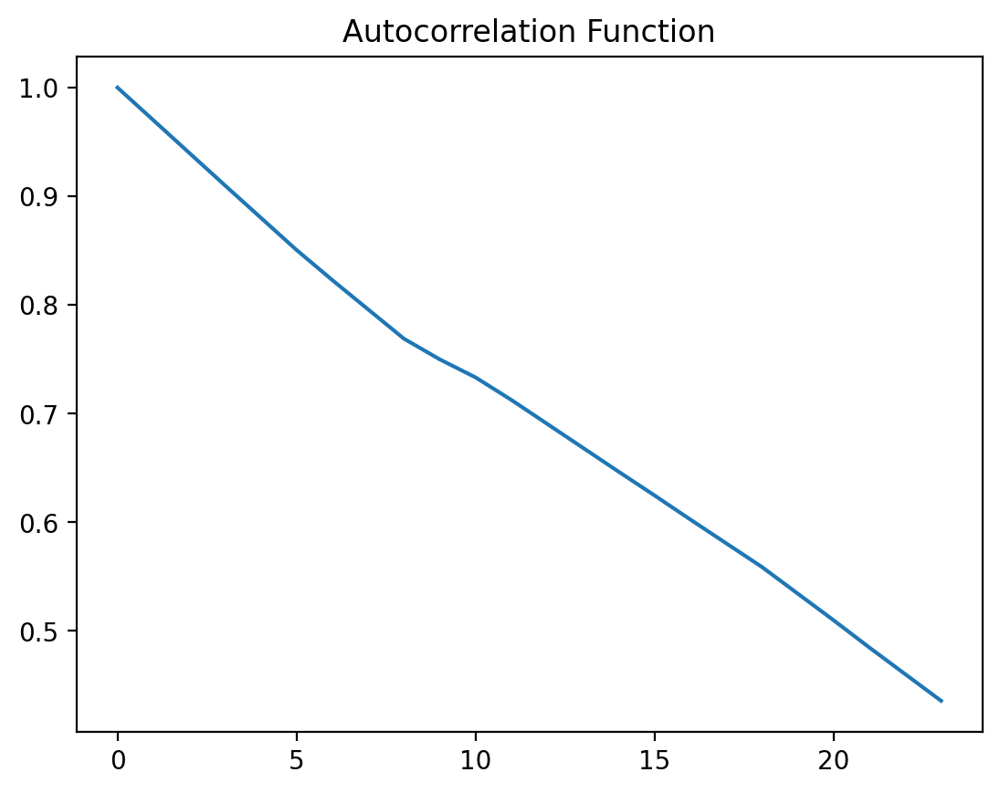

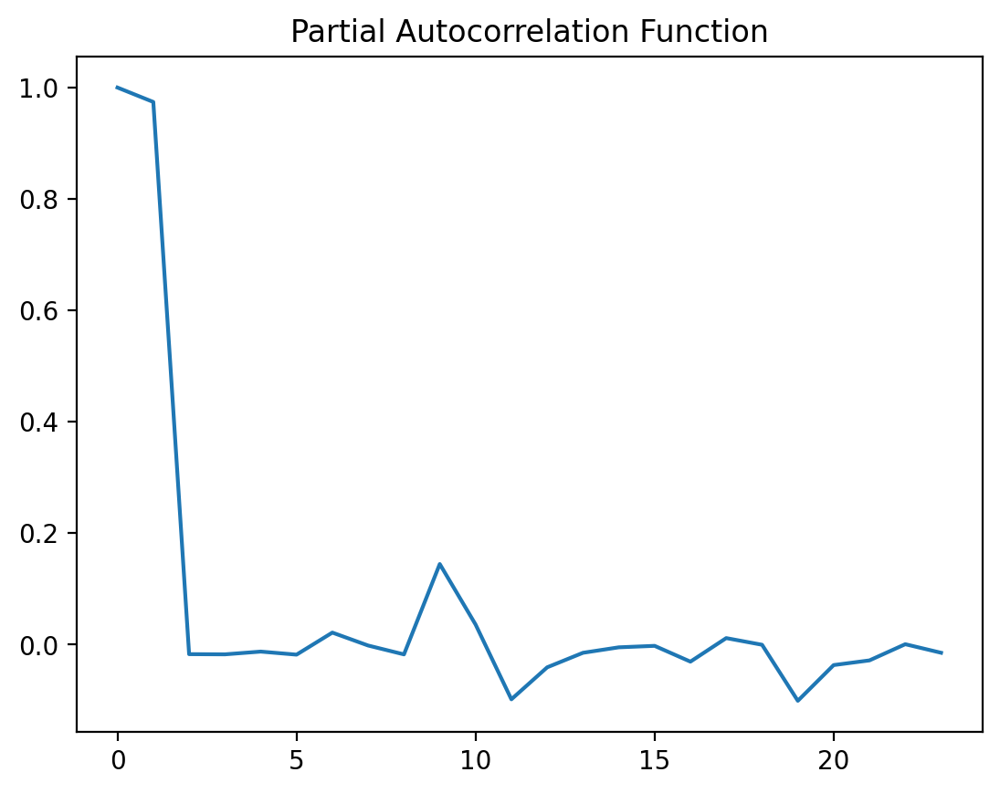

In [1010]:
acfy=statsmodels.tsa.stattools.acf(without_outliers_ds2.iloc[:,:-1].dis)
plt.plot(acfy)
plt.title('Autocorrelation Function')
plt.show()
pacfy=statsmodels.tsa.stattools.pacf(without_outliers_ds2.iloc[:,:-1].dis)
plt.plot(pacfy)
plt.title('Partial Autocorrelation Function')
plt.show()

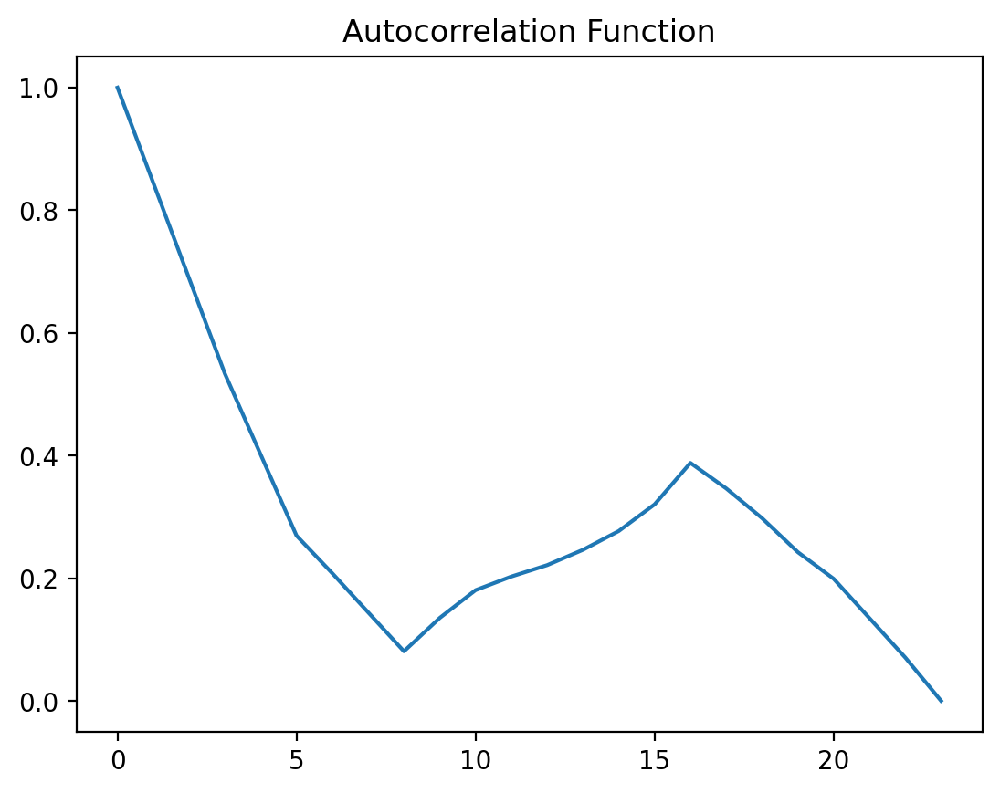

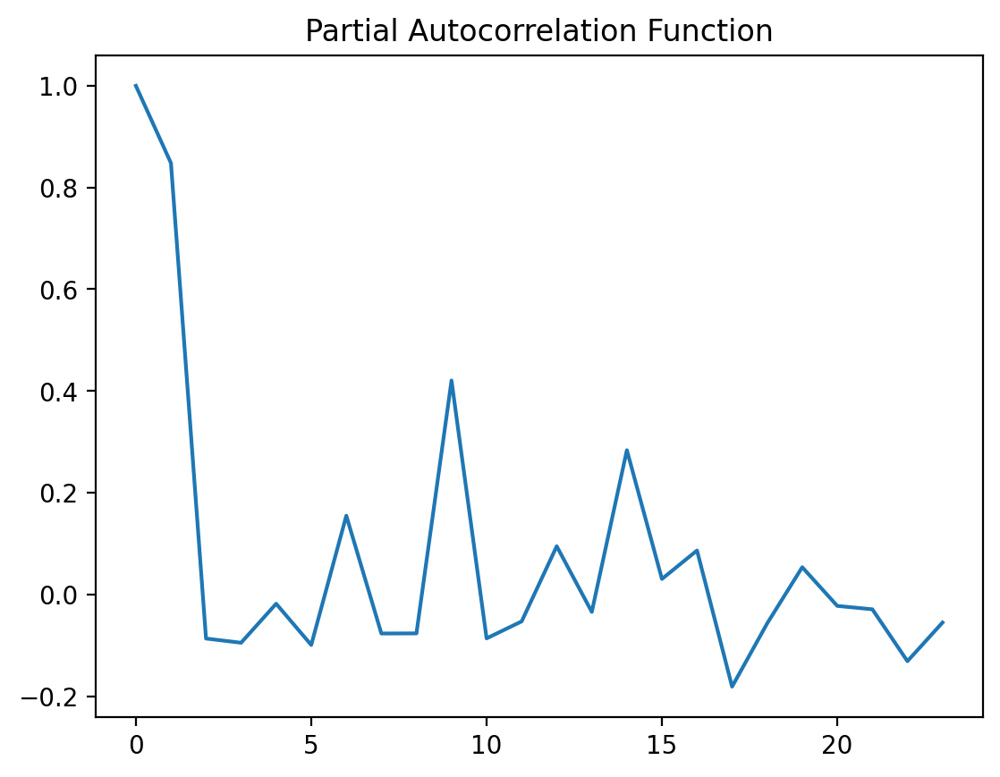

In [1011]:
acfx=statsmodels.tsa.stattools.acf(without_outliers_ds2.iloc[:,:-1].sot)
plt.plot(acfx)
plt.title('Autocorrelation Function')
plt.show()
pacfx=statsmodels.tsa.stattools.pacf(without_outliers_ds2.iloc[:,:-1].sot)
plt.plot(pacfx)
plt.title('Partial Autocorrelation Function')
plt.show()

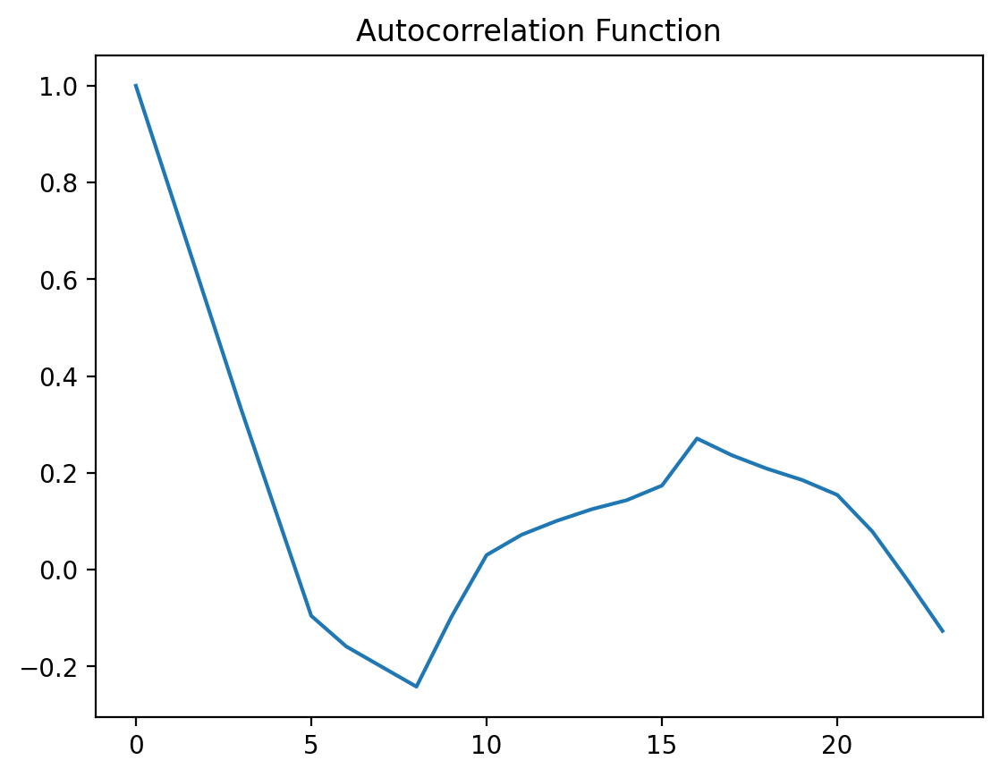

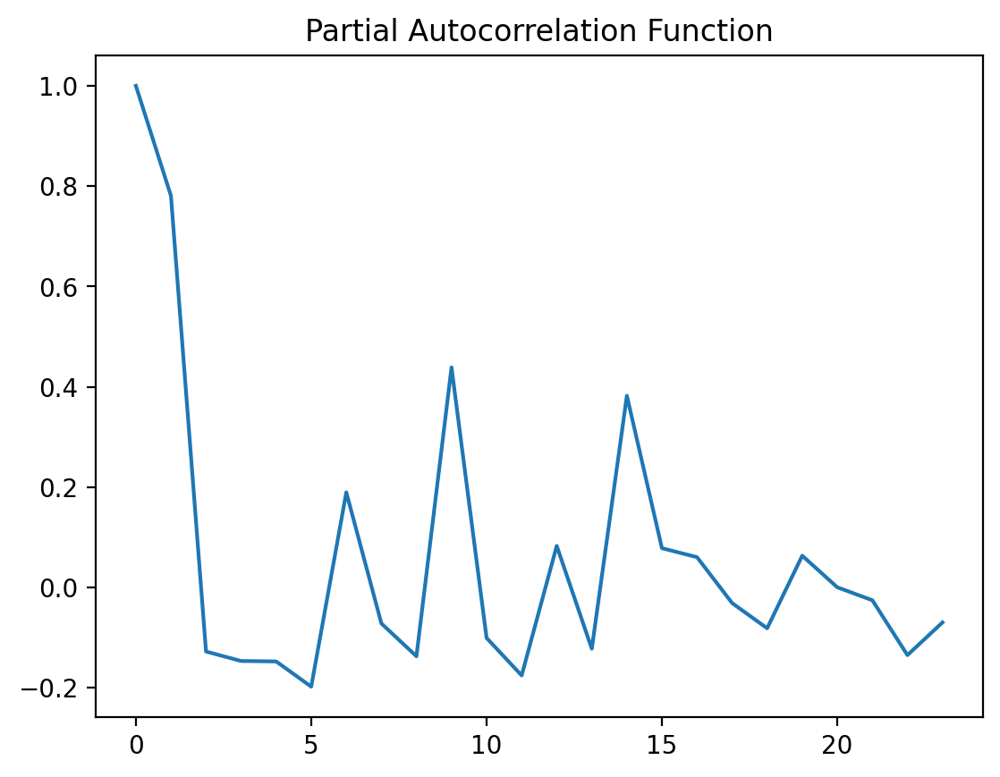

In [1012]:
acfy=statsmodels.tsa.stattools.acf(without_outliers_ds2.iloc[:,:-1].som)
plt.plot(acfy)
plt.title('Autocorrelation Function')
plt.show()
pacfy=statsmodels.tsa.stattools.pacf(without_outliers_ds2.iloc[:,:-1].som)
plt.plot(pacfy)
plt.title('Partial Autocorrelation Function')
plt.show()

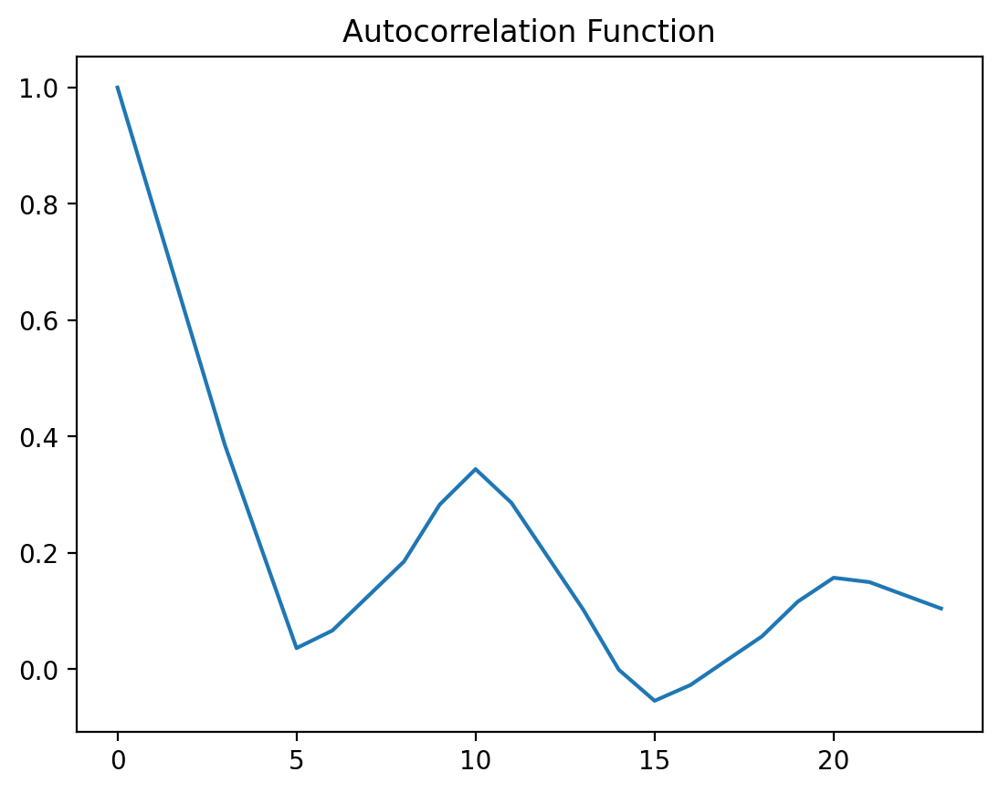

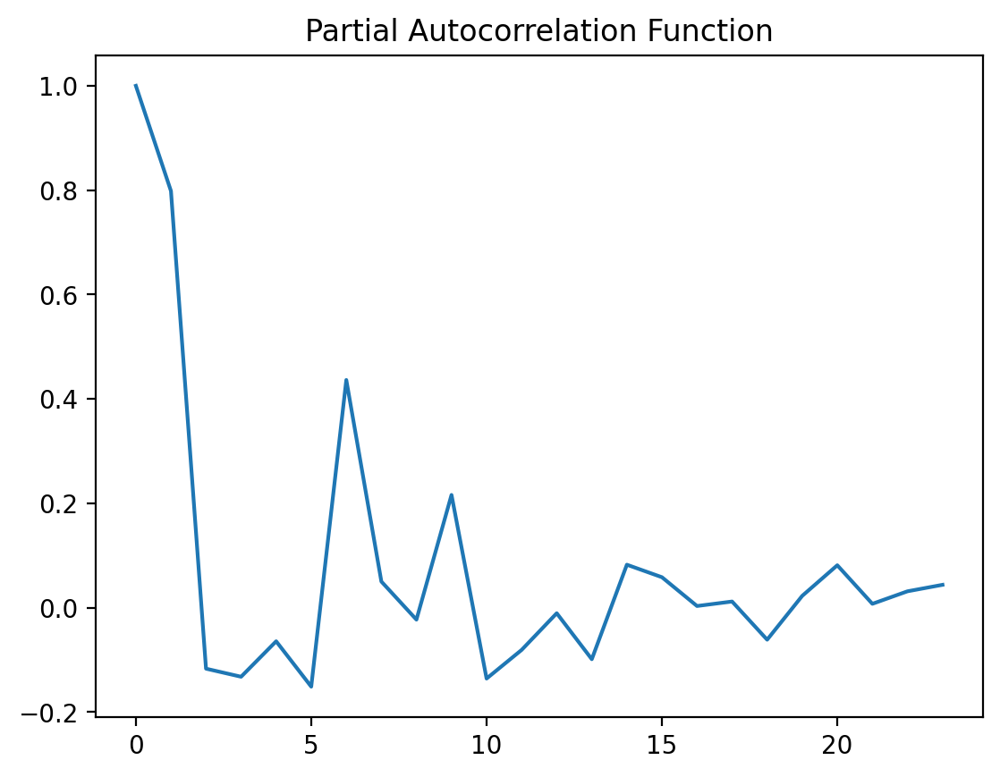

In [1013]:
acfy=statsmodels.tsa.stattools.acf(without_outliers_ds2.iloc[:,:-1].sph)
plt.plot(acfy)
plt.title('Autocorrelation Function')
plt.show()
pacfy=statsmodels.tsa.stattools.pacf(without_outliers_ds2.iloc[:,:-1].sph)
plt.plot(pacfy)
plt.title('Partial Autocorrelation Function')
plt.show()

In [1014]:
without_outliers_ds2.iloc[:,:-1].corr()

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
dat,1.000000,0.409049,0.404539,-0.012762,0.032337,0.082346,0.448723,-0.446754,0.443983,0.008138,-0.003275,0.042548,-0.146291,0.018900,0.124678,0.006319,-0.118555,0.116103,-0.116955
lon,0.409049,1.000000,0.998488,-0.518287,-0.383060,0.247580,0.669429,-0.664176,0.664240,0.114058,-0.508792,-0.265911,-0.637912,-0.470579,-0.081071,-0.015547,-0.017704,0.117238,0.038629
lat,0.404539,0.998488,1.000000,-0.511754,-0.370277,0.259278,0.682123,-0.677549,0.677293,0.094844,-0.500580,-0.251209,-0.627934,-0.456268,-0.094502,-0.016013,-0.033672,0.101324,0.057666
tem,-0.012762,-0.518287,-0.511754,1.000000,0.860337,-0.245671,-0.236665,0.225180,-0.226875,-0.314883,0.990642,0.680099,0.894572,0.925328,0.156574,0.018694,-0.149826,-0.042694,-0.087209
wet,0.032337,-0.383060,-0.370277,0.860337,1.000000,0.281790,-0.187199,0.173797,-0.178639,-0.276849,0.911446,0.958432,0.879682,0.872294,0.149787,0.018077,-0.215758,-0.049147,-0.064207
rh,0.082346,0.247580,0.259278,-0.245671,0.281790,1.000000,0.085975,-0.089362,0.083455,0.059298,-0.131264,0.542716,-0.009231,-0.079250,-0.006777,-0.000608,-0.128301,-0.010818,0.038669
bp,0.448723,0.669429,0.682123,-0.236665,-0.187199,0.085975,1.000000,-0.999663,0.999811,-0.530380,-0.208236,-0.144029,-0.427999,-0.090842,-0.134698,-0.014765,-0.064097,0.000580,0.130669
alt,-0.446754,-0.664176,-0.677549,0.225180,0.173797,-0.089362,-0.999663,1.000000,-0.999826,0.540325,0.195973,0.131334,0.418890,0.081187,0.135150,0.014642,0.069366,0.002799,-0.133333
stp,0.443983,0.664240,0.677293,-0.226875,-0.178639,0.083455,0.999811,-0.999826,1.000000,-0.539780,-0.198386,-0.137268,-0.421283,-0.084048,-0.136728,-0.014831,-0.064959,-0.002155,0.133481
wsp,0.008138,0.114058,0.094844,-0.314883,-0.276849,0.059298,-0.530380,0.540325,-0.539780,1.000000,-0.344963,-0.222975,-0.201983,-0.430913,0.104156,0.004496,0.067955,0.122034,-0.143887


In [1003]:
plt.subplots(1,1,figsize=(10,6),dpi=1000)
plt.suptitle('Study-Level Testing of Covariate Autocorrelation',fontsize=12)
plt.title('Four Field Sites | Alaska, July 2023',fontsize=10, pad=14)
#plt.xlabel('Soil Moisture (%)',fontsize=10, labelpad=8)
#plt.ylabel('Soil pH',fontsize=10, labelpad=8)
autocorrelation_plot(without_outliers_ds2.iloc[:,:-1]['dis'],label='Distance from Pad (m)')
autocorrelation_plot(without_outliers_ds2.iloc[:,:-1]['dep'],label='Depth (cm)')
autocorrelation_plot(without_outliers_ds2.iloc[:,:-1]['sot'],label='Soil Temperature (ºC)')
autocorrelation_plot(without_outliers_ds2.iloc[:,:-1]['som'],label='Soil Moisture (%)')
autocorrelation_plot(without_outliers_ds2.iloc[:,:-1]['sph'],label='Soil pH')
plt.grid(linewidth=0.5)
plt.tick_params(bottom = False) 
plt.tick_params(left = False)
plt.legend();

#### Bootstrapping

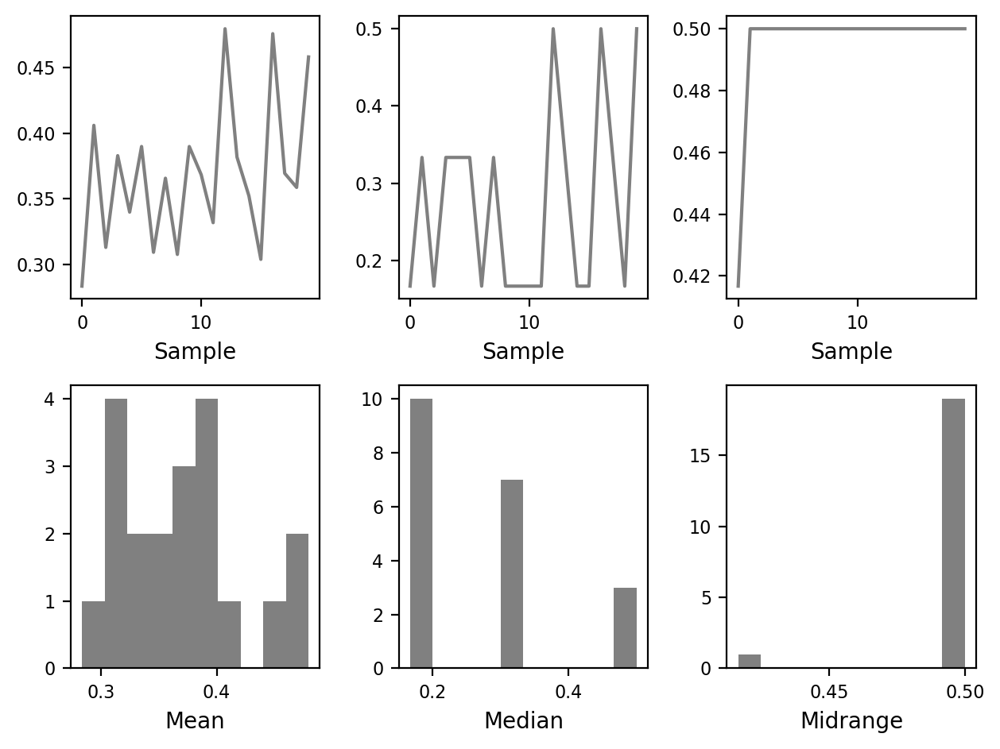

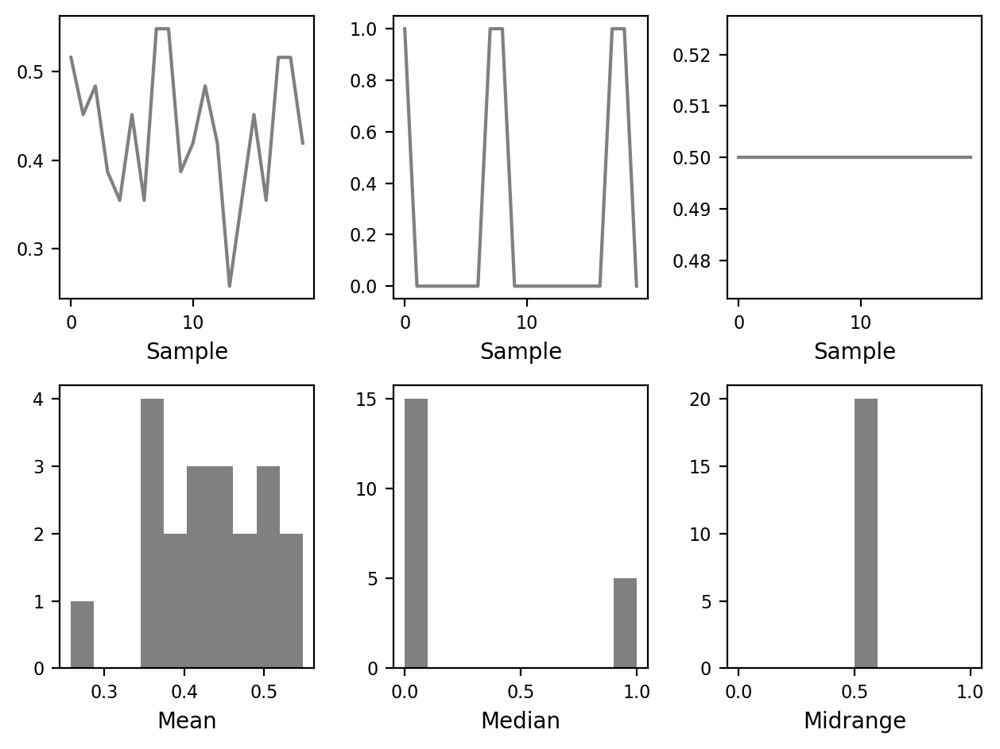

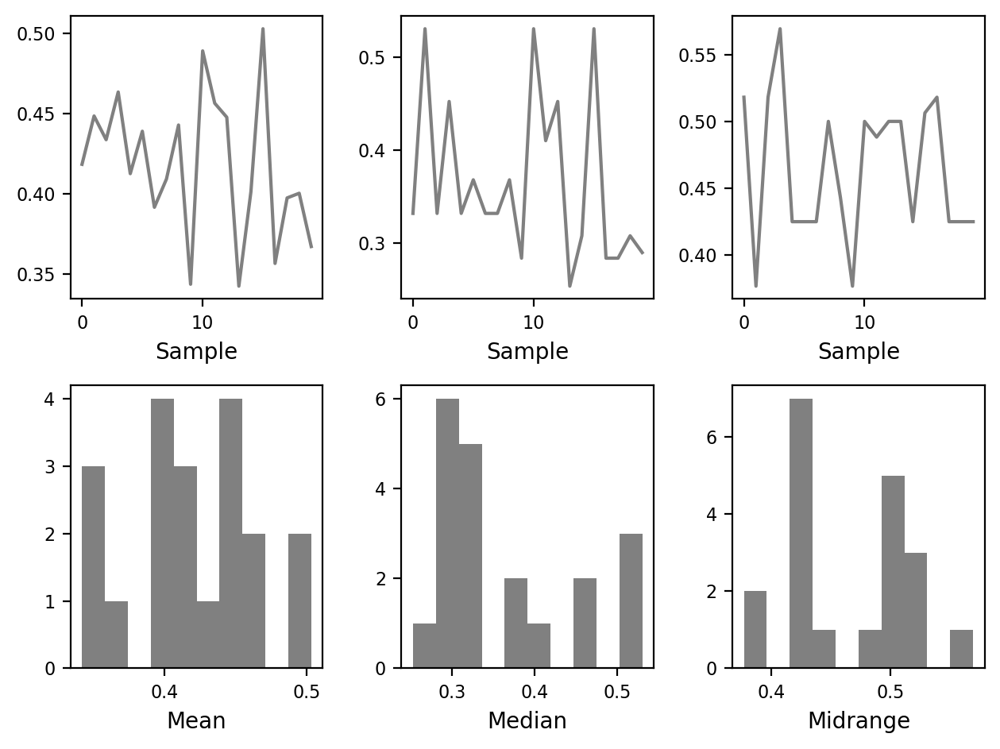

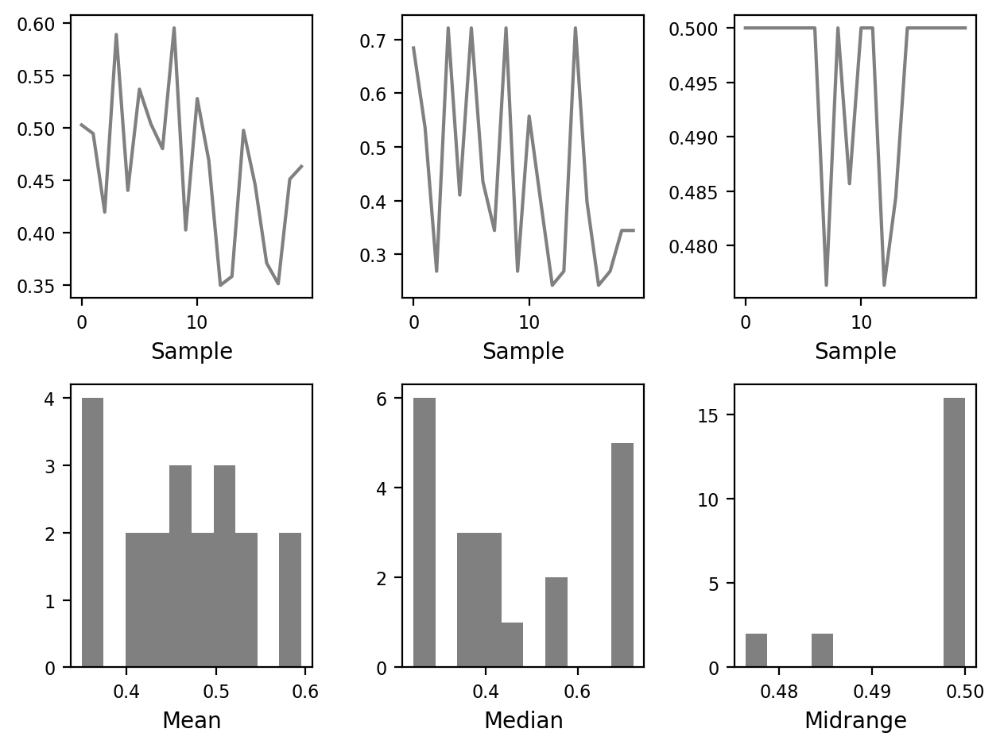

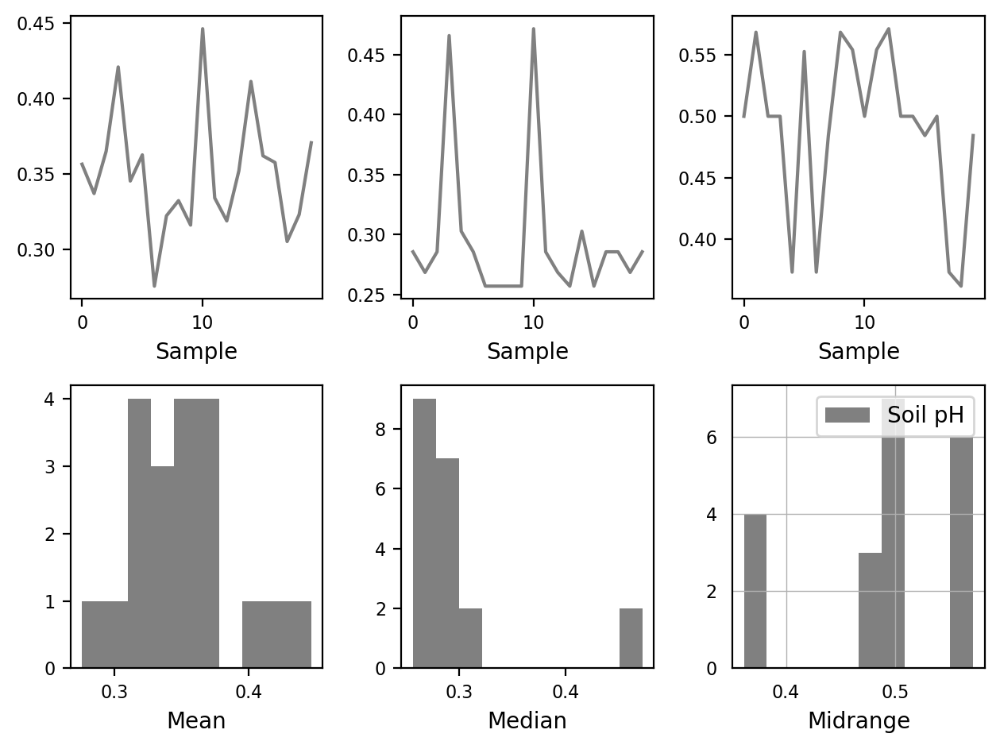

In [1047]:
#plt.suptitle('Group-Level Covariate Bootstrapping',fontsize=12)
#plt.title('Four Field Sites | Alaska, July 2023',fontsize=10, pad=14)
#plt.xlabel('Soil Moisture (%)',fontsize=10, labelpad=8)
#plt.ylabel('Soil pH',fontsize=10, labelpad=8)
bootstrap_plot(without_outliers_ds2.iloc[:,:-1]['dis'], size=31, samples=20, color="grey",label='Distance from Pad (m)')
bootstrap_plot(without_outliers_ds2.iloc[:,:-1]['dep'], size=31, samples=20, color="grey",label='Soil Depth (cm)')
bootstrap_plot(without_outliers_ds2.iloc[:,:-1]['sot'], size=31, samples=20, color="grey",label='Soil Temperature (ºC)')
bootstrap_plot(without_outliers_ds2.iloc[:,:-1]['som'], size=31, samples=20, color="grey",label='Soil Moisture (%)')
bootstrap_plot(without_outliers_ds2.iloc[:,:-1]['sph'], size=31, samples=20, color="grey",label='Soil pH')
plt.grid(linewidth=0.5)
plt.tick_params(bottom = False) 
plt.tick_params(left = False)
plt.legend();

#### Granger Causality (Archived)

STUDY-LEVEL

In [ ]:
#Original Dataframe (DF)
#grangercausalitytests(df[['site','lat']],maxlag=[1])
#grangercausalitytests(df[['lat','site']],maxlag=[1])
#grangercausalitytests(df[['site','lon']],maxlag=[1])
#grangercausalitytests(df[['lon','site']],maxlag=[1])
#######grangercausalitytests(df[['site','dist']],maxlag=[1])
#grangercausalitytests(df[['dist','site']],maxlag=[1])
#######grangercausalitytests(df[['site','depth']],maxlag=[1])
#grangercausalitytests(df[['depth','site']],maxlag=[1])
#grangercausalitytests(df[['site','st']],maxlag=[1])
#grangercausalitytests(df[['st','site']],maxlag=[1])
#grangercausalitytests(df[['site','sm']],maxlag=[1])
#grangercausalitytests(df[['sm','site']],maxlag=[1])
#grangercausalitytests(df[['site','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','site']],maxlag=[1])

#grangercausalitytests(df[['lat','lon']],maxlag=[1])
#grangercausalitytests(df[['lon','lat']],maxlag=[1])
#grangercausalitytests(df[['lat','dist']],maxlag=[1])
#grangercausalitytests(df[['dist','lat']],maxlag=[1])
#grangercausalitytests(df[['lat','depth']],maxlag=[1])
#grangercausalitytests(df[['depth','lat']],maxlag=[1])
#grangercausalitytests(df[['lat','st']],maxlag=[1])
#grangercausalitytests(df[['st','lat']],maxlag=[1])
#grangercausalitytests(df[['lat','sm']],maxlag=[1])
#grangercausalitytests(df[['sm','lat']],maxlag=[1])
#grangercausalitytests(df[['lat','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','lat']],maxlag=[1])

#grangercausalitytests(df[['lon','dist']],maxlag=[1])
#grangercausalitytests(df[['dist','lon']],maxlag=[1])
#grangercausalitytests(df[['lon','depth']],maxlag=[1])
#grangercausalitytests(df[['depth','lon']],maxlag=[1])
#grangercausalitytests(df[['lon','st']],maxlag=[1])
#grangercausalitytests(df[['st','lon']],maxlag=[1])
#grangercausalitytests(df[['lon','sm']],maxlag=[1])
#grangercausalitytests(df[['sm','lon']],maxlag=[1])
#grangercausalitytests(df[['lon','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','lon']],maxlag=[1])

#grangercausalitytests(df[['dist','depth']],maxlag=[1])
#######grangercausalitytests(df[['depth','dist']],maxlag=[1])
#grangercausalitytests(df[['dist','st']],maxlag=[1])
#grangercausalitytests(df[['st','dist']],maxlag=[1])
#grangercausalitytests(df[['dist','sm']],maxlag=[1])
#grangercausalitytests(df[['sm','dist']],maxlag=[1])
#grangercausalitytests(df[['dist','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','dist']],maxlag=[1])

#######grangercausalitytests(df[['depth','st']],maxlag=[1])
#######grangercausalitytests(df[['st','depth']],maxlag=[1])
#######grangercausalitytests(df[['depth','sm']],maxlag=[1])
#grangercausalitytests(df[['sm','depth']],maxlag=[1])
#######grangercausalitytests(df[['depth','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','depth']],maxlag=[1])

#######grangercausalitytests(df[['st','sm']],maxlag=[1])
#grangercausalitytests(df[['sm','st']],maxlag=[1])
#######grangercausalitytests(df[['st','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','st']],maxlag=[1])

#grangercausalitytests(df[['sm','ph']],maxlag=[1])
#grangercausalitytests(df[['ph','sm']],maxlag=[1])


###~~~####


# site,dist
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=4.3751  , p=0.0436  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=4.7397  , p=0.0295  , df=1
# likelihood ratio test: chi2=4.4731  , p=0.0344  , df=1
# parameter F test:         F=4.3751  , p=0.0436  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (4.375081696743016, 0.04358456063963991, 36.0, 1),
#    'ssr_chi2test': (4.739671838138268, 0.0294746930409748, 1),
#    'lrtest': (4.473060794802862, 0.03443325603430249, 1),
#    'params_ftest': (4.375081696743025, 0.043584560639639815, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8b79d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f9dacd0>,
#    array([[0., 1., 0.]])])}
# site,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=4.4506  , p=0.0419  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=4.8215  , p=0.0281  , df=1
# likelihood ratio test: chi2=4.5459  , p=0.0330  , df=1
# parameter F test:         F=4.4506  , p=0.0419  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (4.450607604860826, 0.04190708737506686, 36.0, 1),
#    'ssr_chi2test': (4.821491571932561, 0.028107012845348778, 1),
#    'lrtest': (4.545946316704274, 0.03299677813811404, 1),
#    'params_ftest': (4.450607604860826, 0.04190708737506686, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8d6350>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f99f8d0>,
#    array([[0., 1., 0.]])])}
# depth,distance
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=5.8607  , p=0.0207  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=6.3491  , p=0.0117  , df=1
# likelihood ratio test: chi2=5.8823  , p=0.0153  , df=1
# parameter F test:         F=5.8607  , p=0.0207  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (5.8607219281448915, 0.02065217321618084, 36.0, 1),
#    'ssr_chi2test': (6.349115422156966, 0.011743984225961923, 1),
#    'lrtest': (5.8823319619698395, 0.01529355324747099, 1),
#    'params_ftest': (5.860721928144874, 0.02065217321618101, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f862f50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b5dc10>,
#    array([[0., 1., 0.]])])}
# depth,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=17.2833 , p=0.0002  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=18.7236 , p=0.0000  , df=1
# likelihood ratio test: chi2=15.2921 , p=0.0001  , df=1
# parameter F test:         F=17.2833 , p=0.0002  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (17.283342178290486, 0.00018999900180994596, 36.0, 1),
#    'ssr_chi2test': (18.723620693148025, 1.5109914333415518e-05, 1),
#    'lrtest': (15.292087760827314, 9.210148094254073e-05, 1),
#    'params_ftest': (17.283342178290475, 0.00018999900180994596, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd277d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b5f510>,
#    array([[0., 1., 0.]])])}
# st,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=49.1909 , p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=53.2901 , p=0.0000  , df=1
# likelihood ratio test: chi2=33.5936 , p=0.0000  , df=1
# parameter F test:         F=49.1909 , p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (49.190877837688326, 3.15052151404703e-08, 36.0, 1),
#    'ssr_chi2test': (53.290117657495685, 2.877504923920651e-13, 1),
#    'lrtest': (33.593641458555595, 6.7914374345532035e-09, 1),
#    'params_ftest': (49.19087783768834, 3.15052151404703e-08, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b51190>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a93310>,
#    array([[0., 1., 0.]])])}
# depth,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=0.6284  , p=0.4331  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=0.6807  , p=0.4093  , df=1
# likelihood ratio test: chi2=0.6749  , p=0.4114  , df=1
# parameter F test:         F=0.6284  , p=0.4331  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (0.6283723639612953, 0.4331461921561731, 36.0, 1),
#    'ssr_chi2test': (0.6807367276247365, 0.40933315002967074, 1),
#    'lrtest': (0.6748639107240706, 0.4113609485801709, 1),
#    'params_ftest': (0.6283723639612795, 0.43314619215618055, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38092d0d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd38a50>,
#    array([[0., 1., 0.]])])}
# depth,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=101.1524, p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=109.5818, p=0.0000  , df=1
# likelihood ratio test: chi2=52.1654 , p=0.0000  , df=1
# parameter F test:         F=101.1524, p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (101.15243866581069, 5.3295038476519974e-12, 36.0, 1),
#    'ssr_chi2test': (109.58180855462827, 1.2100598078631641e-25, 1),
#    'lrtest': (52.165388331479704, 5.101748247775453e-13, 1),
#    'params_ftest': (101.15243866581085, 5.329503847651873e-12, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd108d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b53d10>,
#    array([[0., 1., 0.]])])}
# st,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=8.4275  , p=0.0063  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=9.1298  , p=0.0025  , df=1
# likelihood ratio test: chi2=8.2032  , p=0.0042  , df=1
# parameter F test:         F=8.4275  , p=0.0063  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (8.42747021240505, 0.0062748876764958505, 36.0, 1),
#    'ssr_chi2test': (9.129759396772137, 0.002514847909814445, 1),
#    'lrtest': (8.203222487641881, 0.00418160545285047, 1),
#    'params_ftest': (8.427470212405037, 0.006274887676495869, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fc8a390>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd06650>,
#    array([[0., 1., 0.]])])}
# st,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=6.3985  , p=0.0159  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=6.9317  , p=0.0085  , df=1
# likelihood ratio test: chi2=6.3801  , p=0.0115  , df=1
# parameter F test:         F=6.3985  , p=0.0159  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (6.39847500982396, 0.015942022324349363, 36.0, 1),
#    'ssr_chi2test': (6.931681260642623, 0.008468204734818656, 1),
#    'lrtest': (6.380144799036373, 0.01154040159883174, 1),
#    'params_ftest': (6.398475009823962, 0.015942022324349363, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b5f550>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd4fa50>,
#    array([[0., 1., 0.]])])}

In [ ]:
#grangercausalitytests(df[['site','lat']],maxlag=[1]) #cannot compute GC for 0:5 because site values are one constant value (imputed 0 for site names).
#grangercausalitytests(df[['lat','site']],maxlag=[1]) #
#grangercausalitytests(df[['site','lon']],maxlag=[1]) #
#grangercausalitytests(df[['lon','site']],maxlag=[1]) #
#######grangercausalitytests(df[['site','dist']],maxlag=[1])  #
#grangercausalitytests(df[['dist','site']],maxlag=[1])        #
#######grangercausalitytests(df[['site','depth']],maxlag=[1]) #
#grangercausalitytests(df[['depth','site']],maxlag=[1])       #
#grangercausalitytests(df[['site','st']],maxlag=[1])          #
#grangercausalitytests(df[['st','site']],maxlag=[1]) #
#grangercausalitytests(df[['site','sm']],maxlag=[1]) #
#grangercausalitytests(df[['sm','site']],maxlag=[1]) #
#grangercausalitytests(df[['site','ph']],maxlag=[1]) #
#grangercausalitytests(df[['ph','site']],maxlag=[1]) #cannot compute GC for 0:5 because site values are one constant value (imputed 0 for site names).

#grangercausalitytests(df[31:][['lat','lon']],maxlag=[1])
#grangercausalitytests(df[31:][['lon','lat']],maxlag=[1])#
#grangercausalitytests(df[31:][['lat','dist']],maxlag=[1])#
#grangercausalitytests(df[31:][['dist','lat']],maxlag=[1])
#grangercausalitytests(df[31:][['lat','depth']],maxlag=[1])##
#grangercausalitytests(df[31:][['depth','lat']],maxlag=[1])#
#grangercausalitytests(df[31:][['lat','st']],maxlag=[1])#
#grangercausalitytests(df[31:][['st','lat']],maxlag=[1])##
#grangercausalitytests(df[31:][['lat','sm']],maxlag=[1])##
#grangercausalitytests(df[31:][['sm','lat']],maxlag=[1])#
#grangercausalitytests(df[31:][['lat','ph']],maxlag=[1])#
#grangercausalitytests(df[31:][['ph','lat']],maxlag=[1])

#grangercausalitytests(df[31:][['lon','dist']],maxlag=[1])
#grangercausalitytests(df[31:][['dist','lon']],maxlag=[1])
#grangercausalitytests(df[31:][['lon','depth']],maxlag=[1])##
#grangercausalitytests(df[31:][['depth','lon']],maxlag=[1])#
#grangercausalitytests(df[31:][['lon','st']],maxlag=[1])##
#grangercausalitytests(df[31:][['st','lon']],maxlag=[1])##
#grangercausalitytests(df[31:][['lon','sm']],maxlag=[1])##
#grangercausalitytests(df[31:][['sm','lon']],maxlag=[1])
#grangercausalitytests(df[31:][['lon','ph']],maxlag=[1])#
#grangercausalitytests(df[31:][['ph','lon']],maxlag=[1])

#grangercausalitytests(df[31:][['dist','depth']],maxlag=[1])###
#grangercausalitytests(df[31:][['depth','dist']],maxlag=[1])
#grangercausalitytests(df[31:][['dist','st']],maxlag=[1])#
#grangercausalitytests(df[31:][['st','dist']],maxlag=[1])#
#grangercausalitytests(df[31:][['dist','sm']],maxlag=[1])###
#grangercausalitytests(df[31:][['sm','dist']],maxlag=[1])#
#grangercausalitytests(df[31:][['dist','ph']],maxlag=[1])
#grangercausalitytests(df[31:][['ph','dist']],maxlag=[1])

#grangercausalitytests(df[16:31][['depth','st']],maxlag=[1])###
#grangercausalitytests(df[16:31][['st','depth']],maxlag=[1])###
#grangercausalitytests(df[16:31][['depth','sm']],maxlag=[1])##
#grangercausalitytests(df[16:31][['sm','depth']],maxlag=[1])
#grangercausalitytests(df[16:31][['depth','ph']],maxlag=[1])###
#grangercausalitytests(df[16:31][['ph','depth']],maxlag=[1])#

#grangercausalitytests(df[31:][['st','sm']],maxlag=[1])##
#grangercausalitytests(df[31:][['sm','st']],maxlag=[1])#
#grangercausalitytests(df[31:][['st','ph']],maxlag=[1])###
#grangercausalitytests(df[31:][['ph','st']],maxlag=[1])#

#grangercausalitytests(df[31:][['sm','ph']],maxlag=[1])
#grangercausalitytests(df[31:][['ph','sm']],maxlag=[1])#


###~~~###


# Original Sites
# 0:5
# lon,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=1930.3667, p=0.0145  , df_denom=1, df_num=1
# ssr based chi2 test:   chi2=7721.4669, p=0.0000  , df=1
# likelihood ratio test: chi2=30.2639 , p=0.0000  , df=1
# parameter F test:         F=1930.3667, p=0.0145  , df_denom=1, df_num=1
# {1: ({'ssr_ftest': (1930.3667241289684, 0.014487225998212401, 1.0, 1),
#    'ssr_chi2test': (7721.4668965158735, 0.0, 1),
#    'lrtest': (30.263932713992332, 3.7707282484149566e-08, 1),
#    'params_ftest': (1930.3667241141936, 0.014487225998267824, 1.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b4cad0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd088d0>,
#    array([[0., 1., 0.]])])}
# sm,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=0.0001  , p=0.9939  , df_denom=1, df_num=1
# ssr based chi2 test:   chi2=0.0004  , p=0.9846  , df=1
# likelihood ratio test: chi2=0.0004  , p=0.9846  , df=1
# parameter F test:         F=0.0001  , p=0.9939  , df_denom=1, df_num=1
# {1: ({'ssr_ftest': (9.260916003131252e-05, 0.9938737644727587, 1.0, 1),
#    'ssr_chi2test': (0.0003704366401252501, 0.9846442788401081, 1),
#    'lrtest': (0.00037041948827010174, 0.984644634298513, 1),
#    'params_ftest': (9.260916003207554e-05, 0.9938737644727292, 1.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f513d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390eb5190>,
#    array([[0., 1., 0.]])])}

# 5:16
# lon,lat
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=6.3818  , p=0.0394  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=9.1169  , p=0.0025  , df=1
# likelihood ratio test: chi2=6.4799  , p=0.0109  , df=1
# parameter F test:         F=6.3818  , p=0.0394  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (6.381834285471317, 0.03944971772884184, 7.0, 1),
#    'ssr_chi2test': (9.11690612210188, 0.002532579247370726, 1),
#    'lrtest': (6.479879878383599, 0.010910235664999317, 1),
#    'params_ftest': (6.381834347258884, 0.03944971702380959, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d3cd90>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b5ae50>,
#    array([[0., 1., 0.]])])}
# lat,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=11.7665 , p=0.0110  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=16.8093 , p=0.0000  , df=1
# likelihood ratio test: chi2=9.8616  , p=0.0017  , df=1
# parameter F test:         F=11.7665 , p=0.0110  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (11.766488704868515, 0.010981758839179607, 7.0, 1),
#    'ssr_chi2test': (16.809269578383596, 4.133091901031954e-05, 1),
#    'lrtest': (9.861626145105731, 0.0016876187288711359, 1),
#    'params_ftest': (11.766489380276012, 0.010981757371762563, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd38490>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8b5610>,
#    array([[0., 1., 0.]])])}
# lat,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=10.4342 , p=0.0144  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=14.9060 , p=0.0001  , df=1
# likelihood ratio test: chi2=9.1252  , p=0.0025  , df=1
# parameter F test:         F=10.4342 , p=0.0144  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (10.43420365856224, 0.014447708571139901, 7.0, 1),
#    'ssr_chi2test': (14.906005226517486, 0.00011300269149212224, 1),
#    'lrtest': (9.125238551546204, 0.002521070091745933, 1),
#    'params_ftest': (10.434203622566015, 0.014447708682636621, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d70410>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a99e10>,
#    array([[0., 1., 0.]])])}
# sm,lat
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=7.9322  , p=0.0259  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=11.3317 , p=0.0008  , df=1
# likelihood ratio test: chi2=7.5761  , p=0.0059  , df=1
# parameter F test:         F=7.9322  , p=0.0259  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (7.932186405133886, 0.02590626700783469, 7.0, 1),
#    'ssr_chi2test': (11.331694864476981, 0.0007619532656036744, 1),
#    'lrtest': (7.5760889552035735, 0.005914763579871994, 1),
#    'params_ftest': (7.932186405023197, 0.025906267008565433, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fcffe10>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd4f9d0>,
#    array([[0., 1., 0.]])])}
# depth,lon
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=8.6944  , p=0.0214  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=12.4206 , p=0.0004  , df=1
# likelihood ratio test: chi2=8.0740  , p=0.0045  , df=1
# parameter F test:         F=8.6944  , p=0.0214  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (8.694439481515527, 0.02144846856841038, 7.0, 1),
#    'ssr_chi2test': (12.42062783073647, 0.00042461746565154664, 1),
#    'lrtest': (8.073963274129483, 0.0044905791452996375, 1),
#    'params_ftest': (8.694439481442563, 0.02144846856878739, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390aa7850>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd24390>,
#    array([[0., 1., 0.]])])}
# st,lon
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=8.0652  , p=0.0250  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=11.5217 , p=0.0007  , df=1
# likelihood ratio test: chi2=7.6647  , p=0.0056  , df=1
# parameter F test:         F=8.0652  , p=0.0250  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (8.065159432006809, 0.025047393198523997, 7.0, 1),
#    'ssr_chi2test': (11.5216563314383, 0.0006879007004849927, 1),
#    'lrtest': (7.664746064119953, 0.005631018501478071, 1),
#    'params_ftest': (8.065159431817127, 0.025047393199722576, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd2f750>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d4cf50>,
#    array([[0., 1., 0.]])])}
# lon,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=8.0998  , p=0.0248  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=11.5711 , p=0.0007  , df=1
# likelihood ratio test: chi2=7.6877  , p=0.0056  , df=1
# parameter F test:         F=8.0998  , p=0.0248  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (8.099794341742319, 0.024829773970046955, 7.0, 1),
#    'ssr_chi2test': (11.5711347739176, 0.0006698352757955418, 1),
#    'lrtest': (7.687709749206505, 0.00555981372362022, 1),
#    'params_ftest': (8.09979437905341, 0.024829773736937406, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f4af050>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b58f50>,
#    array([[0., 1., 0.]])])}
# lon,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=5.8499  , p=0.0462  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=8.3570  , p=0.0038  , df=1
# likelihood ratio test: chi2=6.0743  , p=0.0137  , df=1
# parameter F test:         F=5.8499  , p=0.0462  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (5.849891202962396, 0.04618329280234422, 7.0, 1),
#    'ssr_chi2test': (8.356987432803422, 0.0038420700952400584, 1),
#    'lrtest': (6.074251955545378, 0.013716637581025651, 1),
#    'params_ftest': (5.849891205466887, 0.046183292767237455, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d7c450>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e43ed0>,
#    array([[0., 1., 0.]])])}
# dist,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=26.7928 , p=0.0013  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=38.2754 , p=0.0000  , df=1
# likelihood ratio test: chi2=15.7434 , p=0.0001  , df=1
# parameter F test:         F=26.7928 , p=0.0013  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (26.792798374306127, 0.0012862966970406276, 7.0, 1),
#    'ssr_chi2test': (38.27542624900875, 6.143139270455711e-10, 1),
#    'lrtest': (15.743375648829762, 7.254151544991361e-05, 1),
#    'params_ftest': (26.792798374306134, 0.0012862966970406276, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b53350>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390bf3d90>,
#    array([[0., 1., 0.]])])}
# dist,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=6.3095  , p=0.0403  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=9.0136  , p=0.0027  , df=1
# likelihood ratio test: chi2=6.4257  , p=0.0112  , df=1
# parameter F test:         F=6.3095  , p=0.0403  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (6.309513127786207, 0.04028633070888206, 7.0, 1),
#    'ssr_chi2test': (9.013590182551724, 0.0026797951160698404, 1),
#    'lrtest': (6.4256890325262646, 0.0112481265181125, 1),
#    'params_ftest': (6.309513127786228, 0.040286330708881796, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e92890>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d6d510>,
#    array([[0., 1., 0.]])])}
# sm,dist
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=9.0241  , p=0.0198  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=12.8916 , p=0.0003  , df=1
# likelihood ratio test: chi2=8.2819  , p=0.0040  , df=1
# parameter F test:         F=9.0241  , p=0.0198  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (9.024126076969523, 0.01982911274516706, 7.0, 1),
#    'ssr_chi2test': (12.891608681385033, 0.0003300586148474866, 1),
#    'lrtest': (8.281853172858348, 0.004004324002920974, 1),
#    'params_ftest': (9.024126076969525, 0.01982911274516706, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390dd94d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a794d0>,
#    array([[0., 1., 0.]])])}
# depth,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=10.1599 , p=0.0153  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=14.5142 , p=0.0001  , df=1
# likelihood ratio test: chi2=8.9667  , p=0.0027  , df=1
# parameter F test:         F=10.1599 , p=0.0153  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (10.15993602558978, 0.015330589253570488, 7.0, 1),
#    'ssr_chi2test': (14.514194322271116, 0.00013910743687832464, 1),
#    'lrtest': (8.9666721688507, 0.0027494893794296907, 1),
#    'params_ftest': (10.1599360255898, 0.01533058925357042, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a8e550>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390be7dd0>,
#    array([[0., 1., 0.]])])}
# st,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=21.5674 , p=0.0024  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=30.8106 , p=0.0000  , df=1
# likelihood ratio test: chi2=14.0636 , p=0.0002  , df=1
# parameter F test:         F=21.5674 , p=0.0024  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (21.567394991955634, 0.0023582686421454425, 7.0, 1),
#    'ssr_chi2test': (30.810564274222333, 2.8448491856748993e-08, 1),
#    'lrtest': (14.063558831896898, 0.0001767350414091276, 1),
#    'params_ftest': (21.567394991955652, 0.0023582686421454364, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ec30d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ec2a10>,
#    array([[0., 1., 0.]])])}
# depth,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=50.3774 , p=0.0002  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=71.9677 , p=0.0000  , df=1
# likelihood ratio test: chi2=21.0374 , p=0.0000  , df=1
# parameter F test:         F=50.3774 , p=0.0002  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (50.377375872459396, 0.00019405420182237024, 7.0, 1),
#    'ssr_chi2test': (71.96767981779914, 2.1875105263580483e-17, 1),
#    'lrtest': (21.037399280098207, 4.504051752740108e-06, 1),
#    'params_ftest': (50.37737587245933, 0.000194054201822371, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f49a690>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd13a90>,
#    array([[0., 1., 0.]])])}
# st,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=15.7981 , p=0.0054  , df_denom=7, df_num=1
# ssr based chi2 test:   chi2=22.5687 , p=0.0000  , df=1
# likelihood ratio test: chi2=11.8077 , p=0.0006  , df=1
# parameter F test:         F=15.7981 , p=0.0054  , df_denom=7, df_num=1
# {1: ({'ssr_ftest': (15.798118322045802, 0.005360137941750894, 7.0, 1),
#    'ssr_chi2test': (22.568740460065435, 2.027569567586417e-06, 1),
#    'lrtest': (11.807678537644833, 0.0005898693655841317, 1),
#    'params_ftest': (15.798118322045791, 0.005360137941750905, 7.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390eb4ed0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f941e90>,
#    array([[0., 1., 0.]])])}

# 16:31
# lat,deptj
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=13.2654 , p=0.0039  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=16.8832 , p=0.0000  , df=1
# likelihood ratio test: chi2=11.0762 , p=0.0009  , df=1
# parameter F test:         F=13.2654 , p=0.0039  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (13.265405664419678, 0.0038733585039706026, 11.0, 1),
#    'ssr_chi2test': (16.88324357289777, 3.9750954793312105e-05, 1),
#    'lrtest': (11.076189992107174, 0.000874432846699648, 1),
#    'params_ftest': (13.265406908435505, 0.0038733573479926907, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d7e790>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3910fd250>,
#    array([[0., 1., 0.]])])}
# lat,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=10.4776 , p=0.0079  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=13.3351 , p=0.0003  , df=1
# likelihood ratio test: chi2=9.3676  , p=0.0022  , df=1
# parameter F test:         F=10.4776 , p=0.0079  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (10.477589628360526, 0.007917332733329976, 11.0, 1),
#    'ssr_chi2test': (13.335114072458852, 0.00026048215483814424, 1),
#    'lrtest': (9.3676068619165, 0.00220853674888745, 1),
#    'params_ftest': (10.47759045263463, 0.007917330940921556, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390cbaa50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a81a50>,
#    array([[0., 1., 0.]])])}
# st,lat
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=33.1857 , p=0.0001  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=42.2364 , p=0.0000  , df=1
# likelihood ratio test: chi2=19.4671 , p=0.0000  , df=1
# parameter F test:         F=33.1857 , p=0.0001  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (33.18572180538031, 0.0001263663239308757, 11.0, 1),
#    'ssr_chi2test': (42.23637320684767, 8.08816217064976e-11, 1),
#    'lrtest': (19.467089992287292, 1.0234796444720163e-05, 1),
#    'params_ftest': (33.18572181227374, 0.0001263663238197851, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d7fb90>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd11e10>,
#    array([[0., 1., 0.]])])}
# lat,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=17.5043 , p=0.0015  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=22.2782 , p=0.0000  , df=1
# likelihood ratio test: chi2=13.3302 , p=0.0003  , df=1
# parameter F test:         F=17.5043 , p=0.0015  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (17.504265852909953, 0.0015267045237904486, 11.0, 1),
#    'ssr_chi2test': (22.278156540067215, 2.358745473589317e-06, 1),
#    'lrtest': (13.330218752548774, 0.00026116305123826533, 1),
#    'params_ftest': (17.50426718011335, 0.0015267041151742146, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd1c250>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390df18d0>,
#    array([[0., 1., 0.]])])}
# lon,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=5.0008  , p=0.0470  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=6.3646  , p=0.0116  , df=1
# likelihood ratio test: chi2=5.2464  , p=0.0220  , df=1
# parameter F test:         F=5.0008  , p=0.0470  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (5.000794952225051, 0.047009404604116754, 11.0, 1),
#    'ssr_chi2test': (6.364648121013701, 0.011641617904032082, 1),
#    'lrtest': (5.246403858097409, 0.02199217657370869, 1),
#    'params_ftest': (5.000794932207166, 0.04700940497263467, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390af84d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d3f010>,
#    array([[0., 1., 0.]])])}
# st,lon
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=12.3164 , p=0.0049  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=15.6754 , p=0.0001  , df=1
# likelihood ratio test: chi2=10.5176 , p=0.0012  , df=1
# parameter F test:         F=12.3164 , p=0.0049  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (12.316359433163637, 0.004888177673450139, 11.0, 1),
#    'ssr_chi2test': (15.675366551299174, 7.51971904717735e-05, 1),
#    'lrtest': (10.517639481947342, 0.0011824042340903777, 1),
#    'params_ftest': (12.316359431131632, 0.0048881776759397335, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b51810>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b5b990>,
#    array([[0., 1., 0.]])])}
# lon,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=7.3176  , p=0.0205  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=9.3133  , p=0.0023  , df=1
# likelihood ratio test: chi2=7.1396  , p=0.0075  , df=1
# parameter F test:         F=7.3176  , p=0.0205  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (7.317618335513663, 0.020468992645904915, 11.0, 1),
#    'ssr_chi2test': (9.313332427017388, 0.0022749233516182244, 1),
#    'lrtest': (7.139553042669945, 0.007540195011050944, 1),
#    'params_ftest': (7.3176182767121425, 0.020468993043461527, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390dc8590>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390aa7dd0>,
#    array([[0., 1., 0.]])])}
# dist,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=64.5654 , p=0.0000  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=82.1741 , p=0.0000  , df=1
# likelihood ratio test: chi2=26.9794 , p=0.0000  , df=1
# parameter F test:         F=64.5654 , p=0.0000  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (64.56536945792806, 6.264562287470538e-06, 11.0, 1),
#    'ssr_chi2test': (82.17410658281753, 1.2461171800890219e-19, 1),
#    'lrtest': (26.97943961278922, 2.0563117161152969e-07, 1),
#    'params_ftest': (64.565369457928, 6.264562287470565e-06, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a7b290>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390be6f50>,
#    array([[0., 1., 0.]])])}
# dist,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=15.2750 , p=0.0024  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=19.4410 , p=0.0000  , df=1
# likelihood ratio test: chi2=12.1901 , p=0.0005  , df=1
# parameter F test:         F=15.2750 , p=0.0024  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (15.275043211897657, 0.00244133691387449, 11.0, 1),
#    'ssr_chi2test': (19.440964087869745, 1.0375755108596163e-05, 1),
#    'lrtest': (12.190140039903497, 0.0004804277654749231, 1),
#    'params_ftest': (15.275043211897632, 0.0024413369138745027, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b53850>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b5c0d0>,
#    array([[0., 1., 0.]])])}
# #st,dist
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=18.8697 , p=0.0012  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=24.0160 , p=0.0000  , df=1
# likelihood ratio test: chi2=13.9853 , p=0.0002  , df=1
# parameter F test:         F=18.8697 , p=0.0012  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (18.869727910850038, 0.001167126362926805, 11.0, 1),
#    'ssr_chi2test': (24.016017341081866, 9.55376127559999e-07, 1),
#    'lrtest': (13.985303503878185, 0.0001842451617684016, 1),
#    'params_ftest': (18.869727910850077, 0.0011671263629267968, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390a78ad0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b19790>,
#    array([[0., 1., 0.]])])}
# dist,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=83.4551 , p=0.0000  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=106.2156, p=0.0000  , df=1
# likelihood ratio test: chi2=30.1032 , p=0.0000  , df=1
# parameter F test:         F=83.4551 , p=0.0000  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (83.45513897684265, 1.8108365023271844e-06, 11.0, 1),
#    'ssr_chi2test': (106.21563142507246, 6.61329323061642e-25, 1),
#    'lrtest': (30.103216208301994, 4.0965126360520645e-08, 1),
#    'params_ftest': (83.45513897684276, 1.8108365023271721e-06, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8ab150>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b1e150>,
#    array([[0., 1., 0.]])])}
# depth,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=5.7780  , p=0.0350  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=7.3539  , p=0.0067  , df=1
# likelihood ratio test: chi2=5.9105  , p=0.0151  , df=1
# parameter F test:         F=5.7780  , p=0.0350  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (5.778046786063585, 0.03499910580751912, 11.0, 1),
#    'ssr_chi2test': (7.35387772771729, 0.006691826757767206, 1),
#    'lrtest': (5.910464282215315, 0.015051204522759033, 1),
#    'params_ftest': (5.778046786063609, 0.0349991058075188, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd12d10>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ee72d0>,
#    array([[0., 1., 0.]])])}
# st,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=20.7286 , p=0.0008  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=26.3819 , p=0.0000  , df=1
# likelihood ratio test: chi2=14.8305 , p=0.0001  , df=1
# parameter F test:         F=20.7286 , p=0.0008  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (20.72860014139114, 0.0008262434056163487, 11.0, 1),
#    'ssr_chi2test': (26.381854725406907, 2.801600573746055e-07, 1),
#    'lrtest': (14.830524995969661, 0.00011761629192629513, 1),
#    'params_ftest': (20.728600141391162, 0.0008262434056163456, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ef5ad0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390edfcd0>,
#    array([[0., 1., 0.]])])}
# depth,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=75.7636 , p=0.0000  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=96.4264 , p=0.0000  , df=1
# likelihood ratio test: chi2=28.9141 , p=0.0000  , df=1
# parameter F test:         F=75.7636 , p=0.0000  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (75.76357740934296, 2.9032747050318987e-06, 11.0, 1),
#    'ssr_chi2test': (96.42637124825468, 9.262516234308906e-23, 1),
#    'lrtest': (28.914083039872054, 7.566080844216589e-08, 1),
#    'params_ftest': (75.76357740934299, 2.9032747050318915e-06, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b31910>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ee74d0>,
#    array([[0., 1., 0.]])])}
# depth,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=44.0939 , p=0.0000  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=56.1195 , p=0.0000  , df=1
# likelihood ratio test: chi2=22.5560 , p=0.0000  , df=1
# parameter F test:         F=44.0939 , p=0.0000  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (44.09389071846228, 3.658646155738428e-05, 11.0, 1),
#    'ssr_chi2test': (56.1194972780429, 6.819746044832355e-14, 1),
#    'lrtest': (22.556009853444472, 2.041050193094162e-06, 1),
#    'params_ftest': (44.09389071846237, 3.6586461557383945e-05, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ef7a90>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b1f3d0>,
#    array([[0., 1., 0.]])])}
# st,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=25.5663 , p=0.0004  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=32.5390 , p=0.0000  , df=1
# likelihood ratio test: chi2=16.8173 , p=0.0000  , df=1
# parameter F test:         F=25.5663 , p=0.0004  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (25.566345288723326, 0.0003684047733102169, 11.0, 1),
#    'ssr_chi2test': (32.53898491292059, 1.168253902339118e-08, 1),
#    'lrtest': (16.817262237349937, 4.1157210405991e-05, 1),
#    'params_ftest': (25.566345288723372, 0.00036840477331021455, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd09d50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390fa9150>,
#    array([[0., 1., 0.]])])}
# st,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=7.6347  , p=0.0185  , df_denom=11, df_num=1
# ssr based chi2 test:   chi2=9.7169  , p=0.0018  , df=1
# likelihood ratio test: chi2=7.3798  , p=0.0066  , df=1
# parameter F test:         F=7.6347  , p=0.0185  , df_denom=11, df_num=1
# {1: ({'ssr_ftest': (7.634671362530019, 0.01845359176303106, 11.0, 1),
#    'ssr_chi2test': (9.716854461401843, 0.0018258574869368237, 1),
#    'lrtest': (7.379800742737302, 0.006596047779448852, 1),
#    'params_ftest': (7.634671362530032, 0.018453591763031, 11.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f26890>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390fafe10>,
#    array([[0., 1., 0.]])])}

# 31:
# lat,dist
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=7.7867  , p=0.0384  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=12.4588 , p=0.0004  , df=1
# likelihood ratio test: chi2=7.5118  , p=0.0061  , df=1
# parameter F test:         F=7.7867  , p=0.0384  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (7.7867325479182945, 0.038423459570623146, 5.0, 1),
#    'ssr_chi2test': (12.458772076669272, 0.0004160333533265692, 1),
#    'lrtest': (7.511761609916448, 0.006129739152271229, 1),
#    'params_ftest': (7.786732438373239, 0.03842346046162844, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390cad1d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd26b90>,
#    array([[0., 1., 0.]])])}
# depth,lat
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=17.8939 , p=0.0082  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=28.6303 , p=0.0000  , df=1
# likelihood ratio test: chi2=12.1715 , p=0.0005  , df=1
# parameter F test:         F=17.8939 , p=0.0082  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (17.893915259943167, 0.008247316888882278, 5.0, 1),
#    'ssr_chi2test': (28.630264415909068, 8.760226969788698e-08, 1),
#    'lrtest': (12.171466029170958, 0.00048526151126169944, 1),
#    'params_ftest': (17.893915258817568, 0.00824731688993452, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd11090>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f9561d0>,
#    array([[0., 1., 0.]])])}
# st,lat
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=12.3572 , p=0.0170  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=19.7715 , p=0.0000  , df=1
# likelihood ratio test: chi2=9.9565  , p=0.0016  , df=1
# parameter F test:         F=12.3572 , p=0.0170  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (12.357181454784016, 0.017004565123677935, 5.0, 1),
#    'ssr_chi2test': (19.771490327654426, 8.727481848146247e-06, 1),
#    'lrtest': (9.956547400169036, 0.0016027835263875267, 1),
#    'params_ftest': (12.357181454434011, 0.01700456512458142, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e0d790>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d4a710>,
#    array([[0., 1., 0.]])])}
# lat,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=9.7028  , p=0.0264  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=15.5245 , p=0.0001  , df=1
# likelihood ratio test: chi2=8.6288  , p=0.0033  , df=1
# parameter F test:         F=9.7028  , p=0.0264  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (9.702828355214315, 0.02640294150475156, 5.0, 1),
#    'ssr_chi2test': (15.524525368342903, 8.144173283733797e-05, 1),
#    'lrtest': (8.628815743677762, 0.0033088661104173594, 1),
#    'params_ftest': (9.702828382513468, 0.026402941373911356, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e65690>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d5f590>,
#    array([[0., 1., 0.]])])}
# lon,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=12.4689 , p=0.0167  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=19.9502 , p=0.0000  , df=1
# likelihood ratio test: chi2=10.0079 , p=0.0016  , df=1
# parameter F test:         F=12.4689 , p=0.0167  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (12.468906053449867, 0.016719566586724743, 5.0, 1),
#    'ssr_chi2test': (19.950249685519786, 7.948357460271314e-06, 1),
#    'lrtest': (10.007876729389352, 0.0015587212311383362, 1),
#    'params_ftest': (12.468906168443803, 0.016719566296851923, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8b7490>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390da4e90>,
#    array([[0., 1., 0.]])])}
# lon,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=41.9878 , p=0.0013  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=67.1805 , p=0.0000  , df=1
# likelihood ratio test: chi2=17.9236 , p=0.0000  , df=1
# parameter F test:         F=41.9878 , p=0.0013  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (41.987819594486176, 0.0013049774668941697, 5.0, 1),
#    'ssr_chi2test': (67.18051135117788, 2.47751158536032e-16, 1),
#    'lrtest': (17.92360398499767, 2.2995145070329284e-05, 1),
#    'params_ftest': (41.987819276336936, 0.0013049774893514538, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd3be10>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8e8e10>,
#    array([[0., 1., 0.]])])}
# dist,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=14.0092 , p=0.0134  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=22.4147 , p=0.0000  , df=1
# likelihood ratio test: chi2=10.6839 , p=0.0011  , df=1
# parameter F test:         F=14.0092 , p=0.0134  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (14.00921658986174, 0.013391559987889321, 5.0, 1),
#    'ssr_chi2test': (22.414746543778783, 2.1968081866172068e-06, 1),
#    'lrtest': (10.683888262353769, 0.0010807266357613604, 1),
#    'params_ftest': (14.00921658986175, 0.013391559987889308, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d96d10>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390abfb50>,
#    array([[0., 1., 0.]])])}
# dist,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=21.9703 , p=0.0054  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=35.1525 , p=0.0000  , df=1
# likelihood ratio test: chi2=13.4824 , p=0.0002  , df=1
# parameter F test:         F=21.9703 , p=0.0054  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (21.97028954703654, 0.0053983914283376455, 5.0, 1),
#    'ssr_chi2test': (35.15246327525846, 3.0487552079171477e-09, 1),
#    'lrtest': (13.482383684423965, 0.0002408136820989546, 1),
#    'params_ftest': (21.970289547036543, 0.005398391428337644, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390be5790>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390bd5f10>,
#    array([[0., 1., 0.]])])}
# depth,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=13.6063 , p=0.0142  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=21.7700 , p=0.0000  , df=1
# likelihood ratio test: chi2=10.5125 , p=0.0012  , df=1
# parameter F test:         F=13.6063 , p=0.0142  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (13.606260761845768, 0.014165265115024969, 5.0, 1),
#    'ssr_chi2test': (21.770017218953228, 3.0736612365526097e-06, 1),
#    'lrtest': (10.512481693977485, 0.0011857090815014088, 1),
#    'params_ftest': (13.606260761845776, 0.014165265115024951, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ee48d0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b1fed0>,
#    array([[0., 1., 0.]])])}
# st,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=10.2001 , p=0.0242  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=16.3201 , p=0.0001  , df=1
# likelihood ratio test: chi2=8.8949  , p=0.0029  , df=1
# parameter F test:         F=10.2001 , p=0.0242  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (10.200057987884804, 0.024163329395171674, 5.0, 1),
#    'ssr_chi2test': (16.32009278061569, 5.349373075969604e-05, 1),
#    'lrtest': (8.894890643226198, 0.0028596973195163878, 1),
#    'params_ftest': (10.200057987884811, 0.024163329395171643, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ef4c10>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ed6750>,
#    array([[0., 1., 0.]])])}
# depth,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=22.6683 , p=0.0051  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=36.2693 , p=0.0000  , df=1
# likelihood ratio test: chi2=13.6868 , p=0.0002  , df=1
# parameter F test:         F=22.6683 , p=0.0051  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (22.668301407526165, 0.00505439306988989, 5.0, 1),
#    'ssr_chi2test': (36.26928225204186, 1.718512673465045e-09, 1),
#    'lrtest': (13.686795935742694, 0.00021596762743999852, 1),
#    'params_ftest': (22.668301407526094, 0.005054393069889924, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390eccdd0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ef7590>,
#    array([[0., 1., 0.]])])}
# depth,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=241.8998, p=0.0000  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=387.0397, p=0.0000  , df=1
# likelihood ratio test: chi2=31.1964 , p=0.0000  , df=1
# parameter F test:         F=241.8998, p=0.0000  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (241.89979227849085, 1.9960396095676165e-05, 5.0, 1),
#    'ssr_chi2test': (387.0396676455854, 3.6504921479053605e-86, 1),
#    'lrtest': (31.19635714078636, 2.332032861619005e-08, 1),
#    'params_ftest': (241.89979227849034, 1.996039609567627e-05, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ef5910>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390ed7190>,
#    array([[0., 1., 0.]])])}
# ph,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=48.0486 , p=0.0010  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=76.8778 , p=0.0000  , df=1
# likelihood ratio test: chi2=18.8942 , p=0.0000  , df=1
# parameter F test:         F=48.0486 , p=0.0010  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (48.04863801837749, 0.0009590191671214777, 5.0, 1),
#    'ssr_chi2test': (76.87782082940399, 1.8186812638971747e-18, 1),
#    'lrtest': (18.894170230001478, 1.38174281931053e-05, 1),
#    'params_ftest': (48.04863801837723, 0.000959019167121489, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390bf1cd0>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f8b4590>,
#    array([[0., 1., 0.]])])}
# st,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=88.0663 , p=0.0002  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=140.9061, p=0.0000  , df=1
# likelihood ratio test: chi2=23.3910 , p=0.0000  , df=1
# parameter F test:         F=88.0663 , p=0.0002  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (88.06632094463602, 0.00023165545834033074, 5.0, 1),
#    'ssr_chi2test': (140.90611351141763, 1.686832917395363e-32, 1),
#    'lrtest': (23.39099564000673, 1.3219588441681672e-06, 1),
#    'params_ftest': (88.06632094463606, 0.00023165545834033044, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b61790>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f34bd0>,
#    array([[0., 1., 0.]])])}
# st,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=22.2818 , p=0.0052  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=35.6508 , p=0.0000  , df=1
# likelihood ratio test: chi2=13.5742 , p=0.0002  , df=1
# parameter F test:         F=22.2818 , p=0.0052  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (22.281773715480004, 0.005240953491258329, 5.0, 1),
#    'ssr_chi2test': (35.65083794476801, 2.360463283454773e-09, 1),
#    'lrtest': (13.574247498587347, 0.0002293098981512122, 1),
#    'params_ftest': (22.281773715480025, 0.005240953491258318, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f34f50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f3a790>,
#    array([[0., 1., 0.]])])}
# ph,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=10.3045 , p=0.0237  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=16.4873 , p=0.0000  , df=1
# likelihood ratio test: chi2=8.9497  , p=0.0028  , df=1
# parameter F test:         F=10.3045 , p=0.0237  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (10.304547719213629, 0.023726898084256657, 5.0, 1),
#    'ssr_chi2test': (16.487276350741805, 4.897765339363539e-05, 1),
#    'lrtest': (8.949696866785342, 0.002775156323628688, 1),
#    'params_ftest': (10.304547719213636, 0.023726898084256626, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38f2f2010>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e45310>,
#    array([[0., 1., 0.]])])}
# ph,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=9.0350  , p=0.0299  , df_denom=5, df_num=1
# ssr based chi2 test:   chi2=14.4560 , p=0.0001  , df=1
# likelihood ratio test: chi2=8.2569  , p=0.0041  , df=1
# parameter F test:         F=9.0350  , p=0.0299  , df_denom=5, df_num=1
# {1: ({'ssr_ftest': (9.034975156913102, 0.029898591825035542, 5.0, 1),
#    'ssr_chi2test': (14.455960251060963, 0.0001434751079248421, 1),
#    'lrtest': (8.256916218377395, 0.004059703170869466, 1),
#    'params_ftest': (9.034975156912981, 0.029898591825036226, 5.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390fecc90>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390fb6090>,
#    array([[0., 1., 0.]])])}

SITE-LEVEL

In [ ]:
# #depth,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=17.2833 , p=0.0002  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=18.7236 , p=0.0000  , df=1
# likelihood ratio test: chi2=15.2921 , p=0.0001  , df=1
# parameter F test:         F=17.2833 , p=0.0002  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (17.2833421782905, 0.00018999900180994474, 36.0, 1),
#    'ssr_chi2test': (18.723620693148042, 1.5109914333415383e-05, 1),
#    'lrtest': (15.292087760827314, 9.210148094254063e-05, 1),
#    'params_ftest': (17.283342178290454, 0.00018999900180994767, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cc820>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cf610>,
#    array([[0., 1., 0.]])])}
# #st,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=49.1909 , p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=53.2901 , p=0.0000  , df=1
# likelihood ratio test: chi2=33.5936 , p=0.0000  , df=1
# parameter F test:         F=49.1909 , p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (49.19087783768833, 3.15052151404703e-08, 36.0, 1),
#    'ssr_chi2test': (53.2901176574957, 2.8775049239206286e-13, 1),
#    'lrtest': (33.593641458555595, 6.791437434553203e-09, 1),
#    'params_ftest': (49.190877837688376, 3.150521514047007e-08, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cc100>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cde70>,
#    array([[0., 1., 0.]])])}

# #depth,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=35.8902 , p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=38.8810 , p=0.0000  , df=1
# likelihood ratio test: chi2=26.9732 , p=0.0000  , df=1
# parameter F test:         F=35.8902 , p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (35.89016234920035, 7.14809991728818e-07, 36.0, 1),
#    'ssr_chi2test': (38.88100921163372, 4.5044141657780876e-10, 1),
#    'lrtest': (26.97319922065492, 2.0629613457425752e-07, 1),
#    'params_ftest': (35.89016234920013, 7.14809991728859e-07, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cfe50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cf220>,
#    array([[0., 1., 0.]])])}

# #depth,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=101.1524, p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=109.5818, p=0.0000  , df=1
# likelihood ratio test: chi2=52.1654 , p=0.0000  , df=1
# parameter F test:         F=101.1524, p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (101.15243866581069, 5.3295038476519974e-12, 36.0, 1),
#    'ssr_chi2test': (109.58180855462824, 1.2100598078631807e-25, 1),
#    'lrtest': (52.165388331479676, 5.101748247775531e-13, 1),
#    'params_ftest': (101.15243866581078, 5.329503847651917e-12, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cc730>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781ccdc0>,
#    array([[0., 1., 0.]])])}

# #st,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=8.4275  , p=0.0063  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=9.1298  , p=0.0025  , df=1
# likelihood ratio test: chi2=8.2032  , p=0.0042  , df=1
# parameter F test:         F=8.4275  , p=0.0063  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (8.42747021240504, 0.006274887676495869, 36.0, 1),
#    'ssr_chi2test': (9.129759396772126, 0.0025148479098144596, 1),
#    'lrtest': (8.203222487641881, 0.004181605452850475, 1),
#    'params_ftest': (8.42747021240504, 0.006274887676495869, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x34a8bc880>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x34a8bfe20>,
#    array([[0., 1., 0.]])])}

# #st,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=6.3985  , p=0.0159  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=6.9317  , p=0.0085  , df=1
# likelihood ratio test: chi2=6.3801  , p=0.0115  , df=1
# parameter F test:         F=6.3985  , p=0.0159  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (6.3984750098239696, 0.01594202232434932, 36.0, 1),
#    'ssr_chi2test': (6.931681260642634, 0.00846820473481859, 1),
#    'lrtest': (6.380144799036373, 0.01154040159883174, 1),
#    'params_ftest': (6.398475009823999, 0.015942022324349114, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x3781cea70>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x34a8bf520>,
#    array([[0., 1., 0.]])])}

In [ ]:
#SITE-LEVEL

In [ ]:
#grangercausalitytests(df[['site','lat']],maxlag=[1]) #cannot compute GC for 0:5 because site values are one constant value (imputed 0 for site names).
#grangercausalitytests(df[['lat','site']],maxlag=[1]) #
#grangercausalitytests(df[['site','lon']],maxlag=[1]) #
#grangercausalitytests(df[['lon','site']],maxlag=[1]) #
#######grangercausalitytests(df[['site','dist']],maxlag=[1])  #
#grangercausalitytests(df[['dist','site']],maxlag=[1])        #
#######grangercausalitytests(df[['site','depth']],maxlag=[1]) #
#grangercausalitytests(df[['depth','site']],maxlag=[1])       #
#grangercausalitytests(df[['site','st']],maxlag=[1])          #
#grangercausalitytests(df[['st','site']],maxlag=[1]) #
#grangercausalitytests(df[['site','sm']],maxlag=[1]) #
#grangercausalitytests(df[['sm','site']],maxlag=[1]) #
#grangercausalitytests(df[['site','ph']],maxlag=[1]) #
#grangercausalitytests(df[['ph','site']],maxlag=[1]) #cannot compute GC for 0:5 because site values are one constant value (imputed 0 for site names).

#grangercausalitytests(df[31:][['lat','lon']],maxlag=[1])
#grangercausalitytests(df[31:][['lon','lat']],maxlag=[1])#
#grangercausalitytests(df[31:][['lat','dist']],maxlag=[1])#
#grangercausalitytests(df[31:][['dist','lat']],maxlag=[1])
#grangercausalitytests(df[31:][['lat','depth']],maxlag=[1])##
#grangercausalitytests(df[31:][['depth','lat']],maxlag=[1])#
#grangercausalitytests(df[31:][['lat','st']],maxlag=[1])#
#grangercausalitytests(df[31:][['st','lat']],maxlag=[1])##
#grangercausalitytests(df[31:][['lat','sm']],maxlag=[1])##
#grangercausalitytests(df[31:][['sm','lat']],maxlag=[1])#
#grangercausalitytests(df[31:][['lat','ph']],maxlag=[1])#
#grangercausalitytests(df[31:][['ph','lat']],maxlag=[1])

#grangercausalitytests(df[31:][['lon','dist']],maxlag=[1])
#grangercausalitytests(df[31:][['dist','lon']],maxlag=[1])
#grangercausalitytests(df[31:][['lon','depth']],maxlag=[1])##
#grangercausalitytests(df[31:][['depth','lon']],maxlag=[1])#
#grangercausalitytests(df[31:][['lon','st']],maxlag=[1])##
#grangercausalitytests(df[31:][['st','lon']],maxlag=[1])##
#grangercausalitytests(df[31:][['lon','sm']],maxlag=[1])##
#grangercausalitytests(df[31:][['sm','lon']],maxlag=[1])
#grangercausalitytests(df[31:][['lon','ph']],maxlag=[1])#
#grangercausalitytests(df[31:][['ph','lon']],maxlag=[1])

#grangercausalitytests(df[31:][['dist','depth']],maxlag=[1])###
#grangercausalitytests(df[31:][['depth','dist']],maxlag=[1])
#grangercausalitytests(df[31:][['dist','st']],maxlag=[1])#
#grangercausalitytests(df[31:][['st','dist']],maxlag=[1])#
#grangercausalitytests(df[31:][['dist','sm']],maxlag=[1])###
#grangercausalitytests(df[31:][['sm','dist']],maxlag=[1])#
#grangercausalitytests(df[31:][['dist','ph']],maxlag=[1])
#grangercausalitytests(df[31:][['ph','dist']],maxlag=[1])

#grangercausalitytests(df[16:31][['depth','st']],maxlag=[1])###
#grangercausalitytests(df[16:31][['st','depth']],maxlag=[1])###
#grangercausalitytests(df[16:31][['depth','sm']],maxlag=[1])##
#grangercausalitytests(df[16:31][['sm','depth']],maxlag=[1])
#grangercausalitytests(df[16:31][['depth','ph']],maxlag=[1])###
#grangercausalitytests(df[16:31][['ph','depth']],maxlag=[1])#

#grangercausalitytests(df[31:][['st','sm']],maxlag=[1])##
#grangercausalitytests(df[31:][['sm','st']],maxlag=[1])#
#grangercausalitytests(df[31:][['st','ph']],maxlag=[1])###
#grangercausalitytests(df[31:][['ph','st']],maxlag=[1])#

#grangercausalitytests(df[31:][['sm','ph']],maxlag=[1])
#grangercausalitytests(df[31:][['ph','sm']],maxlag=[1])#


#~~~~~~~#




In [ ]:
#grangercausalitytests(features[['dist','depth']],maxlag=[1])
#grangercausalitytests(features[['depth','dist']],maxlag=[1])#
#grangercausalitytests(features[['dist','st']],maxlag=[1])
#grangercausalitytests(features[['st','dist']],maxlag=[1])
#grangercausalitytests(features[['dist','sm']],maxlag=[1])
#grangercausalitytests(features[['sm','dist']],maxlag=[1])
#grangercausalitytests(features[['dist','ph']],maxlag=[1])
#grangercausalitytests(features[['ph','dist']],maxlag=[1])

#grangercausalitytests(features[['depth','st']],maxlag=[1])##
#grangercausalitytests(features[['st','depth']],maxlag=[1])##
#grangercausalitytests(features[['depth','sm']],maxlag=[1])##
#grangercausalitytests(features[['sm','depth']],maxlag=[1])
#grangercausalitytests(features[['depth','ph']],maxlag=[1])##
#grangercausalitytests(features[['ph','depth']],maxlag=[1])

#grangercausalitytests(features[['st','sm']],maxlag=[1])##
#grangercausalitytests(features[['sm','st']],maxlag=[1])
#grangercausalitytests(features[['st','ph']],maxlag=[1])##
#grangercausalitytests(features[['ph','st']],maxlag=[1])

#grangercausalitytests(features[['sm','ph']],maxlag=[1])
#grangercausalitytests(features[['ph','sm']],maxlag=[1])


###~~~###


#FEATURE DATAFRAME (DETRENDED,VIF-TRIMMED,SCALED), G2G
# #depth,dist
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=5.8607  , p=0.0207  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=6.3491  , p=0.0117  , df=1
# likelihood ratio test: chi2=5.8823  , p=0.0153  , df=1
# parameter F test:         F=5.8607  , p=0.0207  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (5.860721928144878, 0.02065217321618101, 36.0, 1),
#    'ssr_chi2test': (6.3491154221569515, 0.011743984225962015, 1),
#    'lrtest': (5.882331961969811, 0.015293553247471234, 1),
#    'params_ftest': (5.860721928144902, 0.020652173216180673, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390fe6e50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390d6e590>,
#    array([[0., 1., 0.]])])}
# #depth,st
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=17.2833 , p=0.0002  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=18.7236 , p=0.0000  , df=1
# likelihood ratio test: chi2=15.2921 , p=0.0001  , df=1
# parameter F test:         F=17.2833 , p=0.0002  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (17.28334217829051, 0.00018999900180994355, 36.0, 1),
#    'ssr_chi2test': (18.72362069314805, 1.5109914333415322e-05, 1),
#    'lrtest': (15.292087760827329, 9.210148094254002e-05, 1),
#    'params_ftest': (17.28334217829055, 0.0001899990018099406, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390eb6710>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x38fd27010>,
#    array([[0., 1., 0.]])])}
# #st,depth
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=49.1909 , p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=53.2901 , p=0.0000  , df=1
# likelihood ratio test: chi2=33.5936 , p=0.0000  , df=1
# parameter F test:         F=49.1909 , p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (49.190877837688305, 3.150521514047053e-08, 36.0, 1),
#    'ssr_chi2test': (53.29011765749567, 2.877504923920673e-13, 1),
#    'lrtest': (33.59364145855558, 6.791437434553252e-09, 1),
#    'params_ftest': (49.19087783768832, 3.1505215140470444e-08, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b19a90>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390b18a50>,
#    array([[0., 1., 0.]])])}
# #depth,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=35.8902 , p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=38.8810 , p=0.0000  , df=1
# likelihood ratio test: chi2=26.9732 , p=0.0000  , df=1
# parameter F test:         F=35.8902 , p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (35.89016234920033, 7.148099917288238e-07, 36.0, 1),
#    'ssr_chi2test': (38.881009211633696, 4.5044141657781367e-10, 1),
#    'lrtest': (26.97319922065492, 2.062961345742575e-07, 1),
#    'params_ftest': (35.89016234920035, 7.14809991728818e-07, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390eaeb50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f8b3d0>,
#    array([[0., 1., 0.]])])}
# #depth,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=101.1524, p=0.0000  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=109.5818, p=0.0000  , df=1
# likelihood ratio test: chi2=52.1654 , p=0.0000  , df=1
# parameter F test:         F=101.1524, p=0.0000  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (101.15243866581062, 5.329503847652039e-12, 36.0, 1),
#    'ssr_chi2test': (109.58180855462817, 1.2100598078632252e-25, 1),
#    'lrtest': (52.16538833147966, 5.101748247775565e-13, 1),
#    'params_ftest': (101.15243866581051, 5.32950384765212e-12, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390fcb410>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f39210>,
#    array([[0., 1., 0.]])])}
# #st,sm
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=8.4275  , p=0.0063  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=9.1298  , p=0.0025  , df=1
# likelihood ratio test: chi2=8.2032  , p=0.0042  , df=1
# parameter F test:         F=8.4275  , p=0.0063  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (8.427470212405037, 0.006274887676495869, 36.0, 1),
#    'ssr_chi2test': (9.129759396772124, 0.002514847909814464, 1),
#    'lrtest': (8.203222487641895, 0.004181605452850438, 1),
#    'params_ftest': (8.427470212405048, 0.0062748876764958505, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e81a50>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f39b10>,
#    array([[0., 1., 0.]])])}
# #st,ph
# Granger Causality
# number of lags (no zero) 1
# ssr based F test:         F=6.3985  , p=0.0159  , df_denom=36, df_num=1
# ssr based chi2 test:   chi2=6.9317  , p=0.0085  , df=1
# likelihood ratio test: chi2=6.3801  , p=0.0115  , df=1
# parameter F test:         F=6.3985  , p=0.0159  , df_denom=36, df_num=1
# {1: ({'ssr_ftest': (6.398475009823966, 0.01594202232434932, 36.0, 1),
#    'ssr_chi2test': (6.93168126064263, 0.008468204734818624, 1),
#    'lrtest': (6.380144799036387, 0.011540401598831653, 1),
#    'params_ftest': (6.39847500982397, 0.01594202232434932, 36.0, 1.0)},
#   [<statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390f50c10>,
#    <statsmodels.regression.linear_model.RegressionResultsWrapper at 0x390e96f10>,
#    array([[0., 1., 0.]])])}

In [ ]:
#Site-Level characterization; Site DataFrame with Updated DF

# grangercausalitytests(features[31:][['dist','depth']],maxlag=[1])###^^
# #grangercausalitytests(features[31:][['depth','dist']],maxlag=[1])
# #grangercausalitytests(features[31:][['dist','st']],maxlag=[1])#^
# #grangercausalitytests(features[31:][['st','dist']],maxlag=[1])#^
# grangercausalitytests(features[31:][['dist','sm']],maxlag=[1])###^^
# #grangercausalitytests(features[31:][['sm','dist']],maxlag=[1])#^
# #grangercausalitytests(features[31:][['dist','ph']],maxlag=[1])
# #grangercausalitytests(features[31:][['ph','dist']],maxlag=[1])

# grangercausalitytests(features[31:][['depth','st']],maxlag=[1])###^^
# grangercausalitytests(features[31:][['st','depth']],maxlag=[1])###^^
# grangercausalitytests(features[31:][['depth','sm']],maxlag=[1])##^^
# #grangercausalitytests(features[31:][['sm','depth']],maxlag=[1])
# grangercausalitytests(features[31:][['depth','ph']],maxlag=[1])###^^
# grangercausalitytests(features[31:][['ph','depth']],maxlag=[1])#

# grangercausalitytests(features[31:][['st','sm']],maxlag=[1])#NO^
# #grangercausalitytests(features[31:][['sm','st']],maxlag=[1])#
# grangercausalitytests(features[31:][['st','ph']],maxlag=[1])#NO^^
# grangercausalitytests(features[31:][['ph','st']],maxlag=[1])

# #grangercausalitytests(features[31:][['sm','ph']],maxlag=[1])
# grangercausalitytests(features[31:][['ph','sm']],maxlag=[1])



###~~~###


#5:16
# print(np.array([grangercausalitytests(features[5:16][['dist','depth']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['dist','sm']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['sm','dist']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['depth','st']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['st','depth']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['depth','sm']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['depth','ph']],maxlag=[1]),
#                 grangercausalitytests(features[5:16][['st','ph']],maxlag=[1])]))

#16:31
# print(np.array([grangercausalitytests(features[16:31][['dist','depth']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['dist','st']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['st','dist']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['dist','sm']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['depth','st']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['st','depth']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['depth','sm']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['depth','ph']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['st','sm']],maxlag=[1]),
#                 grangercausalitytests(features[16:31][['st','ph']],maxlag=[1])]))

#31:
# print(np.array([grangercausalitytests(features[31:][['dist','depth']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['dist','sm']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['depth','st']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['st','depth']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['depth','sm']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['depth','ph']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['ph','depth']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['st','sm']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['st','ph']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['ph','st']],maxlag=[1]),
#                 grangercausalitytests(features[31:][['ph','sm']],maxlag=[1])]))

In [ ]:
grangers_causation_matrix(without_outliers, variables = without_outliers.columns) 

#### Dataset

In [192]:
#DATASET
ds=dfsc.reset_index().merge(df2sc.reset_index()).set_index(['loc'])[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin','dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph', 'dt']]
#ds

In [193]:
ds.loc[:, ds.isna().any()].columns.tolist()

['dal', 'wch']

In [189]:
#ds.corr()

In [191]:
# ds['dal']=ds['dal'].interpolate(method='nearest')
# ds['wch']=ds['wch'].interpolate(method='nearest')

In [194]:
ds=ds.drop(columns=['dal','wch'])

In [195]:
#dfsc.head()

In [196]:
ds

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [197]:
ds2=ds.iloc[:,:-1]

In [198]:
ds2

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857


In [199]:
features=ds

In [200]:
features2=features.iloc[:,:-1]

In [201]:
features2

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857


#### Scaled Distributions

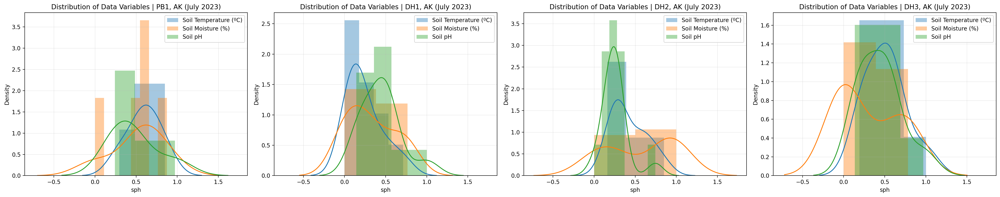

In [40]:
ls=['PB1','DH1','DH2','DH3']
fig,axes=plt.subplots(1,4,figsize=(25,5),sharex=True);
for i in range(0,4):
    #sns.distplot(df2sc.loc[i,'hin'],label='Heat Index (ºC)');
    sns.distplot(dfsc.loc[i,'sot'],ax=axes[i],label='Soil Temperature (ºC)');
    sns.distplot(dfsc.loc[i,'som'],ax=axes[i],label='Soil Moisture (%)');
    sns.distplot(dfsc.loc[i,'sph'],ax=axes[i],label='Soil pH');
    axes[i].grid(linewidth=0.2);
    axes[i].legend(loc='best');
    axes[i].set_title(f"Distribution of Data Variables | {ls[i]}, AK (July 2023)")
    plt.tight_layout()
#fig.savefig('data_distplot.png',dpi=1000);
fig.show()

In [68]:
# data2.columns.values.tolist()[2:-1]
# 'Temperature (ºC)',
#  'Wet Bulb Temp (ºC)',
#  'Relative Humidity (%)',
#  'Barometric Pressure (mb)',
#  'Altitude (m)',
#  'Station Pressure (mb)',
#  'Wind Speed (km/h)',
#  'Heat Index (ºC)',
#  'Dew Point (ºC)',
#  'Density Altitude (m)',
#  'Wind Chill (ºC)']

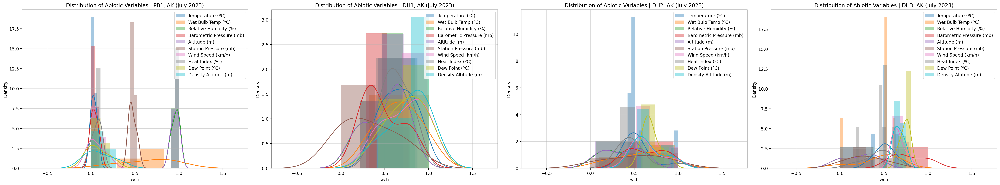

In [41]:
ls=['PB1','DH1','DH2','DH3']
ls2=df2sc.columns.values.tolist()[2:-1]
fig,axes=plt.subplots(1,4,figsize=(32,6),sharex=True);
for i in range(0,4):
    for j in range(0,10):
        #sns.distplot(df2sc.loc[i,'hin'],label='Heat Index (ºC)');
        sns.distplot(df2sc.loc[i,ls2[j]],ax=axes[i],label=f"{data2.columns.values.tolist()[2:-1][j]}")
        axes[i].grid(linewidth=0.2);
        axes[i].legend(loc='upper right');
        axes[i].set_title(f"Distribution of Abiotic Variables | {ls[i]}, AK (July 2023)")
        plt.tight_layout()
#fig.savefig('abiotics_distplot.png',dpi=1000);
fig.show()

In [920]:
# sns.distplot(df2sc.loc[1,'hin'])
# sns.distplot(dfsc.loc[1,'sot']);
# sns.distplot(dfsc.loc[1,'som']);
# sns.distplot(dfsc.loc[1,'sph']);

In [921]:
# sns.distplot(df2sc.loc[2,'hin'])
# sns.distplot(dfsc.loc[2,'sot']);
# sns.distplot(dfsc.loc[2,'som']);
# sns.distplot(dfsc.loc[2,'sph']);

In [922]:
# sns.distplot(df2sc.loc[3,'hin'])
# sns.distplot(dfsc.loc[3,'sot']);
# sns.distplot(dfsc.loc[3,'som']);
# sns.distplot(dfsc.loc[3,'sph']);

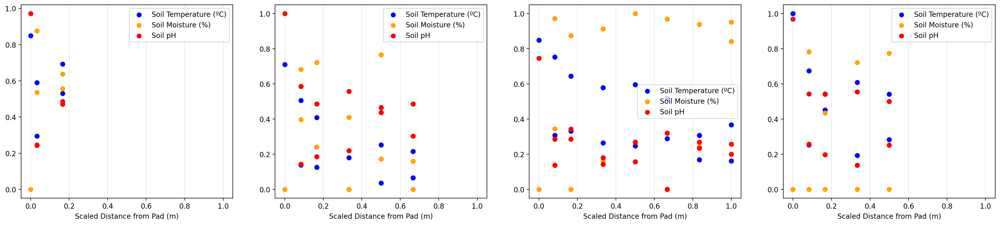

In [27]:
fig,(ax1,ax2,ax3,ax4)=plt.subplots(1,4,figsize=(25,5),sharex=True)
ax1.scatter(ds.dis[:15],ds.sot[:15],color='blue',label='Soil Temperature (ºC)');
ax1.scatter(ds.dis[:15],ds.som[:15],color='orange',label='Soil Moisture (%)');
ax1.scatter(ds.dis[:15],ds.sph[:15],color='red',label='Soil pH');
ax1.xaxis.grid(True,alpha=0.3)
ax1.set_xlabel('Scaled Distance from Pad (m)')
ax1.legend(loc='best')
ax2.scatter(ds.dis[15:81],ds.sot[15:81],color='blue',label='Soil Temperature (ºC)');
ax2.scatter(ds.dis[15:81],ds.som[15:81],color='orange',label='Soil Moisture (%)');
ax2.scatter(ds.dis[15:81],ds.sph[15:81],color='red',label='Soil pH');
ax2.xaxis.grid(True,alpha=0.3)
ax2.set_xlabel('Scaled Distance from Pad (m)')
ax2.legend(loc='best')
ax3.scatter(ds.dis[81:201],ds.sot[81:201],color='blue',label='Soil Temperature (ºC)');
ax3.scatter(ds.dis[81:201],ds.som[81:201],color='orange',label='Soil Moisture (%)');
ax3.scatter(ds.dis[81:201],ds.sph[81:201],color='red',label='Soil pH');
ax3.xaxis.grid(True,alpha=0.3)
ax3.set_xlabel('Scaled Distance from Pad (m)')
ax3.legend(loc='best')
ax4.scatter(ds.dis[201:],ds.sot[201:],color='blue',label='Soil Temperature (ºC)');
ax4.scatter(ds.dis[201:],ds.som[201:],color='orange',label='Soil Moisture (%)');
ax4.scatter(ds.dis[201:],ds.sph[201:],color='red',label='Soil pH');
ax4.xaxis.grid(True,alpha=0.3)
ax4.set_xlabel('Scaled Distance from Pad (m)')
ax4.legend(loc='best')
plt.show();

In [1085]:
# plt.scatter(ds['dis'],ds['sot']);
# plt.scatter(ds['dis'],ds['som']);
# plt.scatter(ds['dis'],ds['sph']);

In [1086]:
# plt.scatter(ds.to_xarray()['dis'], ds.to_xarray()['sot'], color='blue');
# plt.scatter(ds.to_xarray()['dis'], ds.to_xarray()['som'], color='orange');
# plt.scatter(ds.to_xarray()['dis'], ds.to_xarray()['sph'], color='red');

In [1087]:
# #(((features.to_xarray().Longitude + 180) % 360) - 180).plot();#.set_coords({"Longitude": (((features.to_xarray().Longitude + 180) % 360) - 180)}).expand_dims({'NewDim':features['Soil Temperature (C)']})#['Soil Temperature (C)'].assign_attrs(units="Celsius", description="Soil Temperature (ºC)")
# ds.to_xarray()['dis'].plot();
# plt.twinx()
# ds.to_xarray()['som'].plot(color='orange');
# plt.grid(linewidth=0.25)
# plt.axvline(x=5, linestyle='dashed')
# plt.axvline(x=16, linestyle='dashed')
# plt.axvline(x=31, linestyle='dashed')

In [ ]:
# features=ds
# features.columns=ds.columns.tolist()
# features.index=ds.index.tolist()
# #features=features[['date','lon', 'lat', 'dist', 'depth', 'st', 'sm', 'ph', 'temp','wettemp', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch']]
# features

In [ ]:
# featuresites=dsnewscsites
# featuresites.columns=['lon', 'lat', 'dist', 'depth', 'st', 'sm', 'ph', 'date', 'temp','wettemp', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch']
# featuresites=featuresites[['date','lon', 'lat', 'dist', 'depth', 'st', 'sm', 'ph', 'temp','wettemp', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch']]

In [ ]:
#display(HTML(features.isnull().to_html()))
#compute_vif(features).sort_values('VIF', ascending=False)
#features=features.interpolate(method='polynomial', order=5)
#features=features.interpolate(method='from_derivatives')
#features=features.interpolate(method='akima')
#features=features.interpolate(method='pchip')

In [ ]:
#sns.heatmap(dssc[dssc.columns.tolist()].corr());

In [ ]:
#sns.heatmap(ds[ds.columns.tolist()].corr());

In [ ]:
#sns.heatmap(ds.corr(),cmap='jet');

#### VIF

In [57]:
#compute_vif(features).sort_values('VIF', ascending=False)

In [56]:
#compute_vif(features2).sort_values('VIF', ascending=False)

In [66]:
#compute_vif(features).sort_values('VIF', ascending=False)

In [202]:
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
8,stp,9194.464278
6,bp,7989.958316
7,alt,4119.270775
4,wet,3267.479465
3,tem,2271.824500
11,dew,1760.178532
2,lat,1188.081685
1,lon,1161.419436
5,rh,750.092940
10,hin,328.612439


In [203]:
features2=features2.drop('stp',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
7,alt,3418.446956
6,bp,3287.456475
4,wet,2899.297264
3,tem,1939.578224
10,dew,1760.122238
2,lat,1186.214910
1,lon,1160.962929
5,rh,646.828106
9,hin,328.282523
13,sot,9.528458


In [204]:
features2=features2.drop('bp',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
4,wet,2085.696049
9,dew,1705.884616
3,tem,1462.315781
2,lat,1157.121314
1,lon,1137.654070
5,rh,562.169117
8,hin,328.265082
6,alt,9.948102
12,sot,9.513195
11,dep,6.314913


In [205]:
features2=features2.drop('alt',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
4,wet,1859.850409
8,dew,1691.258179
2,lat,1146.765942
1,lon,1136.016587
3,tem,1109.646526
5,rh,525.659204
7,hin,287.715498
11,sot,9.510187
10,dep,6.313289
12,som,3.588019


In [206]:
features2=features2.drop('wet',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
2,lat,1145.293229
1,lon,1134.844721
7,dew,910.345031
3,tem,809.432325
4,rh,523.921805
6,hin,286.185602
10,sot,9.506411
9,dep,6.311327
11,som,3.587972
12,sph,3.117887


In [207]:
features2=features2.drop('tem',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
2,lat,1141.256271
1,lon,1130.298630
6,dew,312.697717
5,hin,244.082213
3,rh,138.101483
9,sot,9.491393
8,dep,6.303296
10,som,3.587627
11,sph,3.117798
7,dis,2.988345


In [208]:
features2=features2.drop('dew',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
2,lat,1129.427071
1,lon,1119.938499
8,sot,9.478208
7,dep,6.296509
9,som,3.587498
10,sph,3.117791
6,dis,2.988287
5,hin,1.669549
0,dat,1.346387
4,wsp,1.193048


In [209]:
features2=features2.drop('lat',axis=1)
compute_vif(features2).sort_values('VIF', ascending=False)

,Variable,VIF
8,som,3.580280
7,sot,3.440597
6,dep,3.206669
9,sph,2.478903
1,lon,1.884598
5,dis,1.784443
4,hin,1.664011
0,dat,1.329324
3,wsp,1.160164
2,rh,1.092162


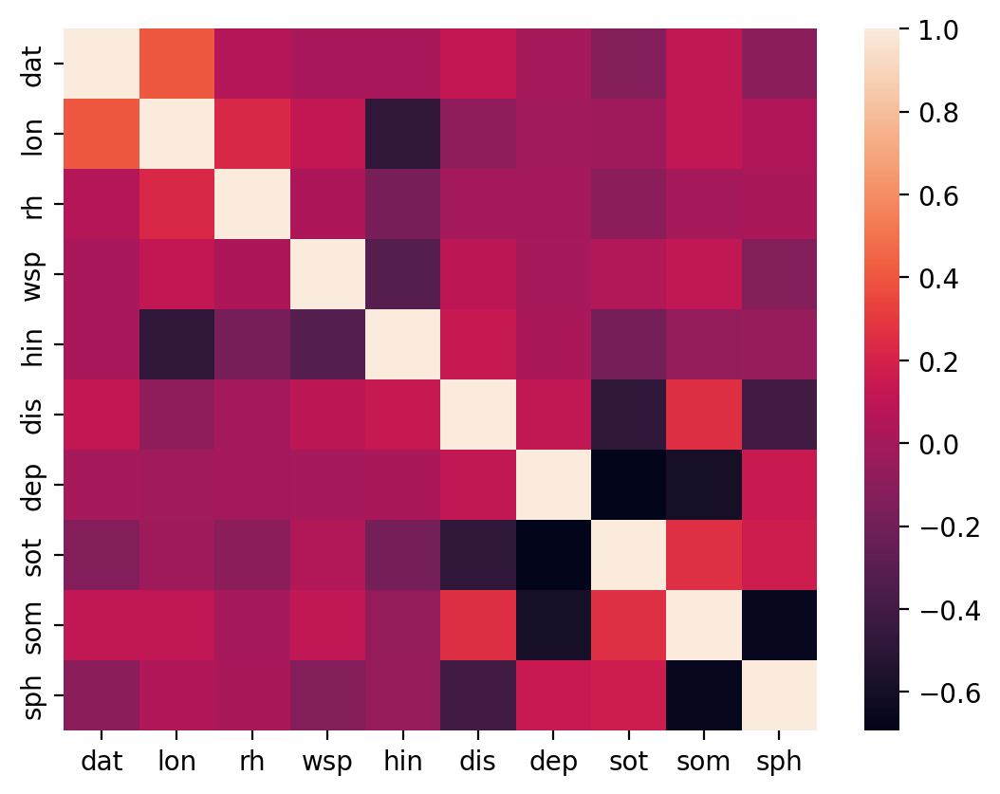

In [210]:
# features2=features2.drop('lon',axis=1)
# compute_vif(features2).sort_values('VIF', ascending=False)
# features2=features2.drop('rh',axis=1)
# compute_vif(features2).sort_values('VIF', ascending=False)
# features2=features2.drop('hin',axis=1)
# compute_vif(features2).sort_values('VIF', ascending=False)
sns.heatmap(features2.corr());

##### VIF Archived

In [ ]:
#dsnewsc2=dsnewsc.interpolate(method='polynomial', order=5)
#compute_vif(dsnewsc2).sort_values('VIF', ascending=False)
dsnewscfeat=dsnewsc2.drop('bp',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('alt',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('wettemp',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('lat',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('temp',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('dew',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('wch',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('stp',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

In [ ]:
dsnewscfeat=dsnewscfeat.drop('dal',axis=1)
compute_vif(dsnewscfeat).sort_values('VIF', ascending=False)

#### Vmax, Correlograms, Autocorrelation

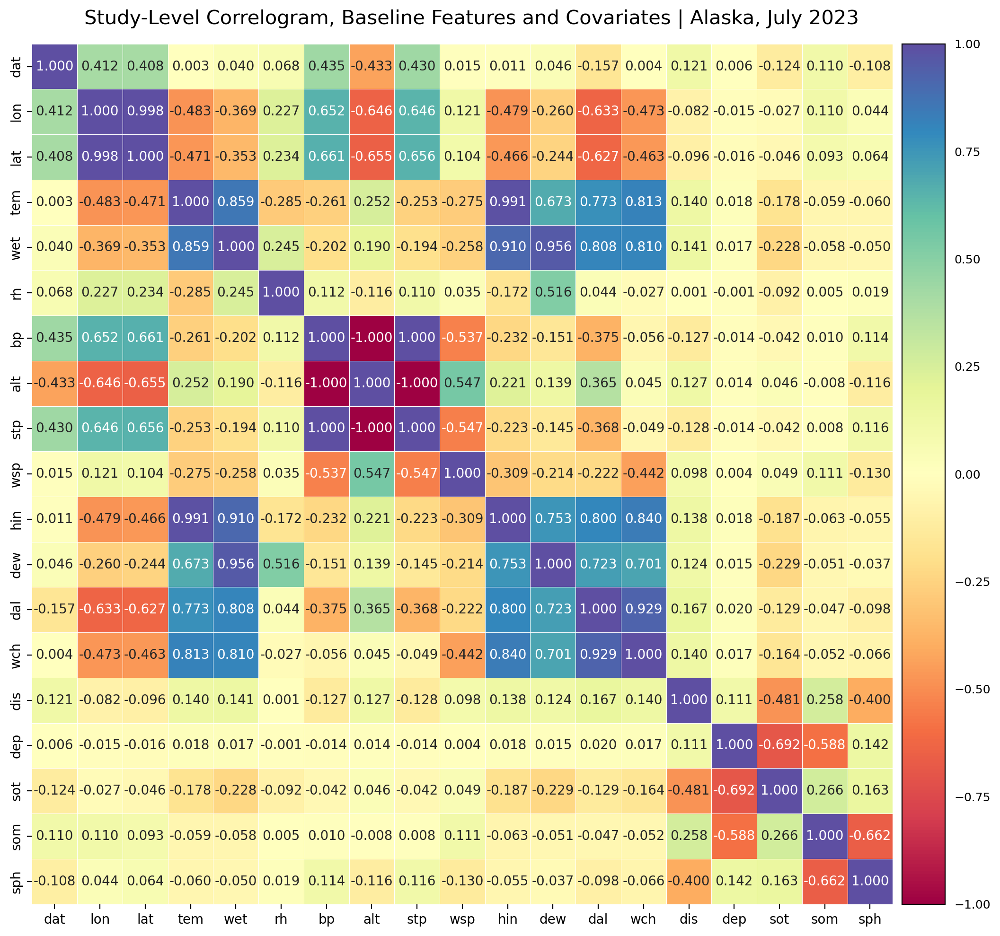

In [105]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

vmax = np.abs(ds2.corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(12,10))
heatmap=sns.heatmap(ds2.corr(),
                xticklabels=ds2.corr().columns.values,
                yticklabels=ds2.corr().columns.values,
                annot=True,
                fmt='.3f',
                cmap='Spectral',
                #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
                #cmap=sns.diverging_palette(250, 30, l=65, center="dark", as_cmap=True),
                #cmap=sns.color_palette('plasma',n_colors=13),
                #cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
                square=True,
                linewidth=0.25,
                vmin=-vmax,
                vmax=vmax,
                ax=ax,
                cbar=False);
                #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)  # Control size and padding of the colorbar

cbar = plt.colorbar(heatmap.get_children()[0], cax=cax)
cbar.ax.tick_params(labelsize=9)  # Adjust the font size of the colorbar ticks

#plt.xticks(rotation=45, ha='right', fontsize=9)  # Rotate x-axis labels for better fit
#plt.yticks(rotation=0, fontsize=9)  # Keep y-axis labels horizontal

ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Study-Level Correlogram, Baseline Features and Covariates | Alaska, July 2023',pad=15, fontsize=15, x=-10);
plt.tick_params(left=False, bottom=False,right=False)
#plt.subplots_adjust(left=0.2, bottom=0.2)
plt.tight_layout()
plt.show()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_ds.png',dpi=1000,bbox_inches='tight')

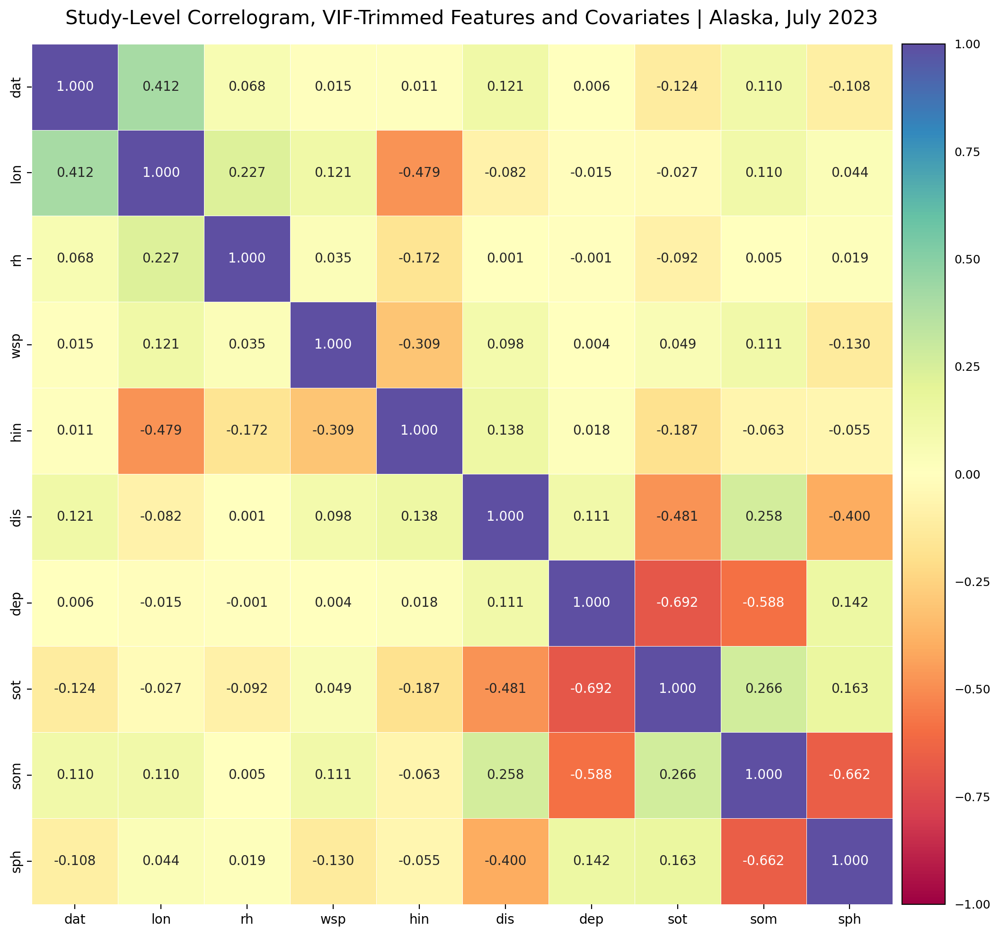

In [212]:
vmax = np.abs(features2.corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(12,10))
sns.heatmap(features2.corr(),
                xticklabels=features2.corr().columns.values,
                yticklabels=features2.corr().columns.values,
                annot=True,
                fmt='.3f',
                cmap='Spectral',
                #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
                #cmap=sns.diverging_palette(250, 30, l=65, center="dark", as_cmap=True),
                #cmap=sns.color_palette('plasma',n_colors=13),
                #cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
                square=True,
                linewidth=0.25,
                vmin=-vmax,
                vmax=vmax,
                ax=ax,
                cbar=False);
                #cbar=False,);
                #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)  # Control size and padding of the colorbar

cbar = plt.colorbar(heatmap.get_children()[0], cax=cax)
cbar.ax.tick_params(labelsize=9)  # Adjust the font size of the colorbar ticks

ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Study-Level Correlogram, VIF-Trimmed Features and Covariates | Alaska, July 2023',pad=15, fontsize=15, x=-10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
plt.show()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_featuresvif.png',dpi=1000,bbox_inches='tight')

In [ ]:
#data.columns
#data2.columns
#['Site', 'Longitude', 'Latitude', 'Distance from Pad (m)', 'Depth (cm)', 'Soil Temperature (C)', 'Soil Moisture (%)', 'Soil pH']
#['Site', 'Date Time', 'Temperature (ºC)', 'Wet Bulb Temp (ºC)', 'Relative Humidity (%)', 'Barometric Pressure (mb)', 'Altitude (m)', 'Station Pressure (mb)', 'Wind Speed (km/h)', 'Heat Index (ºC)', 'Dew Point (ºC)', 'Density Altitude (m)', 'Wind Chill (ºC)', 'Data Type']

#ds.columns.tolist()
#['Date Time', 'Longitude', 'Latitude', 'Temperature (ºC)', 'Wet Bulb Temp (ºC)', 'Relative Humidity (%)', 'Barometric Pressure (mb)', 'Altitude (m)', 'Station Pressure (mb)', 'Wind Speed (km/h)', 'Heat Index (ºC)', 'Dew Point (ºC)', 'Density Altitude (m)', 'Wind Chill (ºC)', 'Distance from Pad (m)', 'Depth (cm)', 'Soil Temperature (C)', 'Soil Moisture (%)', 'Soil pH']

#features.columns.tolist()
#data.columns.values.tolist()
#print(data.columns.values.tolist())
#print(data2.columns.values.tolist())

#['Site', 'Longitude', 'Latitude', 'Distance from Pad (m)', 'Depth (cm)', 'Soil Temperature (C)', 'Soil Moisture (%)', 'Soil pH']
#['Site', 'Date Time', 'Temperature (ºC)', 'Wet Bulb Temp (ºC)', 'Relative Humidity (%)', 'Barometric Pressure (mb)', 'Altitude (m)', 
#'Station Pressure (mb)', 'Wind Speed (km/h)', 'Heat Index (ºC)', 'Dew Point (ºC)', 'Density Altitude (m)', 'Wind Chill (ºC)', 'Data Type']

In [215]:
print(ds2.columns.tolist())

['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dis', 'dep', 'sot', 'som', 'sph']


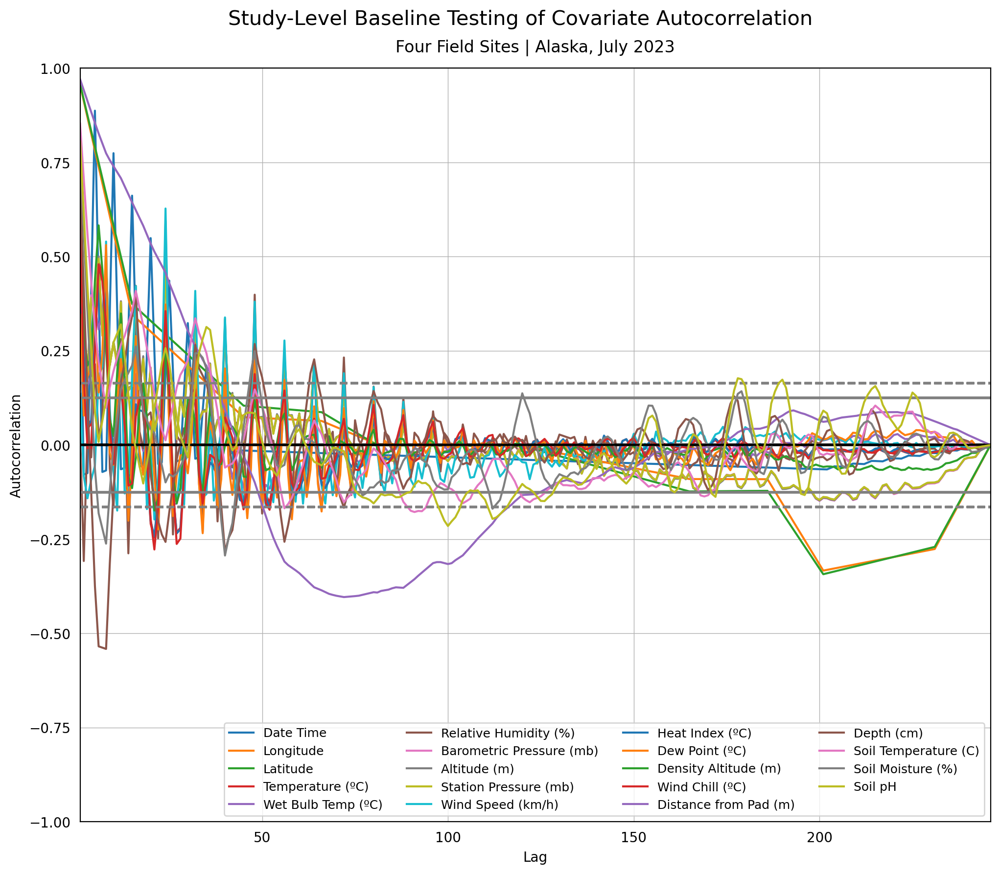

In [110]:
ls=ds2.columns.tolist()
ls2=['Date Time', 'Longitude', 'Latitude', 'Temperature (ºC)', 'Wet Bulb Temp (ºC)', 'Relative Humidity (%)', 'Barometric Pressure (mb)', 'Altitude (m)', 'Station Pressure (mb)', 'Wind Speed (km/h)', 'Heat Index (ºC)', 'Dew Point (ºC)', 'Density Altitude (m)', 'Wind Chill (ºC)', 'Distance from Pad (m)', 'Depth (cm)', 'Soil Temperature (C)', 'Soil Moisture (%)', 'Soil pH']
#plt.subplots(1,1,figsize=(10,8))
fig,ax=plt.subplots(1,1,figsize=(12,10))
plt.suptitle('Study-Level Baseline Testing of Covariate Autocorrelation',fontsize=15, y=0.94)
plt.title('Four Field Sites | Alaska, July 2023',fontsize=12, pad=12)
#plt.xlabel('Soil Moisture (%)',fontsize=10, labelpad=8)
#plt.ylabel('Soil pH',fontsize=10, labelpad=8)
for i in range(len(ls)):
    autocorrelation_plot(ds2[ls[i]],label=ls2[i])
plt.grid(linewidth=0.5)
#plt.ylim(-0.75,1)
plt.tick_params(bottom = False)
plt.tick_params(left = False)
plt.legend(loc='lower right',ncol=4,fontsize=9);
plt.show()
#plt.savefig('/Users/bgay/Downloads/studylevel_ds_autoc.png',dpi=1000,bbox_inches='tight')

In [216]:
print(features2.columns.tolist())

['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']


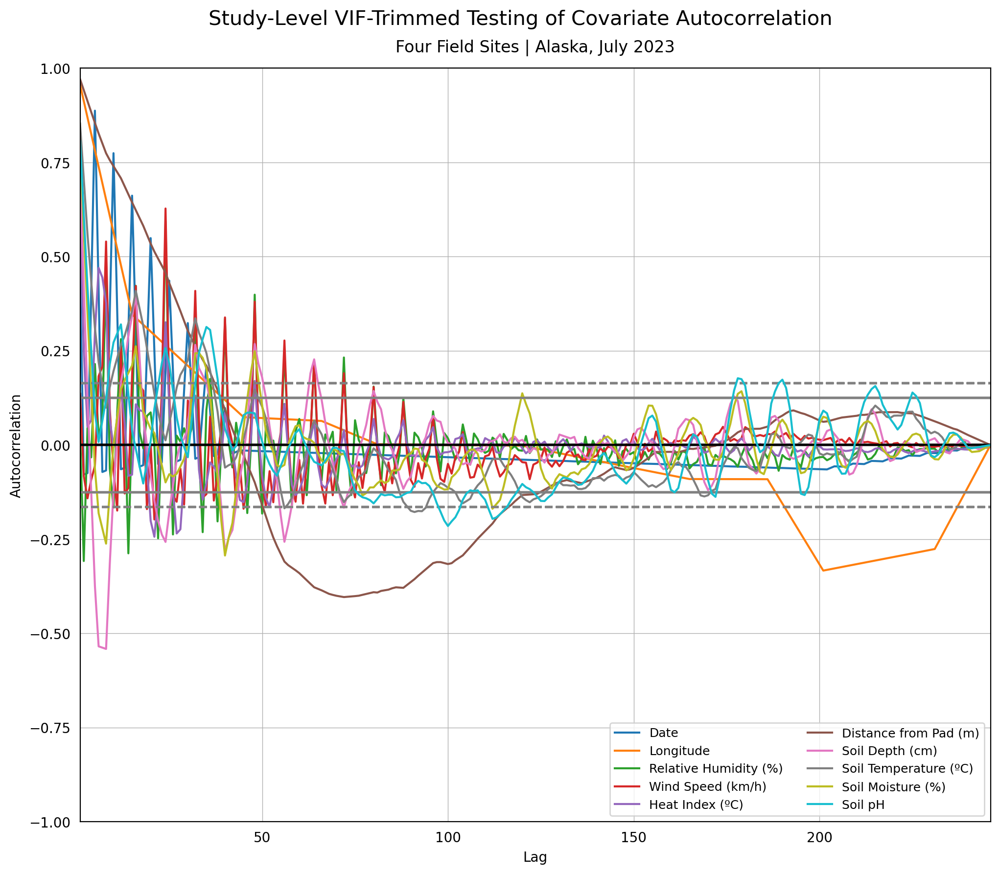

In [217]:
ls=features2.columns.tolist()
ls2=['Date','Longitude','Relative Humidity (%)','Wind Speed (km/h)','Heat Index (ºC)','Distance from Pad (m)',
     'Soil Depth (cm)','Soil Temperature (ºC)','Soil Moisture (%)','Soil pH']
plt.subplots(1,1,figsize=(12,10))
plt.suptitle('Study-Level VIF-Trimmed Testing of Covariate Autocorrelation',fontsize=15, y=0.94)
plt.title('Four Field Sites | Alaska, July 2023',fontsize=12, pad=12)
#plt.xlabel('Soil Moisture (%)',fontsize=10, labelpad=8)
#plt.ylabel('Soil pH',fontsize=10, labelpad=8)
for i in range(len(ls)):
    autocorrelation_plot(features2[ls[i]],label=ls2[i])
plt.grid(linewidth=0.5)
plt.tick_params(bottom = False) 
plt.tick_params(left = False)
plt.legend(loc='lower right',ncol=2,fontsize=9);
plt.show()
#plt.savefig('/Users/bgay/Downloads/studylevel_featuresvif_autoc.png',dpi=1000,bbox_inches='tight')

In [ ]:
#:15, 15:81, 81:201, 201:

In [ ]:
vmax = np.abs(ds[:15].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(ds[ds.columns.tolist()][:15].corr(),
            xticklabels=ds[ds.columns.tolist()][:15].corr().columns.values,
            yticklabels=ds[ds.columns.tolist()][:15].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
            #cmap=sns.diverging_palette(255, 360, 100, 50, 80, n=9, as_cmap=True),
            #cmap=sns.color_palette('plasma',n_colors=13),
            #cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
            #cbar=False,);
            #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, Baseline Features and Covariates | PB1, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout();
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_ds_pb1.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(ds[15:81].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(ds[ds.columns.tolist()][15:81].corr(),
            xticklabels=ds[ds.columns.tolist()][15:81].corr().columns.values,
            yticklabels=ds[ds.columns.tolist()][15:81].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, Baseline Features and Covariates | DH1, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_ds_dh1.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(ds[81:201].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(ds[ds.columns.tolist()][81:201].corr(),
            xticklabels=ds[ds.columns.tolist()][81:201].corr().columns.values,
            yticklabels=ds[ds.columns.tolist()][81:201].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, Baseline Features and Covariates | DH2, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_ds_dh2.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(ds[201:].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(ds[ds.columns.tolist()][201:].corr(),
            xticklabels=ds[ds.columns.tolist()][201:].corr().columns.values,
            yticklabels=ds[ds.columns.tolist()][201:].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, Baseline Features and Covariates | DH3, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_ds_dh3.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(features[:15].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(features[features.columns.tolist()][:15].corr(),
            xticklabels=features[features.columns.tolist()][:15].corr().columns.values,
            yticklabels=features[features.columns.tolist()][:15].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
            #cmap=sns.diverging_palette(255, 360, 100, 50, 80, n=9, as_cmap=True),
            #cmap=sns.color_palette('plasma',n_colors=13),
            #cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
            #cbar=False,);
            #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, VIF-Trimmed Features and Covariates | PB1, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_vif_pb1.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(features[15:81].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(features[features.columns.tolist()][15:81].corr(),
            xticklabels=features[features.columns.tolist()][15:81].corr().columns.values,
            yticklabels=features[features.columns.tolist()][15:81].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, VIF-Trimmed Features and Covariates | DH1, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_vif_dh1.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(features[81:201].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(features[features.columns.tolist()][81:201].corr(),
            xticklabels=features[features.columns.tolist()][81:201].corr().columns.values,
            yticklabels=features[features.columns.tolist()][81:201].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, VIF-Trimmed Features and Covariates | DH2, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_vif_dh2.png',dpi=1000,bbox_inches='tight')

In [ ]:
vmax = np.abs(features[201:].corr()).max().max()
fig,ax=plt.subplots(1,1,figsize=(15,12))
sns.heatmap(features[features.columns.tolist()][201:].corr(),
            xticklabels=features[features.columns.tolist()][201:].corr().columns.values,
            yticklabels=features[features.columns.tolist()][201:].corr().columns.values,
            annot=True,
            fmt='.3f',
            cmap='Spectral',
            square=True,
            linewidth=0.25,
            vmin=-vmax,
            vmax=vmax,
            ax=ax,);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10

plt.title('Site-Level Correlogram, VIF-Trimmed Features and Covariates | DH3, Alaska, July 2023',pad=10);
plt.tick_params(left=False, bottom=False,right=False)
plt.tight_layout()
#fig.figure.savefig('/Users/bgay/Downloads/studylevel_vif_dh3.png',dpi=1000,bbox_inches='tight')

In [ ]:
# fig,ax=plt.subplots(1,1,figsize=(20,15),dpi=300)
# sns.heatmap(dsnewscfeat.corr(),
#                 xticklabels=dsnewscfeat.corr().columns.values,
#                 yticklabels=dsnewscfeat.corr().columns.values,

#                 annot=True,
#                 fmt='.3f',
#                 #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
#                 #cmap=sns.diverging_palette(255, 360, 100, 50, 80, n=9, as_cmap=True),
#                 #cmap=sns.color_palette('plasma',n_colors=13),
#                 cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
#                 square=True,
#                 linewidth=0.25,
#                 ax=ax,);
#                 #cbar=False,);
#                 #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);
# ax.xaxis.labelpad=10
# ax.yaxis.labelpad=10

# plt.title('Group-Level Correlogram, VIF-Trimmed Covariates | Alaska, July 2023',pad=10);

# plt.tick_params(left=False, bottom=False,right=False)
# #fig.figure.savefig('/Users/bgay/Downloads/pads_data_hm.png',dpi=1000,bbox_inches='tight')

In [ ]:
# print('--------Site v. Longitude--------')
# print([pearsonr(df['site'], df['lon'])])
# print([spearmanr(df['site'], df['lon'])])
# print('')
# print('--------Site v. Latitude--------')
# print([pearsonr(df['site'], df['lat'])])
# print([spearmanr(df['site'], df['lat'])])
# print('')
# print('--------Site v. Distance from Pad (m)--------')
# print([pearsonr(df['site'], df['dist'])])
# print([spearmanr(df['site'], df['dist'])])
# print('')
# print('--------Site v. Depth (cm)--------')
# print([pearsonr(df['site'], df['depth'])])
# print([spearmanr(df['site'], df['depth'])])
# print('')
# print('--------Site v. Soil Temperature (C)--------')
# print([pearsonr(df['site'], df['st'])])
# print([spearmanr(df['site'], df['st'])])
# print('')
# print('--------Site v. Soil Moisture (%)--------')
# print([pearsonr(df['site'], df['sm'])])
# print([spearmanr(df['site'], df['sm'])])
# print('')
# print('--------Site v. Soil pH--------')
# print([pearsonr(df['site'], df['ph'])])
# print([spearmanr(df['site'], df['ph'])])
# print('')
# print('--------Longitude v. Latitude--------')
# print([pearsonr(df['lon'], df['lat'])])
# print([spearmanr(df['lon'], df['lat'])])
# print('')
# print('--------Longitude v. Distance from Pad (m)--------')
# print([pearsonr(df['lon'], df['dist'])])
# print([spearmanr(df['lon'], df['dist'])])
# print('')
# print('--------Longitude v. Depth (cm)--------')
# print([pearsonr(df['lon'], df['depth'])])
# print([spearmanr(df['lon'], df['depth'])])
# print('')
# print('--------Longitude v. Soil Temperature (C)--------')
# print([pearsonr(df['lon'], df['st'])])
# print([spearmanr(df['lon'], df['st'])])
# print('')
# print('--------Longitude v. Soil Moisture (%)--------')
# print([pearsonr(df['lon'], df['sm'])])
# print([spearmanr(df['lon'], df['sm'])])
# print('')
# print('--------Longitude v. Soil pH--------')
# print([pearsonr(df['lon'], df['ph'])])
# print([spearmanr(df['lon'], df['ph'])])
# print('')
# print('--------Latitude v. Distance--------')
# print([pearsonr(df['lon'], df['dist'])])
# print([spearmanr(df['lon'], df['dist'])])
# print('')
# print('--------Latitude v. Depth--------')
# print([pearsonr(df['lon'], df['depth'])])
# print([spearmanr(df['lon'], df['depth'])])
# print('')
# print('--------Latitude v. Soil Temperature (C)--------')
# print([pearsonr(df['lon'], df['st'])])
# print([spearmanr(df['lon'], df['st'])])
# print('')
# print('--------Latitude v. Soil Moisture (%)--------')
# print([pearsonr(df['lon'], df['sm'])])
# print([spearmanr(df['lon'], df['sm'])])
# print('')
# print('--------Latitude v. Soil pH--------')
# print([pearsonr(df['lon'], df['ph'])])
# print([spearmanr(df['lon'], df['ph'])])
# print('')
# print('--------Distance from Pad (m) v. Depth (cm)--------')
# print([pearsonr(df['dist'], df['depth'])])
# print([spearmanr(df['dist'], df['depth'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
# print([pearsonr(df['dist'], df['st'])])
# print([spearmanr(df['dist'], df['st'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Moisture (%)--------')
# print([pearsonr(df['dist'], df['sm'])])
# print([spearmanr(df['dist'], df['sm'])])
# print('')
# print('--------Distance from Pad (m) v. Soil pH--------')
# print([pearsonr(df['dist'], df['ph'])])
# print([spearmanr(df['dist'], df['ph'])])
# print('')
# print('--------Depth (cm) v. Soil Temperature (C)--------')
# print([pearsonr(df['depth'], df['st'])])
# print([spearmanr(df['depth'], df['st'])])
# print('')
# print('--------Depth (cm) v. Soil Moisture (%)--------')
# print([pearsonr(df['depth'], df['sm'])])
# print([spearmanr(df['depth'], df['sm'])])
# print('')
# print('--------Depth (cm) v. Soil pH--------')
# print([pearsonr(df['depth'], df['ph'])])
# print([spearmanr(df['depth'], df['ph'])])
# print('')
# print('--------Soil Temperature (C) v. Soil Moisture (%)--------')
# print([pearsonr(df['st'], df['sm'])])
# print([spearmanr(df['st'], df['sm'])])
# print('')
# print('--------Soil Temperature (C) v. Soil pH--------')
# print([pearsonr(df['st'], df['ph'])])
# print([spearmanr(df['st'], df['ph'])])
# print('')
# print('--------Soil Moisture (%) v. Soil pH--------')
# print([pearsonr(df['sm'], df['ph'])])
# print([spearmanr(df['sm'], df['ph'])])

In [ ]:
# print('--------Site v. Longitude--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['lon'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['lon'])])
# print('')
# print('--------Site v. Latitude--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['lat'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['lat'])])
# print('')
# print('--------Site v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['dist'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['dist'])])
# print('')
# print('--------Site v. Depth (cm)--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['depth'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['depth'])])
# print('')
# print('--------Site v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['st'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['st'])])
# print('')
# print('--------Site v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['sm'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['sm'])])
# print('')
# print('--------Site v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['site'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['site'], df.iloc[0:5]['ph'])])
# print('')
# print('--------Longitude v. Latitude--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['lat'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['lat'])])
# print('')
# print('--------Longitude v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['dist'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['dist'])])
# print('')
# print('--------Longitude v. Depth (cm)--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['depth'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['depth'])])
# print('')
# print('--------Longitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['st'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['st'])])
# print('')
# print('--------Longitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['sm'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['sm'])])
# print('')
# print('--------Longitude v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['ph'])])
# print('')
# print('--------Latitude v. Distance--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['dist'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['dist'])])
# print('')
# print('--------Latitude v. Depth--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['depth'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['depth'])])
# print('')
# print('--------Latitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['st'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['st'])])
# print('')
# print('--------Latitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['sm'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['sm'])])
# print('')
# print('--------Latitude v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['lon'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['lon'], df.iloc[0:5]['ph'])])
# print('')
# print('--------Distance from Pad (m) v. Depth (cm)--------')
# print([pearsonr(df.iloc[0:5]['dist'], df.iloc[0:5]['depth'])])
# print([spearmanr(df.iloc[0:5]['dist'], df.iloc[0:5]['depth'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[0:5]['dist'], df.iloc[0:5]['st'])])
# print([spearmanr(df.iloc[0:5]['dist'], df.iloc[0:5]['st'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[0:5]['dist'], df.iloc[0:5]['sm'])])
# print([spearmanr(df.iloc[0:5]['dist'], df.iloc[0:5]['sm'])])
# print('')
# print('--------Distance from Pad (m) v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['dist'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['dist'], df.iloc[0:5]['ph'])])
# print('')
# print('--------Depth (cm) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[0:5]['depth'], df.iloc[0:5]['st'])])
# print([spearmanr(df.iloc[0:5]['depth'], df.iloc[0:5]['st'])])
# print('')
# print('--------Depth (cm) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[0:5]['depth'], df.iloc[0:5]['sm'])])
# print([spearmanr(df.iloc[0:5]['depth'], df.iloc[0:5]['sm'])])
# print('')
# print('--------Depth (cm) v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['depth'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['depth'], df.iloc[0:5]['ph'])])
# print('')
# print('--------Soil Temperature (C) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[0:5]['st'], df.iloc[0:5]['sm'])])
# print([spearmanr(df.iloc[0:5]['st'], df.iloc[0:5]['sm'])])
# print('')
# print('--------Soil Temperature (C) v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['st'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['st'], df.iloc[0:5]['ph'])])
# print('')
# print('--------Soil Moisture (%) v. Soil pH--------')
# print([pearsonr(df.iloc[0:5]['sm'], df.iloc[0:5]['ph'])])
# print([spearmanr(df.iloc[0:5]['sm'], df.iloc[0:5]['ph'])])

In [ ]:
# print('--------Site v. Longitude--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['lon'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['lon'])])
# print('')
# print('--------Site v. Latitude--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['lat'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['lat'])])
# print('')
# print('--------Site v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['dist'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['dist'])])
# print('')
# print('--------Site v. Depth (cm)--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['depth'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['depth'])])
# print('')
# print('--------Site v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['st'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['st'])])
# print('')
# print('--------Site v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['sm'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['sm'])])
# print('')
# print('--------Site v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['site'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['site'], df.iloc[5:16]['ph'])])
# print('')
# print('--------Longitude v. Latitude--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['lat'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['lat'])])
# print('')
# print('--------Longitude v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['dist'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['dist'])])
# print('')
# print('--------Longitude v. Depth (cm)--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['depth'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['depth'])])
# print('')
# print('--------Longitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['st'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['st'])])
# print('')
# print('--------Longitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['sm'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['sm'])])
# print('')
# print('--------Longitude v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['ph'])])
# print('')
# print('--------Latitude v. Distance--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['dist'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['dist'])])
# print('')
# print('--------Latitude v. Depth--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['depth'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['depth'])])
# print('')
# print('--------Latitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['st'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['st'])])
# print('')
# print('--------Latitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['sm'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['sm'])])
# print('')
# print('--------Latitude v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['lon'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['lon'], df.iloc[5:16]['ph'])])
# print('')
# print('--------Distance from Pad (m) v. Depth (cm)--------')
# print([pearsonr(df.iloc[5:16]['dist'], df.iloc[5:16]['depth'])])
# print([spearmanr(df.iloc[5:16]['dist'], df.iloc[5:16]['depth'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[5:16]['dist'], df.iloc[5:16]['st'])])
# print([spearmanr(df.iloc[5:16]['dist'], df.iloc[5:16]['st'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[5:16]['dist'], df.iloc[5:16]['sm'])])
# print([spearmanr(df.iloc[5:16]['dist'], df.iloc[5:16]['sm'])])
# print('')
# print('--------Distance from Pad (m) v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['dist'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['dist'], df.iloc[5:16]['ph'])])
# print('')
# print('--------Depth (cm) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[5:16]['depth'], df.iloc[5:16]['st'])])
# print([spearmanr(df.iloc[5:16]['depth'], df.iloc[5:16]['st'])])
# print('')
# print('--------Depth (cm) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[5:16]['depth'], df.iloc[5:16]['sm'])])
# print([spearmanr(df.iloc[5:16]['depth'], df.iloc[5:16]['sm'])])
# print('')
# print('--------Depth (cm) v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['depth'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['depth'], df.iloc[5:16]['ph'])])
# print('')
# print('--------Soil Temperature (C) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[5:16]['st'], df.iloc[5:16]['sm'])])
# print([spearmanr(df.iloc[5:16]['st'], df.iloc[5:16]['sm'])])
# print('')
# print('--------Soil Temperature (C) v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['st'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['st'], df.iloc[5:16]['ph'])])
# print('')
# print('--------Soil Moisture (%) v. Soil pH--------')
# print([pearsonr(df.iloc[5:16]['sm'], df.iloc[5:16]['ph'])])
# print([spearmanr(df.iloc[5:16]['sm'], df.iloc[5:16]['ph'])])

In [ ]:
# print('--------Site v. Longitude--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['lon'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['lon'])])
# print('')
# print('--------Site v. Latitude--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['lat'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['lat'])])
# print('')
# print('--------Site v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['dist'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['dist'])])
# print('')
# print('--------Site v. Depth (cm)--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['depth'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['depth'])])
# print('')
# print('--------Site v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['st'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['st'])])
# print('')
# print('--------Site v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['sm'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['sm'])])
# print('')
# print('--------Site v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['site'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['site'], df.iloc[16:31]['ph'])])
# print('')
# print('--------Longitude v. Latitude--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['lat'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['lat'])])
# print('')
# print('--------Longitude v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['dist'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['dist'])])
# print('')
# print('--------Longitude v. Depth (cm)--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['depth'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['depth'])])
# print('')
# print('--------Longitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['st'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['st'])])
# print('')
# print('--------Longitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['sm'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['sm'])])
# print('')
# print('--------Longitude v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['ph'])])
# print('')
# print('--------Latitude v. Distance--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['dist'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['dist'])])
# print('')
# print('--------Latitude v. Depth--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['depth'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['depth'])])
# print('')
# print('--------Latitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['st'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['st'])])
# print('')
# print('--------Latitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['sm'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['sm'])])
# print('')
# print('--------Latitude v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['lon'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['lon'], df.iloc[16:31]['ph'])])
# print('')
# print('--------Distance from Pad (m) v. Depth (cm)--------')
# print([pearsonr(df.iloc[16:31]['dist'], df.iloc[16:31]['depth'])])
# print([spearmanr(df.iloc[16:31]['dist'], df.iloc[16:31]['depth'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[16:31]['dist'], df.iloc[16:31]['st'])])
# print([spearmanr(df.iloc[16:31]['dist'], df.iloc[16:31]['st'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[16:31]['dist'], df.iloc[16:31]['sm'])])
# print([spearmanr(df.iloc[16:31]['dist'], df.iloc[16:31]['sm'])])
# print('')
# print('--------Distance from Pad (m) v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['dist'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['dist'], df.iloc[16:31]['ph'])])
# print('')
# print('--------Depth (cm) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[16:31]['depth'], df.iloc[16:31]['st'])])
# print([spearmanr(df.iloc[16:31]['depth'], df.iloc[16:31]['st'])])
# print('')
# print('--------Depth (cm) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[16:31]['depth'], df.iloc[16:31]['sm'])])
# print([spearmanr(df.iloc[16:31]['depth'], df.iloc[16:31]['sm'])])
# print('')
# print('--------Depth (cm) v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['depth'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['depth'], df.iloc[16:31]['ph'])])
# print('')
# print('--------Soil Temperature (C) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[16:31]['st'], df.iloc[16:31]['sm'])])
# print([spearmanr(df.iloc[16:31]['st'], df.iloc[16:31]['sm'])])
# print('')
# print('--------Soil Temperature (C) v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['st'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['st'], df.iloc[16:31]['ph'])])
# print('')
# print('--------Soil Moisture (%) v. Soil pH--------')
# print([pearsonr(df.iloc[16:31]['sm'], df.iloc[16:31]['ph'])])
# print([spearmanr(df.iloc[16:31]['sm'], df.iloc[16:31]['ph'])])

In [ ]:
# print('--------Site v. Longitude--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['lon'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['lon'])])
# print('')
# print('--------Site v. Latitude--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['lat'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['lat'])])
# print('')
# print('--------Site v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['dist'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['dist'])])
# print('')
# print('--------Site v. Depth (cm)--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['depth'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['depth'])])
# print('')
# print('--------Site v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['st'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['st'])])
# print('')
# print('--------Site v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['sm'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['sm'])])
# print('')
# print('--------Site v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['site'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['site'], df.iloc[31:]['ph'])])
# print('')
# print('--------Longitude v. Latitude--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['lat'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['lat'])])
# print('')
# print('--------Longitude v. Distance from Pad (m)--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['dist'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['dist'])])
# print('')
# print('--------Longitude v. Depth (cm)--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['depth'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['depth'])])
# print('')
# print('--------Longitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['st'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['st'])])
# print('')
# print('--------Longitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['sm'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['sm'])])
# print('')
# print('--------Longitude v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['ph'])])
# print('')
# print('--------Latitude v. Distance--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['dist'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['dist'])])
# print('')
# print('--------Latitude v. Depth--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['depth'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['depth'])])
# print('')
# print('--------Latitude v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['st'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['st'])])
# print('')
# print('--------Latitude v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['sm'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['sm'])])
# print('')
# print('--------Latitude v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['lon'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['lon'], df.iloc[31:]['ph'])])
# print('')
# print('--------Distance from Pad (m) v. Depth (cm)--------')
# print([pearsonr(df.iloc[31:]['dist'], df.iloc[31:]['depth'])])
# print([spearmanr(df.iloc[31:]['dist'], df.iloc[31:]['depth'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[31:]['dist'], df.iloc[31:]['st'])])
# print([spearmanr(df.iloc[31:]['dist'], df.iloc[31:]['st'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[31:]['dist'], df.iloc[31:]['sm'])])
# print([spearmanr(df.iloc[31:]['dist'], df.iloc[31:]['sm'])])
# print('')
# print('--------Distance from Pad (m) v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['dist'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['dist'], df.iloc[31:]['ph'])])
# print('')
# print('--------Depth (cm) v. Soil Temperature (C)--------')
# print([pearsonr(df.iloc[31:]['depth'], df.iloc[31:]['st'])])
# print([spearmanr(df.iloc[31:]['depth'], df.iloc[31:]['st'])])
# print('')
# print('--------Depth (cm) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[31:]['depth'], df.iloc[31:]['sm'])])
# print([spearmanr(df.iloc[31:]['depth'], df.iloc[31:]['sm'])])
# print('')
# print('--------Depth (cm) v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['depth'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['depth'], df.iloc[31:]['ph'])])
# print('')
# print('--------Soil Temperature (C) v. Soil Moisture (%)--------')
# print([pearsonr(df.iloc[31:]['st'], df.iloc[31:]['sm'])])
# print([spearmanr(df.iloc[31:]['st'], df.iloc[31:]['sm'])])
# print('')
# print('--------Soil Temperature (C) v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['st'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['st'], df.iloc[31:]['ph'])])
# print('')
# print('--------Soil Moisture (%) v. Soil pH--------')
# print([pearsonr(df.iloc[31:]['sm'], df.iloc[31:]['ph'])])
# print([spearmanr(df.iloc[31:]['sm'], df.iloc[31:]['ph'])])

In [ ]:
# print('--------Soil Moisture (%) v. Soil pH--------')
# print([pearsonr(features.iloc[0:5]['sm'], features.iloc[0:5]['ph']),
#        pearsonr(features.iloc[5:16]['sm'], features.iloc[5:16]['ph']),
#        pearsonr(features.iloc[16:31]['sm'], features.iloc[16:31]['ph']),
#        pearsonr(features.iloc[31:]['sm'], features.iloc[31:]['ph'])])
# print([spearmanr(features.iloc[0:5]['sm'], features.iloc[0:5]['ph']),
#        spearmanr(features.iloc[5:16]['sm'], features.iloc[5:16]['ph']),
#        spearmanr(features.iloc[16:31]['sm'], features.iloc[16:31]['ph']),
#        spearmanr(features.iloc[31:]['sm'], features.iloc[31:]['ph'])])
# print('')
# print('--------Depth (cm) v. Soil Temperature (C)--------')
# print([pearsonr(features.iloc[0:5]['depth'], features.iloc[0:5]['st']),
#        pearsonr(features.iloc[5:16]['depth'], features.iloc[5:16]['st']),
#        pearsonr(features.iloc[16:31]['depth'], features.iloc[16:31]['st']),
#        pearsonr(features.iloc[31:]['depth'], features.iloc[31:]['st'])])
# print([spearmanr(features.iloc[0:5]['depth'], features.iloc[0:5]['st']),
#        spearmanr(features.iloc[5:16]['depth'], features.iloc[5:16]['st']),
#        spearmanr(features.iloc[16:31]['depth'], features.iloc[16:31]['st']),
#        spearmanr(features.iloc[31:]['depth'], features.iloc[31:]['st'])])
# print('')
# print('--------Depth (cm) v. Soil Moisture (%)--------')
# print([pearsonr(features.iloc[0:5]['depth'], features.iloc[0:5]['sm']),
#        pearsonr(features.iloc[5:16]['depth'], features.iloc[5:16]['sm']),
#        pearsonr(features.iloc[16:31]['depth'], features.iloc[16:31]['sm']),
#        pearsonr(features.iloc[31:]['depth'], features.iloc[31:]['sm'])])
# print([spearmanr(features.iloc[0:5]['depth'], features.iloc[0:5]['sm']),
#        spearmanr(features.iloc[5:16]['depth'], features.iloc[5:16]['sm']),
#        spearmanr(features.iloc[16:31]['depth'], features.iloc[16:31]['sm']),
#        spearmanr(features.iloc[31:]['depth'], features.iloc[31:]['sm'])])
# print('')
# print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
# print([pearsonr(features.iloc[0:5]['dist'], features.iloc[0:5]['st']),
#        pearsonr(features.iloc[5:16]['dist'], features.iloc[5:16]['st']),
#        pearsonr(features.iloc[16:31]['dist'], features.iloc[16:31]['st']),
#        pearsonr(features.iloc[31:]['dist'], features.iloc[31:]['st'])])
# print([spearmanr(features.iloc[0:5]['dist'], features.iloc[0:5]['st']),
#        spearmanr(features.iloc[5:16]['dist'], features.iloc[5:16]['st']),
#        spearmanr(features.iloc[16:31]['dist'], features.iloc[16:31]['st']),
#        spearmanr(features.iloc[31:]['dist'], features.iloc[31:]['st'])])
# print('')
# print('--------Soil Temperature (C) v. Soil pH--------')
# print([pearsonr(features.iloc[0:5]['st'], features.iloc[0:5]['ph']),
#        pearsonr(features.iloc[5:16]['st'], features.iloc[5:16]['ph']),
#        pearsonr(features.iloc[16:31]['st'], features.iloc[16:31]['ph']),
#        pearsonr(features.iloc[31:]['st'], features.iloc[31:]['ph'])])
# print([spearmanr(features.iloc[0:5]['st'], features.iloc[0:5]['ph']),
#        spearmanr(features.iloc[5:16]['st'], features.iloc[5:16]['ph']),
#        spearmanr(features.iloc[16:31]['st'], features.iloc[16:31]['ph']),
#        spearmanr(features.iloc[31:]['st'], features.iloc[31:]['ph'])])

In [ ]:
#[:5]: SM,PH (-0.898); ST,PH (+0.814); D,ST (-0.796)

#[5:16]: D,ST (-0.731); SM,PH (-0.620); DIS,ST (-0.586); D,SM (-0.522)

#[16:31]: D,ST (-0.777); D,SM (-0.692); DIS,ST (-0.612); SM,PH (-0.608)

#[31:]: D,ST (-0.798); SM,PH (-0.793); D,SM (-0.770);

#>>> SM PH 4 (-0.898--0.608)
#>>> ST PH 1 (0.814)*
#>>> D ST 4 (-0.798--0.731)
#>>> DIS ST 2 (-0.612--0.586)
#>>> D SM 3 (-0.770--0.522)

##### Extra

In [ ]:
x = dfnew.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(dfnew)
dfnewsc = pd.DataFrame(x_scaled)
dfnewsc

In [ ]:
features=dfnewsc
features.columns=['dist','depth','st','sm','ph']
features

In [ ]:
#df=df.reset_index().drop(columns=['index']).set_index(['Site','Longitude','Latitude'])

In [ ]:
# plt.scatter(df['Distance from Pad (m)'][0].values,df['Soil Temperature (C)'][0].values, label='PB1')#,linestyle='dotted');
# plt.scatter(df['Distance from Pad (m)'][1].values,df['Soil Temperature (C)'][1].values, label='DH1')#,linestyle='dotted');
# plt.scatter(df['Distance from Pad (m)'][2].values,df['Soil Temperature (C)'][2].values, label='DH2')#,linestyle='dotted');
# plt.scatter(df['Distance from Pad (m)'][3].values,df['Soil Temperature (C)'][3].values, label='DH3')
# plt.legend();

In [ ]:
# x = df.values #returns a numpy array
# min_max_scaler = preprocessing.MinMaxScaler()
# x_scaled = min_max_scaler.fit_transform(x)
# dfsc = pd.DataFrame(x_scaled)
# dfsc

In [ ]:
def compute_vif(features):
    X = features.iloc[:,:]
    X['intercept'] = 1
    vif = pd.DataFrame()
    vif["Variable"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    vif = vif[vif['Variable']!='intercept']
    return vif

In [ ]:
compute_vif(features).sort_values('VIF', ascending=False)

In [ ]:
x = ds.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(ds)
ds2 = pd.DataFrame(x_scaled)
ds2

In [ ]:
features.shape

In [ ]:
features2=df2
features2.columns=['temp', 'wet temp', 'rh', 'bp', 'alt', 'stp', 'ws', 'hi', 'dp', 'da','wc']
features2

In [ ]:
features4=features4.interpolate(method='polynomial', order=5)
#features4['da'].plot()
#features4.interpolate(method='polynomial', order=5)['da'].plot(linestyle='dotted')

In [ ]:
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('stp',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('alt',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('wet temp',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('temp',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('dp',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('da',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
features4=features4.drop('hi',axis=1)
compute_vif(features4).sort_values('VIF', ascending=False)

In [ ]:
fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=300)
sns.heatmap(features4.corr(),
                xticklabels=features4.corr().columns.values,
                yticklabels=features4.corr().columns.values,

# sns.heatmap(features4[:3].corr(),
#                 xticklabels=features4[:3].corr().columns.values,
#                 yticklabels=features4[:3].corr().columns.values,

# sns.heatmap(features4[3:9].corr(),
#                 xticklabels=features4[3:9].corr().columns.values,
#                 yticklabels=features4[3:9].corr().columns.values,

# sns.heatmap(features4[9:17].corr(),
#                 xticklabels=features4[9:17].corr().columns.values,
#                 yticklabels=features4[9:17].corr().columns.values,

# sns.heatmap(features4[17:].corr(),
#                 xticklabels=features4[17:].corr().columns.values,
#                 yticklabels=features4[17:].corr().columns.values,


                annot=True,
                fmt='.2f',
                #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
                #cmap=sns.diverging_palette(255, 360, 100, 50, 80, n=9, as_cmap=True),
                #cmap=sns.color_palette('plasma',n_colors=13),
                cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
                square=True,
                linewidth=0.25,
                ax=ax,);
                #cbar=False,);
                #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);
ax.xaxis.labelpad=10
ax.yaxis.labelpad=10
#sns.heatmap(features.iloc[:5].corr(),
#sns.heatmap(features.iloc[5:16].corr(),
#sns.heatmap(features.iloc[16:31].corr(),
#sns.heatmap(features.iloc[31:].corr()
#plt.title('PB1');
#plt.title('DH1');
#plt.title('DH2');
#plt.title('DH3');

plt.title('Group-Level Correlogram, VIF-Trimmed Abiotics | Alaska, July 2023',pad=10);

# plt.title('Site-Level Correlogram, VIF-Trimmed Abiotics | PB1, Alaska, July 2023',pad=10);

# plt.title('Site-Level Correlogram, VIF-Trimmed Abiotics | DH1, Alaska, July 2023',pad=10);

# plt.title('Site-Level Correlogram, VIF-Trimmed Abiotics | DH2, Alaska, July 2023',pad=10);

# plt.title('Site-Level Correlogram, VIF-Trimmed Abiotics | DH3, Alaska, July 2023',pad=10);

plt.tick_params(left=False, bottom=False,right=False)
#fig.figure.savefig('/Users/bgay/Downloads/pads_data_hm.png',dpi=1000,bbox_inches='tight')

In [ ]:
# features=features.drop('lat',axis=1)
# compute_vif(features).sort_values('VIF', ascending=False)

In [ ]:
# features=features.drop('site',axis=1)
# compute_vif(features).sort_values('VIF', ascending=False)

In [ ]:
# features.columns=['lon','dist','depth','st','sm','ph']

In [ ]:
#features=features.drop(columns=['intercept'])

In [ ]:
#features

In [ ]:
corr=df.corr()

In [ ]:
# fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=300)
# sns.heatmap(df.corr(),
#                 xticklabels=corr.columns.values,
#                 yticklabels=corr.columns.values,
#                 annot=True,
#                 fmt='.3f',
#                 #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
#                 #cmap=sns.diverging_palette(255, 360, 100, 50, 80, n=9, as_cmap=True),
#                 #cmap=sns.color_palette('plasma',n_colors=13),
#                 cmap=sns.diverging_palette(260, 360, 125, 55, 25, n=11, as_cmap=True),
#                 square=True,
#                 linewidth=0.25,
#                 ax=ax,);
#                 #cbar=False,);
#                 #cbar_kws=dict(ticks=[-1.0,-0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8]),);
# ax.xaxis.labelpad=15
# ax.yaxis.labelpad=15
# #sns.heatmap(features.iloc[:5].corr(),
# #sns.heatmap(features.iloc[5:16].corr(),
# #sns.heatmap(features.iloc[16:31].corr(),
# #sns.heatmap(features.iloc[31:].corr()
# #plt.title('PB1');
# #plt.title('DH1');
# #plt.title('DH2');
# #plt.title('DH3');
# plt.title('Group-Level Correlogram | Alaska, July 2023',pad=10);
# plt.tick_params(left=False, bottom=False,right=False)
# #fig.figure.savefig('/Users/bgay/Downloads/pads_data_hm.png',dpi=1000,bbox_inches='tight')

In [ ]:
ds

In [ ]:
features

In [ ]:
ds.corr()

In [ ]:
features.corr()

In [ ]:
corr=features.corr()

In [ ]:
# #(float(features.corr().min().min()),float(features.corr().max().max()))
# #(-0.6820181308617213, 1.0)
# ticks=dict(ticks=np.sort(np.random.uniform(-0.6820181308617213, 1.0,11)).tolist());
# ticks
corr.columns.values

In [ ]:
fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=300)
sns.heatmap(features.corr(),
                xticklabels=corr.columns.values,
                yticklabels=corr.columns.values,
                annot=True,
                fmt='.3f',
                #cmap=sns.choose_diverging_palette(as_cmap=False),#choose_colorbrewer_palette('divergent'),
                #cmap=sns.diverging_palette(255, 360, 100, 50, 80, n=9, as_cmap=True),
                #cmap=sns.color_palette('plasma',n_colors=13),
                cmap=sns.diverging_palette(260, 360, 125, 55, 10, n=9, as_cmap=True),
                square=True,
                linewidth=0.25,
                ax=ax,
                norm=divnorm,);
                #cbar_kws=ticks,);
                #cbar=True,
                #cbar_kws=dict(ticks=[-0.7, -0.5, -0.3, -0.1, 0, 0.1, 0.3, 0.5, 0.7]),);
ax.xaxis.labelpad=15
ax.yaxis.labelpad=15
#sns.heatmap(features.iloc[:5].corr(),
#sns.heatmap(features.iloc[5:16].corr(),
#sns.heatmap(features.iloc[16:31].corr(),
#sns.heatmap(features.iloc[31:].corr()
#plt.title('PB1');
#plt.title('DH1');
#plt.title('DH2');
#plt.title('DH3');
plt.suptitle('Group-Level Correlogram, Preprocessed and Filtered',fontsize=12)
plt.title('Alaska, July 2023',pad=15,fontsize=10);
ax.tick_params(left=False, bottom=False,right=False,labelsize=10)
#fig.figure.savefig('/Users/bgay/Downloads/pads_data_hm.png',dpi=1000,bbox_inches='tight')

In [ ]:
plt.subplots(1,1,figsize=(10,6),dpi=300)
sns.heatmap(features.corr(),
#sns.heatmap(features.iloc[:5].corr(),
#sns.heatmap(features.iloc[5:16].corr(),
#sns.heatmap(features.iloc[16:31].corr(),
#sns.heatmap(features.iloc[31:].corr(),
                xticklabels=corr.columns.values,
                yticklabels=corr.columns.values,
                annot=True,
                fmt='.3f',
                #cmap=sns.diverging_palette(220, 10, as_cmap=True),
                square=True,
                linewidth=0.25,);
#plt.title('PB1');
#plt.title('DH1');
#plt.title('DH2');
#plt.title('DH3');
plt.title('Group-Level Correlogram | Alaska, July 2023');
plt.tick_params(left=False, bottom=False)
#fig.figure.savefig('/Users/bgay/Downloads/pads_data_hm.png',dpi=1000,bbox_inches='tight')

In [ ]:
#[:5]: SM,PH (-0.898); ST,PH (+0.814); D,ST (-0.796)

#[5:16]: D,ST (-0.731); SM,PH (-0.620); DIS,ST (-0.586); D,SM (-0.522)

#[16:31]: D,ST (-0.777); D,SM (-0.692); DIS,ST (-0.612); SM,PH (-0.608)

#[31:]: D,ST (-0.798); SM,PH (-0.793); D,SM (-0.770);

#>>> SM PH 4 (-0.898--0.608)
#>>> ST PH 1 (0.814)*
#>>> D ST 4 (-0.798--0.731)
#>>> DIS ST 2 (-0.612--0.586)
#>>> D SM 3 (-0.770--0.522)

In [ ]:
# sns.clustermap(features, standard_scale=1)

In [ ]:
# #Plot the residuals of a linear regression.
# #This function will regress y on x (possibly as a robust or polynomial regression) and then draw a scatterplot of the residuals.
# #You can optionally fit a lowess smoother to the residual plot, which can help in determining if there is structure to the residuals.
    
# sns.residplot(data=features.iloc[15:], x="sot", y="som", lowess=True, line_kws=dict(color="r"))
# sns.residplot(data=features.iloc[15:], x="sot", y="sph", lowess=True, line_kws=dict(color="b"))

# sns.residplot(data=features.iloc[15:], x="som", y="sot", lowess=True, line_kws=dict(color="r"))
# sns.residplot(data=features.iloc[15:], x="som", y="sph", lowess=True, line_kws=dict(color="b"))

# sns.residplot(data=features.iloc[15:], x="sph", y="sot", lowess=True, line_kws=dict(color="r"))
# sns.residplot(data=features.iloc[15:], x="sph", y="som", lowess=True, line_kws=dict(color="b"))

In [ ]:
# old=ds; new=features

In [ ]:
#old.loc[:, old.isna().any()].columns.tolist()
#new.loc[:, new.isna().any()].columns.tolist()

In [ ]:
#old=old.interpolate('nearest')
#new=new.interpolate('nearest')

#['layer', 'stack', 'fill', 'dodge']
#['bars', 'step', 'poly']

In [ ]:
# def reg_coef(x, y, label=None, color=None, cmap=None, **kwargs):
#     ax = plt.gca()
#     r, _ = pearsonr(x, y)
#     s, _ = spearmanr(x,y)
#     norm = plt.Normalize(-1, 1)
#     cmap = cmap if not cmap is None else plt.cm.coolwarm
#     ax.annotate(f'{r:.3f}', xy=(0.1, 0.5), xycoords='axes fraction', ha='right', fontsize=10,
#                 bbox={'facecolor': cmap(norm(r)), 'alpha': 0.4, 'pad': 20})
#     ax.annotate(f'{s:.3f}', xy=(0.5, 0.5), xycoords='axes fraction', ha='right', fontsize=10,
#                 bbox={'facecolor': cmap(norm(s)), 'alpha': 0.4, 'pad': 20})
#     ax.set_axis_off()

#fig,ax=plt.subplots(1,1,figsize=(20,20),dpi=300)
#fig, ax1 = plt.subplots()
#ax2 = ax1.twinx()

#g.map_diag(sns.histplot,kde=True, multiple="layer", element="step",color='darkblue',alpha=0.3) #stack,bars; layer,step;)
#g.map_diag(sns.kdeplot, color="dodgerblue")
#g.map_diag(sns.displot, kde=True, multiple='layer')
#sns.despine(left=True, top=True, right=False)
#g.map_diag(sns.distplot, kde=True, hist_kws = {'color':'darkblue', 'edgecolor':'k', 'linewidth':1, 'linestyle':'-', 'alpha':0.9}, kde_kws = {'color':'dodgerblue', 'linewidth':5, 'linestyle':'-', 'alpha':0.9},)

In [ ]:
# from scipy.stats import norm

# def plot_histogram(r: np.array, bins: int = 10) -> None:
#     """ """
#     figsize = (10,8)
    
#     fig, ax = plt.subplots(1,1, figsize=figsize)
    
#     plt.hist(r, bins=bins, label='histogram', alpha=0.3)
    
#     ax.spines['top'].set_visible(False)
#     ax.spines['right'].set_visible(False)
    
#     ax.tick_params(axis='both', which='major', direction='in', length=8, width=1, labelsize=15)
#     plt.title(f'Correlation and Statistical Pair Grids, VIF-Trimmed Covariates | Alaska, July 2023 [{len(np.unique(bins))} bins]', fontsize=30)
#     #plt.savefig(f'./histogram_{bins}-bins.png')

In [ ]:
# #df: 40*8==320 [49 bins]
# #df2: 22*14==308 
# df2.interpolate(method='nearest').iloc[:,:-1].shape
# 22*13

In [ ]:
# from astropy.stats import knuth_bin_width

# width, bin_edges = knuth_bin_width(df.values.reshape(320,), return_bins=True)
# plot_histogram(data, bins=bin_edges)

In [ ]:
# from matplotlib.text import OffsetFrom

# an1 = ax.annotate("Test 1", xy=(0.5, 0.5), xycoords="data",
#                   va="center", ha="center",
#                   bbox=dict(boxstyle="round", fc="w"))

# offset_from = OffsetFrom(an1, (0.5, 0))
# an2 = ax.annotate("Test 2", xy=(0.1, 0.1), xycoords="data",
#                   xytext=(0, -10), textcoords=offset_from,
#                   # xytext is offset points from "xy=(0.5, 0), xycoords=an1"
#                   va="top", ha="center",
#                   bbox=dict(boxstyle="round", fc="w"),

In [ ]:
#k=g.map_diag(sns.barplot, alpha=0.3,color = "#F5CF4F",orient='y'); #stack,bars; layer,step;)
#g.map_diag(sns.kdeplot, color='#A6398A', orient='x');
#g.map_diag(sns.distplot, color='#A6398A', vertical=True, )
#del k
#F5CF4F - gold; #A6398A - magenta; #26078D - indigo

#g.map_diag(sns.barplot, alpha=0.3,color = "#F5CF4F"); #stack,bars; layer,step;)
#g.map_diag(sns.kdeplot, cmap='plasma',shade=True, cbar=True);
#k=g.map_diag(sns.jointplot, s=10, marginal_kws=dict(fill=False))
#k=k.map_diag(sns.kdeplot, color="#F5CF4F", zorder=0, levels=10)
#k=k.map_diag(sns.rugplot, color="#26078D", height=-.1, clip_on=False)

#g.map_diag(sns.histplot,kde=True, multiple="layer", element="step",alpha=0.3,palette = plt.cm.Spectral,stat = "probability", discrete = True)

#cbar=k.colorbar()
#cbar.ax.tick_params(labelsize=8)
#cbar.yaxis.label.set_size(8))
#plt.colorbar()

#### Pearson/Spearman

In [ ]:
#old=ds; new=features

In [37]:
#Baseline
rls=[]; pls=[]; sls=[]; p2ls=[];
for i in range(len(ds2.columns)):
    for j in range(i + 1, len(ds2.columns)):
        (r, p) = pearsonr(ds2.iloc[:,i], ds2.iloc[:,j])
        rls=np.append(rls,r); pls=np.append(pls,p);
        (s, p2) = spearmanr(ds2.iloc[:,i],ds2.iloc[:,j])
        sls=np.append(sls,s); p2ls=np.append(p2ls,p2);
        
arr=np.array([]);
for i in range(len(ds2.columns)):
    for j in range(i + 1, len(ds2.columns)):
        arr=np.append(arr,[ds2.columns[i],ds2.columns[j]])

arr2=[];
for i in range(len(arr)):
    if i % 2 == 0:
        arr2=np.append(arr2,[arr[i],arr[i+1]])
    else:
        break

In [38]:
#arr
#arr[::2],arr[1::2]

In [39]:
#fdf.columns=['Pearson Correlation Coefficient','Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value', 'First Covariate', 'Second Covariate']
first=pd.DataFrame([rls,pls,sls,p2ls,arr[::2],arr[1::2]]).T
first.columns=['pcc','pcc_p', 'scc', 'scc_p', 'cov1', 'cov2']
#first

In [40]:
#fdf.iloc[np.where([fdf.iloc[:,1]<=0.05])[1].tolist(),:]
#vmax=np.abs(fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)].iloc[:,:-2].corr()).max().max()
#sns.heatmap(fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)].iloc[:,:-2].corr(),vmin=-vmax,vmax=vmax)
second=first.iloc[np.where(first.iloc[:,1]<=0.05)]
second.columns=['Pearson Correlation Coefficient','Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value', 'Variable 1', 'Variable 2']

In [41]:
#pd.DataFrame([fdf2.iloc[:,-2].tolist(),fdf2.iloc[:,-1].tolist()]).T
#fdf2.iloc[:,-2].str.split(',')
#final_list = [x for xs in fdf2.iloc[:,-2].str.split(',').tolist() for x in xs]
second['Covariates'] = second.iloc[:,-2].fillna('') + ',' + second.iloc[:,-1].fillna('')
second['Covariates'] = second['Covariates'].str.strip(',')
#print(fdf2)

In [42]:
third=second.drop(columns=['Variable 1','Variable 2'])[['Covariates', 'Pearson Correlation Coefficient', 'Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value']]

In [43]:
fourth=third.sort_values(['Pearson P-Value'],ascending=True).set_index(['Covariates'])
fourth

,Pearson Correlation Coefficient,Pearson P-Value,Spearman Correlation Coefficient,Spearman p-Value
Covariates,,,,
"alt,stp",-0.999825,0.0,-0.994515,0.0
"bp,alt",-0.999653,0.0,-0.994077,0.0
"bp,stp",0.99981,0.0,0.999564,0.0
"lon,lat",0.998317,0.0,0.984662,0.0
"tem,hin",0.990755,0.0,0.987541,0.0
...,...,...,...,...
"wsp,sph",-0.129502,0.04242,-0.117091,0.066734
"dal,sot",-0.129346,0.042672,-0.058113,0.364096
"stp,dis",-0.128491,0.044073,-0.122693,0.054626


In [ ]:
#dfi.export(fourth, "ds_pearsonspearmancoeffpvalues_lteq0.05p_97div247rships.png", table_conversion="matplotlib")

In [ ]:
# with open('mytable3.tex','w') as tf:
#     tf.write(fourth.to_latex())
# #open in MikTeX and create LaTex tables

In [44]:
#VIF-Trimmed
rls1=[]; pls1=[]; sls1=[]; p2ls1=[];
for i in range(len(features2.columns)):
    for j in range(i + 1, len(features2.columns)):
        (r1, p1) = pearsonr(features2.iloc[:,i], features2.iloc[:,j])
        rls1=np.append(rls1,r1); pls1=np.append(pls1,p1);
        (s1, p21) = spearmanr(features2.iloc[:,i],features2.iloc[:,j])
        sls1=np.append(sls1,s1); p2ls1=np.append(p2ls1,p21);
        
arr3=np.array([]);
for i in range(len(features2.columns)):
    for j in range(i + 1, len(features2.columns)):
        arr3=np.append(arr3,[features2.columns[i],features2.columns[j]])

arr4=[];
for i in range(len(arr3)):
    if i % 2 == 0:
        arr4=np.append(arr4,[arr3[i],arr3[i+1]])
    else:
        break

In [1110]:
#arr3
#arr3[::2],arr3[1::2]

In [45]:
#fdf.columns=['Pearson Correlation Coefficient','Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value', 'First Covariate', 'Second Covariate']
first1=pd.DataFrame([rls1,pls1,sls1,p2ls1,arr3[::2],arr3[1::2]]).T
first1.columns=['pcc','pcc_p', 'scc', 'scc_p', 'cov1', 'cov2']
#first

In [46]:
#fdf.iloc[np.where([fdf.iloc[:,1]<=0.05])[1].tolist(),:]
#vmax=np.abs(fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)].iloc[:,:-2].corr()).max().max()
#sns.heatmap(fdf.iloc[np.where(fdf.iloc[:,1]<=0.05)].iloc[:,:-2].corr(),vmin=-vmax,vmax=vmax)
second1=first1.iloc[np.where(first1.iloc[:,1]<=0.05)]
second1.columns=['Pearson Correlation Coefficient','Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value', 'Variable 1', 'Variable 2']

In [47]:
#pd.DataFrame([fdf2.iloc[:,-2].tolist(),fdf2.iloc[:,-1].tolist()]).T
#fdf2.iloc[:,-2].str.split(',')
#final_list = [x for xs in fdf2.iloc[:,-2].str.split(',').tolist() for x in xs]
second1['Covariates'] = second1.iloc[:,-2].fillna('') + ',' + second1.iloc[:,-1].fillna('')
second1['Covariates'] = second1['Covariates'].str.strip(',')
#print(fdf2)

In [48]:
third1=second1.drop(columns=['Variable 1','Variable 2'])[['Covariates', 'Pearson Correlation Coefficient', 'Pearson P-Value', 'Spearman Correlation Coefficient', 'Spearman p-Value']]

In [49]:
fourth1=third1.sort_values(['Pearson P-Value'],ascending=True).set_index(['Covariates'])
fourth1

,Pearson Correlation Coefficient,Pearson P-Value,Spearman Correlation Coefficient,Spearman p-Value
Covariates,,,,
"dep,sot",-0.691935,0.0,-0.704445,0.0
"som,sph",-0.661972,0.0,-0.748946,0.0
"dep,som",-0.58759,0.0,-0.551682,0.0
"dis,sot",-0.481344,0.0,-0.49919,0.0
"lon,hin",-0.478918,0.0,-0.14222,0.025706
"dat,lon",0.411583,0.0,0.024998,0.69643
"dis,sph",-0.399875,0.0,-0.309941,0.000001
"wsp,hin",-0.309214,0.000001,-0.393757,0.0
"sot,som",0.266374,0.000023,0.296465,0.000002


In [ ]:
# dfi.export(fourth, "features_pearsonspearmancoeffpvalues_lteq0.05p_45div247rships.png", table_conversion="matplotlib")

In [ ]:
# with open('mytable3.tex','w') as tf:
#     tf.write(fourth.to_latex())
# #open in MikTeX and create LaTex tables

In [ ]:
# fdf3.loc[:,'Pearson Correlation Coefficient'].plot(label='r');
# fdf3.loc[:,'Pearson P-Value'].plot(label='r | p >= 0.05');

# fdf3.loc[:,'Spearman Correlation Coefficient'].plot(label='ρ');
# fdf3.loc[:,'Spearman p-Value'].plot(label='ρ | p <= 0.05');

# newdf['Pearson Correlation Coefficient'].plot()
# newdf['Spearman Correlation Coefficient'].plot()

# newdf['Pearson P-Value'].plot()
# newdf['Spearman p-Value'].plot()

# ls=np.unique(fdf2.iloc[:,-2:]).tolist()
# for i in range(len(fdf2)):
#     np.cumsum(fdf2.iloc)

# #len(ls) #19
# [np.where(fdf2.loc[:,'Pearson P-Value']<=0.05)]#[:,-2:]#.values#.flatten()

# ls=np.unique(fdf3.iloc[:,-2:]).tolist()
# for i in range(len(fdf3)):
#     fdf3.groupby('Variable 1')
# len(ls)

In [50]:
ct=second.groupby(['Variable 1']).count().sort_values(['Pearson P-Value'],ascending=False);
ct2=second.groupby(['Variable 2']).count().sort_values(['Pearson P-Value'],ascending=False);
print(dict(ct['Pearson Correlation Coefficient']))
print(dict(ct2['Pearson Correlation Coefficient']))

{'tem': 12, 'lon': 11, 'wet': 11, 'lat': 10, 'bp': 7, 'alt': 6, 'dat': 6, 'hin': 5, 'stp': 5, 'wsp': 5, 'dis': 3, 'dew': 3, 'dep': 3, 'dal': 3, 'rh': 2, 'sot': 2, 'wch': 2, 'som': 1}
{'dal': 11, 'dew': 10, 'hin': 9, 'sot': 8, 'dis': 8, 'wch': 8, 'stp': 7, 'alt': 6, 'sph': 5, 'wsp': 5, 'bp': 5, 'rh': 4, 'som': 3, 'wet': 3, 'tem': 2, 'lat': 2, 'lon': 1}


In [545]:
#ct

In [546]:
#ct2

In [51]:
ct=second1.groupby(['Variable 1']).count().sort_values(['Pearson P-Value'],ascending=False);
ct2=second1.groupby(['Variable 2']).count().sort_values(['Pearson P-Value'],ascending=False);
print(dict(ct['Pearson Correlation Coefficient']))
print(dict(ct2['Pearson Correlation Coefficient']))

{'dep': 3, 'dis': 3, 'hin': 2, 'lon': 2, 'sot': 2, 'wsp': 2, 'dat': 1, 'rh': 1, 'som': 1}
{'sph': 5, 'hin': 3, 'som': 3, 'sot': 3, 'dis': 1, 'lon': 1, 'rh': 1}


In [547]:
#ct

In [548]:
#ct2

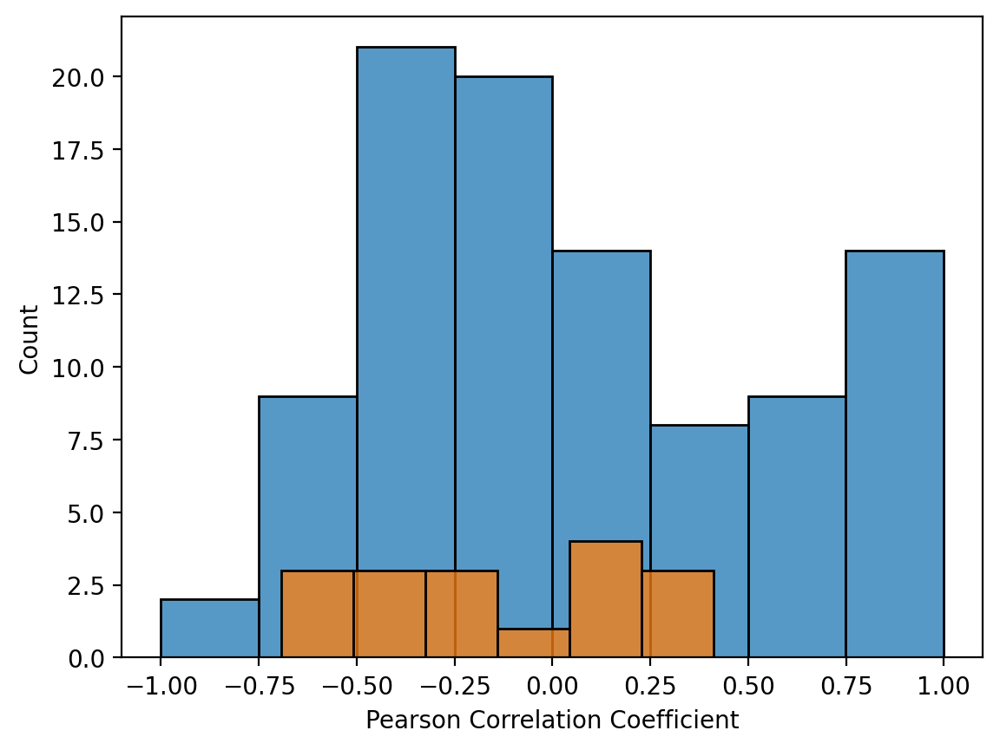

In [58]:
sns.histplot(fourth['Pearson Correlation Coefficient']);
sns.histplot(fourth1['Pearson Correlation Coefficient']);

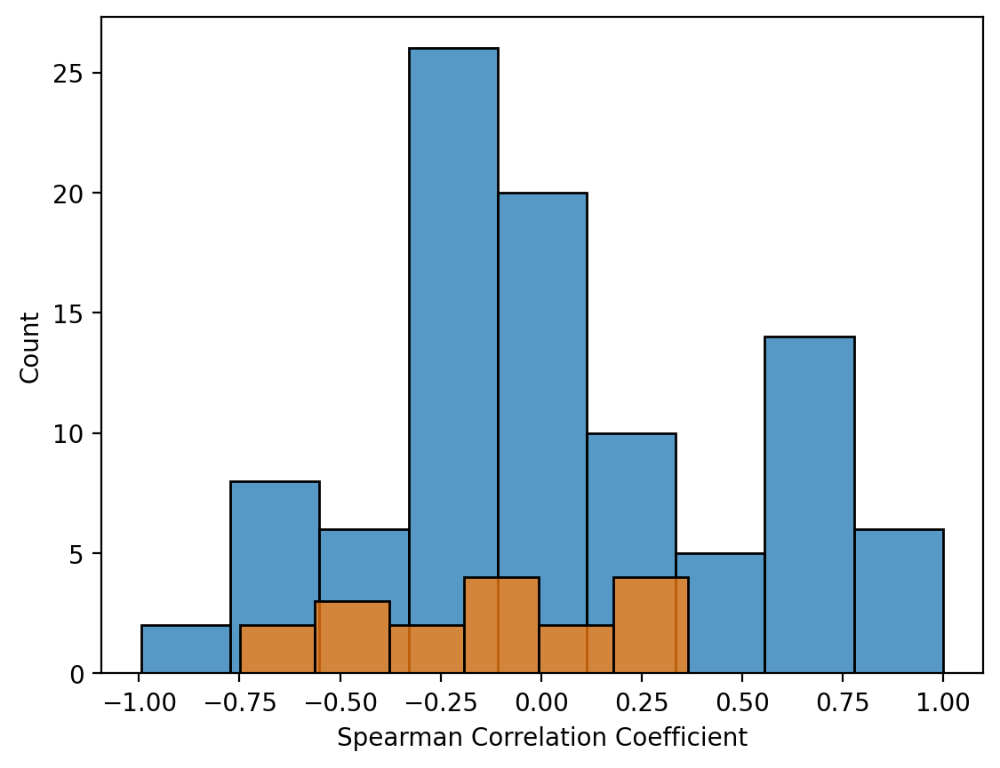

In [59]:
sns.histplot(fourth['Spearman Correlation Coefficient']);
sns.histplot(fourth1['Spearman Correlation Coefficient']);

In [52]:
print(dict(ct['Pearson Correlation Coefficient']))

{'dep': 3, 'dis': 3, 'hin': 2, 'lon': 2, 'sot': 2, 'wsp': 2, 'dat': 1, 'rh': 1, 'som': 1}


In [53]:
print(dict(ct2['Pearson Correlation Coefficient']))

{'sph': 5, 'hin': 3, 'som': 3, 'sot': 3, 'dis': 1, 'lon': 1, 'rh': 1}


#### Statistics | Correlation, Plots, and Pearson R

In [ ]:
# vmax = np.abs(ds.corr()).max().max()
# vmin=-vmax,
# vmax=vmax,

In [ ]:
def corrfunc(x, y, label=None, color=None, cmap=None, **kwargs):
    (r, p) = pearsonr(x, y)
    (s, p2) = spearmanr(x,y)
    ax = plt.gca()
    norm = plt.Normalize(-1, 1)
    #norm=colors.CenteredNorm()
    cmap = cmap if not cmap is None else plt.cm.Spectral
    ax.annotate("pC = {:.2f}".format(r),
                xy=(.495, 1.05), xycoords=ax.transAxes,fontsize=8, ha='center', bbox={'facecolor': cmap(norm(r)), 'alpha': 0.4})#, 'pad': 20})
    ax.annotate("pP = {:.3f}".format(p),
                xy=(.845, 1.05), xycoords=ax.transAxes,fontsize=8, ha='center', bbox={'facecolor': cmap(norm(p)), 'alpha': 0.4})#, 'pad': 20})
    ax.annotate("sC = {:.2f}".format(s),
                xy=(.495, .925), xycoords=ax.transAxes,fontsize=8, ha='center', bbox={'facecolor': cmap(norm(s)), 'alpha': 0.4})#, 'pad': 20}).825, 1.05), 
    ax.annotate("sP = {:.3f}".format(p2),
                xy=(.845, .925), xycoords=ax.transAxes,fontsize=8, ha='center', bbox={'facecolor': cmap(norm(p2)), 'alpha': 0.4})#, 'pad': 20})

#fig, ax = plt.subplots(1,1,figsize=(20,20),dpi=300)
plt.figure(figsize=(30,25));

g = sns.PairGrid(ds, diag_sharey=True, corner=False, palette=["Spectral"])
g.map_upper(sns.regplot, color='#26078D', scatter_kws={'s':10,'alpha':0.3})
#g.map_diag(sns.histplot,kde=True, multiple="layer", element="step",alpha=0.3,palette = plt.cm.Spectral,stat = "probability", discrete = True)
g.map_diag(sns.histplot, kde=True, color='#A6398A', multiple="layer", element="step", kde_kws=dict(cut=3), alpha=0.4, edgecolor=(1, 1, 1, .4)); #palette = "Spectral" or plt.cm.Spectral
#multiple: stack,bars; element: layer,step;)
g.map_lower(sns.kdeplot,cmap='plasma', cbar=True).tick_params(labelsize=8); #shade=True, fill=True
g.add_legend()
g.map_upper(corrfunc);
#plt.setp(g.axes, xticks=[], yticks=[])

#g.fig.suptitle('Correlation and Statistical Pair Grid | VIF-Trimmed Covariates', fontsize=30)
#g.title('Alaska, July 2023',pad=15,fontsize=20);
g.fig.tight_layout();
g.fig.subplots_adjust(top=0.9) # adjust the Figure in rp; #top=0.95
g.fig.suptitle('Correlation and Statistical Pair Grids, Scaled Features and Covariates',fontsize=30, y=0.935)
plt.figtext(0.44, 0.91, 'Four Field Sites | Alaska, July 2023 \n',fontsize=20);#, x=0, y=10, loc='center')
#plt.subplots_adjust(top=0.9)
#g.fig.set_size_inches(25,20)
#plt.savefig("allstatsplotted_ds.pdf", dpi=1000, bbox_inches="tight")
plt.show();

In [ ]:
# matplotlib.rcParams.update(matplotlib.rcParamsDefault)
# %%%matplotlib inline
# %%%matplotlib notebook

In [ ]:
#FEATURES ALL STATS PLOTS

#sns.set(style="white")
import matplotlib.colors as colors
import matplotlib.patheffects as pe
import matplotlib.cm as cm

def corrfunc(x, y, label=None, color=None, cmap=None, **kwargs):
    rls=[]; pls=[]; sls=[]; p2ls=[];
    (r, p) = pearsonr(x, y)
    rls=np.append(rls,r); pls=np.append(pls,p);
    (s, p2) = spearmanr(x,y)
    sls=np.append(sls,s); p2ls=np.append(p2ls,p2);
    ax = plt.gca();
    norm = plt.Normalize(-1, 1);
    #norm=colors.CenteredNorm()
    cmap = cmap if not cmap is None else plt.cm.Spectral
    ax.annotate("pC = {:.3f}".format(r),
                xy=(0.25, 1.15), xycoords=ax.transAxes,fontsize=8, ha='center', color='black', path_effects=[pe.withStroke(linewidth=2, foreground="white")], bbox={'facecolor': cmap(norm(r)), 'alpha': 0.3})#, 'alpha': 0.3})#, 'pad': 20})
    ax.annotate("sC = {:.3f}".format(s),
                xy=(0.25, 1), xycoords=ax.transAxes,fontsize=8, ha='center', color='black', path_effects=[pe.withStroke(linewidth=2, foreground="white")], bbox={'facecolor': cmap(norm(s)), 'alpha': 0.3})#, 'alpha': 0.3})#, 'pad': 20}).825, 1.05), 
    ax.annotate("pP = {:.3f}".format(p),
                xy=(0.625, 1.15), xycoords=ax.transAxes,fontsize=8, ha='center', color='black', path_effects=[pe.withStroke(linewidth=2, foreground="white")], bbox={'facecolor': cmap(norm(p)), 'alpha': 0.3})#, 'alpha': 0.3})#, 'pad': 20})
    ax.annotate("sP = {:.3f}".format(p2),
                xy=(0.625, 1), xycoords=ax.transAxes,fontsize=8, ha='center', color='black', path_effects=[pe.withStroke(linewidth=2, foreground="white")], bbox={'facecolor': cmap(norm(p2)), 'alpha': 0.3})#, 'alpha': 0.3})#, 'pad': 20})
    return rls,pls,sls,p2ls
    
plt.figure(figsize=(30,25));
#fig,ax=plt.subplots(1,1,figsize=(25,20),dpi=1000)

g = sns.PairGrid(features, diag_sharey=True, corner=False, palette=["Spectral"]);
g.map_upper(sns.regplot, color='#26078D', scatter_kws={'s':10,'alpha':0.3});
g.map_diag(sns.histplot, kde=True, color='#A6398A', multiple="layer", element="step", kde_kws=dict(cut=3), alpha=0.4, edgecolor=(1, 1, 1, .4)); #stack,bars; layer,step;)
g.map_lower(sns.kdeplot, cmap='plasma', cbar=True).tick_params(labelsize=8); #shade=True, fill=True
g.add_legend();
g.map_upper(corrfunc);
#plt.setp(g.axes, xticks=[], yticks=[])

g.fig.tight_layout();
g.fig.subplots_adjust(top=0.9) # adjust the Figure in rp;
g.fig.suptitle('Correlation and Statistical Pair Grids, VIF-Trimmed Features and Covariates', y=0.97, fontsize = 30);
plt.figtext(0.4, 0.925, 'Four Field Sites | Alaska, July 2023 \n',fontsize=20);#, x=0, y=10, loc='center')
#g.fig.set_size_inches(25,20)
#plt.savefig("allstatsplotted_features.pdf", dpi=1000, bbox_inches="tight")
plt.show();

In [ ]:
# columns=old.columns.tolist()
# results=dict()

# for i in range(len(columns)):
#     for j in range(i + 1, len(columns)):
#         #ls=np.append(ls,[pearsonr(old[columns[i]], old[columns[j]])])
#         pcoef, p = pearsonr(old[columns[i]], old[columns[j]])
#         scoef, s = spearmanr(old[columns[i]], old[columns[j]])
#         results[f"Pearson | {columns[i]},{columns[j]}"]=pcoef.round(3),p.round(3)
#         results[f"Spearman | {columns[i]},{columns[j]}"]=scoef.round(3),s.round(3)
#         print(f"Pearson Coefficient ({columns[i],columns[j]}): {pcoef, p}")
#         print(f"Spearman Coefficient ({columns[i],columns[j]}): {scoef, s}")

In [1122]:
columns=old.columns.tolist()
resultspb1=dict()
resultsdh1=dict()
resultsdh2=dict()
resultsdh3=dict()

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        pcoefpb1, ppb1 = pearsonr(old[columns[i]][:15], old[columns[j]][:15])
        scoefpb1, spb1 = spearmanr(old[columns[i]][:15], old[columns[j]][:15])
        resultspb1[f"Pearson | {columns[i]},{columns[j]}"]=pcoefpb1.round(3),ppb1.round(3)
        resultspb1[f"Spearman | {columns[i]},{columns[j]}"]=scoefpb1.round(3),spb1.round(3)
        pcoefdh1, pdh1 = pearsonr(old[columns[i]][15:81], old[columns[j]][15:81])
        scoefdh1, sdh1 = spearmanr(old[columns[i]][15:81], old[columns[j]][15:81])
        resultsdh1[f"Pearson | {columns[i]},{columns[j]}"]=pcoefdh1.round(3),pdh1.round(3)
        resultsdh1[f"Spearman | {columns[i]},{columns[j]}"]=scoefdh1.round(3),sdh1.round(3)
        pcoefdh2, pdh2 = pearsonr(old[columns[i]][81:201], old[columns[j]][81:201])
        scoefdh2, sdh2 = spearmanr(old[columns[i]][81:201], old[columns[j]][81:201])
        resultsdh2[f"Pearson | {columns[i]},{columns[j]}"]=pcoefdh2.round(3),pdh2.round(3)
        resultsdh2[f"Spearman | {columns[i]},{columns[j]}"]=scoefdh2.round(3),sdh2.round(3)
        pcoefdh3, pdh3 = pearsonr(old[columns[i]][201:], old[columns[j]][201:])
        scoefdh3, sdh3 = spearmanr(old[columns[i]][201:], old[columns[j]][201:])
        resultsdh3[f"Pearson | {columns[i]},{columns[j]}"]=pcoefdh3.round(3),pdh3.round(3)
        resultsdh3[f"Spearman | {columns[i]},{columns[j]}"]=scoefdh3.round(3),sdh3.round(3)
        #print(f"Pearson Coefficient ({columns[i],columns[j]}): {pcoef, p}")
        #print(f"Spearman Coefficient ({columns[i],columns[j]}): {scoef, s}")

In [1123]:
#with open("old_p_s.csv", "w", newline="") as f:
with open("old_pb1_p_s.csv", "w", newline="") as f1:
    w1 = csv.DictWriter(f1, resultspb1.keys())
    w1.writeheader()
    w1.writerow(resultspb1)
with open("old_dh1_p_s.csv", "w", newline="") as f2:
    w2 = csv.DictWriter(f2, resultsdh1.keys())
    w2.writeheader()
    w2.writerow(resultsdh1)
with open("old_dh2_p_s.csv", "w", newline="") as f3:
    w3 = csv.DictWriter(f3, resultsdh2.keys())
    w3.writeheader()
    w3.writerow(resultsdh2)
with open("old_dh3_p_s.csv", "w", newline="") as f4:
    w4 = csv.DictWriter(f4, resultsdh3.keys())
    w4.writeheader()
    w4.writerow(resultsdh3)

In [1124]:
columns=new.columns.tolist()
resultspb1new=dict()
resultsdh1new=dict()
resultsdh2new=dict()
resultsdh3new=dict()

for i in range(len(columns)):
    for j in range(i + 1, len(columns)):
        pcoefpb1new, ppb1new = pearsonr(new[columns[i]][:15], new[columns[j]][:15])
        scoefpb1new, spb1new = spearmanr(new[columns[i]][:15], new[columns[j]][:15])
        resultspb1new[f"Pearson | {columns[i]},{columns[j]}"]=pcoefpb1new.round(3),ppb1new.round(3)
        resultspb1new[f"Spearman | {columns[i]},{columns[j]}"]=scoefpb1new.round(3),spb1new.round(3)
        pcoefdh1new, pdh1new = pearsonr(new[columns[i]][15:81], new[columns[j]][15:81])
        scoefdh1new, sdh1new = spearmanr(new[columns[i]][15:81], new[columns[j]][15:81])
        resultsdh1new[f"Pearson | {columns[i]},{columns[j]}"]=pcoefdh1new.round(3),pdh1new.round(3)
        resultsdh1new[f"Spearman | {columns[i]},{columns[j]}"]=scoefdh1new.round(3),sdh1new.round(3)
        pcoefdh2new, pdh2new = pearsonr(new[columns[i]][81:201], new[columns[j]][81:201])
        scoefdh2new, sdh2new = spearmanr(new[columns[i]][81:201], new[columns[j]][81:201])
        resultsdh2new[f"Pearson | {columns[i]},{columns[j]}"]=pcoefdh2new.round(3),pdh2new.round(3)
        resultsdh2new[f"Spearman | {columns[i]},{columns[j]}"]=scoefdh2new.round(3),sdh2new.round(3)
        pcoefdh3new, pdh3new = pearsonr(new[columns[i]][201:], new[columns[j]][201:])
        scoefdh3new, sdh3new = spearmanr(new[columns[i]][201:], new[columns[j]][201:])
        resultsdh3new[f"Pearson | {columns[i]},{columns[j]}"]=pcoefdh3new.round(3),pdh3new.round(3)
        resultsdh3new[f"Spearman | {columns[i]},{columns[j]}"]=scoefdh3new.round(3),sdh3new.round(3)
        #print(f"Pearson Coefficient ({columns[i],columns[j]}): {pcoef, p}")
        #print(f"Spearman Coefficient ({columns[i],columns[j]}): {scoef, s}")

In [1125]:
#with open("new_p_s.csv", "w", newline="") as f:
with open("new_pb1_p_s.csv", "w", newline="") as f1new:
    w1new = csv.DictWriter(f1new, resultspb1new.keys())
    w1new.writeheader()
    w1new.writerow(resultspb1new)
with open("new_dh1_p_s.csv", "w", newline="") as f2new:
    w2new = csv.DictWriter(f2new, resultsdh1new.keys())
    w2new.writeheader()
    w2new.writerow(resultsdh1new)
with open("new_dh2_p_s.csv", "w", newline="") as f3new:
    w3new = csv.DictWriter(f3new, resultsdh2new.keys())
    w3new.writeheader()
    w3new.writerow(resultsdh2new)
with open("new_dh3_p_s.csv", "w", newline="") as f4new:
    w4new = csv.DictWriter(f4new, resultsdh3new.keys())
    w4new.writeheader()
    w4new.writerow(resultsdh3new)

In [1126]:
arrpb1=np.array(list(resultspb1.items()), dtype=object)
arrpb1new=np.array(list(resultspb1new.items()), dtype=object)

In [ ]:
sns.distplot(arrpb1[:,1].mean());
sns.distplot(arrpb1new[:,1].mean()); #VIF-Trimmed

In [1127]:
arrdh1=np.array(list(resultsdh1.items()), dtype=object)
arrdh1new=np.array(list(resultsdh1new.items()), dtype=object)

In [ ]:
sns.distplot(arrdh1[:,1].mean());
sns.distplot(arrdh1new[:,1].mean()); #VIF-Trimmed

In [1128]:
arrdh2=np.array(list(resultsdh2.items()), dtype=object)
arrdh2new=np.array(list(resultsdh2new.items()), dtype=object)

In [ ]:
sns.distplot(arrdh2[:,1].mean());
sns.distplot(arrdh2new[:,1].mean()); #VIF-Trimmed

In [1129]:
arrdh3=np.array(list(resultsdh3.items()), dtype=object)
arrdh3new=np.array(list(resultsdh3new.items()), dtype=object)

In [ ]:
sns.distplot(arrdh3[:,1].mean());
sns.distplot(arrdh3new[:,1].mean()); #VIF-Trimmed

In [ ]:
arrpb1ls=[]
for i in arrpb1[:,1]:
    arrpb1ls=np.append(arrpb1ls,(i[0]))
plt.plot(arrpb1ls);

In [ ]:
plt.subplots(1,1,figsize=(12,8))
plt.plot(arrpb1[:,1].mean(),label='PB1, Baseline')
plt.plot(arrdh1[:,1].mean(),linestyle='dotted',label='DH1, Baseline');
plt.plot(arrdh2[:,1].mean(),linestyle='dotted',label='DH2, Baseline');
plt.plot(arrdh3[:,1].mean(),linestyle='dotted',label='DH3, Baseline');
plt.legend();

In [ ]:
plt.subplots(1,1,figsize=(12,8))
plt.plot(arrpb1new[:,1].mean(),label='PB1, VIF-Trimmed')
plt.plot(arrdh1new[:,1].mean(),linestyle='dotted',label='DH1, VIF-Trimmed');
plt.plot(arrdh2new[:,1].mean(),linestyle='dotted',label='DH2, VIF-Trimmed');
plt.plot(arrdh3new[:,1].mean(),linestyle='dotted',label='DH3, VIF-Trimmed');
plt.legend();

In [ ]:
arrpb1[14]

In [ ]:
np.where(np.array(list(arrpb1[:,1].tolist())).flatten()>0.05)

In [ ]:
dfpb1=pd.DataFrame(pd.concat([pd.DataFrame(arrpb1).set_index(0),pd.DataFrame(arrpb1new).set_index(0)],axis=1))
dfpb1

In [ ]:
print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
print([pearsonr(features['dist'], features['st'])])
print([spearmanr(features['dist'], features['st'])])
print('')
print('--------Distance from Pad (m) v. Soil pH--------')
print([pearsonr(features['dist'], features['ph'])])
print([spearmanr(features['dist'], features['ph'])])
print('')
print('--------Depth (cm) v. Soil Temperature (C)--------')
print([pearsonr(features['depth'], features['st'])])
print([spearmanr(features['depth'], features['st'])])
print('')
print('--------Depth (cm) v. Soil Moisture (%)--------')
print([pearsonr(features['depth'], features['sm'])])
print([spearmanr(features['depth'], features['sm'])])
print('')
print('--------Soil Moisture (%) v. Soil pH--------')
print([pearsonr(features['sm'], features['ph'])])
print([spearmanr(features['sm'], features['ph'])])

In [ ]:
print('--------Distance from Pad (m) v. Soil Temperature (C)--------')
print([pearsonr(features.iloc[0:5]['dist'], features.iloc[0:5]['st']),
       pearsonr(features.iloc[5:16]['dist'], features.iloc[5:16]['st']),
       pearsonr(features.iloc[16:31]['dist'], features.iloc[16:31]['st']),
       pearsonr(features.iloc[31:]['dist'], features.iloc[31:]['st'])])
print([spearmanr(features.iloc[0:5]['dist'], features.iloc[0:5]['st']),
       spearmanr(features.iloc[5:16]['dist'], features.iloc[5:16]['st']),
       spearmanr(features.iloc[16:31]['dist'], features.iloc[16:31]['st']),
       spearmanr(features.iloc[31:]['dist'], features.iloc[31:]['st'])])
print('')
print('--------Depth (cm) v. Soil Temperature (C)--------')
print([pearsonr(features.iloc[0:5]['depth'], features.iloc[0:5]['st']),
       pearsonr(features.iloc[5:16]['depth'], features.iloc[5:16]['st']),
       pearsonr(features.iloc[16:31]['depth'], features.iloc[16:31]['st']),
       pearsonr(features.iloc[31:]['depth'], features.iloc[31:]['st'])])
print([spearmanr(features.iloc[0:5]['depth'], features.iloc[0:5]['st']),
       spearmanr(features.iloc[5:16]['depth'], features.iloc[5:16]['st']),
       spearmanr(features.iloc[16:31]['depth'], features.iloc[16:31]['st']),
       spearmanr(features.iloc[31:]['depth'], features.iloc[31:]['st'])])
print('')
print('--------Depth (cm) v. Soil Moisture (%)--------')
print([pearsonr(features.iloc[0:5]['depth'], features.iloc[0:5]['sm']),
       pearsonr(features.iloc[5:16]['depth'], features.iloc[5:16]['sm']),
       pearsonr(features.iloc[16:31]['depth'], features.iloc[16:31]['sm']),
       pearsonr(features.iloc[31:]['depth'], features.iloc[31:]['sm'])])
print([spearmanr(features.iloc[0:5]['depth'], features.iloc[0:5]['sm']),
       spearmanr(features.iloc[5:16]['depth'], features.iloc[5:16]['sm']),
       spearmanr(features.iloc[16:31]['depth'], features.iloc[16:31]['sm']),
       spearmanr(features.iloc[31:]['depth'], features.iloc[31:]['sm'])])
print('')
print('--------Soil Temperature (C) v. Soil pH--------')
print([pearsonr(features.iloc[0:5]['st'], features.iloc[0:5]['ph']),
       pearsonr(features.iloc[5:16]['st'], features.iloc[5:16]['ph']),
       pearsonr(features.iloc[16:31]['st'], features.iloc[16:31]['ph']),
       pearsonr(features.iloc[31:]['st'], features.iloc[31:]['ph'])])
print([spearmanr(features.iloc[0:5]['st'], features.iloc[0:5]['ph']),
       spearmanr(features.iloc[5:16]['st'], features.iloc[5:16]['ph']),
       spearmanr(features.iloc[16:31]['st'], features.iloc[16:31]['ph']),
       spearmanr(features.iloc[31:]['st'], features.iloc[31:]['ph'])])
print('')
print('--------Soil Moisture (%) v. Soil pH--------')
print([pearsonr(features.iloc[0:5]['sm'], features.iloc[0:5]['ph']),
       pearsonr(features.iloc[5:16]['sm'], features.iloc[5:16]['ph']),
       pearsonr(features.iloc[16:31]['sm'], features.iloc[16:31]['ph']),
       pearsonr(features.iloc[31:]['sm'], features.iloc[31:]['ph'])])
print([spearmanr(features.iloc[0:5]['sm'], features.iloc[0:5]['ph']),
       spearmanr(features.iloc[5:16]['sm'], features.iloc[5:16]['ph']),
       spearmanr(features.iloc[16:31]['sm'], features.iloc[16:31]['ph']),
       spearmanr(features.iloc[31:]['sm'], features.iloc[31:]['ph'])])

In [ ]:
# DI ST (-0.493)
# DI PH (-0.396)
# D SM (-0.551)
# D ST (-0.682)
# SM PH (-0.671)

#### Statistics | Pearson R

In [ ]:
print(np.array([np.corrcoef(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[0, 1],
                np.corrcoef(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil Moisture (%)'])[0, 1],
                np.corrcoef(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil Moisture (%)'])[0, 1],
                np.corrcoef(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil Moisture (%)'])[0, 1]]));

In [ ]:
print(np.array([np.corrcoef(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[0, 1],
                np.corrcoef(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil Moisture (%)'])[0, 1],
                np.corrcoef(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil Moisture (%)'])[0, 1],
                np.corrcoef(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil Moisture (%)'])[0, 1]]));

In [ ]:
#pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1]

print(np.array([pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Depth (cm)'])[1],
                pearsonr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Depth (cm)'])[1],
                pearsonr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Depth (cm)'])[1],
                pearsonr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Depth (cm)'])[1]]))#.mean()); #0.3033469783308587
print(np.array([spearmanr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Depth (cm)'])[1],
                spearmanr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Depth (cm)'])[1],
                spearmanr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Depth (cm)'])[1],
                spearmanr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Depth (cm)'])[1]]));#.mean()); #0.2556513561257626

In [ ]:
#pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1]

print(np.array([pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Temperature (C)'])[1],
                pearsonr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil Temperature (C)'])[1],
                pearsonr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil Temperature (C)'])[1],
                pearsonr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil Temperature (C)'])[1]]))#.mean()); #0.3033469783308587
print(np.array([spearmanr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Temperature (C)'])[1],
                spearmanr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil Temperature (C)'])[1],
                spearmanr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil Temperature (C)'])[1],
                spearmanr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil Temperature (C)'])[1]]));#.mean()); #0.2556513561257626

In [ ]:
#pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1]

print(np.array([pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1],
                pearsonr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil Moisture (%)'])[1],
                pearsonr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil Moisture (%)'])[1],
                pearsonr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil Moisture (%)'])[1]]))#.mean()); #0.4710042762188448
print(np.array([spearmanr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1],
                spearmanr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil Moisture (%)'])[1],
                spearmanr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil Moisture (%)'])[1],
                spearmanr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil Moisture (%)'])[1]]))#.mean()); #0.5386372987077743

In [ ]:
#pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1]

print(np.array([pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil pH'])[1],
                pearsonr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil pH'])[1],
                pearsonr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil pH'])[1],
                pearsonr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil pH'])[1]]))#.mean()); #0.42470784951405804
print(np.array([spearmanr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil pH'])[1],
                spearmanr(features.iloc[5:16]['Distance from Pad (m)'], features.iloc[5:16]['Soil pH'])[1],
                spearmanr(features.iloc[16:31]['Distance from Pad (m)'], features.iloc[16:31]['Soil pH'])[1],
                spearmanr(features.iloc[31:]['Distance from Pad (m)'], features.iloc[31:]['Soil pH'])[1]]))#.mean()); #0.5001613710122345

In [ ]:
#pearsonr(features.iloc[0:5]['Distance from Pad (m)'], features.iloc[0:5]['Soil Moisture (%)'])[1]

print(np.array([pearsonr(features.iloc[0:5]['Depth (cm)'], features.iloc[0:5]['Soil Temperature (C)'])[1],
                pearsonr(features.iloc[5:16]['Depth (cm)'], features.iloc[5:16]['Soil Temperature (C)'])[1],
                pearsonr(features.iloc[16:31]['Depth (cm)'], features.iloc[16:31]['Soil Temperature (C)'])[1],
                pearsonr(features.iloc[31:]['Depth (cm)'], features.iloc[31:]['Soil Temperature (C)'])[1]]))#.mean()); #0.42470784951405804
print(np.array([spearmanr(features.iloc[0:5]['Depth (cm)'], features.iloc[0:5]['Soil Temperature (C)'])[1],
                spearmanr(features.iloc[5:16]['Depth (cm)'], features.iloc[5:16]['Soil Temperature (C)'])[1],
                spearmanr(features.iloc[16:31]['Depth (cm)'], features.iloc[16:31]['Soil Temperature (C)'])[1],
                spearmanr(features.iloc[31:]['Depth (cm)'], features.iloc[31:]['Soil Temperature (C)'])[1]]))#.mean()); #0.5001613710122345

In [ ]:
ds=features.reset_index().to_xarray()

In [ ]:
#plt.scatter(scipy.interpolate.interp1d(ds['Distance from Pad (m)'],ds['Soil Temperature (C)']).x,scipy.interpolate.interp1d(ds['Distance from Pad (m)'],ds['Soil Temperature (C)']).y);

In [ ]:
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==0)],ds['Soil Temperature (C)'][np.where(ds.Site==0)],label='PB1');
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==1)],ds['Soil Temperature (C)'][np.where(ds.Site==1)],label='DH1');
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==2)],ds['Soil Temperature (C)'][np.where(ds.Site==2)],label='DH2');
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==3)],ds['Soil Temperature (C)'][np.where(ds.Site==3)],label='DH3');
plt.legend();

In [ ]:
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==0)],ds['Soil Temperature (C)'][np.where(ds.Site==0)],label='PB1');
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==1)],ds['Soil Temperature (C)'][np.where(ds.Site==1)],label='DH1');
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==2)],ds['Soil Temperature (C)'][np.where(ds.Site==2)],label='DH2');
plt.scatter(ds['Distance from Pad (m)'][np.where(ds.Site==3)],ds['Soil Temperature (C)'][np.where(ds.Site==3)],label='DH3');
plt.legend();

In [ ]:
corrDF = features.iloc[:, :]
plt.figure(figsize = (8, 6))
#legend=sns.color_palette("hls", 94)

#sns.heatmap(df.replace(np.nan, -9999).corr(), cmap='icefire', linewidths=0.45, linecolor='black', annot=False);

sns.heatmap(features.replace(np.nan, -9999).corr(), cmap='icefire', linewidths=0.45, linecolor='black', annot=False);
#plt.savefig('df91f_hm.png', dpi=1000)#, bbox_inches='tight')

In [ ]:
features.columns

In [ ]:
dis=features.iloc[:,0].values;
dep=features.iloc[:,1].values;
st=features.iloc[:,2].values;
sm=features.iloc[:,3].values;
ph=features.iloc[:,4].values;

In [ ]:
features['Distance from Pad (m)'][0].values

In [ ]:
#correlation coefficient
cc=np.corrcoef(dis, dep)[0, 1]
#pearson
p_value = pearsonr(dis, dep)[1]

print('Correlation coefficient:', cc)
print('P-value:', p_value)

In [ ]:
plt.scatter(dis,st);

In [ ]:
plt.scatter(dis,ph);

In [ ]:
plt.scatter(dep,st);

In [ ]:
plt.scatter(dep,sm);

In [ ]:
plt.scatter(sm,ph);

In [ ]:
#df[:]['Soil pH'].values

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111)
#lns1=ax.scatter(dis,ph,label='Distance from Pad v. Soil pH, p=1.136E-02',color='blue');
lns1=ax.scatter(dis,ph,label='Distance from Pad v. Soil pH, p=0.01136525',color='blue');
ax2=ax.twinx()
#lns2=ax2.scatter(sm,ph,label='Soil Moisture Content v. Soil pH, p=2.193E-06',color='orange');
lns2=ax2.scatter(sm,ph,label='Soil Moisture Content v. Soil pH, p=0.00000219',color='orange');
lns = [lns1,lns2]
labs = [l.get_label() for l in lns]
ax.legend(lns, labs, loc=0);

In [ ]:
#ls=[df.columns.values.tolist()[i] for i in range(len(df.columns.values))]
ls=[.columns.values.tolist()[i] for i in range(len(features.columns.values))]

In [ ]:
#ls2=[df[:][ls[i]] for i in range(len(ls))]
ls2=[features[:][ls[i]] for i in range(len(ls))]

In [ ]:
#df.columns.tolist()
features.columns.tolist()

In [ ]:
# Fit a linear regression model
model = OLS(df[:]['Soil pH'], df[:][['Site','Longitude','Latitude','Distance from Pad (m)','Depth (cm)','Soil Temperature (C)','Soil Moisture (%)']])
#model = OLS(df[:]['Soil pH'], df[:][['Site','Longitude','Latitude','Distance from Pad (m)','Depth (cm)','Soil Temperature (C)','Soil Moisture (%)']])
#model = OLS(features[:]['Depth (cm)'], features[:][['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])
results = model.fit()

In [ ]:
print(results.summary())

In [ ]:
features.reset_index().drop(columns=['index']).set_index('Longitude')

In [ ]:
xr.DataArray(features, dims=['lat', 'lon'])

In [ ]:
#plt.plot(features.interpolate('linear',limit_direction='forward')['Soil Temperature (C)'])
plt.plot(features['Soil Temperature (C)'].interpolate('linear'));
plt.scatter(features['Distance from Pad (m)'],features['Soil Temperature (C)']);

In [ ]:
#(((features.to_xarray().Longitude + 180) % 360) - 180).plot();#.set_coords({"Longitude": (((features.to_xarray().Longitude + 180) % 360) - 180)}).expand_dims({'NewDim':features['Soil Temperature (C)']})#['Soil Temperature (C)'].assign_attrs(units="Celsius", description="Soil Temperature (ºC)")
features.to_xarray()['Distance from Pad (m)'].plot();
plt.twinx()
features.to_xarray()['Soil Temperature (C)'].plot(color='orange');
plt.axvline(x=5, linestyle='dashed')
plt.axvline(x=16, linestyle='dashed')
plt.axvline(x=31, linestyle='dashed')

In [ ]:
.assign_coords({"lon": (((da.lon + 180) % 360) - 180)})

In [ ]:
#het_breuschpagan(results.resid, test_model(df[:]['Soil pH']))

In [ ]:
#results.resid, results.model.exog

In [ ]:
#test_model(df[:]['Soil pH'])

In [ ]:
# Conduct the Breusch-Pagan test
bp_test = het_breuschpagan(results.resid, results.model.exog)
# Print the results
print(bp_test)

In [ ]:

# Conduct the Breusch-Pagan test
bp_test = het_breuschpagan(results.resid, results.model.exog)

# Print the results
print(bp_test)

In [ ]:
pd.options.display.latex.repr = True
df

In [ ]:
dfi.export(df,'/Users/bgay/Downloads/pads_data_df.png',dpi=1000)

In [ ]:
df_styled=df.style.background_gradient()
dfi.export(df_styled, '/Users/bgay/Downloads/pads_data_df_styled.png',dpi=1000)

In [ ]:
corr = df.corr()

In [ ]:
ds.corr().style.background_gradient(cmap='coolwarm')

In [ ]:
features.corr().style.background_gradient(cmap='coolwarm')

In [ ]:
#corr.style.background_gradient(cmap='coolwarm').set_precision(2)

In [ ]:
ds.corr().style.background_gradient(cmap='coolwarm', axis=None)

In [ ]:
features.corr().style.background_gradient(cmap='coolwarm', axis=None)

In [ ]:
# corr = without_outliers.corr()
# fig=sns.heatmap(corr, 
#             xticklabels=corr.columns.values,
#             yticklabels=corr.columns.values,
#             annot=True,
#             linewidth=.25,
#             fmt=".3f")
# fig.tick_params(left=False, bottom=False)
# #fig.figure.savefig('/Users/bgay/Downloads/pads_data_hm.png',dpi=1000,bbox_inches='tight')

In [ ]:
# fig=sns.pairplot(features,kind="kde", corner=True)
# #fig.figure.savefig('/Users/bgay/Downloads/pads_data_pp_all.png',dpi=1000)

In [ ]:
# fig=sns.pairplot(features,
#                  y_vars=["dist","st", "sm", "ph"],
#                  x_vars=["dist","st","sm","ph"])#,kind="kde", corner=True)
# fig;

In [ ]:
# fig=sns.pairplot(features,corner=True)#kind="kde", corner=True)

In [ ]:
# fig = sns.pairplot(features, diag_kind="kde")
# fig.map_lower(sns.kdeplot, levels=9, color=".55")

In [ ]:
# fig = sns.pairplot(features, diag_kind="kde", corner=True)
# fig.map_lower(sns.kdeplot, levels=9, color=".55")

In [ ]:
#np.array([df.lon.values.tolist(),df.lat.values.tolist()])
#np.sort(xy) #-148.42865889-(-148.777188)#0.348529109999987; 70.190318-69.919552#0.27076600000000894
xy=np.array([[df.lon[i],df.lat[i]] for i in range(0,40)])

In [ ]:
from math import * #radians, cos, sin, asin, sqrt

def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance in kilometers between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles. Determines return value units.
    return c * r

In [ ]:
haversine(-148.777188,69.919552,-148.42865889,70.190318)

In [ ]:
#-148.42865889-(-148.777188)
#70.190318-69.919552
#32.88219782989477km

In [ ]:
#0.348529109999987*0.27076600000000894
#(np.sqrt(pow(70.190318-69.919552, 2) + np.cos(69.919552)*pow(-148.42865889-(-148.777188), 2)))*82.842
#0.3969266774447974deg

In [ ]:
lons=np.linspace(-148.777188, -148.42865889, 40)
lats=np.linspace(69.919552, 70.190318, 40)

In [ ]:
# y_i=np.array(40*(lats.tolist())).reshape(40,40)
# [y_i[i][0] for i in range(40)]
#[sublist[0] for sublist in np.array(40*(lats.tolist())).reshape(40,40)]

In [ ]:
x_i=np.array(40*lons.tolist()).reshape(40,40)
y_i=np.sort(lats.tolist()*40).reshape(40,40)

In [ ]:
#x_i

In [ ]:
#y_i

In [ ]:
x_i=x_i.reshape(-1, 1)

In [ ]:
y_i = y_i.reshape(-1, 1)

In [ ]:
xy_i = np.concatenate([x_i, y_i], axis=1)

#### Study-Level v. Site-Level

In [ ]:
#FOR STUDY-LEVEL GROUPS

#fig=plt.figure(figsize=(8,6))
#ax=fig.add_subplot(111)
fig,ax=plt.subplots(1,1,figsize=(8,6),dpi=300)
lns1=sns.violinplot(ds['dep'],label='Grouped, Soil Depth (cm)',color='dodgerblue',alpha=0.4,legend='full',ax=ax)
ax2=ax.twinx()
#lns2=sns.violinplot(df['st'],label='Grouped, Soil Temperature (ºC)',color='magenta',alpha=0.4,legend='full',ax=ax2);
lns2=sns.violinplot(ds['som'],label='Grouped, Soil Moisture (%)',color='magenta',alpha=0.4,legend='full',ax=ax2);
#lns = [lns1,lns2]
#labs = [l.get_label() for l in lns]
#ax.legend(lns, labs, loc='best');
#plt.legend(lns, labs, loc='best');
#plt.suptitle('Study-Level Correlation and Covariability of Soil Depth v. Soil Temperature',fontsize=12)
plt.suptitle('Study-Level Correlation and Covariability of Soil Depth v. Soil Moisture',fontsize=12)
#plt.title('Grouped Field Sites | Alaska, July 2023 (p=1.25919353E-06)',fontsize=10, pad=14)
plt.title('Grouped Field Sites | Alaska, July 2023 (p=2.27159129E-04)',fontsize=10, pad=14)

plt.xlabel('Soil Depth (cm)',fontsize=10, labelpad=8)
#plt.ylabel('Soil Temperature (ºC)',fontsize=10, labelpad=8)
plt.ylabel('Soil Moisture (%)',fontsize=10, labelpad=8)

ax.grid(linewidth=0.35)
ax2.tick_params(right = False) 
ax.tick_params(left = False)
ax2.get_legend().remove()
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2, loc='lower left')
plt.show()

In [ ]:
# FOR SITE-LEVEL 

#REDO WITH P VALUES NOT CC'S!

plt.subplots(1,1,figsize=(8,6),dpi=300)
#without_outliers['dist'][:5].plot(label='PB1');
#without_outliers['st'][:5].plot(label='PB1');
#without_outliers['sm'][:5].plot(label='PB1');
#without_outliers['ph'][:5].plot(label='PB1');

#plt.scatter(x=without_outliers['dist'][:5],y=without_outliers['st'][:5],label='PB1')
#plt.scatter(x=without_outliers['st'][:5],y=without_outliers['ph'][:5],label='PB1')
#plt.scatter(x=without_outliers['sm'][:5],y=without_outliers['ph'][:5],label='PB1')
#plt.scatter(x=without_outliers['sm'][5:16],y=without_outliers['ph'][5:16],label='DH1')
#plt.scatter(x=without_outliers['sm'][16:31],y=without_outliers['ph'][16:31],label='DH2')
#plt.scatter(x=without_outliers['sm'][31:],y=without_outliers['ph'][31:],label='DH3')

#plt.axvline(x=5, linestyle='dashed',color='k')
#plt.axvline(x=16, linestyle='dashed',color='k')
#plt.axvline(x=31, linestyle='dashed',color='k');

#plt.suptitle('Site-Level Variability of Pad Distance',fontsize=14)
#plt.suptitle('Site-Level Variability of Soil Temperature',fontsize=14)
#plt.suptitle('Site-Level Variability of Soil Moisture',fontsize=14)
#plt.suptitle('Site-Level Variability of Distance Soil pH',fontsize=14)
#plt.suptitle('Site-Level Correlation and Covariability of Pad Distance v. Soil Temperature',fontsize=12)
#plt.suptitle('Site-Level Correlation and Covariability of Soil Temperature v. Soil pH',fontsize=12)
#plt.suptitle('Site-Level Correlation and Covariability of Soil Moisture v. Soil pH',fontsize=12)

#plt.title('Four Field Sites | Alaska, July 2023 (p=-0.612 to -0.586)',fontsize=10, pad=14)
#plt.title('Four Field Sites | Alaska, July 2023 (p=0.814 [PB1])',fontsize=10, pad=14)
#plt.title('Four Field Sites | Alaska, July 2023 (p=-0.898 to -0.608)',fontsize=10, pad=14)

#=====

#plt.scatter(x=df['dist'],y=df['st'],label='Grouped, Distance from Pad v. Soil Temperature')
#plt.scatter(x=df['dist'],y=df['ph'],label='Grouped, Distance from Pad v. Soil pH')
plt.scatter(x=df['sm'],y=df['ph'],label='Grouped, Soil Moisture v. Soil pH')

#plt.suptitle('Study-Level Correlation and Covariability of Pad Distance v. Soil Temperature',fontsize=12)
#plt.suptitle('Study-Level Correlation and Covariability of Pad Distance v. Soil pH',fontsize=12)
plt.suptitle('Study-Level Correlation and Covariability of Soil Moisture v. Soil pH',fontsize=12)

#plt.title('Grouped Field Sites | Alaska, July 2023 (p=1.22997111E-03)',fontsize=10, pad=14)
#plt.title('Grouped Field Sites | Alaska, July 2023 (p=1.13652532E-02)',fontsize=10, pad=14)
plt.title('Grouped Field Sites | Alaska, July 2023 (p=2.19298287E-06)',fontsize=10, pad=14)

#=====

#plt.xlabel('Sequential Measurement Windows, Four Field Sites',fontsize=10, labelpad=8)
#plt.xlabel('Distance from Pad (m)',fontsize=10, labelpad=8)
#plt.xlabel('Soil Temperature (ºC)',fontsize=10, labelpad=8)
plt.xlabel('Soil Moisture (%)',fontsize=10, labelpad=8)
#plt.xlabel('Soil Depth (cm)',fontsize=10, labelpad=8)

#plt.ylabel('Distance from Pad (m)',fontsize=10, labelpad=8)
plt.ylabel('Soil pH',fontsize=10, labelpad=8)
#plt.ylabel('Soil Moisture (%)',fontsize=10, labelpad=8)
#plt.ylabel('Soil Temperature (ºC)',fontsize=10, labelpad=8)

#plt.xlim(0,39)
#plt.ylim(0,65)
#plt.ylim(5,25)
#plt.ylim(0,85)
#plt.ylim(4,9)

plt.grid(linewidth=0.5)
plt.tick_params(bottom = False) 
plt.tick_params(left = False)

#plt.tight_layout()
#plt.legend();

In [ ]:
features.columns

In [ ]:
arr=np.array([features.dis.values,features.dep.values,features.sot.values,features.som.values,features.sph.values])
plt.plot(arr[0][:5],arr[2][:5])
plt.plot(arr[0][5:16],arr[2][5:16])
plt.plot(arr[0][16:31],arr[2][16:31])
plt.plot(arr[0][31:],arr[2][31:]);
plt.twinx()
plt.plot(arr[0][:5],arr[3][:5],linestyle='dotted')
plt.plot(arr[0][5:16],arr[3][5:16],linestyle='dotted')
plt.plot(arr[0][16:31],arr[3][16:31],linestyle='dotted')
plt.plot(arr[0][31:],arr[3][31:],linestyle='dotted');

In [ ]:
arr=np.array([features.dist.values,features.depth.values,features.st.values,features.sm.values,features.ph.values])
plt.plot(arr[0][:5],arr[2][:5])
plt.plot(arr[0][5:16],arr[2][5:16])
plt.plot(arr[0][16:31],arr[2][16:31])
plt.plot(arr[0][31:],arr[2][31:]);
# plt.plot(arr[0][:5],arr[3][:5]);
# plt.plot(arr[0][5:16],arr[3][5:16]);
# plt.plot(arr[0][16:31],arr[3][16:31]);
# plt.plot(arr[0][31:],arr[3][31:]);
plt.twinx()
plt.plot(arr[0][:5],arr[4][:5],linestyle='dotted');
plt.plot(arr[0][5:16],arr[4][5:16],linestyle='dotted');
plt.plot(arr[0][16:31],arr[4][16:31],linestyle='dotted');
plt.plot(arr[0][31:],arr[4][31:],linestyle='dotted');

#### Interpolation

In [ ]:
from scipy.interpolate import griddata
import matplotlib.tri as tri
npts = 300
ngridx = 200
ngridy = 150
x = np.random.uniform(lons.min(), lons.max(), npts)
y = np.random.uniform(lats.min(), lats.max(), npts)
z = x * np.exp(-x**2 - y**2)

In [ ]:
xi = np.linspace(lons.min()-0.1, lons.max()+0.1, ngridx)
yi = np.linspace(lats.min()-0.1, lats.max()+0.1, ngridy)

In [ ]:
triang = tri.Triangulation(x, y)
interpolator = tri.LinearTriInterpolator(triang, z)
Xi, Yi = np.meshgrid(xi, yi)
zi = interpolator(Xi, Yi)

In [ ]:
fig, (ax1, ax2) = plt.subplots(nrows=2)

ax1.contour(xi, yi, zi, levels=14, linewidths=0.5, colors='k')
cntr1 = ax1.contourf(xi, yi, zi, levels=14, cmap="RdBu_r")

fig.colorbar(cntr1, ax=ax1)
ax1.plot(x, y, 'ko', ms=3)
ax1.set(xlim=(lons.min(),lons.max()), ylim=(lats.min(), lats.max()))
ax1.set_title('grid and contour (%d points, %d grid points)' %
              (npts, ngridx * ngridy))

ax2.tricontour(x, y, z, levels=14, linewidths=0.5, colors='k')
cntr2 = ax2.tricontourf(x, y, z, levels=14, cmap="RdBu_r")

fig.colorbar(cntr2, ax=ax2)
ax2.plot(x, y, 'ko', ms=3)
ax2.set(xlim=(lons.min(),lons.max()), ylim=(lats.min(), lats.max()))
ax2.set_title('tricontour (%d points)' % npts)
plt.subplots_adjust(hspace=0.5)
plt.show()

##### Interpolation and Plotting Playground

In [ ]:
import numpy as np
from scipy.interpolate import RBFInterpolator
import matplotlib.pyplot as plt

In [ ]:
# use RBF
rbf = RBFInterpolator(xy, ph, epsilon=2)
z_i = rbf(xy_i)

In [ ]:
import numpy as np
from scipy.stats import gaussian_kde
from matplotlib import pyplot as pp

In [ ]:
#ST DEPTH -0.691120
#SM DEPTH -0.618794
#SM PH -0.681647

In [ ]:
from sklearn.neighbors import KernelDensity
kde = KernelDensity(kernel='gaussian', bandwidth=2).fit(sm.reshape(-1,1))
s = ph
e = kde.score_samples(s.reshape(-1,1))
plt.xlim(-1,40)
plt.grid(linewidth=0.4)
plt.plot(e);

In [ ]:
from scipy.signal import argrelextrema
mi, ma = argrelextrema(e, np.less)[0], argrelextrema(e, np.greater)[0]
mi,ma

In [ ]:
print("Minima:", s[mi])
print("Maxima:", s[ma])
#> Minima: [ 17.34693878  33.67346939]
#> Maxima: [ 10.20408163  21.42857143  44.89795918]

In [ ]:
print(sm.reshape(-1,1)[sm.reshape(-1,1) < mi[0]], sm.reshape(-1,1)[(sm.reshape(-1,1) >= mi[0]) * (sm.reshape(-1,1) <= mi[1])], sm.reshape(-1,1)[sm.reshape(-1,1) >= mi[1]])

In [ ]:
plt.plot(s[:mi[0]+1], e[:mi[0]+1], 'r',
     s[mi[0]:mi[1]+1], e[mi[0]:mi[1]+1], 'g',
     s[mi[1]:], e[mi[1]:], 'b',
     s[ma], e[ma], 'go',
     s[mi], e[mi], 'ro');

In [ ]:
# import plotly.graph_objects as go
# import numpy as np

# X=x_i.reshape(40,40)
# Y=y_i.reshape(40,40)
# a = 3
# b = 2
# Z = a*X**2 + b*Y**2

# fig = go.Figure(
#     data=[go.Surface(z=Z, x=lons, y=lats, colorscale="Reds", opacity=0.5)])
# fig.update_layout(
#     title='My title', 
#     autosize=False,
#     width=500, 
#     height=500,
#     margin=dict(l=65, r=50, b=65, t=90), 
#     scene_aspectmode='cube'
# )
# fig.show()

In [ ]:
xy_i[0][1],xy_i[-1][1]

In [ ]:
from scipy import stats
np.reshape(stats.gaussian_kde(xy_i.T)(np.vstack([x_i.ravel(), y_i.ravel()])).T, x_i.shape)

import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.imshow(np.rot90(np.reshape(stats.gaussian_kde(xy_i.T)(np.vstack([x_i.ravel(), y_i.ravel()])).T, x_i.shape)), cmap=plt.cm.gist_earth_r,
          extent=[-148.777188, -148.42865889, 69.919552, 70.190318])
ax.plot(x_i, y_i, 'w.', markersize=2)
ax.set_xlim([-148.777188, -148.42865889])
ax.set_ylim([69.919552, 70.190318])
plt.show()

In [ ]:
X, labels_true = make_blobs(
    n_samples=750, centers=xy_i, cluster_std=0.4, random_state=0
)

In [ ]:
# from sklearn import metrics
# from sklearn.cluster import DBSCAN

# db = DBSCAN(eps=0.1, min_samples=10).fit(X)
# labels = db.labels_

# # Number of clusters in labels, ignoring noise if present.
# n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
# n_noise_ = list(labels).count(-1)

# print("Estimated number of clusters: %d" % n_clusters_)
# print("Estimated number of noise points: %d" % n_noise_)

In [ ]:
# print(f"Homogeneity: {metrics.homogeneity_score(labels_true, labels):.3f}")
# print(f"Completeness: {metrics.completeness_score(labels_true, labels):.3f}")
# print(f"V-measure: {metrics.v_measure_score(labels_true, labels):.3f}")
# print(f"Adjusted Rand Index: {metrics.adjusted_rand_score(labels_true, labels):.3f}")
# print(
#     "Adjusted Mutual Information:"
#     f" {metrics.adjusted_mutual_info_score(labels_true, labels):.3f}"
# )
# print(f"Silhouette Coefficient: {metrics.silhouette_score(X, labels):.3f}")

In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# #import matplotlib.mlab as mlab # 2023 use instead:
# from scipy.interpolate import griddata

# # Bounds and number of the randomly generated data points
# ndata = 40
# xmin, xmax = lons.min(), lons.max()
# ymin, ymax = lats.min(), lats.max()

# # Generate random data
# x = df.lon.values
# y = df.lat.values
# z = without_outliers.st.values

# # Plot the random data points
# plt.scatter(x,y,c=z)
# plt.axis([xmin, xmax, ymin, ymax])
# plt.colorbar()
# plt.show()

In [ ]:
# # Size of regular grid
# ny, nx = 512, 115

# # Generate a regular grid to interpolate the data.
# xi = np.linspace(xmin, xmax, nx)
# yi = np.linspace(ymin, ymax, ny)
# xi, yi = np.meshgrid(xi, yi)

# # Interpolate using delaunay triangularization 
# #zi = mlab.griddata(x,y,z,xi,yi) # 2023 use instead:
# zi = griddata( (x,y), z, (xi,yi) )

# # Plot the results
# plt.figure()
# plt.pcolormesh(xi,yi,zi)
# plt.scatter(x,y,c=z)
# plt.colorbar()
# plt.axis([xmin, xmax, ymin, ymax])
# plt.show()

In [ ]:
# plt.pcolormesh(pd.DataFrame(zi.flatten()).dropna().to_numpy());plt.colorbar();

#### Linear and Nonlinear Methods for Fitting

In [1214]:
#without_outliers

In [ ]:
#features.iloc[labels]

In [1215]:
X_train, X_test, y_train, y_test = train_test_split(without_outliers[['sot', 'som']], without_outliers['sph'], test_size=0.2, random_state=42)

In [1216]:
model = LinearRegression()

In [1217]:
model.fit(X_train, y_train)

LinearRegression()

In [1218]:
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)

In [1219]:
y_pred, mse

(array([0.38009462, 0.07490995, 0.4720834 , 0.21456074, 0.34175115,
        0.13302533, 0.80278062, 0.56601934]),
 0.028593506329690085)

In [1221]:
pt_y = PowerTransformer() # includes rescaling
pt_y.fit(y_train.to_frame())
y_train_pt = pt_y.transform(y_train.to_frame()) 
y_test_pt = pt_y.transform(y_test.to_frame())

In [ ]:
# new_data = pd.DataFrame({'x1': [1, 2], 'x2': [3, 4]})
# y_pred = model.predict(new_data)

In [1223]:
def non_linear_model(x, a, b, c):
    return a * (x**2) + b * x + c

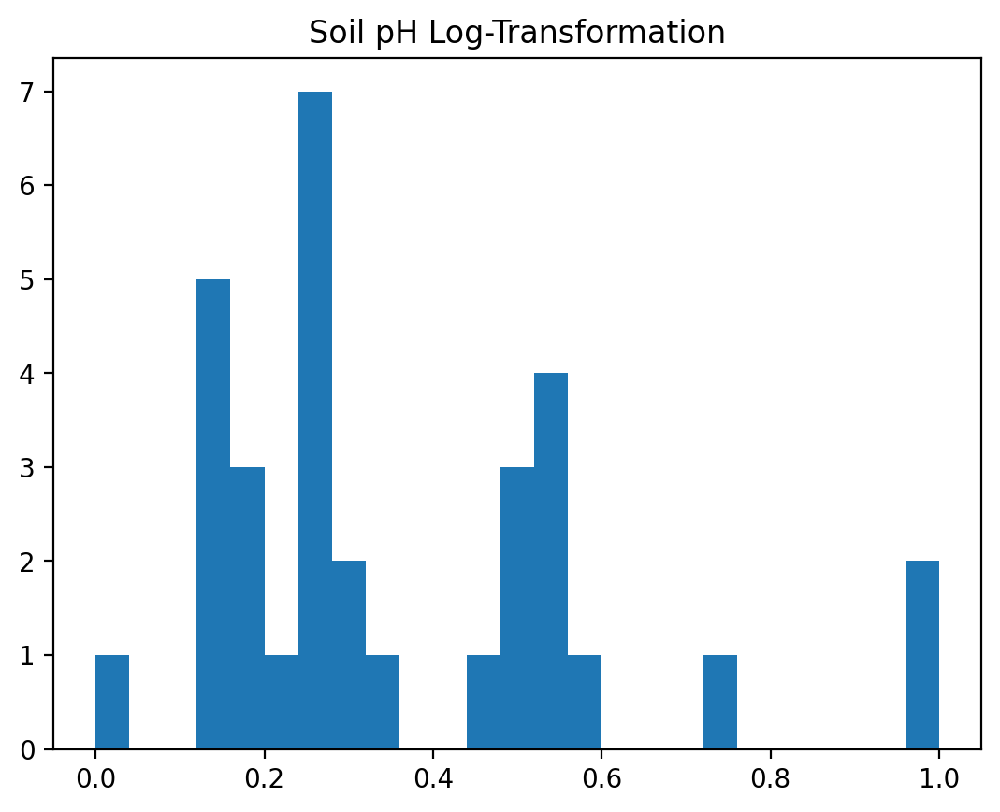

In [1224]:
plt.hist(y_train,bins=25);
plt.title('Soil pH Log-Transformation');

In [1225]:
lr = LinearRegression()
lasso = LassoCV(cv = 5)
ridge = RidgeCV()
elastic = ElasticNetCV()

In [1226]:
print('scoring the model: ')
print(cross_val_score(lr, X_train, y_train, cv = 5).mean())
print(cross_val_score(lasso, X_train, y_train, cv = 5).mean())
print(cross_val_score(ridge, X_train, y_train, cv = 5).mean())
print(cross_val_score(elastic, X_train, y_train, cv = 5).mean())

scoring the model: 
0.31816443004949574
0.24973164737957748
0.2867985222967165
0.24744416990111998


In [1227]:
ridge.fit(X_train, y_train);

In [1229]:
print('ridge score on training set:', ridge.score(X_train, y_train))
print('ridge score on test set: ', ridge.score(X_test, y_test))

ridge score on training set: 0.624299400944778
ridge score on test set:  0.45164450917236676


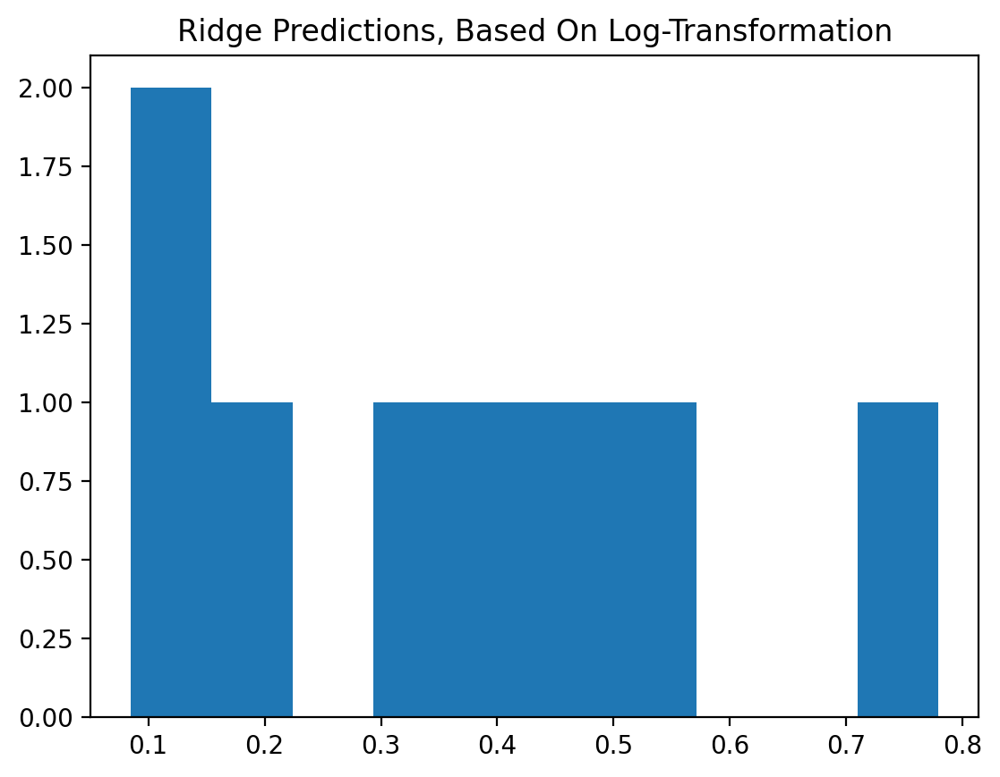

In [1230]:
ridge_pred = ridge.predict(X_test)
plt.hist(ridge_pred);
plt.title('ridge predictions, based on log-transformation'.title());

In [1231]:
ridge_pred_reversed = pt_y.inverse_transform(ridge_pred.reshape(-1,1))

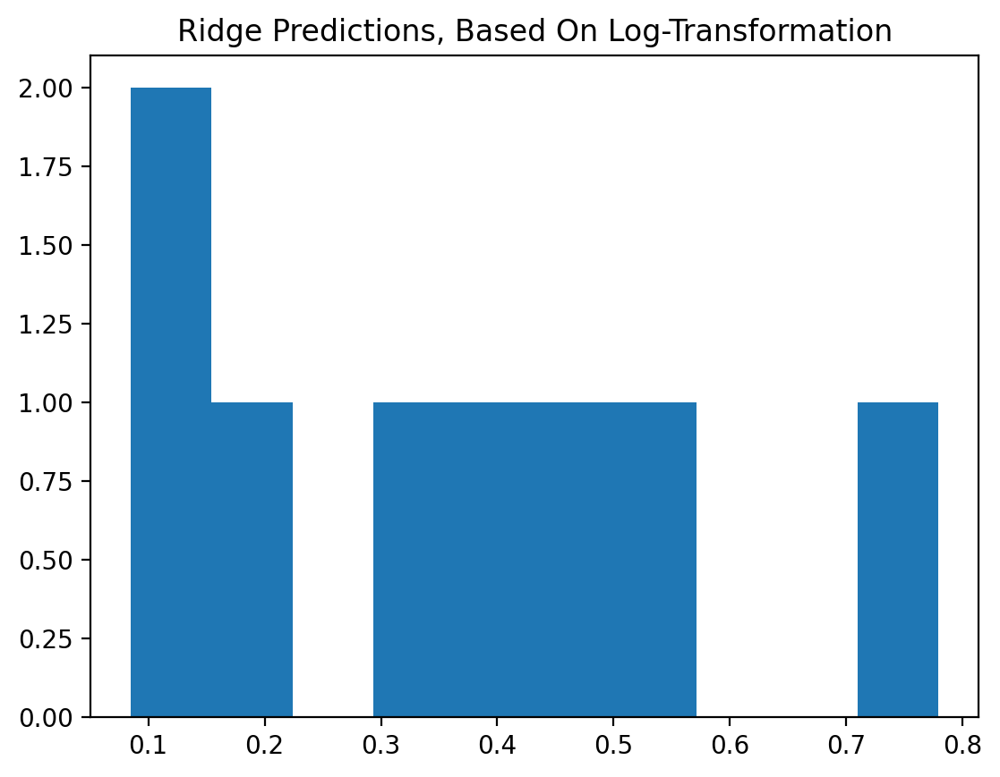

In [1232]:
ridge_pred = ridge.predict(X_test)
plt.hist(ridge_pred);
plt.title('ridge predictions, based on log-transformation'.title());

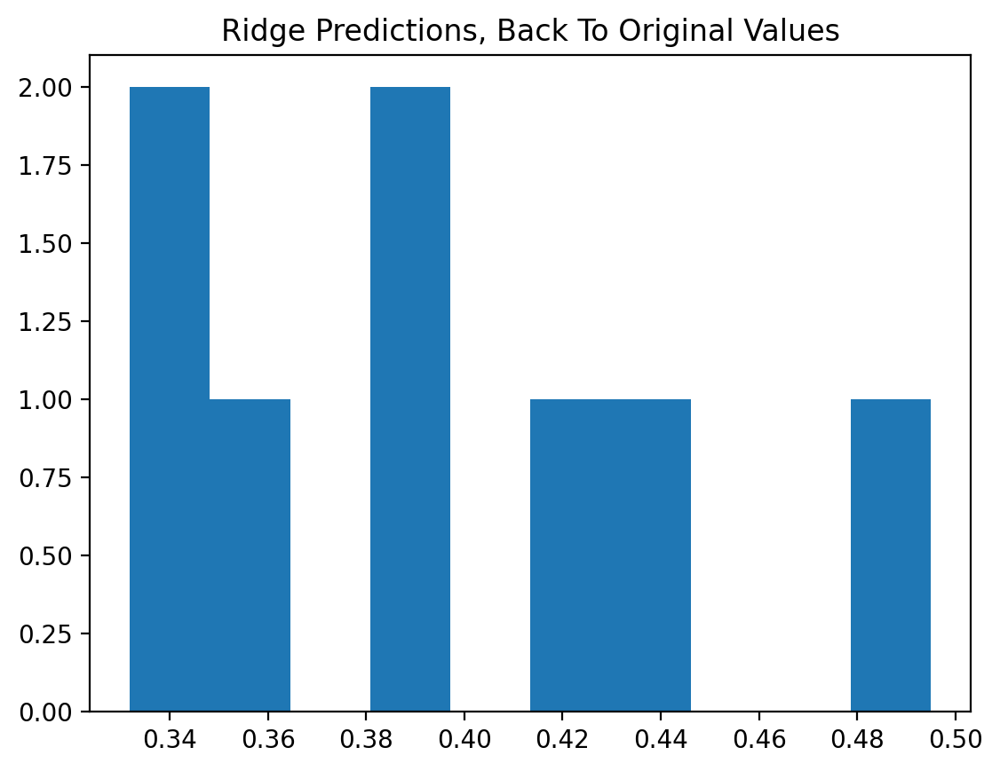

In [1233]:
plt.hist(ridge_pred_reversed);
plt.title('ridge predictions, back to original values'.title());

In [1234]:
print('ridge score on target: ', r2_score(y_test, ridge_pred_reversed))

ridge score on target:  0.2695762093314691


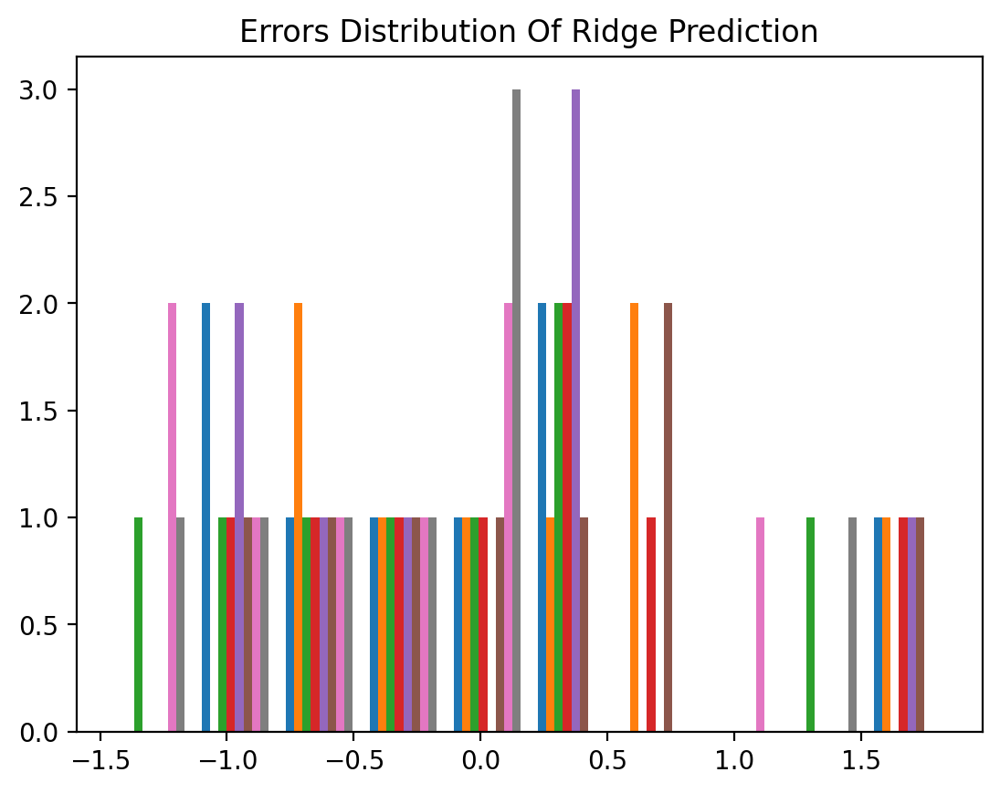

In [1235]:
resid = y_test_pt - ridge_pred
plt.hist(resid);
plt.title('errors distribution of ridge prediction'.title());

In [ ]:
# for i,j in features.iterrows():
#     print(i,j)

In [ ]:
# for column in features.columns:
#      pearson_coefficient, p_value = pearsonr(df[column],df['Volume'])

In [ ]:
# #features.columns
# arr1=[]; arr2=[]; arr3=[]; arr4=[];
# for a in range(0,6):
#     for i in range(0,6):
#         for j in range(1,6):
#             arr1=np.append(arr1,[pearsonr(features.iloc[:5][features.columns[i]],features.iloc[:5][features.columns[j]])])
#             arr2=np.append(arr2,[pearsonr(features.iloc[5:16][features.columns[i]],features.iloc[5:16][features.columns[j]])])
#             arr3=np.append(arr3,[pearsonr(features.iloc[16:31][features.columns[i]],features.iloc[16:31][features.columns[j]])])
#             arr4=np.append(arr4,[pearsonr(features.iloc[31:][features.columns[i]],features.iloc[31:][features.columns[j]])])

In [ ]:
[pearsonr(features.iloc[:5][features.columns[1]],features.iloc[:5][features.columns[5]])]

In [ ]:
features=features.reset_index().set_index(df.site.values)

In [ ]:
df1=features[features.index==0].set_index('index')
df2=features[features.index==1].set_index('index')
df3=features[features.index==2].set_index('index')
df4=features[features.index==3].set_index('index')
pb1=df1; dh1=df2; dh2=df3; dh3=df4;

In [ ]:
pb1.corr(),dh1.corr(),dh2.corr(),dh3.corr()

In [ ]:
# var=['dist','depth','st','sm','ph']
# var2=['depth','st','sm','ph']
# var3=['st','sm','ph']
# var4=['sm','ph']
# var5=['ph']

In [ ]:
# for i in range(len(var)):
#     for j in range(len(var2))]:
#         (if i <= 4) & (if j <= 3):
#             [pearsonr(pb1[var[i]],pb1[var2[j]])]
#         else:
#             [pearsonr(pb1[var[i]],pb1[var3[j]])]
        
             

### Synthesis

#### Statistics | Correlation Testing (AIC)

In [218]:
ds

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [219]:
ds2

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857


In [220]:
features

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [221]:
features2

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
loc,,,,,,,,,,
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


In [222]:
features3=features.iloc[:,:-1]
newfeatures=features.reset_index()

In [223]:
features3

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857


In [224]:
newfeatures

,loc,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph,dt
0,0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714,0.0
1,0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714,0.0
2,0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
3,0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857,0.0
4,0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857,0.0
242,3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857,0.0
243,3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857,0.0
244,3,9.984598e-01,0.0,0.000680,0.620253,0.507042,0.534562,0.353982,0.652174,0.357143,0.239583,0.609195,0.458824,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [225]:
print(newfeatures.columns.tolist())

['loc', 'dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dis', 'dep', 'sot', 'som', 'sph', 'dt']


In [226]:
print(newfeatures.columns[np.where(newfeatures.columns!='loc')[0].tolist()].tolist())

['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dis', 'dep', 'sot', 'som', 'sph', 'dt']


In [73]:
from statsmodels.tsa.stattools import adfuller
ls=newfeatures.iloc[:,:-1].columns.tolist()
for i in range(len(ls)):
    print(adfuller(newfeatures[ls[i]],autolag='AIC'))

(-1.70754421532967, 0.4272297220424628, 0, 245, {'1%': -3.4573260719088132, '5%': -2.873410402808354, '10%': -2.573095980841316}, -434.4470568124168)
(-0.5174886441275783, 0.888558285358058, 13, 232, {'1%': -3.458854867412691, '5%': -2.8740800599399323, '10%': -2.573453223097503}, -545.4662790227962)
(-2.7853388408977815, 0.060398720740631746, 0, 245, {'1%': -3.4573260719088132, '5%': -2.873410402808354, '10%': -2.573095980841316}, -1107.933142314174)
(-1.0568762446405435, 0.7319593893369558, 16, 229, {'1%': -3.4592326027153493, '5%': -2.8742454699025872, '10%': -2.5735414688888465}, -237.60594217890326)
(-1.8301052282412658, 0.36562100074406334, 14, 231, {'1%': -3.4589796764641, '5%': -2.8741347158661448, '10%': -2.573482381701992}, -156.05510223117454)
(-10.411936819074601, 1.7947156047545775e-18, 16, 229, {'1%': -3.4592326027153493, '5%': -2.8742454699025872, '10%': -2.5735414688888465}, -482.1601550292153)
(-1.79620940404444, 0.3823452366679846, 0, 245, {'1%': -3.4573260719088132, 

#### Statistics | Ad Fuller Test

In [394]:
#pd.concat([dfsc,df2sc],ignore_index=False).groupby(['sot','som','sph']).mean()

In [396]:
#print(pd.concat([dfsc,df2sc]).sort_index().columns.tolist())

In [418]:
zzz=pd.concat([dfsc,df2sc]).sort_index()[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph']].reset_index()
#zzz[:8]
#zzz[8:25]
#zzz[25:48]
#zzz[48:]

In [421]:
ds=ds[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph']]
ds

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


In [264]:
#zzz[:8]
#zzz[8:25]
#zzz[25:48]
#zzz[48:]

In [427]:
#zzz=dfsc.merge(df2sc, on='loc', how='left')[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph']].reset_index()
#pd.merge(dfsc, df2sc[df2sc.columns.difference(dfsc.columns)], left_index=True,right_index=True, how='inner')[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph']].reset_index()
#pd.merge(dfsc,df2sc,on='loc')[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph']].reset_index()
#pd.merge(left=dfsc, right=df2sc, left_on='loc', right_on='loc')
#pd.merge(dfsc, df2sc, on='loc')
#pd.concat([df2sc,dfsc],ignore_index=False)[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin', 'dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph']].reset_index()

In [466]:
import statsmodels
from statsmodels import *
from statsmodels.tsa.stattools import kpss,adfuller

In [431]:
ds2=ds.diff().dropna(); ds2

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,,,
0,1.540578e-09,0.0,0.0,0.012658,0.028169,0.009217,0.026549,-0.032609,0.035714,0.000000,0.011494,0.023529,0.005168,0.012821,0.0,0.0,0.000000,0.000000,0.000000
0,3.219807e-07,0.0,0.0,0.265823,0.042254,-0.543779,-0.088496,0.086957,-0.089286,0.072917,0.160920,-0.105882,0.206718,0.269231,0.0,0.0,0.000000,0.000000,0.000000
0,-3.235213e-07,0.0,0.0,-0.278481,-0.070423,0.534562,0.061947,-0.054348,0.053571,-0.072917,-0.172414,0.082353,-0.211886,-0.282051,0.0,1.0,-0.295359,-0.339552,-0.002857
0,1.540578e-09,0.0,0.0,0.012658,0.028169,0.009217,0.026549,-0.032609,0.035714,0.000000,0.011494,0.023529,0.005168,0.012821,0.0,0.0,0.000000,0.000000,0.000000
0,3.219807e-07,0.0,0.0,0.265823,0.042254,-0.543779,-0.088496,0.086957,-0.089286,0.072917,0.160920,-0.105882,0.206718,0.269231,0.0,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,1.263274e-07,0.0,0.0,-0.037975,-0.323944,-0.631336,-0.070796,0.065217,-0.062500,-0.385417,-0.114943,-0.458824,-0.049096,-0.051282,0.0,1.0,-0.421941,-0.783582,0.285714
3,-9.984600e-01,0.0,0.0,-0.088608,0.140845,0.511521,-0.283186,0.293478,-0.285714,0.593750,-0.068966,0.270588,0.041344,-0.089744,0.0,0.0,0.000000,0.000000,0.000000
3,-7.702889e-09,0.0,0.0,0.050633,0.042254,-0.004608,-0.026549,0.021739,-0.026786,-0.375000,0.068966,0.035294,0.046512,0.051282,0.0,0.0,0.000000,0.000000,0.000000


In [434]:
for i in range(len(ds2.columns.tolist())):
    print(adfuller(ds2[ds2.columns.tolist()[i]]))

(-4.762254661471619, 6.418730582661973e-05, 13, 231, {'1%': -3.4589796764641, '5%': -2.8741347158661448, '10%': -2.573482381701992}, -543.7491551897369)
(-15.694404323200931, 1.420929913933908e-28, 0, 244, {'1%': -3.457437824930831, '5%': -2.873459364726563, '10%': -2.573122099570008}, -1101.8928552704308)
(-15.70042671631505, 1.398304554368448e-28, 0, 244, {'1%': -3.457437824930831, '5%': -2.873459364726563, '10%': -2.573122099570008}, -1102.3169815917508)
(-5.368499979208238, 3.943302959951216e-06, 16, 228, {'1%': -3.4593607492757554, '5%': -2.8743015807562924, '10%': -2.5735714042782396}, -461.070058647251)
(-4.808012204020166, 5.249871211124895e-05, 16, 228, {'1%': -3.4593607492757554, '5%': -2.8743015807562924, '10%': -2.5735714042782396}, -416.42845219743185)
(-4.803009696213961, 5.366950956617036e-05, 16, 228, {'1%': -3.4593607492757554, '5%': -2.8743015807562924, '10%': -2.5735714042782396}, -240.39581186580324)
(-4.9710682891760305, 2.531295622242454e-05, 16, 228, {'1%': -3.45

In [440]:
for i in range(len(ds2.columns.tolist())):
    print(kpss(ds2[ds2.columns.tolist()[i]].values, regression = "ct"))

(0.045384829451317, 0.1, 21, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.08320102880581291, 0.1, 2, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.07782147783544038, 0.1, 2, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.14939897392556548, 0.047167521728695434, 70, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.1268015192469159, 0.0855527421353409, 57, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.06480440154446666, 0.1, 32, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.05825679104215998, 0.1, 24, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.05387039918929131, 0.1, 25, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.05394691214593091, 0.1, 25, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.16863266686363512, 0.03113944428030406, 63, {'10%': 0.119, '5%': 0.146, '2.5%': 0.176, '1%': 0.216})
(0.14567483223866792, 0.05060216252098531, 69, {'10%': 0.119, '5%': 0.146, '2

In [451]:
cols=features.iloc[:,:-1].diff().dropna().columns.tolist()
for i in range(len(cols)):
    print(adfuller(features.iloc[:,:-1].diff().dropna()[cols[i]]))

(-4.762254661471619, 6.418730582661973e-05, 13, 231, {'1%': -3.4589796764641, '5%': -2.8741347158661448, '10%': -2.573482381701992}, -543.7491551897369)
(-15.694404323200931, 1.420929913933908e-28, 0, 244, {'1%': -3.457437824930831, '5%': -2.873459364726563, '10%': -2.573122099570008}, -1101.8928552704308)
(-4.803009696213961, 5.366950956617036e-05, 16, 228, {'1%': -3.4593607492757554, '5%': -2.8743015807562924, '10%': -2.5735714042782396}, -240.39581186580324)
(-3.723916577341754, 0.003789049667451117, 13, 231, {'1%': -3.4589796764641, '5%': -2.8741347158661448, '10%': -2.573482381701992}, -165.41056465451584)
(-5.2157100595116255, 8.165475182605538e-06, 16, 228, {'1%': -3.4593607492757554, '5%': -2.8743015807562924, '10%': -2.5735714042782396}, -412.0923417211666)
(-15.556499044567454, 2.0682708151551545e-28, 0, 244, {'1%': -3.457437824930831, '5%': -2.873459364726563, '10%': -2.573122099570008}, -585.2838681563685)
(-12.122011477589597, 1.8161747936848676e-22, 13, 231, {'1%': -3.458

In [452]:
cols=features.iloc[:,:-1].diff().dropna().columns.tolist()
for i in range(len(cols)):
    print(kpss(features.iloc[:,:-1].diff().dropna()[cols[i]]))

(0.04487889888663838, 0.1, 21, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.1410442703142432, 0.1, 1, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.08275367999895568, 0.1, 32, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.16871739445043316, 0.1, 63, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.22573492123611233, 0.1, 70, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.17415239952814532, 0.1, 0, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.009584862652344716, 0.1, 3, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.02122104547610284, 0.1, 4, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.012457368544122294, 0.1, 1, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})
(0.013901847929284464, 0.1, 4, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})


In [473]:
newfeatures2=(features-features.shift(1)).dropna()

In [458]:
newfeatures=features.iloc[:,:-1].diff().dropna()

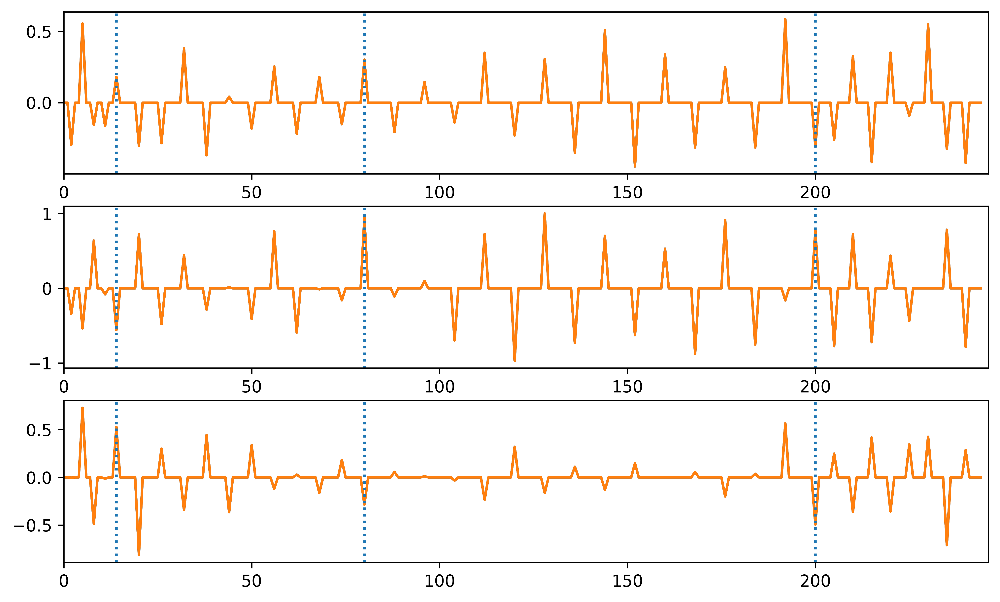

In [474]:
fig,[ax1,ax2,ax3]=plt.subplots(3,1,figsize=(10,6),dpi=300)
ax1.plot(newfeatures['sot'].values)
ax1.plot(newfeatures2['sot'].values)
ax1.axvline(x=14,linestyle='dotted')
ax1.axvline(x=80,linestyle='dotted')
ax1.axvline(x=200,linestyle='dotted');
ax1.set_xlim(0,246);
ax2.plot(newfeatures['som'].values)
ax2.plot(newfeatures2['som'].values)
ax2.axvline(x=14,linestyle='dotted')
ax2.axvline(x=80,linestyle='dotted')
ax2.axvline(x=200,linestyle='dotted');
ax2.set_xlim(0,246);
ax3.plot(newfeatures['sph'].values)
ax3.plot(newfeatures2['sph'].values)
ax3.axvline(x=14,linestyle='dotted')
ax3.axvline(x=80,linestyle='dotted')
ax3.axvline(x=200,linestyle='dotted');
ax3.set_xlim(0,246);

In [467]:
#ADF
#non-stationary
#zf[['dat','lon','rh','wsp','sot','dis','som']]
#stationary
#zf[['hin','dep','sph']]
#KPSS
#non-stationary 
#zf[['dat','lon','rh','wsp','sot']]
#stationary
#zf[['hin','dis','dep','som','sph']]

In [468]:
# for i in range(len(zf.columns.tolist())):
#     print(adfuller(zf[zf.columns.tolist()[i]].values))
#     #print(kpss(zf[zf.columns.tolist()[i]].values, regression = "ct"))

In [100]:
# cols=zf.columns.tolist()
# for i in range(len(cols)):
#     print(f"{cols[i]}: {kpss(zf[cols[i]],regression='ct')}")

In [84]:
#all features/covariates are non-stationary except depth of soil moisture measurement (dep)

#### Statistics | ACF, PACF, Autocorrelation

In [502]:
print(newfeatures3.columns.tolist())

['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']


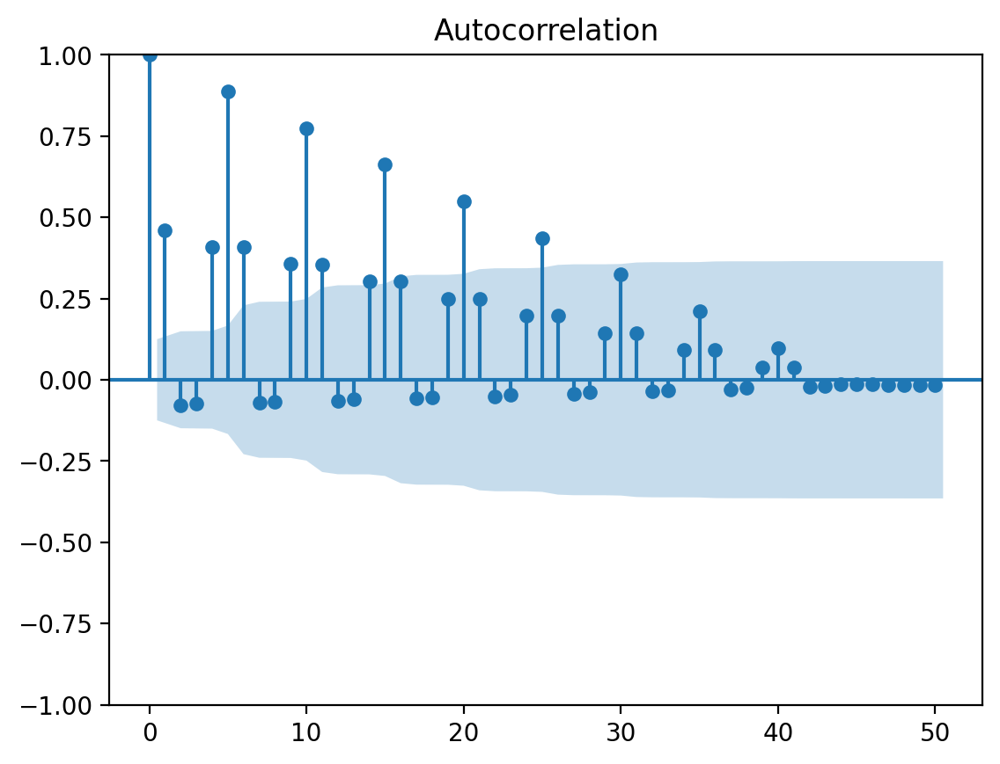

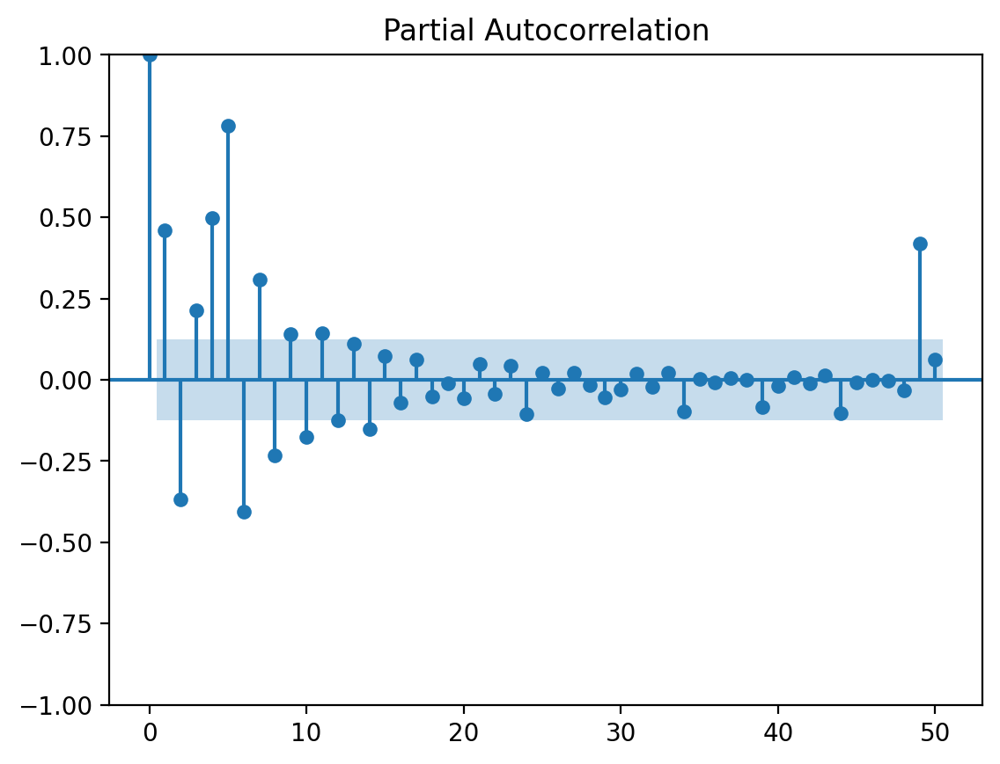

In [503]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['dat'],lags=50)
plt.show()

plot_pacf(newfeatures3['dat'],lags=50)
plt.show()

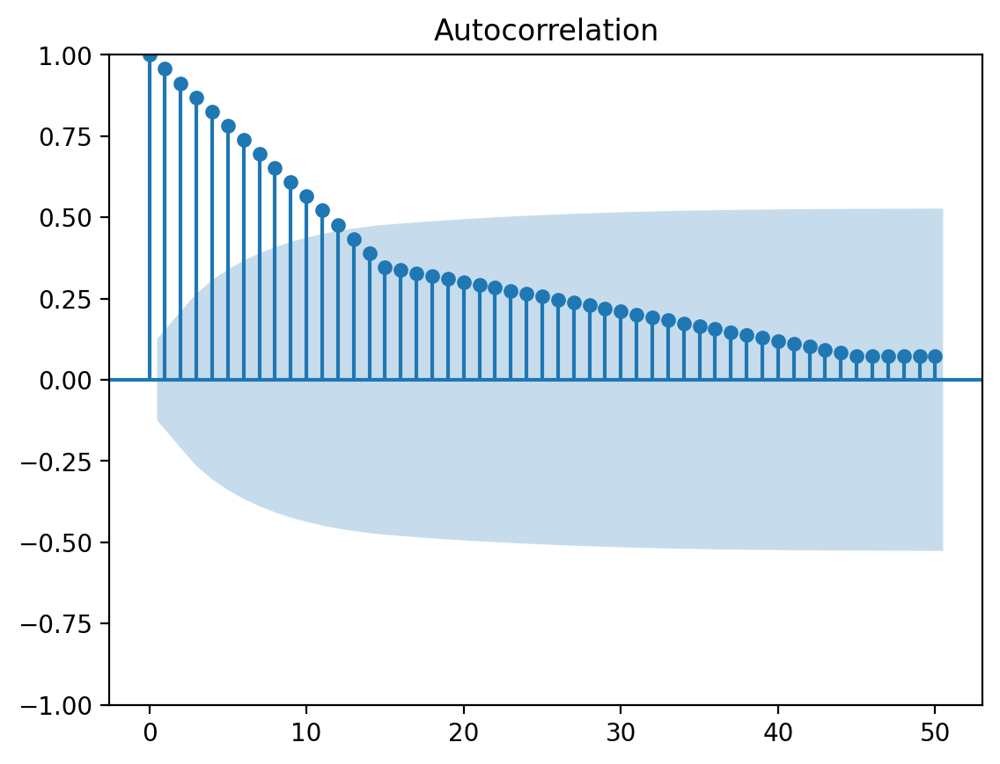

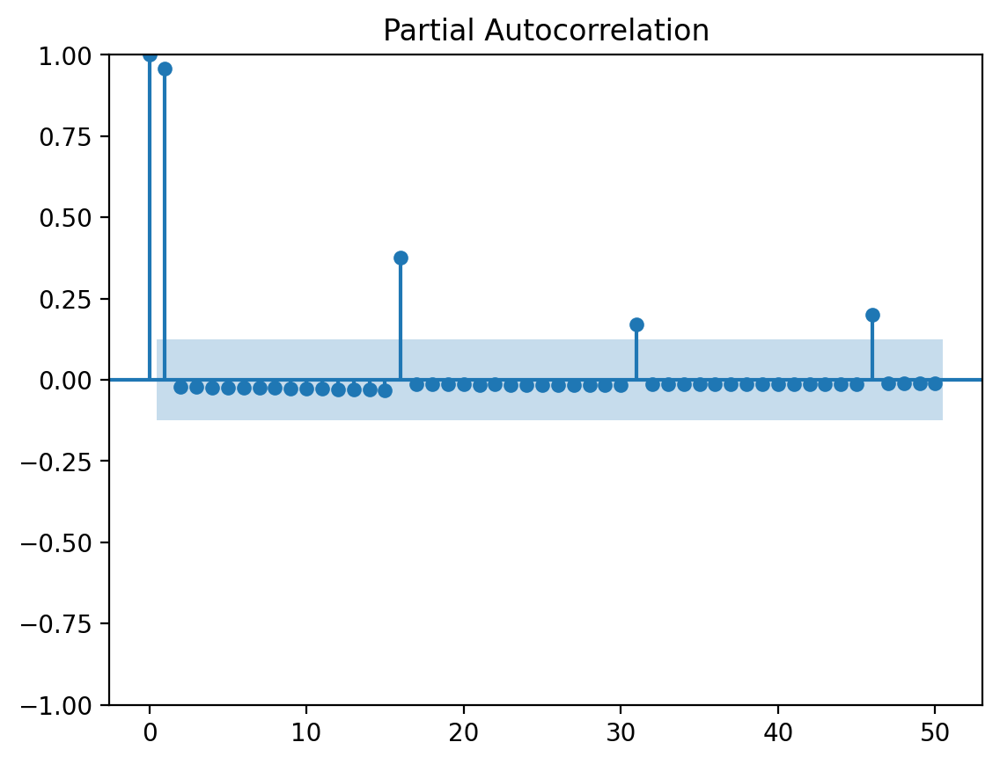

In [504]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['lon'],lags=50)
plt.show()

plot_pacf(newfeatures3['lon'],lags=50)
plt.show()

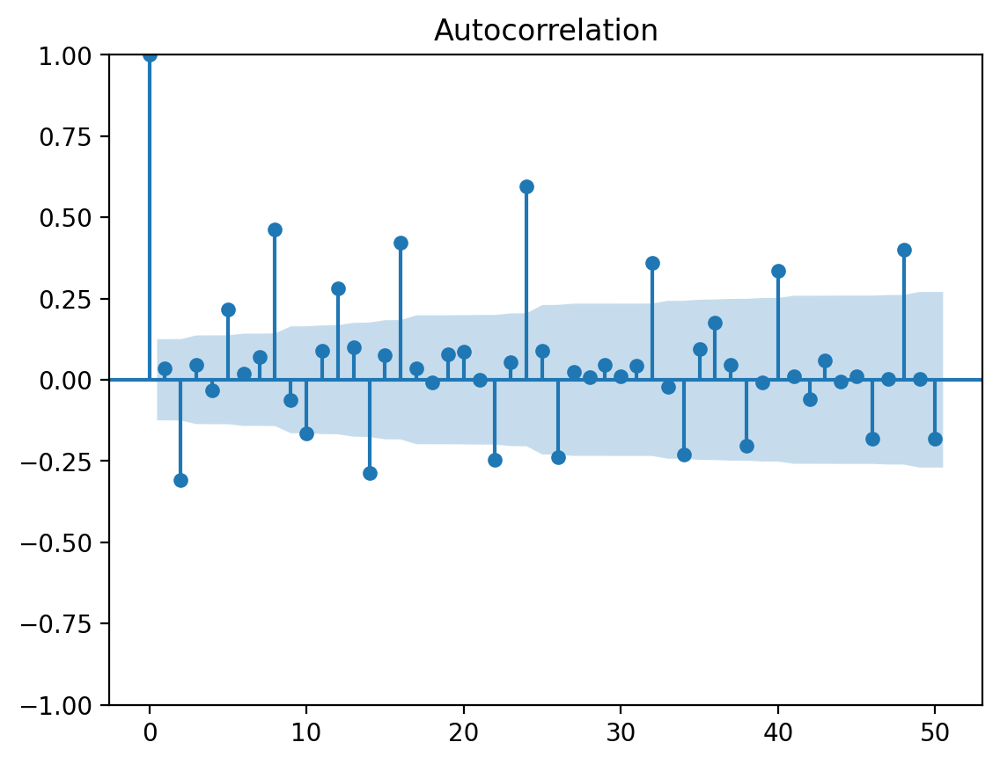

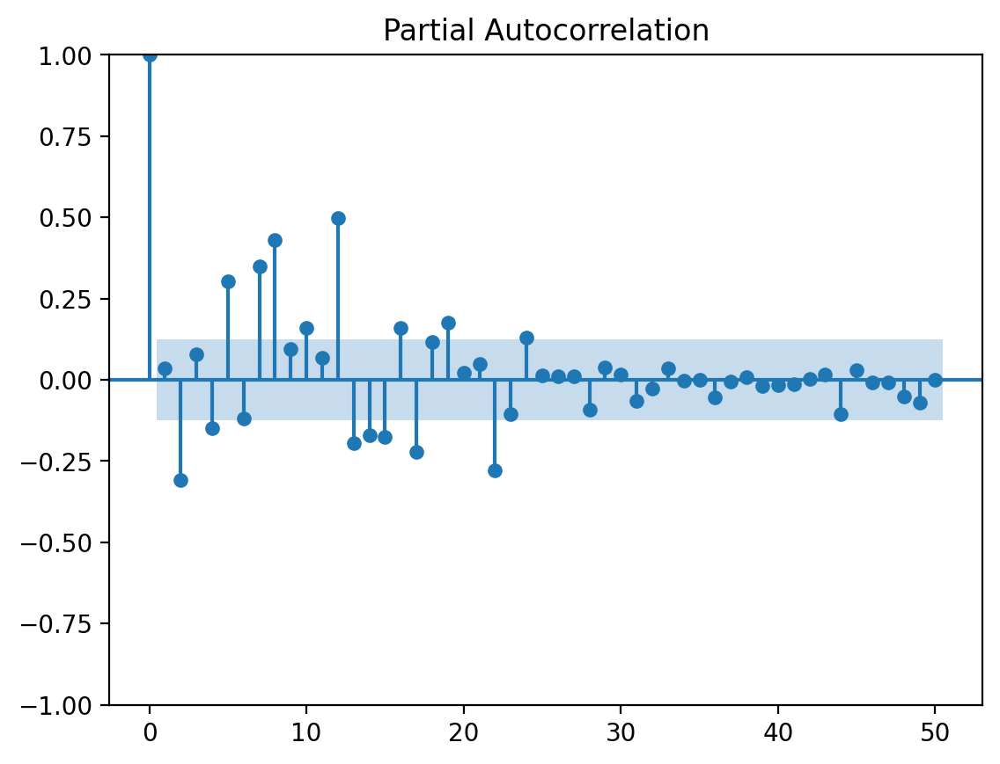

In [505]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['rh'],lags=50)
plt.show()

plot_pacf(newfeatures3['rh'],lags=50)
plt.show()

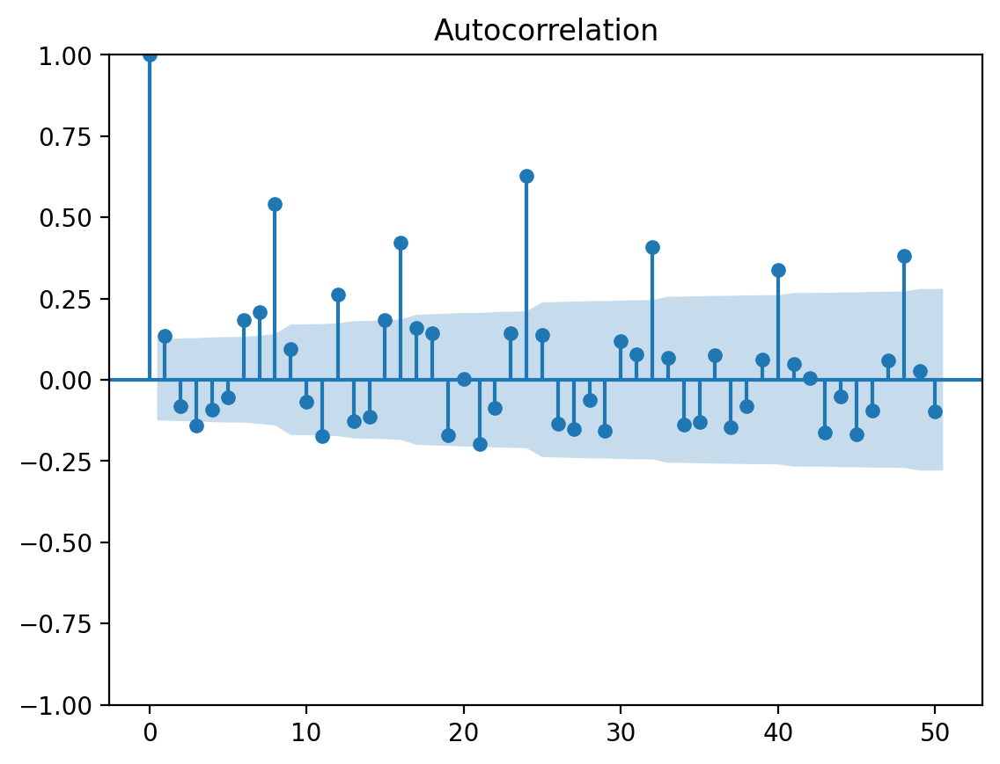

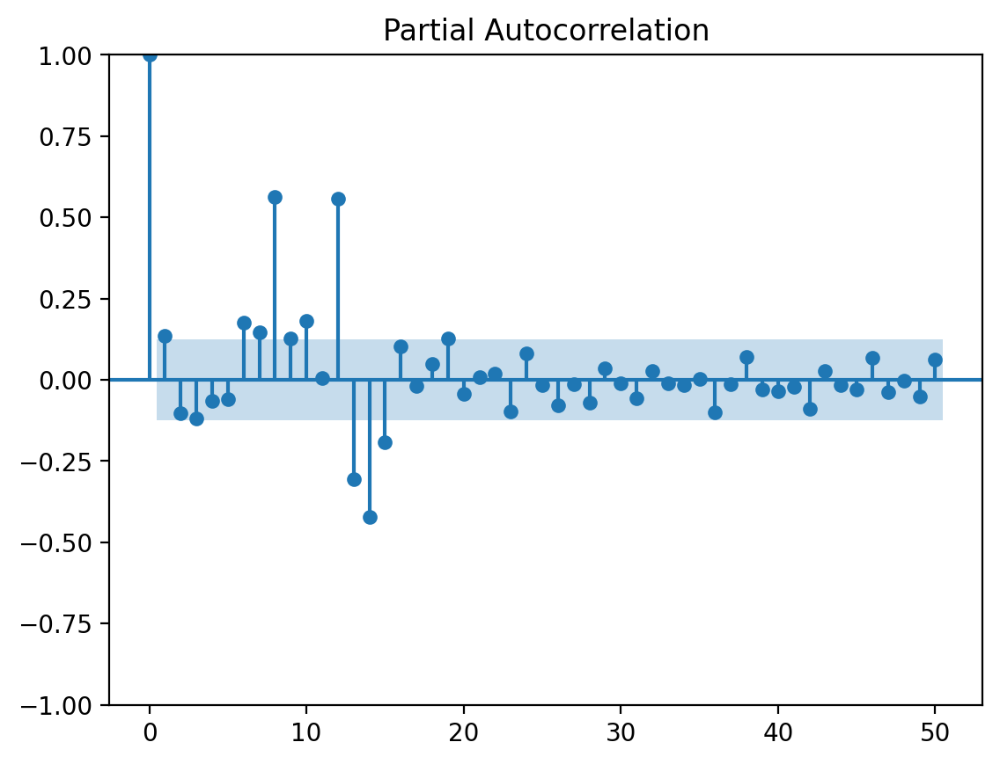

In [506]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['wsp'],lags=50)
plt.show()

plot_pacf(newfeatures3['wsp'],lags=50)
plt.show()

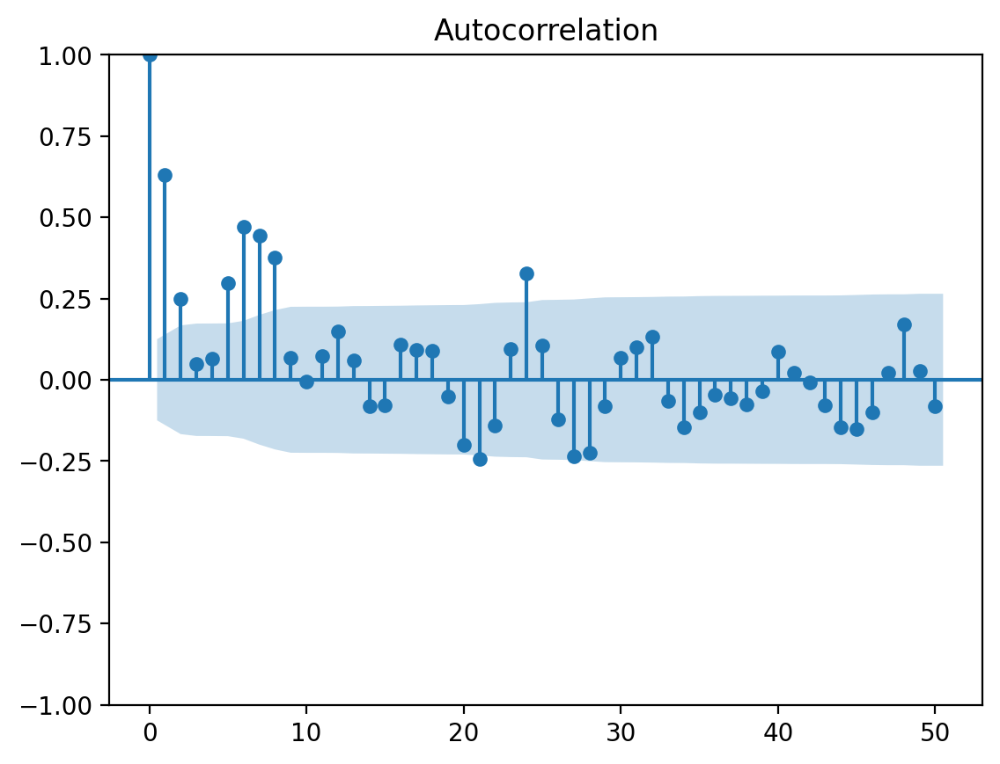

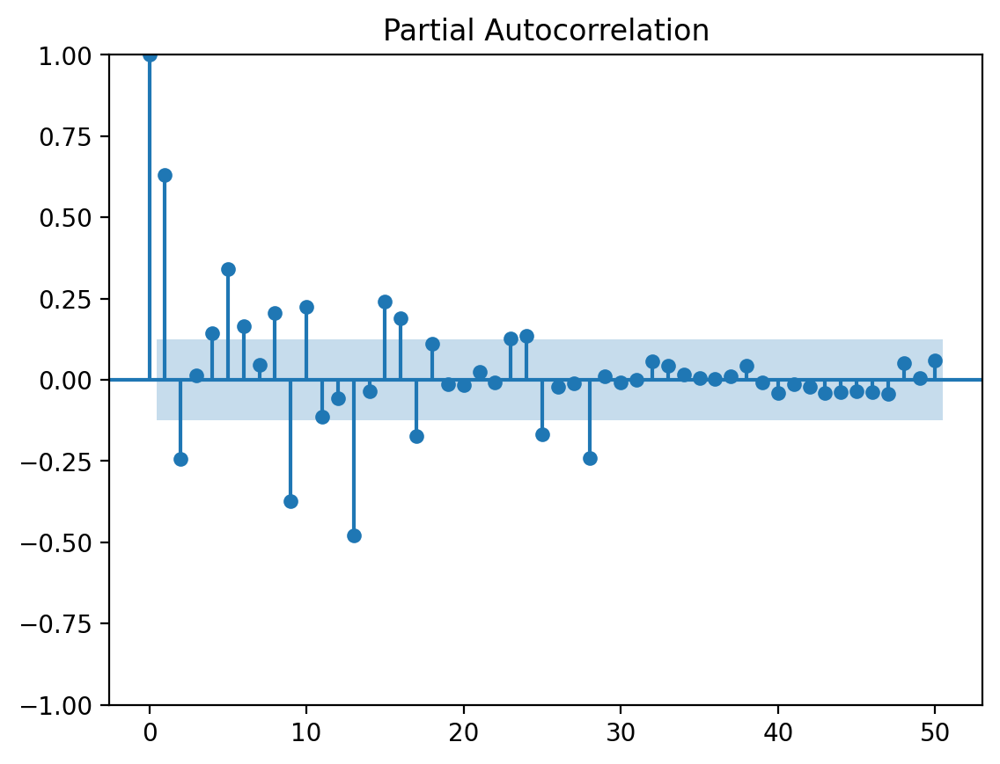

In [507]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['hin'],lags=50)
plt.show()

plot_pacf(newfeatures3['hin'],lags=50)
plt.show()

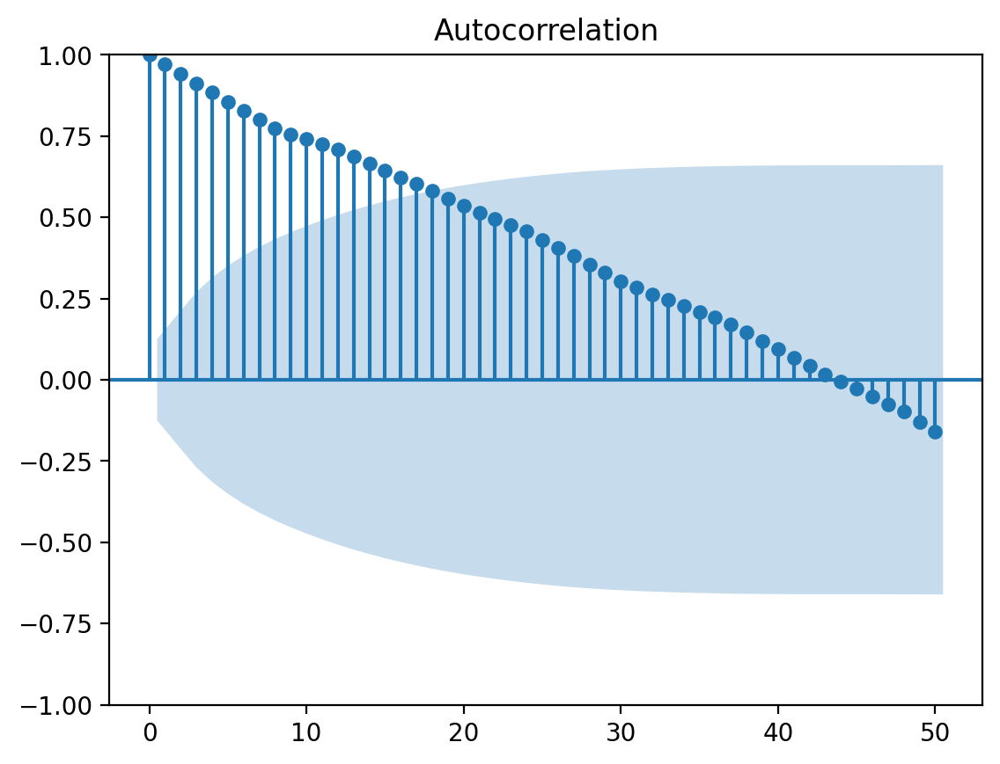

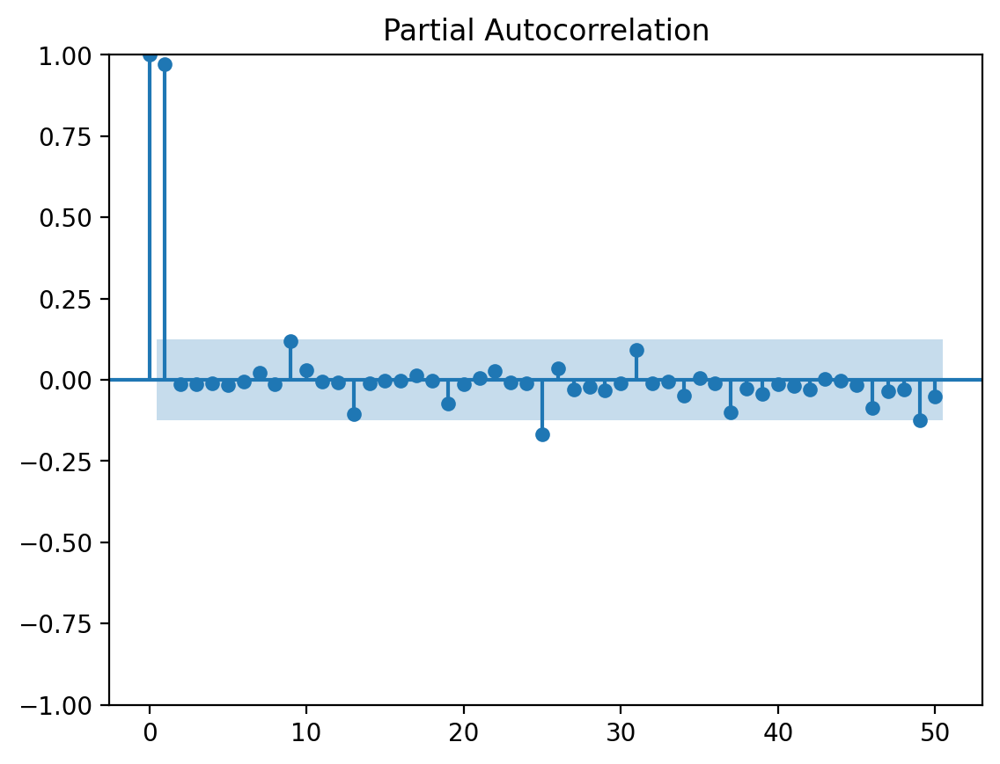

In [508]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['dis'],lags=50)
plt.show()

plot_pacf(newfeatures3['dis'],lags=50)
plt.show()

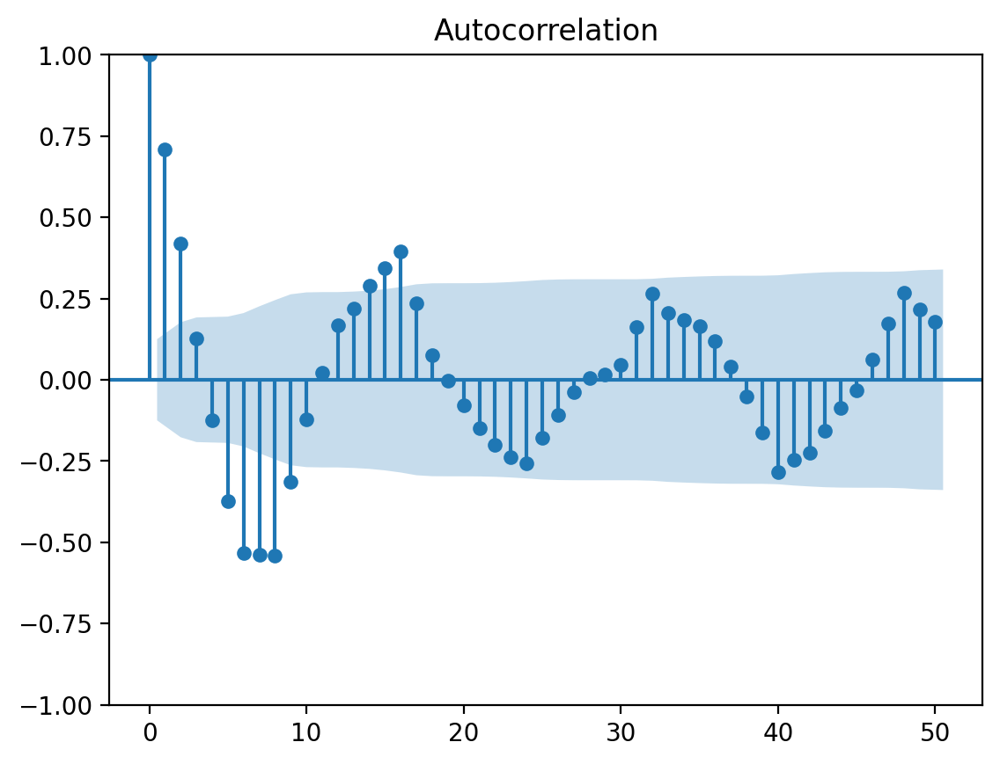

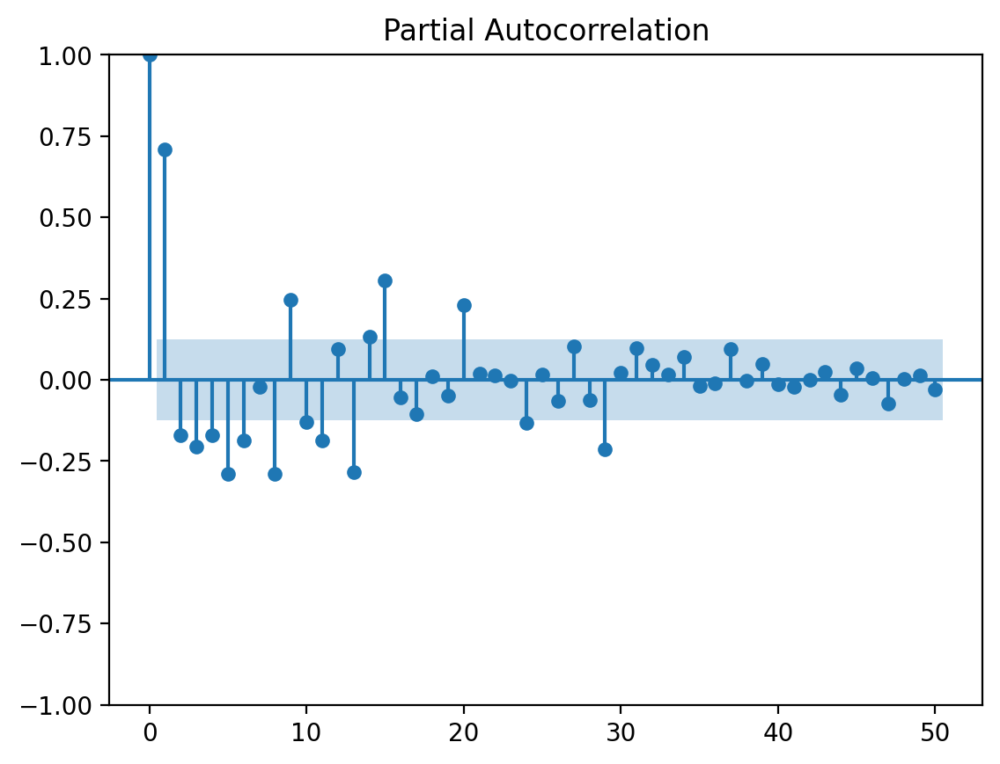

In [509]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['dep'],lags=50)
plt.show()

plot_pacf(newfeatures3['dep'],lags=50)
plt.show()

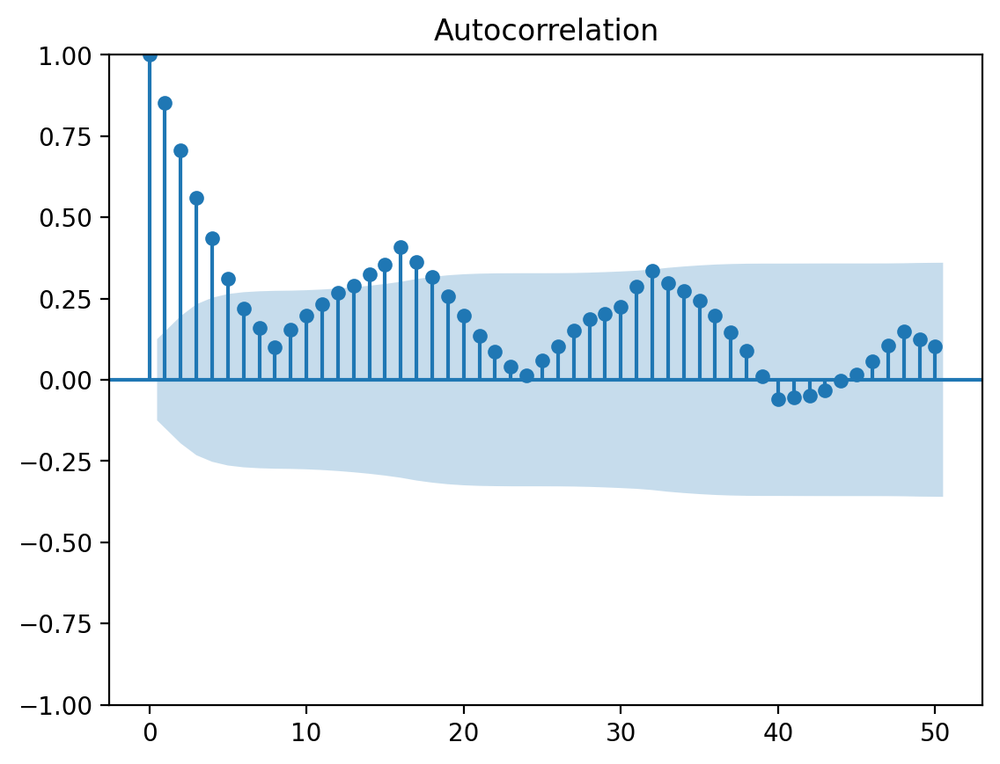

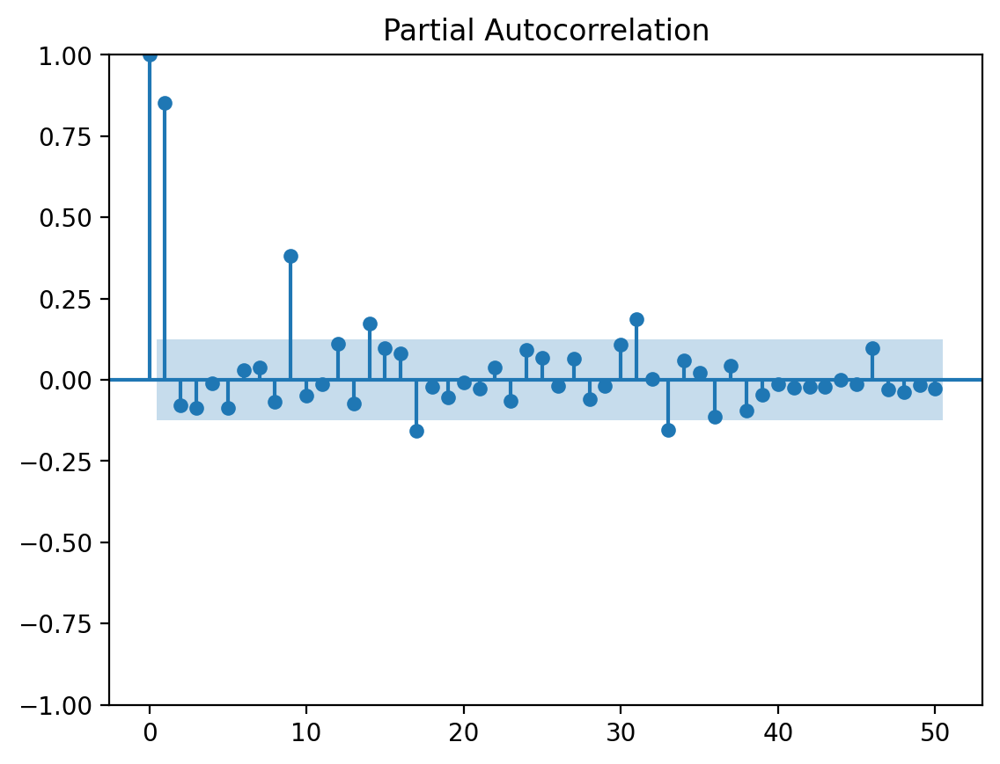

In [510]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['sot'],lags=50)
plt.show()

plot_pacf(newfeatures3['sot'],lags=50)
plt.show()

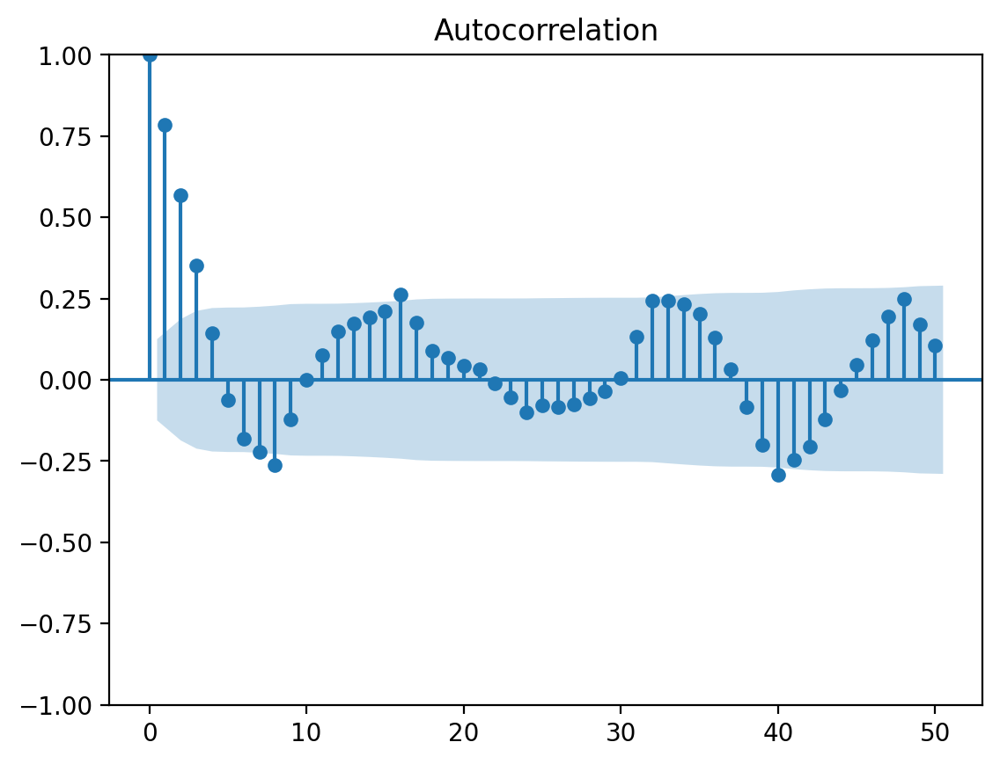

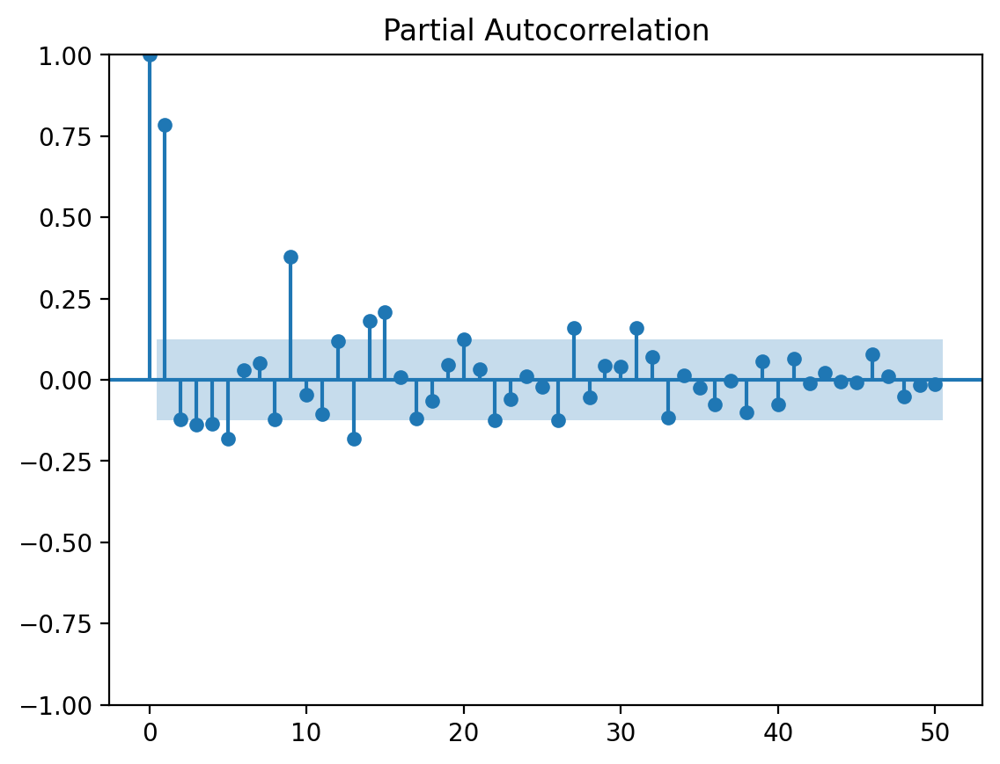

In [511]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['som'],lags=50)
plt.show()

plot_pacf(newfeatures3['som'],lags=50)
plt.show()

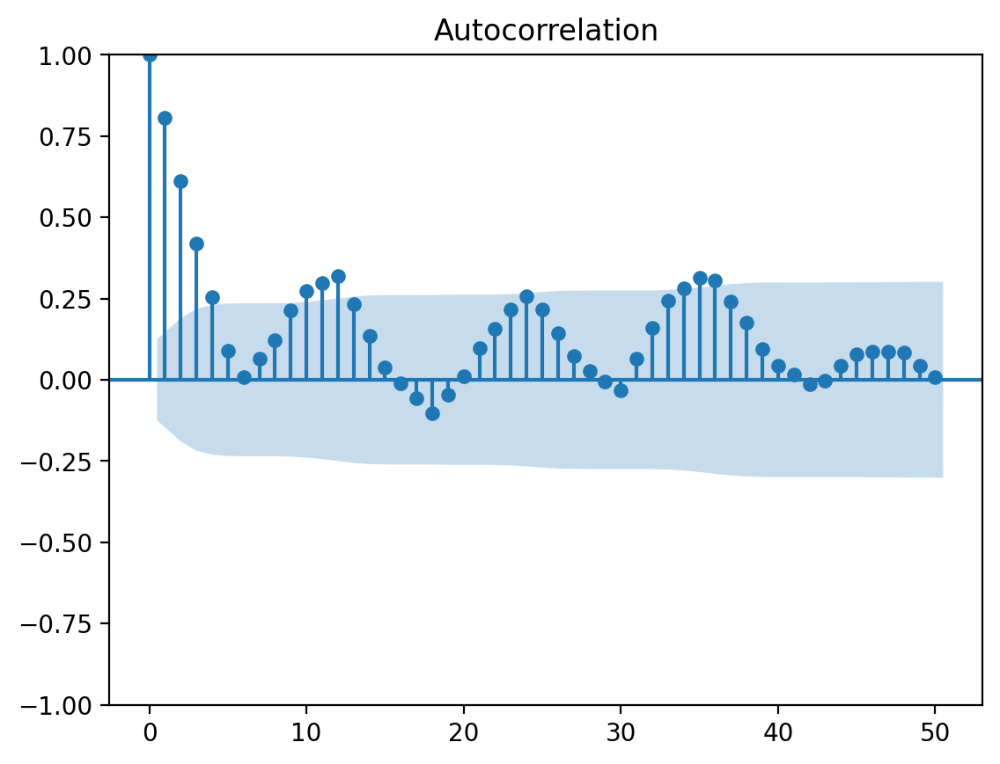

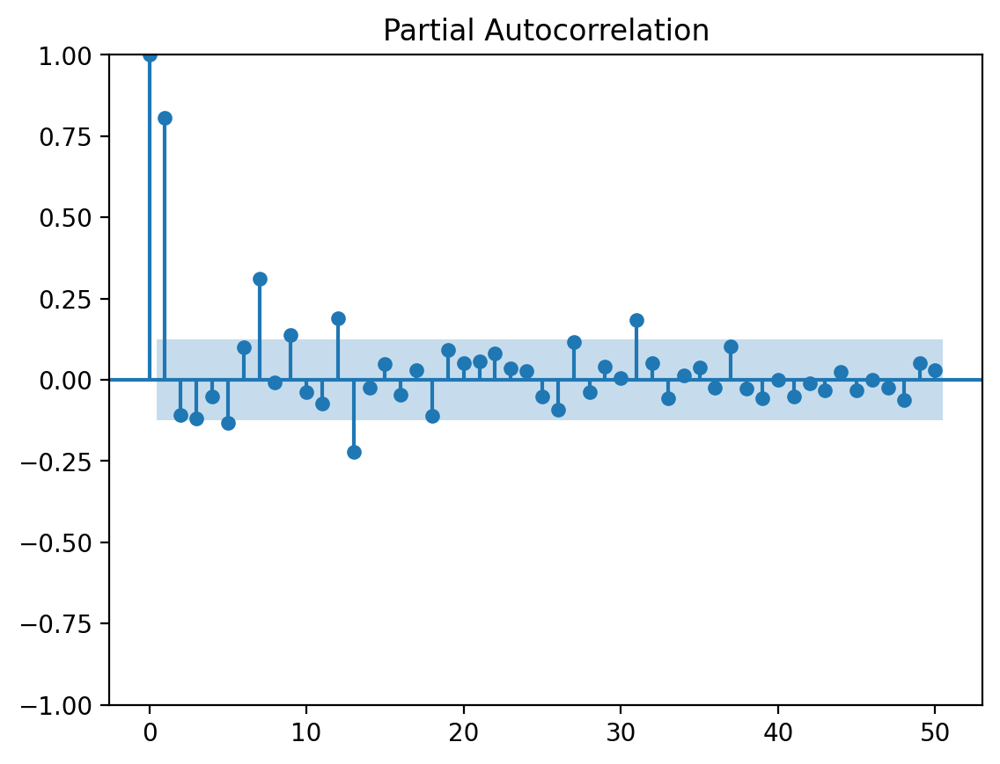

In [512]:
#plt.subplots(1,1,figsize=(10,6))
plot_acf(newfeatures3['sph'],lags=50)
plt.show()

plot_pacf(newfeatures3['sph'],lags=50)
plt.show()

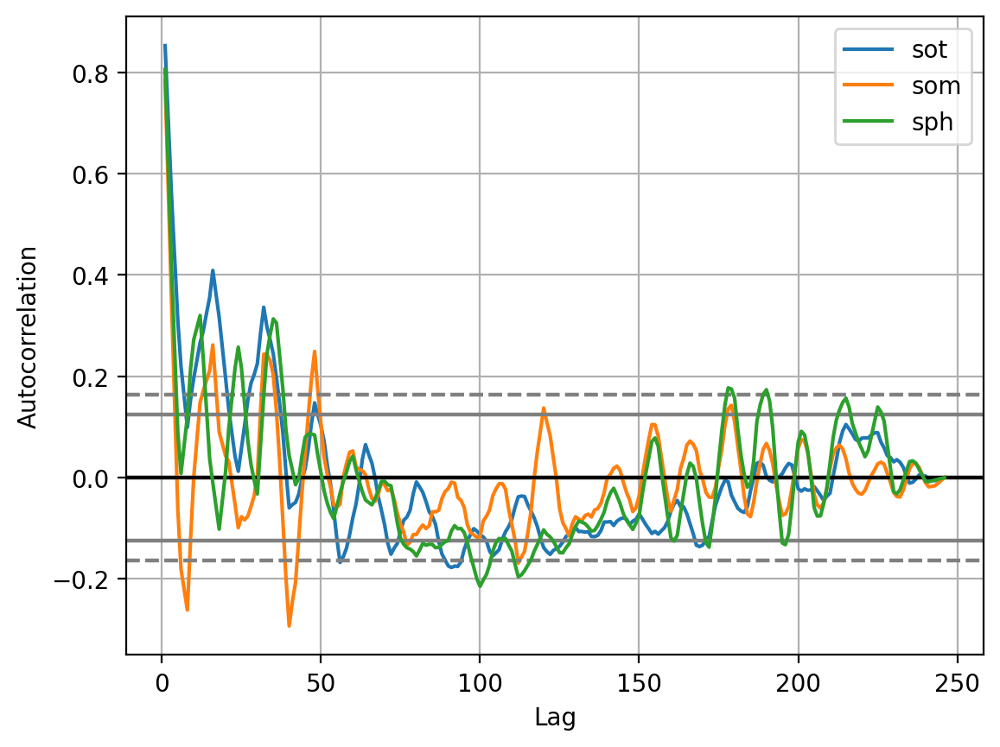

In [740]:
sh=newfeatures3.iloc[:,-3:]
fig, ax = plt.subplots()
for col in sh.columns:
    pd.plotting.autocorrelation_plot(sh[col], ax=ax, label=col)
plt.legend()
plt.show()

#### Linear Regression, Residuals

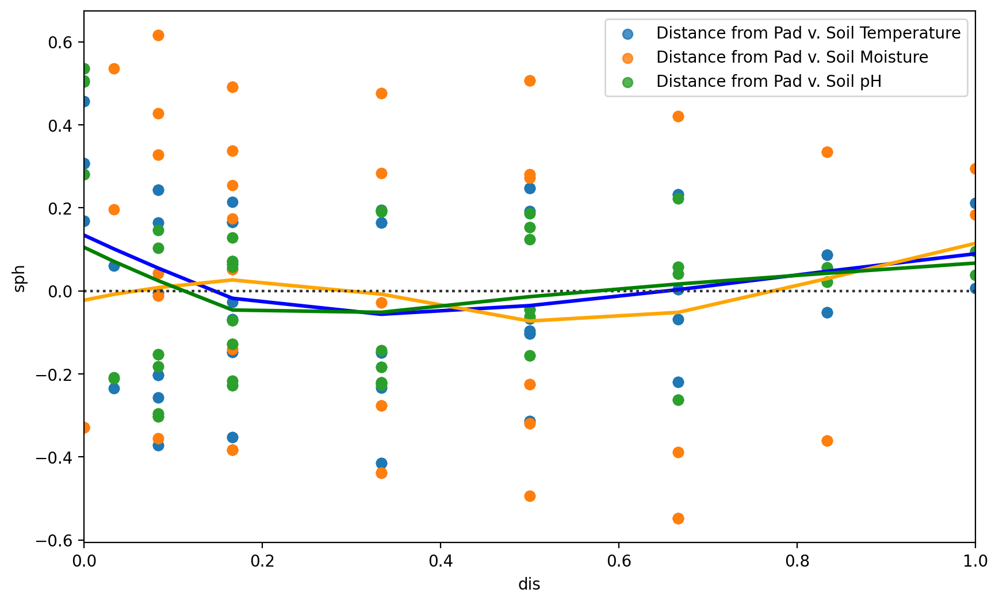

In [762]:
#Plot the residuals of a linear regression.
#This function will regress y on x (possibly as a robust or polynomial regression) and then draw a scatterplot of the residuals.
#You can optionally fit a lowess smoother to the residual plot, which can help in determining if there is structure to the residuals.
fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=100)

sns.residplot(data=newfeatures3, ax=ax, x="dis", y="sot", lowess=True, line_kws=dict(color="b"),label='Distance from Pad v. Soil Temperature');
sns.residplot(data=newfeatures3, ax=ax, x="dis", y="som", lowess=True, line_kws=dict(color="orange"),label='Distance from Pad v. Soil Moisture');
sns.residplot(data=newfeatures3, ax=ax, x="dis", y="sph", lowess=True, line_kws=dict(color="g"),label='Distance from Pad v. Soil pH');

#sns.residplot(data=newfeatures.loc[0], x="som", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="som", y="sph", lowess=True, line_kws=dict(color="b"))

#sns.residplot(data=newfeatures.loc[0], x="sph", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="sph", y="som", lowess=True, line_kws=dict(color="b"))

plt.legend()
plt.show()

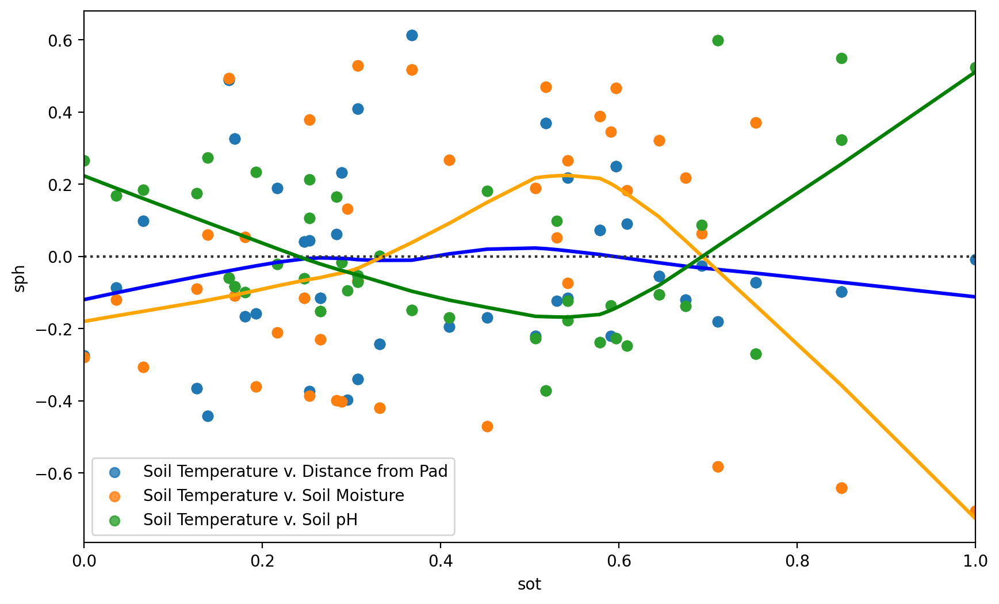

In [764]:
#Plot the residuals of a linear regression.
#This function will regress y on x (possibly as a robust or polynomial regression) and then draw a scatterplot of the residuals.
#You can optionally fit a lowess smoother to the residual plot, which can help in determining if there is structure to the residuals.
fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=100)

sns.residplot(data=newfeatures3, ax=ax, x="sot", y="dis", lowess=True, line_kws=dict(color="b"),label='Soil Temperature v. Distance from Pad');
sns.residplot(data=newfeatures3, ax=ax, x="sot", y="som", lowess=True, line_kws=dict(color="orange"),label='Soil Temperature v. Soil Moisture');
sns.residplot(data=newfeatures3, ax=ax, x="sot", y="sph", lowess=True, line_kws=dict(color="g"),label='Soil Temperature v. Soil pH');

#sns.residplot(data=newfeatures.loc[0], x="som", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="som", y="sph", lowess=True, line_kws=dict(color="b"))

#sns.residplot(data=newfeatures.loc[0], x="sph", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="sph", y="som", lowess=True, line_kws=dict(color="b"))

plt.legend()
plt.show()

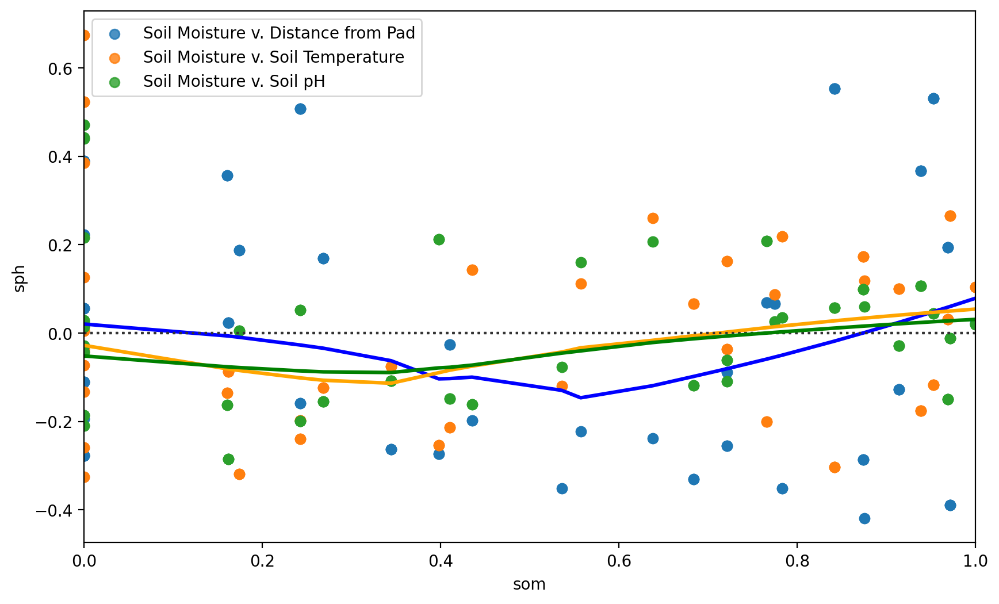

In [765]:
#Plot the residuals of a linear regression.
#This function will regress y on x (possibly as a robust or polynomial regression) and then draw a scatterplot of the residuals.
#You can optionally fit a lowess smoother to the residual plot, which can help in determining if there is structure to the residuals.
fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=100)

sns.residplot(data=newfeatures3, ax=ax, x="som", y="dis", lowess=True, line_kws=dict(color="b"),label='Soil Moisture v. Distance from Pad');
sns.residplot(data=newfeatures3, ax=ax, x="som", y="sot", lowess=True, line_kws=dict(color="orange"),label='Soil Moisture v. Soil Temperature');
sns.residplot(data=newfeatures3, ax=ax, x="som", y="sph", lowess=True, line_kws=dict(color="g"),label='Soil Moisture v. Soil pH');

#sns.residplot(data=newfeatures.loc[0], x="som", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="som", y="sph", lowess=True, line_kws=dict(color="b"))

#sns.residplot(data=newfeatures.loc[0], x="sph", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="sph", y="som", lowess=True, line_kws=dict(color="b"))

plt.legend()
plt.show()

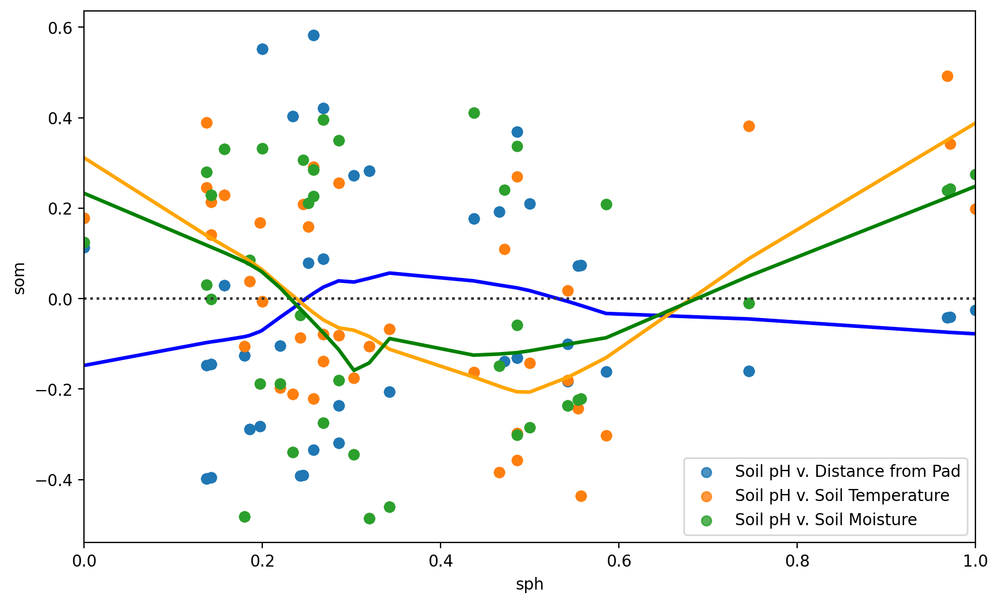

In [766]:
#Plot the residuals of a linear regression.
#This function will regress y on x (possibly as a robust or polynomial regression) and then draw a scatterplot of the residuals.
#You can optionally fit a lowess smoother to the residual plot, which can help in determining if there is structure to the residuals.
fig,ax=plt.subplots(1,1,figsize=(10,6),dpi=100)

sns.residplot(data=newfeatures3, ax=ax, x="sph", y="dis", lowess=True, line_kws=dict(color="b"),label='Soil pH v. Distance from Pad');
sns.residplot(data=newfeatures3, ax=ax, x="sph", y="sot", lowess=True, line_kws=dict(color="orange"),label='Soil pH v. Soil Temperature');
sns.residplot(data=newfeatures3, ax=ax, x="sph", y="som", lowess=True, line_kws=dict(color="g"),label='Soil pH v. Soil Moisture');

#sns.residplot(data=newfeatures.loc[0], x="som", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="som", y="sph", lowess=True, line_kws=dict(color="b"))

#sns.residplot(data=newfeatures.loc[0], x="sph", y="sot", lowess=True, line_kws=dict(color="r"))
#sns.residplot(data=newfeatures.loc[0], x="sph", y="som", lowess=True, line_kws=dict(color="b"))

plt.legend()
plt.show()

#### OLS Regression

In [243]:
#ds features
features

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [244]:
#VIF features
features2

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
loc,,,,,,,,,,
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


In [248]:
#ds new features
newfeatures

,loc,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph,dt
0,0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714,0.0
1,0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714,0.0
2,0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
3,0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857,0.0
4,0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857,0.0
242,3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857,0.0
243,3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857,0.0
244,3,9.984598e-01,0.0,0.000680,0.620253,0.507042,0.534562,0.353982,0.652174,0.357143,0.239583,0.609195,0.458824,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [249]:
#VIF features
features2

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
loc,,,,,,,,,,
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


In [250]:
#VIF new features
newfeatures2

,loc,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
0,0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
1,0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
2,0,9.984600e-01,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
3,0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
4,0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...
241,3,9.984600e-01,0.0,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
242,3,7.702889e-09,0.0,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
243,3,0.000000e+00,0.0,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
244,3,9.984598e-01,0.0,0.534562,0.239583,0.609195,0.083333,1.0,0.253165,0.000000,0.542857


In [252]:
#ds features without dt
features3

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.083333,1.0,0.253165,0.000000,0.542857


In [258]:
#VIF new features without loc
newfeatures3=newfeatures2.drop(columns=['loc'])
newfeatures3

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
1,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
2,9.984600e-01,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
3,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
4,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...
241,9.984600e-01,0.0,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
242,7.702889e-09,0.0,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
243,0.000000e+00,0.0,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
244,9.984598e-01,0.0,0.534562,0.239583,0.609195,0.083333,1.0,0.253165,0.000000,0.542857


In [259]:
features2

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
loc,,,,,,,,,,
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


In [348]:
newfeatures3.head()

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
0,0.99846,1.0,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
1,0.99846,1.0,0.834101,0.447917,0.011494,0.033333,0.0,0.590717,0.875622,0.245714
2,0.99846,1.0,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
3,0.99846,1.0,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
4,0.99846,1.0,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857


In [349]:
#newfeatures=newfeatures.iloc[:,:-1]

In [358]:
zf=newfeatures3.diff()[1:]

In [359]:
print(newfeatures3.columns.tolist())

['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']


In [360]:
# print(OLS(zf[np.array(zf.columns.tolist())[np.where(np.array(zf.columns.tolist())=='som')][0]], 
#     zf[np.array(zf.columns.tolist())[np.where(np.array(zf.columns.tolist())!='som')].tolist()]).fit().summary())

In [361]:
y=zf[np.array(zf.columns.tolist())[np.where(np.array(zf.columns.tolist())=='sot')][0]]
X=zf[np.array(zf.columns.tolist())[np.where(np.array(zf.columns.tolist())!='sot')].tolist()]

In [362]:
X=X.reset_index().drop(columns=['index'])
y=y.reset_index().drop(columns=['index'])

In [323]:
#X.loc[0]

In [322]:
#X.loc[2:]

In [321]:
#y.loc[0]

In [320]:
#y.loc[2:]

In [327]:
#X_train=X.loc[0]; y_train=y.loc[0]; X_test=X.loc[1:]; y_test=y.loc[1:];
#X_train=pd.concat([X.loc[0],X.loc[2:]]); y_train=pd.concat([y.loc[0],y.loc[2:]]); X_test=X.loc[1]; y_test=y.loc[1];
#X_train=pd.concat([X[:14],X[80:]]); y_train=pd.concat([y[:14],y[80:]]); X_test=X[14:80]; y_test=y[14:80];
#X_train=pd.concat([X[:80],X[200:]]); y_train=pd.concat([y[:80],y[200:]]); X_test=X[80:200]; y_test=y[80:200];
#X_train=X[:200]; y_train=y[:200]; X_test=X[200:]; y_test=y[200:];

In [363]:
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                   test_size = .3, # 30% of data for testing
                                                   shuffle = False, # Shuffling values
                                                   random_state = 42)

In [364]:
from statsmodels.api import add_constant
X_train = add_constant(X_train)
X_test = add_constant(X_test)

In [365]:
model = OLS(y_train, X_train).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                    sot   R-squared:                       0.889
Model:                            OLS   Adj. R-squared:                  0.883
Method:                 Least Squares   F-statistic:                     143.7
Date:                Fri, 27 Sep 2024   Prob (F-statistic):           3.37e-72
Time:                        16:16:48   Log-Likelihood:                 311.67
No. Observations:                 171   AIC:                            -603.3
Df Residuals:                     161   BIC:                            -571.9
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0022      0.003      0.695      0.4

In [366]:
y_pred = model.predict(X_test) # Running predictions
rmse = mean_squared_error(y_test, y_pred,squared = False) # Computing RMSE

print(f'\nRoot Mean Squared Error for Baseline Model: {rmse:.4f}')


Root Mean Squared Error for Baseline Model: 0.5852


In [367]:
# Selecting feature to remove
features_to_remove = ['const','dat','rh','wsp','hin']

# Removing features
new_X_train = X_train.drop(features_to_remove, axis =1)
new_X_test = X_test.drop(features_to_remove, axis =1)

In [368]:
# Fitting model
model = OLS(y_train, new_X_train).fit()
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                    sot   R-squared (uncentered):                   0.888
Model:                            OLS   Adj. R-squared (uncentered):              0.885
Method:                 Least Squares   F-statistic:                              263.5
Date:                Fri, 27 Sep 2024   Prob (F-statistic):                    5.46e-77
Time:                        16:17:38   Log-Likelihood:                          310.75
No. Observations:                 171   AIC:                                     -611.5
Df Residuals:                     166   BIC:                                     -595.8
Df Model:                           5                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [369]:
y_pred = model.predict(new_X_test)
rmse = mean_squared_error(y_test, y_pred,squared = False)

print(f'\nRoot Mean Squared Error for Baseline Model: {rmse:.4f}')


Root Mean Squared Error for Baseline Model: 0.0431


In [370]:
# # Selecting feature to remove
# features_to_remove = ['hin','sph']

# # Removing features
# new_X_train = new_X_train.drop(features_to_remove, axis =1)
# new_X_test = new_X_test.drop(features_to_remove, axis =1)

In [371]:
# # Fitting model
# model = OLS(y_train, new_X_train).fit()
# print(model.summary())

In [ ]:
# y_pred = model.predict(new_X_test)
# rmse = mean_squared_error(y_test, y_pred,squared = False)

# print(f'\nRoot Mean Squared Error for Baseline Model: {rmse:.4f}')

In [375]:
model.params

lon    0.367903
dis   -0.284335
dep   -0.274858
som    0.083211
sph    0.272154
dtype: float64

In [374]:
model.tvalues

lon     4.902462
dis    -5.032993
dep   -22.370718
som     3.405192
sph     7.394700
dtype: float64

In [377]:
X.shape, X_train.shape, new_X_train.shape, X_test.shape, new_X_test.shape

((245, 9), (171, 10), (171, 5), (74, 10), (74, 5))

In [378]:
y.shape, y_train.shape, y_test.shape, y_pred.shape

((245, 1), (171, 1), (74, 1), (74,))

In [704]:
# fig,[ax1,ax2]=plt.subplots(2,1,figsize=(10,6),dpi=300)
# ax1.plot(y, label='Soil pH, Observed')
# ax1.axvline(x=15,linestyle='dashed')
# ax1.axvline(x=81,linestyle='dashed')
# ax1.axvline(x=201,linestyle='dashed');
# ax1.set_xlim(-1,245);
# plt.plot(y_train,linestyle='dotted', label='Soil pH, Observed');
# plt.plot(y_test,linestyle='dotted', label='Soil pH, Tested');
# plt.plot(y_pred,linestyle='dotted', label='Soil pH, Predicted');
# ax2.axvline(x=15,linestyle='dashed')
# ax2.axvline(x=81,linestyle='dashed')
# ax2.axvline(x=201,linestyle='dashed');
# ax2.set_xlim(-1,245);
# ax2.legend(loc='best');

In [379]:
yt1=y_train; yt2=y_test; yt3=y_pred;

In [380]:
yt4=y_train; yt5=y_test; yt6=y_pred;

In [381]:
yt7=y_train; yt8=y_test; yt9=y_pred;

In [382]:
yt10=y_train; y11=y_test; yt12=y_pred;

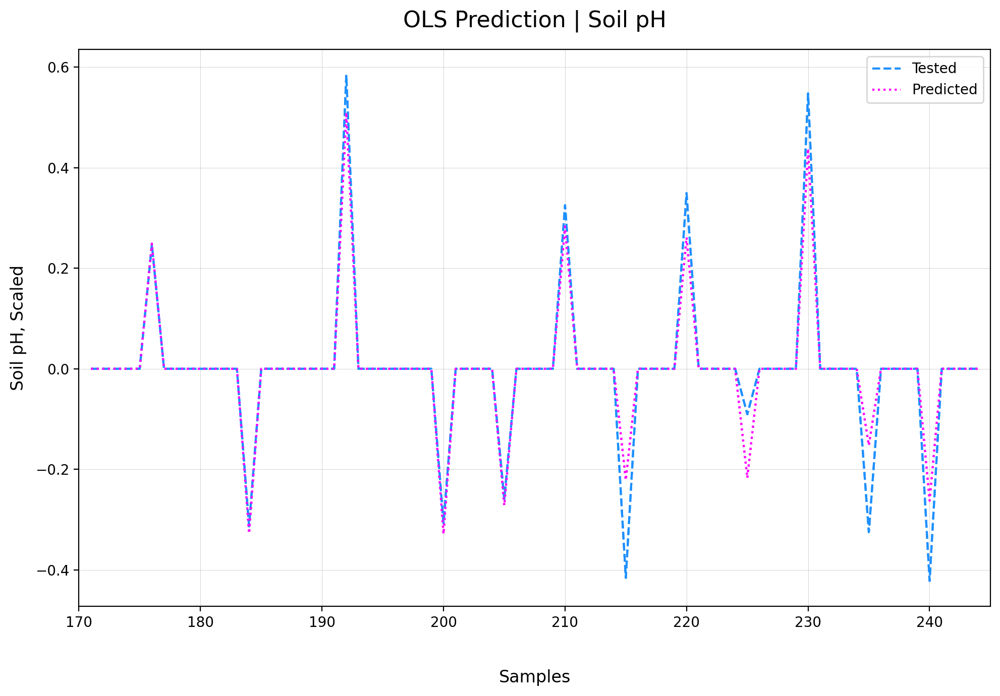

In [384]:
fig,ax=plt.subplots(1,1,figsize=(10,7))
#ax.plot(yt1,linestyle='solid', label='Trained',color='dodgerblue');
ax.plot(yt2,linestyle='dashed', label='Tested',color='dodgerblue');
ax.plot(yt3,linestyle='dotted', label='Predicted',color='magenta');

#ax.plot(yt4,linestyle='solid',color='dodgerblue')#, label='Trained');
ax.plot(yt5,linestyle='dashed',color='dodgerblue')#, label='Tested');
ax.plot(yt6,linestyle='dotted',color='magenta')#, label='Predicted');

#ax.plot(yt7,linestyle='solid',color='dodgerblue')#, label='Trained');
#ax.plot(yt8,linestyle='dashed',color='dodgerblue')#, label='Tested');
#ax.plot(yt9,linestyle='dotted',color='magenta')#, label='Predicted');

#ax.plot(yt10,linestyle='solid',color='dodgerblue')#, label='Trained');
#ax.plot(y11,linestyle='dashed',color='dodgerblue')#, label='Tested');
#ax.plot(yt12,linestyle='dotted',color='magenta')#, label='Predicted');

#ax.axvline(x=7,linestyle='dashed',color='red')
#ax.axvline(x=80,linestyle='dashed',color='red')
#ax.axvline(x=200,linestyle='dashed',color='red');
#plt.text(3,-1.2,'PB1\n\nRMSE: 0.4537',rotation=0,va='top',ha='center',linespacing=0.5,fontsize=8,color='red')
#plt.text(46,-0.98,'DH1\n\nRMSE: 0.1208',rotation=0,va='top',ha='center',linespacing=0.5,fontsize=8,color='red')
#plt.text(142,-0.98,'DH2\n\nRMSE: 0.0911',rotation=0,va='top',ha='center',linespacing=0.5,fontsize=8,color='red')
#plt.text(225,-0.98,'DH3\n\nRMSE: 0.0861',rotation=0,va='top',ha='center',linespacing=0.5,fontsize=8,color='red')
#ax.text(x=201, 0.99, 'PB1', color='r', ha='right', va='top', rotation=90)
ax.grid(linewidth=0.2)
ax.set_xlabel("Samples",labelpad=28, fontsize=12)
ax.set_ylabel("Soil pH, Scaled",labelpad=6, fontsize=12)
plt.title('OLS Prediction | Soil pH',pad=16,fontsize=16)
plt.legend(loc='upper right');
ax.set_xlim(170,245);
plt.tight_layout()
#plt.savefig('ols_soiltemp.png',dpi=1000)
#plt.savefig('ols_soilmoist.png',dpi=1000)
#plt.savefig('ols_soilph.png',dpi=1000)
plt.show()

In [1065]:
# y_train[np.sort(y_train.index)].plot(linestyle='solid', label='Soil pH, Observed');
# y_test[np.sort(y_test.index)].plot(linestyle='dotted', label='Soil pH, Observed')
# y_pred[np.sort(y_pred.index)].plot(linestyle='dotted', label='Soil pH, Predicted');
# plt.grid(linewidth=0.2)
# plt.legend(loc='best');

##### OLS Regression

In [ ]:
#[features[:][features.columns.values.tolist()[i]] for i in range(len(features.columns.values.tolist()))]#[i] for i in range(len(features.columns.values))]

In [ ]:
#f=features.columns.tolist()
#np.array(f)[np.where(np.array(f)=='dist')].tolist()
#[np.array(f)[np.where(np.array(f)!='dist')].tolist()]
#[f[i] for i in range(0,5)]
#[np.array(f)[np.where(np.array(f)==f[i])[0][0]] for i in range(0,5)]
#f[[np.where(np.array(f)==f[i])[0][0] for i in range(0,5)][0]]

In [ ]:
#features[:][np.array(f)[np.where(np.array(f)==f[i] for i in range(0,5))][0]]
#features[:][np.array(f)[np.where(np.array(f)!=f[i] for i in range(0,5))]].tolist()]

In [1133]:
features.columns.tolist()
print(OLS(features[:]['dep'], features[:][['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']]).exog_names)
print(OLS(features[:]['dep'], features[:][['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']]).endog_names)

['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']
dep


In [ ]:
#pd.DataFrame(min_max_scaler.inverse_transform(df))

In [ ]:
#pd.DataFrame(min_max_scaler2.inverse_transform(df2))

In [ ]:
dsss=df.reset_index().merge(df2.reset_index()).set_index(['loc'])[['dat', 'lon', 'lat', 'tem', 'wet', 'rh', 'bp', 'alt', 'stp', 'wsp', 'hin','dew', 'dal', 'wch', 'dis', 'dep', 'sot', 'som', 'sph', 'dt']]
dsss

In [ ]:
x3 = dsss[ds.columns.tolist()].values #returns a numpy array
min_max_scaler3 = preprocessing.MinMaxScaler()
x_scaled3 = min_max_scaler3.fit_transform(x3)
dsssc = pd.DataFrame(x_scaled3)

In [ ]:
x4 = dsss[features.columns.tolist()].values #returns a numpy array
min_max_scaler4 = preprocessing.MinMaxScaler()
x_scaled4 = min_max_scaler4.fit_transform(x4)
dsssc2 = pd.DataFrame(x_scaled4)

In [ ]:
newds=pd.DataFrame(min_max_scaler3.inverse_transform(ds));
newds.columns=ds.columns.tolist(); newds.index=ds.index.tolist()

In [ ]:
newds2=pd.DataFrame(min_max_scaler4.inverse_transform(features));
newds2.columns=features.columns.tolist(); newds2.index=features.index.tolist()
transformed=newds2

In [ ]:
del dsssc, dsssc2, newds2

In [ ]:
#Scaled Study-Level and Site-Level Baseline Dataset, OLS Regression (ds)

f=ds.columns.tolist()
#model = OLS(ds['Depth (cm)'], ds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(ds[np.array(f)[np.where(np.array(f)=='dat')][0]], ds[np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='lon')][0]], ds[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='lat')][0]], ds[np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='tem')][0]], ds[np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='wet')][0]], ds[np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='rh')][0]], ds[np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='bp')][0]], ds[np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='alt')][0]], ds[np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='stp')][0]], ds[np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='wsp')][0]], ds[np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='hin')][0]], ds[np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='dew')][0]], ds[np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='dal')][0]], ds[np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='wch')][0]], ds[np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='dis')][0]], ds[np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='dep')][0]], ds[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='sot')][0]], ds[np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='som')][0]], ds[np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(ds[np.array(f)[np.where(np.array(f)=='sph')][0]], ds[np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====0:15=====")

f=ds[:15].columns.tolist()
#model = OLS(ds['Depth (cm)'], ds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(ds[:15][np.array(f)[np.where(np.array(f)=='dat')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='lon')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='lat')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='tem')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='wet')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='rh')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='bp')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='alt')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='stp')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='wsp')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='hin')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='dew')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='dal')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='wch')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='dis')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='dep')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='sot')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='som')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(ds[:15][np.array(f)[np.where(np.array(f)=='sph')][0]], ds[:15][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====15:81=====")

f=ds[15:81].columns.tolist()
#model = OLS(ds['Depth (cm)'], ds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='dat')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='lon')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='lat')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='tem')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='wet')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='rh')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='bp')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='alt')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='stp')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='wsp')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='hin')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='dew')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='dal')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='wch')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='dis')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='dep')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='sot')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='som')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(ds[15:81][np.array(f)[np.where(np.array(f)=='sph')][0]], ds[15:81][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====81:201=====")

f=ds[81:201].columns.tolist()
#model = OLS(ds['Depth (cm)'], ds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='dat')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='lon')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='lat')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='tem')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='wet')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='rh')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='bp')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='alt')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='stp')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='wsp')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='hin')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='dew')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='dal')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='wch')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='dis')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='dep')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='sot')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='som')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(ds[81:201][np.array(f)[np.where(np.array(f)=='sph')][0]], ds[81:201][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====201:=====")

f=ds[201:].columns.tolist()
#model = OLS(ds['Depth (cm)'], ds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(ds[201:][np.array(f)[np.where(np.array(f)=='dat')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='lon')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='lat')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='tem')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='wet')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='rh')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='bp')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='alt')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='stp')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='wsp')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='hin')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='dew')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='dal')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='wch')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='dis')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='dep')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='sot')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='som')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(ds[201:][np.array(f)[np.where(np.array(f)=='sph')][0]], ds[201:][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

In [ ]:
#Scaled Study-Level and Site-Level VIF-Trimmed Dataset, OLS Regression (features)

f=features.columns.tolist()
#model = OLS(features['Depth (cm)'], features[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(features[np.array(f)[np.where(np.array(f)=='dat')][0]], features[np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='lon')][0]], features[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='rh')][0]], features[np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='wsp')][0]], features[np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='hin')][0]], features[np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='dis')][0]], features[np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='dep')][0]], features[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='sot')][0]], features[np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='som')][0]], features[np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(features[np.array(f)[np.where(np.array(f)=='sph')][0]], features[np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====0:15=====")

f=features[:15].columns.tolist()
#model = OLS(features['Depth (cm)'], features[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(features[:15][np.array(f)[np.where(np.array(f)=='dat')][0]], features[:15][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='lon')][0]], features[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='rh')][0]], features[:15][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='wsp')][0]], features[:15][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='hin')][0]], features[:15][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='dis')][0]], features[:15][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='dep')][0]], features[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='sot')][0]], features[:15][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='som')][0]], features[:15][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(features[:15][np.array(f)[np.where(np.array(f)=='sph')][0]], features[:15][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====15:81=====")

f=features[15:81].columns.tolist()
#model = OLS(features['Depth (cm)'], features[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(features[15:81][np.array(f)[np.where(np.array(f)=='dat')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='lon')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='rh')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='wsp')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='hin')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='dis')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='dep')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='sot')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='som')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(features[15:81][np.array(f)[np.where(np.array(f)=='sph')][0]], features[15:81][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====81:201=====")

f=features[81:201].columns.tolist()
#model = OLS(features['Depth (cm)'], features[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(features[81:201][np.array(f)[np.where(np.array(f)=='dat')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='lon')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='wsp')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='hin')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='dis')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='dep')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='sot')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='som')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(features[81:201][np.array(f)[np.where(np.array(f)=='sph')][0]], features[81:201][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====201:=====")

f=features[201:].columns.tolist()
#model = OLS(features['Depth (cm)'], features[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(features[201:][np.array(f)[np.where(np.array(f)=='dat')][0]], features[201:][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='lon')][0]], features[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='rh')][0]], features[201:][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='wsp')][0]], features[201:][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='hin')][0]], features[201:][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='dis')][0]], features[201:][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='dep')][0]], features[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='sot')][0]], features[201:][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='som')][0]], features[201:][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(features[201:][np.array(f)[np.where(np.array(f)=='sph')][0]], features[201:][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

In [ ]:
#Inverse-Transformed Study-Level and Site-Level Baseline Dataset, OLS Regression (newds(

f=newds.columns.tolist()
#model = OLS(newds['Depth (cm)'], newds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(newds[np.array(f)[np.where(np.array(f)=='dat')][0]], newds[np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='lon')][0]], newds[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='lat')][0]], newds[np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='tem')][0]], newds[np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='wet')][0]], newds[np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='rh')][0]], newds[np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='bp')][0]], newds[np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='alt')][0]], newds[np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='stp')][0]], newds[np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='wsp')][0]], newds[np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='hin')][0]], newds[np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='dew')][0]], newds[np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='dal')][0]], newds[np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='wch')][0]], newds[np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='dis')][0]], newds[np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='dep')][0]], newds[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='sot')][0]], newds[np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='som')][0]], newds[np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(newds[np.array(f)[np.where(np.array(f)=='sph')][0]], newds[np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====0:15=====")

f=newds[:15].columns.tolist()
#model = OLS(newds['Depth (cm)'], newds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(newds[:15][np.array(f)[np.where(np.array(f)=='dat')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='lon')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='lat')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='tem')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='wet')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='rh')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='bp')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='alt')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='stp')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='wsp')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='hin')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='dew')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='dal')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='wch')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='dis')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='dep')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='sot')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='som')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(newds[:15][np.array(f)[np.where(np.array(f)=='sph')][0]], newds[:15][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====15:81=====")

f=newds[15:81].columns.tolist()
#model = OLS(newds['Depth (cm)'], newds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='dat')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='lon')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='lat')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='tem')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='wet')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='rh')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='bp')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='alt')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='stp')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='wsp')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='hin')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='dew')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='dal')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='wch')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='dis')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='dep')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='sot')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='som')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(newds[15:81][np.array(f)[np.where(np.array(f)=='sph')][0]], newds[15:81][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====81:201=====")

f=newds[81:201].columns.tolist()
#model = OLS(newds['Depth (cm)'], newds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='dat')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='lon')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='lat')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='tem')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='wet')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='rh')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='bp')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='alt')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='stp')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='wsp')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='hin')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='dew')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='dal')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='wch')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='dis')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='dep')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='sot')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='som')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(newds[81:201][np.array(f)[np.where(np.array(f)=='sph')][0]], newds[81:201][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====201:=====")

f=newds[201:].columns.tolist()
#model = OLS(newds['Depth (cm)'], newds[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(newds[201:][np.array(f)[np.where(np.array(f)=='dat')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='lon')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='lat')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='lat')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='tem')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='tem')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='wet')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='wet')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='rh')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='bp')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='bp')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='alt')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='alt')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='stp')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='stp')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='wsp')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='hin')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='dew')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='dew')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='dal')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='dal')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='wch')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='wch')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='dis')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='dep')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='sot')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='som')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(newds[201:][np.array(f)[np.where(np.array(f)=='sph')][0]], newds[201:][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

In [ ]:
#Inverse-Transformed Study-Level and Site-Level VIF-Trimmed Dataset, OLS Regression (transformed)

f=transformed.columns.tolist()
#model = OLS(transformed['Depth (cm)'], transformed[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(transformed[np.array(f)[np.where(np.array(f)=='dat')][0]], transformed[np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='lon')][0]], transformed[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='rh')][0]], transformed[np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='wsp')][0]], transformed[np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='hin')][0]], transformed[np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='dis')][0]], transformed[np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='dep')][0]], transformed[np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='sot')][0]], transformed[np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='som')][0]], transformed[np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(transformed[np.array(f)[np.where(np.array(f)=='sph')][0]], transformed[np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====0:15=====")

f=transformed[:15].columns.tolist()
#model = OLS(transformed['Depth (cm)'], transformed[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='dat')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='lon')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='rh')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='wsp')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='hin')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='dis')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='dep')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='sot')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='som')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(transformed[:15][np.array(f)[np.where(np.array(f)=='sph')][0]], transformed[:15][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====15:81=====")

f=transformed[15:81].columns.tolist()
#model = OLS(transformed['Depth (cm)'], transformed[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='dat')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='lon')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='rh')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='wsp')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='hin')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='dis')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='dep')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='sot')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='som')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(transformed[15:81][np.array(f)[np.where(np.array(f)=='sph')][0]], transformed[15:81][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====81:201=====")

f=transformed[81:201].columns.tolist()
#model = OLS(transformed['Depth (cm)'], transformed[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='dat')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='lon')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='rh')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='wsp')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='hin')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='dis')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='dep')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='sot')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='som')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(transformed[81:201][np.array(f)[np.where(np.array(f)=='sph')][0]], transformed[81:201][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

print("=====201:=====")

f=transformed[201:].columns.tolist()
#model = OLS(transformed['Depth (cm)'], transformed[['Longitude','Distance from Pad (m)','Soil Temperature (C)','Soil Moisture (%)','Soil pH']])

for i in range(0,10):
    ols_arr=np.array([OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='dat')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='dat')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='lon')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='rh')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='rh')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='wsp')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='wsp')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='hin')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='hin')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='dis')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='dis')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='dep')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='dep')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='sot')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='sot')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='som')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='som')].tolist()]),
                      OLS(transformed[201:][np.array(f)[np.where(np.array(f)=='sph')][0]], transformed[201:][np.array(f)[np.where(np.array(f)!='sph')].tolist()])])
    print(ols_arr[i].fit().summary())

In [ ]:
# for i, j in features.iloc[31:].corr().iterrows():
#     print(i,j)

# for i in features.itertuples():
#     print(i)

In [ ]:
plt.style.use('default')
mpl.rcParams.update(mpl.rcParamsDefault)
%matplotlib inline
inline_rc = dict(mpl.rcParams)
plt.plot(range(10))

In [ ]:
#sns.heatmap(features.iloc[16:31].corr(), annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True),square=True, )
#sns.heatmap(features.corr(), annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True),square=True, )
#sns.heatmap(features.corr(), annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True),square=True, )

In [1143]:
# # Create a DataFrame to store correlation coefficients
# correlations = pd.DataFrame(index=['Pearson', 'Spearman', 'Kendall'], columns=['linear', 'quadratic', 'reciprocal', 'cubic'])

# # Calculate correlations for x and each distribution
# for col in correlations.columns:
#     pearson_corr, _ = pearsonr(features, eval(col[0]))
#     spearman_corr, _ = spearmanr(x, eval(col[0]))
#     kendall_corr, _ = kendalltau(x, eval(col[0]))

#     correlations.at['Pearson', col] = pearson_corr
#     correlations.at['Spearman', col] = spearman_corr
#     correlations.at['Kendall', col] = kendall_corr

# # Display the DataFrame
# print("Correlation Coefficients:")
# print(correlations)

In [1145]:
#[pearsonr(features.iloc[16:31][features.columns[1]],features.iloc[16:31][features.columns[4]])]

In [ ]:
#[16:31]: SM,PH (-0.898); ST,PH (+0.814); D,ST (-0.796)

#[5:16]: D,ST (-0.731); SM,PH (-0.620); DIS,ST (-0.586); D,SM (-0.522)

#[16:31]: D,ST (-0.777); D,SM (-0.692); DIS,ST (-0.612); SM,PH (-0.608)

#[31:]: D,ST (-0.798); SM,PH (-0.793); D,SM (-0.770);

#>>> SM PH 4 (-0.898--0.608)
#>>> ST PH 1 (0.814)*
#####################>>> D ST 4 (-0.798--0.731)
#>>> DIS ST 2 (-0.612--0.586)
####################>>> D SM 3 (-0.770--0.522)

#========

################ D SM (-0.551)
################ D ST (-0.682)
# SM PH (-0.671)

In [ ]:
###### PLOT DEPTH V. ST, DEPTH V. SM,    DIST V. ST, ST V. PH, SM V. PH

In [ ]:
features.columns

In [ ]:
[pearsonr(features.iloc[16:31][features.columns[0]],features.iloc[16:31][features.columns[2]])]

In [ ]:
for x in result.columns:
    result[x+"_Val"] = corr.lookup(corr.index, result[x])
print(result)

In [ ]:
old

In [ ]:
new

In [ ]:
arr=np.array(list(results.items()), dtype=object)

#### Granger Causality 

In [475]:
#grangercausalitytests(zf[[newfeatures.columns.tolist()[i],newfeatures.columns.tolist()[j+1]],maxlag=1)

In [388]:
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False,maxlag=1):
    """Check Granger Causality of all possible combinations of the Time series.
    The rows are the response variable, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

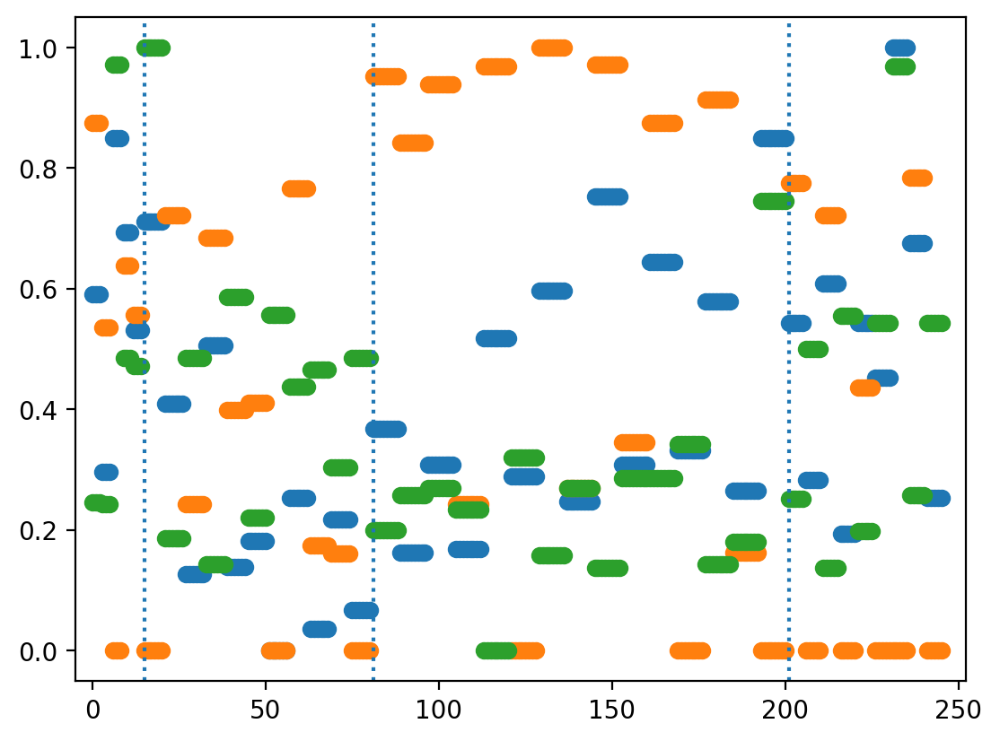

In [389]:
plt.scatter(newfeatures3.index,newfeatures3['sot']);
plt.scatter(newfeatures3.index,newfeatures3['som']);
plt.scatter(newfeatures3.index,newfeatures3['sph']);
#plt.plot(newfeatures['som']);
#plt.plot(newfeatures['sph']);
#plt.axvline(x=0,linestyle='dotted')
plt.axvline(x=15,linestyle='dotted')
plt.axvline(x=81,linestyle='dotted')
plt.axvline(x=201,linestyle='dotted');
plt.xlim(-5,252);

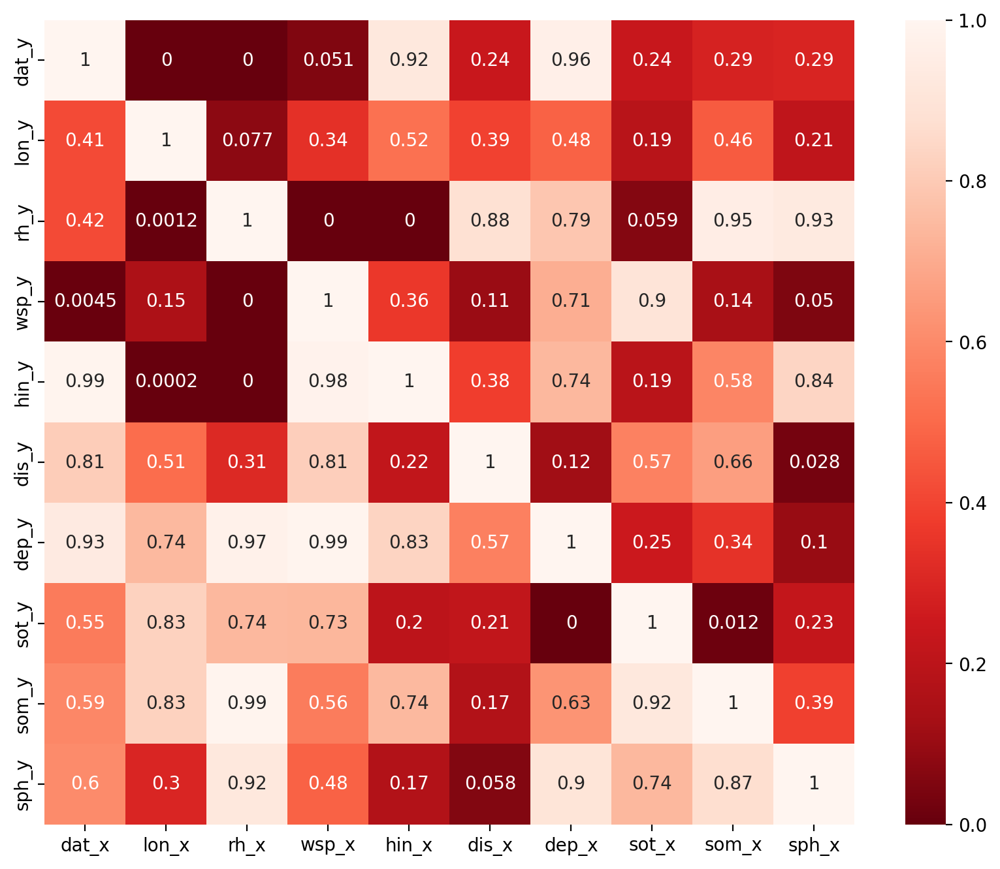

In [390]:
plt.subplots(1,1,figsize=(10,8))
sns.heatmap(grangers_causation_matrix(newfeatures3,newfeatures3.columns.tolist()),annot=True,cmap='Reds_r');

In [393]:
print(newfeatures3.columns.tolist())
print(newfeatures3.columns.tolist())

['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']
['dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']


In [391]:
np.where(grangers_causation_matrix(newfeatures3,newfeatures3.columns.tolist())<0.05)

(array([0, 0, 2, 2, 2, 3, 3, 3, 4, 4, 5, 7, 7]),
 array([1, 2, 1, 3, 4, 0, 2, 9, 1, 2, 9, 6, 8]))

In [459]:
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False,maxlag=1):    
    """Check Granger Causality of all possible combinations of the Time series.
    The rows are the response variable, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

In [460]:
grangers_causation_matrix(newfeatures3, variables = newfeatures3.columns)
#datx granger causes wsp_y
#lonx granger causes hin_y
#rh granger causes dat_y
#rh granger causes wsp_y
#rh granger causes hin_y
#wsp_x granger causes rh_y
#wsp_x granger causes hin_y
#hin_x granger causes wsp_y
#hin_x granger causes rh_y

#dep_x granger causes sot_y
#dep_x granger causes som_y
#som_x granger causes dep_y
#sph_x granger causes dis_y
#sph_x granger causes som_y

,dat_x,lon_x,rh_x,wsp_x,hin_x,dis_x,dep_x,sot_x,som_x,sph_x
dat_y,1.0000,0.0000,0.0000,0.0512,0.9191,0.2415,0.9621,0.2352,0.2854,0.2942
lon_y,0.4148,1.0000,0.0775,0.3393,0.5198,0.3941,0.4783,0.1877,0.4588,0.2127
rh_y,0.4156,0.0012,1.0000,0.0000,0.0000,0.8768,0.7854,0.0591,0.9498,0.9312
wsp_y,0.0045,0.1550,0.0000,1.0000,0.3630,0.1052,0.7101,0.8968,0.1404,0.0495
hin_y,0.9894,0.0002,0.0000,0.9835,1.0000,0.3794,0.7395,0.1934,0.5848,0.8364
dis_y,0.8118,0.5112,0.3105,0.8137,0.2158,1.0000,0.1206,0.5713,0.6608,0.0281
dep_y,0.9342,0.7446,0.9738,0.9920,0.8337,0.5672,1.0000,0.2528,0.3421,0.1007
sot_y,0.5509,0.8256,0.7416,0.7344,0.2021,0.2150,0.0000,1.0000,0.0119,0.2252
som_y,0.5912,0.8280,0.9910,0.5585,0.7442,0.1689,0.6325,0.9205,1.0000,0.3889
sph_y,0.6025,0.2972,0.9195,0.4802,0.1689,0.0580,0.9013,0.7403,0.8707,1.0000


In [461]:
r0=grangercausalitytests(newfeatures3[['dis','dep']],maxlag=1)
r1=grangercausalitytests(newfeatures3[['dis','sot']],maxlag=1)
r2=grangercausalitytests(newfeatures3[['dis','som']],maxlag=1)
r3=grangercausalitytests(newfeatures3[['dis','sph']],maxlag=1) #
r4=grangercausalitytests(newfeatures3[['dep','dis']],maxlag=1)
r5=grangercausalitytests(newfeatures3[['dep','sot']],maxlag=1)
r6=grangercausalitytests(newfeatures3[['dep','som']],maxlag=1)
r7=grangercausalitytests(newfeatures3[['dep','sph']],maxlag=1)
r8=grangercausalitytests(newfeatures3[['sot','dis']],maxlag=1)
r9=grangercausalitytests(newfeatures3[['sot','dep']],maxlag=1) #
r10=grangercausalitytests(newfeatures3[['sot','som']],maxlag=1) #
r11=grangercausalitytests(newfeatures3[['sot','sph']],maxlag=1)
r12=grangercausalitytests(newfeatures3[['som','dis']],maxlag=1)
r13=grangercausalitytests(newfeatures3[['som','dep']],maxlag=1)
r14=grangercausalitytests(newfeatures3[['som','sot']],maxlag=1)
r15=grangercausalitytests(newfeatures3[['som','sph']],maxlag=1)
r16=grangercausalitytests(newfeatures3[['sph','dis']],maxlag=1) #
r17=grangercausalitytests(newfeatures3[['sph','dep']],maxlag=1)
r18=grangercausalitytests(newfeatures3[['sph','sot']],maxlag=1)
r19=grangercausalitytests(newfeatures3[['sph','som']],maxlag=1)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=2.3801  , p=0.1242  , df_denom=242, df_num=1
ssr based chi2 test:   chi2=2.4096  , p=0.1206  , df=1
likelihood ratio test: chi2=2.3978  , p=0.1215  , df=1
parameter F test:         F=2.3801  , p=0.1242  , df_denom=242, df_num=1

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.3166  , p=0.5742  , df_denom=242, df_num=1
ssr based chi2 test:   chi2=0.3205  , p=0.5713  , df=1
likelihood ratio test: chi2=0.3203  , p=0.5714  , df=1
parameter F test:         F=0.3166  , p=0.5742  , df_denom=242, df_num=1

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.1903  , p=0.6631  , df_denom=242, df_num=1
ssr based chi2 test:   chi2=0.1926  , p=0.6608  , df=1
likelihood ratio test: chi2=0.1925  , p=0.6608  , df=1
parameter F test:         F=0.1903  , p=0.6631  , df_denom=242, df_num=1

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=4.7658  , p=0.0300  

In [462]:
def interpret_results(result):
    for key in result:
        test_statistic = result[key][0]['ssr_chi2test'][0]
        p_value = result[key][0]['ssr_chi2test'][1]
        print(f'Lag {key}: Test Statistic = {test_statistic}, p-value = {p_value}')

print("Results for time_series_1 causing time_series_2:") #dis causing ph
interpret_results(r3)
print("Results for time_series_1 causing time_series_2:") #sot causing dep
interpret_results(r9)
print("Results for time_series_1 causing time_series_2:") #sot causing som
interpret_results(r10)
#print("Results for time_series_1 causing time_series_2:") #sph causing dis
#interpret_results(r16)

Results for time_series_1 causing time_series_2:
Lag 1: Test Statistic = 4.824910055091159, p-value = 0.02805132874969569
Results for time_series_1 causing time_series_2:
Lag 1: Test Statistic = 17.81705888351787, p-value = 2.431930873582917e-05
Results for time_series_1 causing time_series_2:
Lag 1: Test Statistic = 6.324816941350119, p-value = 0.011905977686743344


In [ ]:
# def interpret_results(result):
#     for key in result:
#         test_statistic = result[key][0]['ssr_chi2test'][1]
#         p_value = result[key][0]['ssr_chi2test'][0]
#         print(f'Lag {key}: Test Statistic = {test_statistic}, p-value = {p_value}')

# print("Results for time_series_2 causing time_series_1:") #ph causing dis
# interpret_results(r3)
# print("Results for time_series_2 causing time_series_1:") #dep causing sot
# interpret_results(r9)
# print("Results for time_series_2 causing time_series_1:") #som causing sot
# interpret_results(r10)
# print("Results for time_series_2 causing time_series_1:") #dis causing sph
# interpret_results(r16)

#### VAR Analysis

##### Preliminary VAR Overview

In [517]:
data=newfeatures3
msk = np.random.rand(len(data)) < 0.8
train = data[msk]
test = data[~msk]

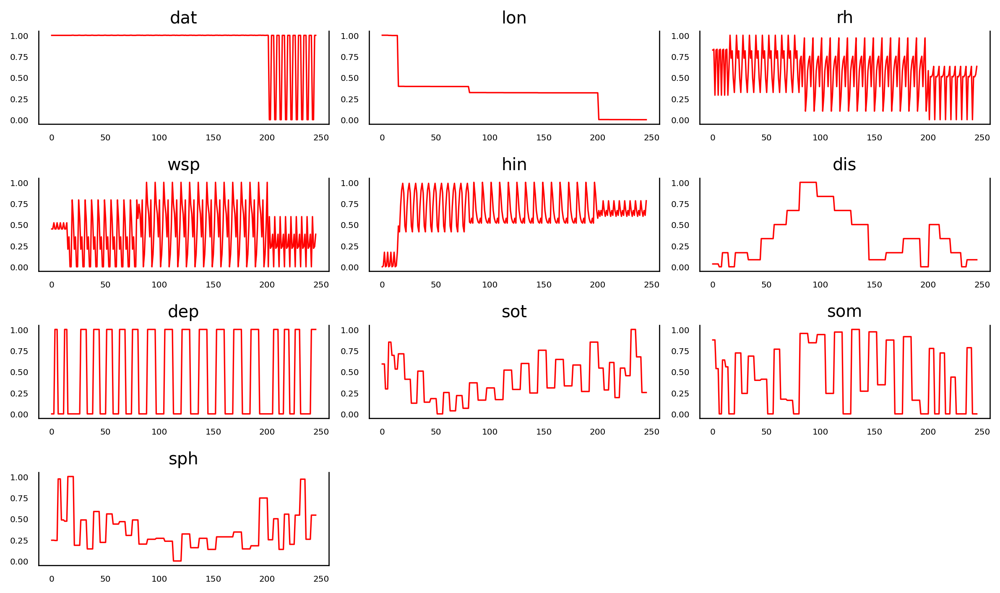

In [520]:
fig, axes = plt.subplots(nrows=4, ncols=3, dpi=120, figsize=(10,6))
num_columns = len(newfeatures3.columns)
for i, ax in enumerate(axes.flatten()):
    if i < num_columns:
        data = newfeatures3[newfeatures3.columns[i]]
        ax.plot(data.values, color='red', linewidth=1)
        ax.set_title(newfeatures3.columns[i])
        ax.xaxis.set_ticks_position('none')
        ax.yaxis.set_ticks_position('none')
        ax.spines["top"].set_alpha(0)
        ax.tick_params(labelsize=6)
    else:
        ax.axis('off')

plt.tight_layout();

In [518]:
train

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
0,9.984597e-01,1.000000,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
2,9.984600e-01,1.000000,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
3,9.984597e-01,1.000000,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
4,9.984597e-01,1.000000,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
6,9.984597e-01,0.998133,0.824885,0.447917,0.000000,0.000000,0.0,0.849910,0.000000,0.971429
...,...,...,...,...,...,...,...,...,...,...
241,9.984600e-01,0.000000,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
242,7.702889e-09,0.000000,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
243,0.000000e+00,0.000000,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
244,9.984598e-01,0.000000,0.534562,0.239583,0.609195,0.083333,1.0,0.253165,0.000000,0.542857


In [519]:
model = VAR(train)
model_fitted = model.fit(1)
lag_order = model_fitted.k_ar
print(lag_order)
print(model_fitted.aic)
print(model_fitted.bic)
print(model_fitted.fpe)
print(model_fitted.hqic)

1
-39.97445320010346
-38.1148888437328
4.363677514217563e-18
-39.22138939425742


In [430]:
#newfeatures3.loc[:2]

In [431]:
#newfeatures3.loc[3]

##### Statistics | Durbin-Watson, ADF, KPSS

In [748]:
from statsmodels.stats.stattools import durbin_watson
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import grangercausalitytests, adfuller
from tqdm import tqdm_notebook
import statsmodels.tsa.stattools as ts
from itertools import product
import statsmodels.api as sm

import warnings
warnings.filterwarnings('ignore')

data=newfeatures3
out = durbin_watson(model_fitted.resid)
for col, val in zip(data.columns, out):
    print(col, ':', round(val, 2))

dat : 1.94
lon : 2.02
rh : 2.0
wsp : 2.17
hin : 2.23
dis : 2.03
dep : 1.74
sot : 1.81
som : 1.79
sph : 1.81


In [749]:
result=ts.coint(data['som'], data['sph'])
print(result)

(-3.58646636887991, 0.02546211781831229, array([-3.94170018, -3.36118285, -3.06180633]))


In [ ]:
# from statsmodels.tsa.stattools import grangercausalitytests
# maxlag=65 #becuase we got this value before. We are not suppose to add 1 to it
# test = 'ssr_chi2test'
# def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
#     """Check Granger Causality of all possible combinations of the Time series.
#     The rows are the response variable, columns are predictors. The values in the table 
#     are the P-Values. P-Values lesser than the significance level (0.05), implies 
#     the Null Hypothesis that the coefficients of the corresponding past values is 
#     zero, that is, the X does not cause Y can be rejected.

#     data      : pandas dataframe containing the time series variables
#     variables : list containing names of the time series variables.
#     """
#     df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
#     for c in df.columns:
#         for r in df.index:
#             test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
#             p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
#             if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
#             min_p_value = np.min(p_values)
#             df.loc[r, c] = min_p_value
#     df.columns = [var + '_x' for var in variables]
#     df.index = [var + '_y' for var in variables]
#     return df

# o = grangers_causation_matrix(train_df, variables = train_df.columns)

In [750]:
## ADF Null hypothesis: there is a unit root, meaning series is non-stationary
from statsmodels.tsa.stattools import adfuller

X1 = np.array(data['dat'])
X1 = X1[~np.isnan(X1)]

result = adfuller(X1)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
    
X2 = np.array(data['lon'])
X2 = X2[~np.isnan(X2)]

result = adfuller(X2)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

X3 = np.array(data['rh'])
X3 = X3[~np.isnan(X3)]

result = adfuller(X3)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
    
X4 = np.array(data['wsp'])
X4 = X4[~np.isnan(X4)]

result = adfuller(X4)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

X5 = np.array(data['hin'])
X5 = X5[~np.isnan(X5)]

result = adfuller(X5)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
    
X6 = np.array(data['dis'])
X6 = X6[~np.isnan(X6)]

result = adfuller(X6)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

X7 = np.array(data['dep'])
X7 = X7[~np.isnan(X7)]

result = adfuller(X7)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
    
X8 = np.array(data['sot'])
X8 = X8[~np.isnan(X8)]

result = adfuller(X8)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

X9 = np.array(data['som'])
X9 = X9[~np.isnan(X9)]

result = adfuller(X9)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))
    
X10 = np.array(data['sph'])
X10 = X10[~np.isnan(X10)]

result = adfuller(X10)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

ADF Statistic: -0.517489
p-value: 0.888558
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.573
ADF Statistic: -2.785339
p-value: 0.060399
Critical Values:
	1%: -3.457
	5%: -2.873
	10%: -2.573
ADF Statistic: -1.056876
p-value: 0.731959
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.574
ADF Statistic: -1.830105
p-value: 0.365621
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.573
ADF Statistic: -10.411937
p-value: 0.000000
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.574
ADF Statistic: -1.796209
p-value: 0.382345
Critical Values:
	1%: -3.457
	5%: -2.873
	10%: -2.573
ADF Statistic: -4.230780
p-value: 0.000584
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.574
ADF Statistic: -2.015756
p-value: 0.279708
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.574
ADF Statistic: -2.670244
p-value: 0.079330
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.574
ADF Statistic: -3.282521
p-value: 0.015678
Critical Values:
	1%: -3.459
	5%: -2.874
	10%: -2.573


In [751]:
## KPSS Null hypothesis: there is a no unit root, meaning series is stationary
from statsmodels.tsa.stattools import kpss
def kpss_test(series, **kw):    
    statistic, p_value, n_lags, critical_values = kpss(series, **kw)
    # Format Output
    print(f'KPSS Statistic: {statistic}')
    print(f'p-value: {p_value}')
    print(f'num lags: {n_lags}')
    print('Critial Values:')
    for key, value in critical_values.items():
        print(f'   {key} : {value}')
    print(f'Result: The series is {"not " if p_value < 0.05 else ""}stationary')

kpss_test(X1)
kpss_test(X2)
kpss_test(X3)
kpss_test(X4)
kpss_test(X5)
kpss_test(X6)
kpss_test(X7)
kpss_test(X8)
kpss_test(X9)
kpss_test(X10)

KPSS Statistic: 2.941643145527592
p-value: 0.01
num lags: 1
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is not stationary
KPSS Statistic: 1.4815316639019904
p-value: 0.01
num lags: 10
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is not stationary
KPSS Statistic: 1.7961864353256398
p-value: 0.01
num lags: 9
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is not stationary
KPSS Statistic: 0.5084743632968188
p-value: 0.039758026284500265
num lags: 7
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is not stationary
KPSS Statistic: 0.4122789976091728
p-value: 0.07186250103052896
num lags: 6
Critial Values:
   10% : 0.347
   5% : 0.463
   2.5% : 0.574
   1% : 0.739
Result: The series is stationary
KPSS Statistic: 0.4367951767124458
p-value: 0.061295182451532
num lags: 10
Critial Values:
   10% : 0.347
  

##### Lag Order (VAR, VARMax)

In [623]:
train

,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
0,9.984597e-01,1.000000,0.824885,0.447917,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
2,9.984600e-01,1.000000,0.290323,0.520833,0.172414,0.033333,0.0,0.590717,0.875622,0.245714
3,9.984597e-01,1.000000,0.824885,0.447917,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
4,9.984597e-01,1.000000,0.834101,0.447917,0.011494,0.033333,1.0,0.295359,0.536070,0.242857
6,9.984597e-01,0.998133,0.824885,0.447917,0.000000,0.000000,0.0,0.849910,0.000000,0.971429
...,...,...,...,...,...,...,...,...,...,...
241,9.984600e-01,0.000000,0.000000,0.000000,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
242,7.702889e-09,0.000000,0.511521,0.593750,0.597701,0.083333,1.0,0.253165,0.000000,0.542857
243,0.000000e+00,0.000000,0.506912,0.218750,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
244,9.984598e-01,0.000000,0.534562,0.239583,0.609195,0.083333,1.0,0.253165,0.000000,0.542857


In [626]:
train.shape, test.shape

((194, 10), (52, 10))

In [590]:
#train_df=ds2.loc[0:2]; test_df=ds2.loc[3];

In [628]:
# corr_matrix = train.corr()
# print(corr_matrix)

In [629]:
# vif_data = pd.DataFrame()
# vif_data["feature"] = train.columns
# vif_data["VIF"] = [variance_inflation_factor(train.values, i) for i in range(len(train.columns))]
# print(vif_data)

In [630]:
# print(train.var())

In [645]:
d=train[['sot','som','sph']]
exog=train[train.columns.tolist()[:-3]]

In [646]:
d

,sot,som,sph
0,0.590717,0.875622,0.245714
2,0.590717,0.875622,0.245714
3,0.295359,0.536070,0.242857
4,0.295359,0.536070,0.242857
6,0.849910,0.000000,0.971429
...,...,...,...
241,0.253165,0.000000,0.542857
242,0.253165,0.000000,0.542857
243,0.253165,0.000000,0.542857
244,0.253165,0.000000,0.542857


In [647]:
exog

,dat,lon,rh,wsp,hin,dis,dep
0,9.984597e-01,1.000000,0.824885,0.447917,0.000000,0.033333,0.0
2,9.984600e-01,1.000000,0.290323,0.520833,0.172414,0.033333,0.0
3,9.984597e-01,1.000000,0.824885,0.447917,0.000000,0.033333,1.0
4,9.984597e-01,1.000000,0.834101,0.447917,0.011494,0.033333,1.0
6,9.984597e-01,0.998133,0.824885,0.447917,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...
241,9.984600e-01,0.000000,0.000000,0.000000,0.666667,0.083333,1.0
242,7.702889e-09,0.000000,0.511521,0.593750,0.597701,0.083333,1.0
243,0.000000e+00,0.000000,0.506912,0.218750,0.666667,0.083333,1.0
244,9.984598e-01,0.000000,0.534562,0.239583,0.609195,0.083333,1.0


In [684]:
model=VAR(d)
var_model=model.fit(16)
print(var_result.summary())

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 27, Sep, 2024
Time:                     18:08:20
--------------------------------------------------------------------
No. of Equations:         10.0000    BIC:                   -27.5569
Nobs:                     178.000    HQIC:                  -44.6652
Log likelihood:           4098.19    FPE:                4.72928e-20
AIC:                     -56.3359    Det(Omega_mle):     7.53352e-23
--------------------------------------------------------------------
Results for equation dat
             coefficient       std. error           t-stat            prob
--------------------------------------------------------------------------
const           3.072958         1.705900            1.801           0.072
L1.dat         -0.215676         0.198715           -1.085           0.278
L1.lon         -3.298104         1.925948           -1.712           0.087
L1.rh      

In [856]:
# ls=[]
# for i in range(0,65):
#     result = model.fit(i)
#     ls=np.append(ls,result)

In [685]:
# Forecasting with the VAR model
forecast_input = train[train.columns.tolist()].values[-16:]  # Last 16 rows, only the first 7 columns (exogenous variables)
forecast = var_result.forecast(y=forecast_input, steps=10)
forecast_df = pd.DataFrame(forecast, index=pd.Index(range(200, 210), name='index'), columns=train.columns)

In [686]:
print(forecast_df)

            dat       lon        rh       wsp       hin       dis       dep  \
index                                                                         
200   -0.928485 -0.032094  0.942682  0.646009 -0.620605 -0.003793 -1.195597   
201   -0.168286 -0.125589  2.083177 -2.278372  2.461879  0.321778 -0.685452   
202    3.217149 -0.105220 -0.858706 -0.253020  1.127849  0.504337  0.048239   
203    0.425103  0.037905 -0.368798  0.836425  1.128970  0.490735  0.295773   
204   -0.065350  0.095792  1.094636  1.316249  1.099639  0.485836  1.094717   
205    0.879881 -0.026280 -1.148975  0.743607 -0.460938  0.571190  2.953903   
206    0.060593 -0.014662  0.681579  1.327384 -0.343858  0.310886  3.056701   
207   -0.162589 -0.210500  2.654823  1.347142  1.219073  0.345426  2.421146   
208    0.676130 -0.421854 -1.164974 -0.660023  1.338554  0.457849  0.017671   
209    0.741771 -0.344121 -0.016190  0.262546  0.191155  0.454640 -0.501980   

            sot       som       sph  
index        

In [716]:
out = durbin_watson(var_model.resid)
for col, val in zip(d.columns, out):
    print(col, ':', round(val, 2))

sot : 2.04
som : 2.05
sph : 1.99


In [717]:
out = durbin_watson(var_model.resid)
for col, val in zip(exog.columns, out):
    print(col, ':', round(val, 2))

dat : 2.04
lon : 2.05
rh : 1.99


In [687]:
# Fit the VARMAX model
model_varmax = VARMAX(d, exog=exog, order=(16, 1))  # (p, q) order
varmax_result = model_varmax.fit(disp=False)

In [718]:
print(varmax_result.summary())

                             Statespace Model Results                            
Dep. Variable:     ['sot', 'som', 'sph']   No. Observations:                  194
Model:                      VARMAX(16,1)   Log Likelihood                 548.034
                             + intercept   AIC                           -730.067
Date:                   Fri, 27 Sep 2024   BIC                           -132.049
Time:                           18:20:17   HQIC                          -487.913
Sample:                                0                                         
                                   - 194                                         
Covariance Type:                     opg                                         
Ljung-Box (L1) (Q):      19.89, 0.69, 0.36   Jarque-Bera (JB):   12.60, 34.23, 130.41
Prob(Q):                  0.00, 0.41, 0.55   Prob(JB):               0.00, 0.00, 0.00
Heteroskedasticity (H):   0.88, 1.19, 0.52   Skew:                  0.45, -0.30, 0.01
Prob

In [707]:
# Forecasting
forecast_exog = train[train.columns.tolist()[:-3]].values[-10:]  # Last 16 rows, only the first 7 columns (exogenous variables)
forecast_varmax = varmax_result.forecast(steps=10, exog=forecast_exog)
forecast_varmax_df = pd.DataFrame(forecast_varmax, index=pd.Index(range(200, 204), name='index'), columns=d.columns)
print(forecast_varmax_df)

            sot       som       sph
index                              
200    0.300395 -0.079892  0.406427
201    0.268467 -0.141205  0.461957
202    0.317346 -0.121226  0.523043
203    0.296786 -0.115485  0.385772


In [720]:
out = durbin_watson(varmax_result.resid)
for col, val in zip(d.columns, out):
    print(col, ':', round(val, 2))

sot : 1.34
som : 1.87
sph : 1.87


In [721]:
out = durbin_watson(varmax_result.resid)
for col, val in zip(exog.columns, out):
    print(col, ':', round(val, 2))

dat : 1.34
lon : 1.87
rh : 1.87


In [724]:
print("VAR Forecast:")
forecast_df

VAR Forecast:


,dat,lon,rh,wsp,hin,dis,dep,sot,som,sph
index,,,,,,,,,,
200,-0.928485,-0.032094,0.942682,0.646009,-0.620605,-0.003793,-1.195597,1.121070,0.736058,0.774539
201,-0.168286,-0.125589,2.083177,-2.278372,2.461879,0.321778,-0.685452,0.827037,-0.769774,0.806834
202,3.217149,-0.105220,-0.858706,-0.253020,1.127849,0.504337,0.048239,0.790570,-1.023984,0.625352
203,0.425103,0.037905,-0.368798,0.836425,1.128970,0.490735,0.295773,0.660773,-0.958585,0.925137
204,-0.065350,0.095792,1.094636,1.316249,1.099639,0.485836,1.094717,0.423372,-2.987123,0.849469
205,0.879881,-0.026280,-1.148975,0.743607,-0.460938,0.571190,2.953903,-0.092754,-0.823710,0.071994
206,0.060593,-0.014662,0.681579,1.327384,-0.343858,0.310886,3.056701,0.019126,-0.559118,0.300143
207,-0.162589,-0.210500,2.654823,1.347142,1.219073,0.345426,2.421146,0.072745,-0.797255,0.501963
208,0.676130,-0.421854,-1.164974,-0.660023,1.338554,0.457849,0.017671,1.056142,2.294309,-0.095673


In [725]:
print("\nVARMAX Forecast:")
forecast_varmax_df


VARMAX Forecast:


,sot,som,sph
index,,,
200,0.300395,-0.079892,0.406427
201,0.268467,-0.141205,0.461957
202,0.317346,-0.121226,0.523043
203,0.296786,-0.115485,0.385772


In [723]:
#print(var_result.summary())

In [911]:
train_df=newfeatures.loc[1:2]; valid_df=newfeatures.loc[0]; test_df=newfeatures.loc[3];

In [972]:
model=VAR(newfeatures)

In [991]:
#model.endog.shape

In [975]:
var_model=model.fit(8)

In [1013]:
#plt.plot(result.params.sot.values.tolist())

In [990]:
#var_model.summary()

##### Granger Causation Matrix

In [741]:
def granger_causation_matrix(data, variables, p, test = 'ssr_chi2test', verbose=False):    
    """Check Granger Causality of all possible combinations of the time series.
    The rows are the response variables, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], p, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],7) for i in range(p)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

In [ ]:
#granger_causation_matrix(train_df, train_df.columns, 16)

In [742]:
var_model.info_criteria

{'aic': -11.849106743085345,
 'bic': -9.221454035821658,
 'hqic': -10.783523048418813,
 'fpe': 7.464297053963187e-06}

In [743]:
granger_causation_matrix(newfeatures3, newfeatures3.columns, 14)

,dat_x,lon_x,rh_x,wsp_x,hin_x,dis_x,dep_x,sot_x,som_x,sph_x
dat_y,9.999999e-01,0.000000,0.000000,0.000000,0.003727,0.000000,0.272628,0.003299,0.083103,2.030000e-05
lon_y,0.000000e+00,1.000000,0.000000,0.339339,0.000000,0.166525,0.079203,0.000006,0.115018,0.000000e+00
rh_y,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000552,0.386209,0.034525,0.256961,3.110731e-01
wsp_y,0.000000e+00,0.000000,0.000000,1.000000,0.000000,0.019700,0.050383,0.000530,0.140425,1.236000e-04
hin_y,2.000000e-07,0.000000,0.000000,0.000000,1.000000,0.161338,0.711538,0.119555,0.337803,1.629800e-03
dis_y,1.814467e-01,0.503200,0.002622,0.131753,0.162049,1.000000,0.000043,0.000120,0.010338,2.805130e-02
dep_y,3.536970e-02,0.000001,0.973842,0.481632,0.012197,0.001365,1.000000,0.000227,0.000000,0.000000e+00
sot_y,1.031316e-01,0.232078,0.700087,0.734389,0.136636,0.215005,0.000000,1.000000,0.000000,0.000000e+00
som_y,6.657610e-02,0.128916,0.973817,0.136629,0.697096,0.017437,0.000002,0.040343,1.000000,7.000000e-07
sph_y,5.329599e-01,0.000024,0.859775,0.285570,0.026634,0.058015,0.046797,0.217795,0.805032,1.000000e+00


In [744]:
print(grangercausalitytests(newfeatures3[['sph','som']],14))#[1][0]['ssr_chi2test'][1])


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.0262  , p=0.8717  , df_denom=242, df_num=1
ssr based chi2 test:   chi2=0.0265  , p=0.8707  , df=1
likelihood ratio test: chi2=0.0265  , p=0.8707  , df=1
parameter F test:         F=0.0262  , p=0.8717  , df_denom=242, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.0388  , p=0.9619  , df_denom=239, df_num=2
ssr based chi2 test:   chi2=0.0793  , p=0.9611  , df=2
likelihood ratio test: chi2=0.0793  , p=0.9611  , df=2
parameter F test:         F=0.0388  , p=0.9619  , df_denom=239, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.0595  , p=0.9809  , df_denom=236, df_num=3
ssr based chi2 test:   chi2=0.1839  , p=0.9801  , df=3
likelihood ratio test: chi2=0.1839  , p=0.9802  , df=3
parameter F test:         F=0.0595  , p=0.9809  , df_denom=236, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=0.3902  , p=0.8156  

##### VAR (AIC) and Granger Causality Test

In [769]:
from statsmodels.tsa.api import VAR

# Fit the VAR model
model = VAR(newfeatures3)
results = model.fit(maxlags=1, ic='aic')
print(results.summary())

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 27, Sep, 2024
Time:                     18:48:21
--------------------------------------------------------------------
No. of Equations:         10.0000    BIC:                   -40.4815
Nobs:                     245.000    HQIC:                  -41.4205
Log likelihood:           1785.16    FPE:                5.45327e-19
AIC:                     -42.0535    Det(Omega_mle):     3.51494e-19
--------------------------------------------------------------------
Results for equation dat
            coefficient       std. error           t-stat            prob
-------------------------------------------------------------------------
const          0.077259         0.127983            0.604           0.546
L1.dat         0.282753         0.058506            4.833           0.000
L1.lon         0.424853         0.083019            5.118           0.000
L1.rh          0

In [770]:
print(results.test_causality('dis',['sot'],kind='f').summary())
print(results.test_causality('dis',['som'],kind='f').summary())
print(results.test_causality('dis',['sph'],kind='f').summary())

Granger causality F-test. H_0: sot does not Granger-cause dis. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
        0.8973          3.845   0.344 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: som does not Granger-cause dis. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
       0.02812          3.845   0.867 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: sph does not Granger-cause dis. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
         3.450          3.845   0.063 (1, 2340)
-----------------------------------------------


In [771]:
print(results.test_causality('sot',['dis'],kind='f').summary())
print(results.test_causality('sot',['som'],kind='f').summary())
print(results.test_causality('sot',['sph'],kind='f').summary())

Granger causality F-test. H_0: dis does not Granger-cause sot. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
        0.1157          3.845   0.734 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: som does not Granger-cause sot. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
        0.4519          3.845   0.501 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: sph does not Granger-cause sot. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
        0.3972          3.845   0.529 (1, 2340)
-----------------------------------------------


In [772]:
print(results.test_causality('som',['dis'],kind='f').summary())
print(results.test_causality('som',['sot'],kind='f').summary())
print(results.test_causality('som',['sph'],kind='f').summary())

Granger causality F-test. H_0: dis does not Granger-cause som. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
         2.880          3.845   0.090 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: sot does not Granger-cause som. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
        0.9727          3.845   0.324 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: sph does not Granger-cause som. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
         1.394          3.845   0.238 (1, 2340)
-----------------------------------------------


In [773]:
print(results.test_causality('sph',['dis'],kind='f').summary())
print(results.test_causality('sph',['sot'],kind='f').summary())
print(results.test_causality('sph',['som'],kind='f').summary())

Granger causality F-test. H_0: dis does not Granger-cause sph. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
         2.329          3.845   0.127 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: sot does not Granger-cause sph. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
        0.1758          3.845   0.675 (1, 2340)
-----------------------------------------------
Granger causality F-test. H_0: som does not Granger-cause sph. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value     df   
-----------------------------------------------
      0.001044          3.845   0.974 (1, 2340)
-----------------------------------------------


In [777]:
# # Perform the Granger causality test
# causality_1_2 = results.test_causality('time_series_1', ['time_series_2'], kind='f')
# causality_2_3 = results.test_causality('time_series_2', ['time_series_3'], kind='f')
# causality_1_3 = results.test_causality('time_series_1', ['time_series_3'], kind='f')

# print("Multivariate Granger Causality Results:")
# print(causality_1_2.summary())
# print(causality_2_3.summary())
# print(causality_1_3.summary())

#### Output Plots

In [97]:
#df

In [96]:
# plt.figure(figsize=(10,6),dpi=1000)
# #plt.scatter(df['dis'],df['sot']) #Distance from Pad (m); Soil Temperature (ºC)
# #np.polyfit(df['dis'],df['sot'], 1)
# #plt.scatter(df['dis'],df['sph']) #Distance from Pad (m); Soil pH
# #np.polyfit(df['dis'],df['sph'], 1)
# plt.scatter(df['som'],df['sph']) #Soil Moisture (%); Soil pH
# np.polyfit(df['som'],df['sph'], 1)
# plt.show()

# # plot 1 with axes level-plot
# #ax = sns.regplot(data=df, x="Distance from Pad (m)", y="Soil Temperature (ºC)")

# # plot 2 corresponding figure-level plot
# #g = sns.lmplot(data=penguins, x="bill_length_mm", y="bill_depth_mm")

In [31]:
plt.figure(figsize=(10,6), dpi=1000)
plt.title('Correlation Coefficient: -0.492969091, p-value: 0.00122997',fontsize=12,font='arial',pad=15)
plt.suptitle(f'Pad Distance Effect on Soil Temperature Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=14, font='arial')#,weight='bold')
#plt.scatter(df['dis'], df['sot'], label='Data')  # Distance from Pad (m); Soil Temperature (ºC)

depth_colors = {5: 'springgreen', 15: 'royalblue'}
for depth, color in depth_colors.items():
    subset = df[df['dep'] == depth]
    plt.scatter(subset['dis'], subset['sot'], label=f'Depth {depth} cm', color=color)

slope, intercept = np.polyfit(df['dis'], df['sot'], 1)
regression_line = slope * df['dis'] + intercept

plt.plot(df['dis'], regression_line, color='red', label=f'Linear Fit (slope={slope:.4f})')
plt.xlabel('Distance from Pad (m)',font='arial',fontsize=12,labelpad=16)
plt.ylabel('Soil Temperature (ºC)',font='arial',fontsize=12,labelpad=16)
plt.grid(linewidth=0.5)

plt.legend()

#plt.xticks(visible=False)
#plt.yticks(visible=False)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.tight_layout()
#plt.show()
plt.savefig('/Users/bgay/Downloads/distXsotY_plot_update.png',dpi=1000)

In [33]:
plt.figure(figsize=(10,6), dpi=1000)
plt.title('Correlation Coefficient: -0.39625913, p-value: 0.01136525',fontsize=12,font='arial',pad=15)
plt.suptitle(f'Pad Distance Effect on Soil pH Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=14, font='arial')#,weight='bold')
#plt.scatter(df['dis'], df['sph'], label='Data')  # Distance from Pad (m); Soil pH

depth_colors = {5: 'springgreen', 15: 'royalblue'}
for depth, color in depth_colors.items():
    subset = df[df['dep'] == depth]
    plt.scatter(subset['dis'], subset['sph'], label=f'Depth {depth} cm', color=color)

slope, intercept = np.polyfit(df['dis'], df['sph'], 1)
regression_line = slope * df['dis'] + intercept

plt.plot(df['dis'], regression_line, color='red', label=f'Linear Fit (slope={slope:.4f})')
plt.xlabel('Distance from Pad (m)',font='arial',fontsize=12,labelpad=16)
plt.ylabel('Soil pH',font='arial',fontsize=12,labelpad=16)
plt.grid(linewidth=0.5)

plt.legend()

#plt.xticks(visible=False)
#plt.yticks(visible=False)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.tight_layout()
#plt.show()
plt.savefig('/Users/bgay/Downloads/distXsphY_plot_update.png',dpi=1000)

In [36]:
plt.figure(figsize=(10,6), dpi=1000)
plt.title('Correlation Coefficient: -0.67062802, p-value: 2.19298287E-06',fontsize=12,font='arial',pad=15)
plt.suptitle(f'Soil Moisture Effect on Soil pH Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=14, font='arial')#,weight='bold')
#plt.scatter(df['som'], df['sph'], label='Data')  # Soil Moisture (%); Soil pH

depth_colors = {5: 'springgreen', 15: 'royalblue'}
for depth, color in depth_colors.items():
    subset = df[df['dep'] == depth]
    plt.scatter(subset['som'], subset['sph'], label=f'Depth {depth} cm', color=color)

slope, intercept = np.polyfit(df['som'], df['sph'], 1)
regression_line = slope * df['som'] + intercept

plt.plot(df['som'], regression_line, color='red', label=f'Linear Fit (slope={slope:.4f})')
plt.xlabel('Soil Moisture (%)',font='arial',fontsize=12,labelpad=16)
plt.ylabel('Soil pH',font='arial',fontsize=12,labelpad=16)
plt.grid(linewidth=0.5)

plt.legend()

#plt.xticks(visible=False)
#plt.yticks(visible=False)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.tight_layout()
#plt.show()
plt.savefig('/Users/bgay/Downloads/somXsphY_plot_update.png',dpi=1000)

##### Archived

In [ ]:
# import seaborn as sns
# sns.regplot(data=df, x="Distance from Pad (m)", y="Soil Temperature (C)")
# sns.regplot(Polynomial)

In [ ]:
#df['Soil Temperature (C)']

In [ ]:
# fit with polynomial of second orders
coeff = np.polyfit(newfeatures['dis'], newfeatures['sot'], 4)
x = np.linspace(df['Distance from Pad (m)'][0], df['Distance from Pad (m)'][39], num = 65)
Polynomial = np.polyval(coeff, x)

In [ ]:
# fit with polynomial of second orders
coeff2 = np.polyfit(df['Distance from Pad (m)'], df['Soil Moisture (%)'], 4)
x2 = np.linspace(df['Distance from Pad (m)'][0], df['Distance from Pad (m)'][39], num = 65)
Polynomial2 = np.polyval(coeff2, x2)

In [ ]:
# fit with polynomial of second orders
coeff3 = np.polyfit(df['Distance from Pad (m)'], df['Soil pH'], 4)
x3 = np.linspace(df['Distance from Pad (m)'][0], df['Distance from Pad (m)'][39], num = 65)
Polynomial3 = np.polyval(coeff3, x3)

In [ ]:
Poly=[Polynomial, Polynomial2, Polynomial3]

In [ ]:
first='Soil Temperature (C)'
second='Soil Moisture (%)'
third='Soil pH'
labels=['Soil Temperature (C)','Soil Moisture (%)','Soil pH']

In [ ]:
# fig, axs = plt.subplots(1,3, figsize=(40, 10), facecolor='w', edgecolor='k')
# fig.subplots_adjust(hspace = 0.25, wspace=0.25)

# axs = axs.ravel()

# for i in range(len(labels)):
#     #plt.rcParams['figure.figsize'] = [30,20]
#     plt.rcParams['figure.dpi'] = 300
#     axs[i].plot(df['Distance from Pad (m)'], df[f'{labels[i]}'], '.')
#     plt.plot(Poly[i], '-', label = 'Polyfit')
#     axs[i].set_title(f'Pad Distance Effect on {first} Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=10)
#     plt.xlabel('Distance from Pad (m)')
#     plt.ylabel('Soil Temperature (C)')
    
    
#     #axs[i].set_title(co2.columns[i])
#     #plt.colorbar()
#     #plt.show()
#     #axs[i].contourf(np.random.rand(10,10),5,cmap=plt.cm.Oranges)
#     #axs[i].set_title(str(250+i))

In [ ]:
#POLYNOMIAL VERSION

# plot
#plt.style.use('dark_background')
plt.figure(figsize=(8,6),dpi=300)
#ax.grid()
#axins.set_xlim(1, 2)
#axins.set_ylim(1, 2)

plt.title('Correlation Coefficient: -0.492969091, p-value: 0.00122997',fontsize=12,font='arial',pad=15)
#plt.title('Correlation Coefficient: -0.39625913, p-value: 0.01136525',fontsize=12,font='arial',pad=15)
#plt.title('Correlation Coefficient: -0.67062802, p-value: 2.19298287E-06',fontsize=12,font='arial',pad=15)

#plt.suptitle(f'Pad Distance Effect on {labels[2]} Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=14, font='arial')#,weight='bold')
#plt.suptitle(f'Soil Moisture Effect on {labels[2]} Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=14, font='arial')#,weight='bold')
plt.suptitle(f'Pad Distance Effect on {labels[0]} Gradient | Prudhoe Bay, AK (20-21 July 2023)',fontsize=14, font='arial')#,weight='bold')

plt.plot(df['Distance from Pad (m)'], df[f'{labels[0]}'], '.')
plt.plot(Poly[0], '-', label = 'Polyfit')
#plt.legend(loc='best')
plt.xlabel('Distance from Pad (m)',font='arial',fontsize=12,labelpad=16)

# plt.plot(df['Distance from Pad (m)'], df[f'{labels[2]}'], '.')
# plt.plot(Poly[2], '-', label = 'Polyfit')
# plt.legend(loc='best')
# plt.xlabel('Distance from Pad (m)',font='arial',fontsize=12,labelpad=16)

# plt.plot(df['Soil Moisture (%)'], df[f'{labels[2]}'], '.')
# plt.plot(Poly[2], '-', label = 'Polyfit')
# plt.xlabel('Soil Moisture (%)',font='arial',fontsize=12,labelpad=16)

plt.ylabel(labels[2],font='arial',fontsize=12,labelpad=16)
plt.grid(linewidth=0.5)
#plt.xticks(visible=False)
#plt.yticks(visible=False)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10)
plt.tight_layout()
#plt.show()
#plt.savefig('/Users/bgay/Downloads/PadDist_ST.png',dpi=1000)
#plt.savefig('/Users/bgay/Downloads/PadDist_SM.png',dpi=1000)
#plt.savefig('/Users/bgay/Downloads/PadDist_SpH.png',dpi=1000)

In [72]:
df['dis'].count()

40

In [ ]:
plt.style.use('dark_background')

fig,ax=plt.subplots(1,1,figsize=(10,8),dpi=1000)
im=ax.contourf(grid[0][300:1300,525:],grid[1][300:1300,525:],ds1.CH4[199][300:1300,525:], cmap='viridis')
cax = fig.add_axes([0.61, 0.2, 0.3, 0.012])
#ax.grid()
#axins.set_xlim(1, 2)
#axins.set_ylim(1, 2)
fig.suptitle('TCFM-Arctic Model | Methane Flux [CH4], 16 July 2017', font='arial', fontsize=18, weight='bold')
ax.set_xlabel('Latitude (deg)', font='arial', fontsize = 14, labelpad=16) 
ax.set_ylabel('Longitude (deg)', font='arial', fontsize = 14, labelpad=16)
plt.xticks(visible=False)
plt.yticks(visible=False)
plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)
clb=plt.colorbar(im,cax=cax,orientation='horizontal',ax=cax)
clb.set_label(label='Methane Flux (mgCm-2day-1)', labelpad=-50, y=0.5, size=10, rotation=0)
clb.ax.tick_params(labelsize=10)
fig.tight_layout()
plt.show()
#plt.savefig('/Users/bgay/Downloads/TCFM_2017July_CH4_.png',dpi=1000)

In [ ]:
fig=sns.pairplot(df,corner=True)#kind="kde", corner=True)
fig.figure.savefig('/Users/bgay/Downloads/pads_data_pp.png',dpi=1000)

In [ ]:
fig = sns.pairplot(df, diag_kind="kde")
fig.map_lower(sns.kdeplot, levels=9, color=".55")
fig.figure.savefig('/Users/bgay/Downloads/pads_data_pgrid_all.png',dpi=1000)

In [ ]:
fig = sns.pairplot(df, diag_kind="kde", corner=True)
fig.map_lower(sns.kdeplot, levels=9, color=".55")
fig.figure.savefig('/Users/bgay/Downloads/pads_data_pgrid.png',dpi=1000)

In [ ]:
f, ax = plt.subplots(figsize=(10, 8))
corr = df.corr()
sns.heatmap(corr,
    cmap=sns.diverging_palette(220, 10, as_cmap=True),
    vmin=-1.0, vmax=1.0,
    square=True, ax=ax)

In [ ]:
g = sns.clustermap(df.corr(), 
                   method = 'complete', 
                   cmap   = 'RdBu', 
                   annot  = True, 
                   annot_kws = {'size': 8})
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=60);

In [ ]:
plt.matshow(df.corr())
plt.show()

In [ ]:
f = plt.figure(figsize=(19, 15),dpi=1000)
plt.matshow(df.corr(), fignum=f.number)
plt.xticks(range(df.select_dtypes(['number']).shape[1]), df.select_dtypes(['number']).columns, fontsize=14, rotation=45)
plt.yticks(range(df.select_dtypes(['number']).shape[1]), df.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

#### Archived

##### ML

In [66]:
dds=ds
ds=ds.iloc[:,:-1]

In [67]:
dds

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [68]:
ds

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
loc,,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857


In [69]:
ffeatures=features
features2=features.iloc[:,:-1]
newfeatures=features2.reset_index()

In [70]:
ffeatures

,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph,dt
loc,,,,,,,,,,,,,,,,,,,,
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714,0.0
0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857,0.0
0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857,0.0
3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857,0.0


In [71]:
newfeatures

,loc,dat,lon,lat,tem,wet,rh,bp,alt,stp,wsp,hin,dew,dal,wch,dis,dep,sot,som,sph
0,0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,0.0,0.590717,0.875622,0.245714
1,0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,0.0,0.590717,0.875622,0.245714
2,0,9.984600e-01,1.0,0.999543,0.278481,0.070423,0.290323,0.911504,0.086957,0.910714,0.520833,0.172414,0.000000,0.211886,0.282051,0.033333,0.0,0.590717,0.875622,0.245714
3,0,9.984597e-01,1.0,0.999543,0.000000,0.000000,0.824885,0.973451,0.032609,0.964286,0.447917,0.000000,0.082353,0.000000,0.000000,0.033333,1.0,0.295359,0.536070,0.242857
4,0,9.984597e-01,1.0,0.999543,0.012658,0.028169,0.834101,1.000000,0.000000,1.000000,0.447917,0.011494,0.105882,0.005168,0.012821,0.033333,1.0,0.295359,0.536070,0.242857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241,3,9.984600e-01,0.0,0.000680,0.708861,0.352113,0.000000,0.309735,0.684783,0.312500,0.000000,0.666667,0.176471,0.715762,0.705128,0.083333,1.0,0.253165,0.000000,0.542857
242,3,7.702889e-09,0.0,0.000680,0.620253,0.492958,0.511521,0.026549,0.978261,0.026786,0.593750,0.597701,0.447059,0.757106,0.615385,0.083333,1.0,0.253165,0.000000,0.542857
243,3,0.000000e+00,0.0,0.000680,0.670886,0.535211,0.506912,0.000000,1.000000,0.000000,0.218750,0.666667,0.482353,0.803618,0.666667,0.083333,1.0,0.253165,0.000000,0.542857
244,3,9.984598e-01,0.0,0.000680,0.620253,0.507042,0.534562,0.353982,0.652174,0.357143,0.239583,0.609195,0.458824,0.656331,0.615385,0.083333,1.0,0.253165,0.000000,0.542857


In [72]:
newfeatures.columns.tolist()

['loc',
 'dat',
 'lon',
 'lat',
 'tem',
 'wet',
 'rh',
 'bp',
 'alt',
 'stp',
 'wsp',
 'hin',
 'dew',
 'dal',
 'wch',
 'dis',
 'dep',
 'sot',
 'som',
 'sph']

In [73]:
newfeatures.columns[np.where(newfeatures.columns!='loc')[0].tolist()].tolist()

['dat',
 'lon',
 'lat',
 'tem',
 'wet',
 'rh',
 'bp',
 'alt',
 'stp',
 'wsp',
 'hin',
 'dew',
 'dal',
 'wch',
 'dis',
 'dep',
 'sot',
 'som',
 'sph']

In [1877]:
# from scipy.optimize import curve_fit
# X = newfeatures[newfeatures.columns[np.where(newfeatures.columns!='loc')[0].tolist()].tolist()].values
# y = newfeatures['loc'].values
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [72]:
# #pb1
# newfeatures[15:]
# #dh1
# pd.concat([newfeatures[:15],newfeatures[81:]])
# #dh2
# pd.concat([newfeatures[:81],newfeatures[201:]])
# #dh3
# newfeatures[:201]

In [73]:
# pd.concat([newfeatures[:15],newfeatures[81:]])
# newfeatures[15:81]

#pd.concat([newfeatures[:81],newfeatures[201:]])
#newfeatures[81:201][newfeatures[81:201].columns[np.where(newfeatures[81:201].columns!='sot')[0].tolist()].tolist()]

In [2267]:
# X_train=newfeatures[:201][newfeatures[:201].columns[np.where(newfeatures[:201].columns!='loc')[0].tolist()].tolist()].values;
# y_train=newfeatures[:201]['loc'].values;
# X_test=newfeatures[201:][newfeatures[201:].columns[np.where(newfeatures[201:].columns!='loc')[0].tolist()].tolist()].values;
# y_test=newfeatures[201:]['loc'].values;

In [2268]:
# X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [70]:
# print(X_train.shape, X_valid.shape, X_test.shape)
# print(y_train.shape, y_valid.shape, y_test.shape)

In [71]:
# X_train.reshape((X_train.shape[0], 1, X_train.shape[1])).shape

In [170]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, UpSampling1D, LSTM, Bidirectional, TimeDistributed, Dense

# # Convert dataframe to numpy array
# data = newfeatures.values

# # Split data into training and testing sets (70-30 split)
# #train_size = int(0.7 * len(data))
# #using four sites, lets train on three of the four sites (PB1=0, DH1=1, DH2=2) - that means, index values equal to 0,1,2 will be trained
# #that means newfeatures[:201] will be the training size, and newfeatures[201:] will be the test size
# x_train, x_test = data[:201], data[201:]

X_train=newfeatures[15:][newfeatures[15:].columns[np.where(newfeatures[15:].columns!='sph')[0].tolist()].tolist()].values;
y_train=newfeatures[15:]['sph'].values;
X_test=newfeatures[:15][newfeatures[:15].columns[np.where(newfeatures[:15].columns!='sph')[0].tolist()].tolist()].values;
y_test=newfeatures[:15]['sph'].values;

# X_train=pd.concat([newfeatures[:15],newfeatures[81:]])[pd.concat([newfeatures[:15],newfeatures[81:]]).columns[np.where(pd.concat([newfeatures[:15],newfeatures[81:]]).columns!='sph')[0].tolist()].tolist()].values;
# y_train=pd.concat([newfeatures[:15],newfeatures[81:]])['sph'].values;
# X_test=newfeatures[15:81][newfeatures[15:81].columns[np.where(newfeatures[15:81].columns!='sph')[0].tolist()].tolist()].values;
# y_test=newfeatures[15:81]['sph'].values;

# X_train=pd.concat([newfeatures[:81],newfeatures[201:]])[pd.concat([newfeatures[:81],newfeatures[201:]]).columns[np.where(pd.concat([newfeatures[:81],newfeatures[201:]]).columns!='sph')[0].tolist()].tolist()].values;
# y_train=pd.concat([newfeatures[:81],newfeatures[201:]])['sph'].values;
# X_test=newfeatures[81:201][newfeatures[81:201].columns[np.where(newfeatures[81:201].columns!='sph')[0].tolist()].tolist()].values;
# y_test=newfeatures[81:201]['sph'].values;

# X_train=newfeatures[:201][newfeatures[:201].columns[np.where(newfeatures[:201].columns!='sph')[0].tolist()].tolist()].values;
# y_train=newfeatures[:201]['sph'].values;
#X_test=newfeatures[201:][newfeatures[201:].columns[np.where(newfeatures[201:].columns!='sph')[0].tolist()].tolist()].values;
#y_test=newfeatures[201:]['sph'].values;

X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

# # Reshape data to (samples, timesteps, features)
# # Here, we treat each row as a timestep and each feature as a feature.
X_train = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))
y_train = y_train.reshape((y_train.shape[0], 1, 1))
X_valid = X_valid.reshape((X_valid.shape[0], 1, X_test.shape[1]))
y_valid = y_valid.reshape((y_valid.shape[0], 1, 1))
X_test = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))
y_test = y_test.reshape((y_test.shape[0], 1, 1))

# Autoencoder model
timesteps = X_train.shape[1]
n_features = X_train.shape[2]

# Encoder
inputs = Input(shape=(timesteps, n_features))
conv1 = Conv1D(64, 3, activation='relu', padding='same')(inputs)
pool1 = MaxPooling1D(1, padding='same')(conv1)
conv2 = Conv1D(32, 3, activation='relu', padding='same')(pool1)
encoded = MaxPooling1D(1, padding='same')(conv2)

# LSTM layer
#lstm_enc = Bidirectional(LSTM(100, activation='relu'))(encoded)
lstm_enc = Bidirectional(LSTM(100, activation='relu', return_sequences=True))(encoded)
flat_enc = Flatten()(lstm_enc)

# Decoder
#decoded = RepeatVector(timesteps)(lstm_enc)
#lstm_dec = Bidirectional(LSTM(100, activation='relu', return_sequences=True))(decoded)
#conv3 = Conv1D(32, 3, activation='relu', padding='same')(lstm_dec)
#up1 = UpSampling1D(2)(conv3)
#conv4 = Conv1D(64, 3, activation='relu', padding='same')(up1)
#up2 = UpSampling1D(2)(conv4)
#outputs = Conv1D(n_features, 3, activation='sigmoid', padding='same')(up2)
reshape_dec = Reshape((timesteps, 200))(flat_enc)
decoded = TimeDistributed(Dense(32, activation='relu'))(reshape_dec)
decoded = UpSampling1D(1)(decoded)
decoded = Conv1D(64, 3, activation='relu', padding='same')(decoded)
decoded = UpSampling1D(1)(decoded)
outputs = Conv1D(n_features, 3, activation='sigmoid', padding='same')(decoded)

autoencoder = Model(inputs, outputs)
autoencoder.compile(optimizer='adam', loss='mse', metrics=['mse','mae','mape'])

In [171]:
# Train the model
#history = autoencoder.fit(X_train, y_train, epochs=100, batch_size=1, validation_data=(X_test, y_test))
history = autoencoder.fit(X_train, X_train, epochs=100, batch_size=1, validation_data=(X_valid, X_valid))

Epoch 1/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 7s 27ms/step - loss: 0.2868 - mae: 0.3673 - mape: 86354800.0000 - mse: 0.2868 - val_loss: 0.1948 - val_mae: 0.2855 - val_mape: 50912044.0000 - val_mse: 0.1948
Epoch 2/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 5s 25ms/step - loss: 0.1863 - mae: 0.2790 - mape: 57824564.0000 - mse: 0.1863 - val_loss: 0.1923 - val_mae: 0.2858 - val_mape: 50835340.0000 - val_mse: 0.1923
Epoch 3/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step - loss: 0.1957 - mae: 0.2777 - mape: 54658464.0000 - mse: 0.1957 - val_loss: 0.1855 - val_mae: 0.2738 - val_mape: 48051812.0000 - val_mse: 0.1855
Epoch 4/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step - loss: 0.1826 - mae: 0.2561 - mape: 44302704.0000 - mse: 0.1826 - val_loss: 0.1575 - val_mae: 0.2191 - val_mape: 24772362.0000 - val_mse: 0.1575
Epoch 5/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step - loss: 0.1518 - mae: 0.2060 - mape: 24233662.0000 - mse: 0.1518 - val_loss: 0.1512 - val_mae: 0.2023 - val_mape: 19427974.0000 - val_mse: 0.1512


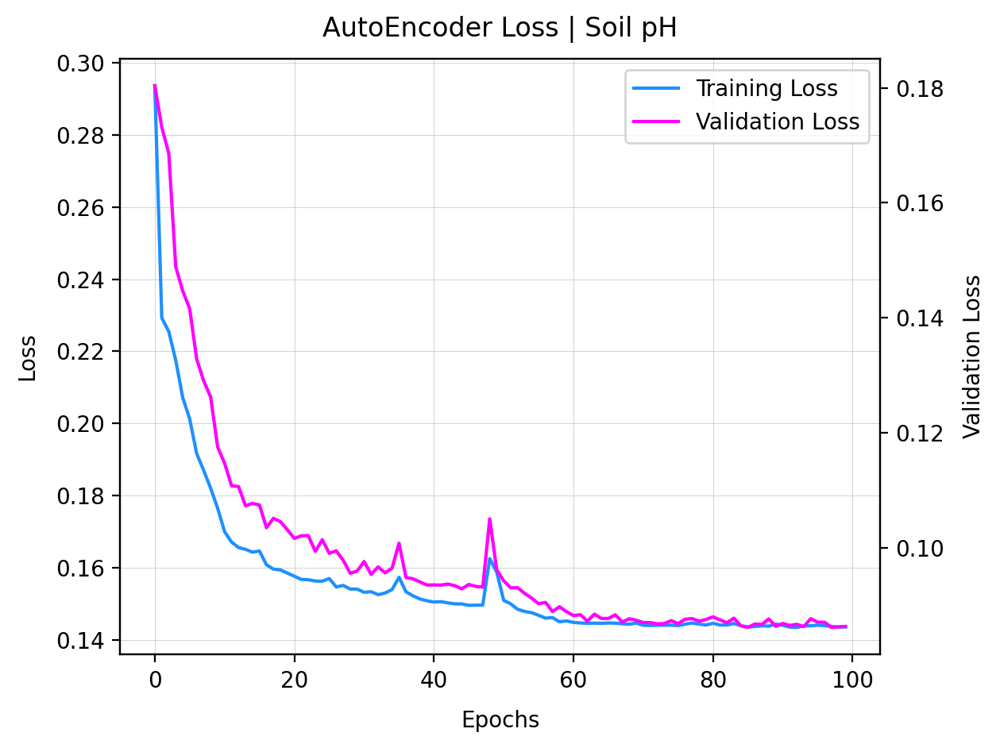

In [107]:
fig = plt.figure()
ax = fig.add_subplot(111)

lns1=ax.plot(history.history['loss'], color='dodgerblue', label='Training Loss');
ax2 = ax.twinx()
lns2 = ax2.plot(history.history['val_loss'], color='magenta', label = 'Validation Loss')

lns = lns1+lns2
labs = [l.get_label() for l in lns]
ax.legend(lns, labs, loc=0)

ax.grid(linewidth=0.2)
ax.set_xlabel("Epochs",labelpad=8)
ax.set_ylabel("Loss",labelpad=8)
ax2.set_ylabel("Validation Loss",labelpad=8)
#ax2.set_ylim(0, 35)
#ax.set_ylim(-20,100)

#plt.title('AutoEncoder Loss | Soil Temperature (ºC)',pad=10)
#plt.title('AutoEncoder Loss | Soil Moisture (%)',pad=10)
plt.title('AutoEncoder Loss | Soil pH',pad=10)

plt.tight_layout()
plt.show()

In [ ]:
# # Reshape the data into a 3D tensor (samples, time steps, features)
# data = np.array(newfeatures).reshape(-1, 1, 11)

# # Define the model architecture
# model = tf.keras.Sequential([
#     # Encodershape
#     tf.keras.layers.Input(shape=(1, 11)),
#     tf.keras.layers.Conv1D(filters=32, kernel_size=3, activation='relu', padding='same'),
#     tf.keras.layers.MaxPooling1D(pool_size=2, padding='same'),
#     tf.keras.layers.Conv1D(filters=16, kernel_size=3, activation='relu', padding='same'),
#     tf.keras.layers.MaxPooling1D(pool_size=2, padding='same'),
#     tf.keras.layers.LSTM(8, return_sequences=True),

#     # Decoder
#     tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(8, return_sequences=True)),
#     tf.keras.layers.UpSampling1D(size=2),
#     tf.keras.layers.Conv1D(filters=16, kernel_size=3, activation='relu', padding='same'),
#     tf.keras.layers.UpSampling1D(size=2),
#     tf.keras.layers.Conv1D(filters=32, kernel_size=3, activation='relu', padding='same'),
#     tf.keras.layers.Conv1D(filters=11, kernel_size=3, activation='sigmoid', padding='same')
# ])

# model.compile(optimizer='adam', loss='mse', metrics=['mse','mae','mape'])

# model.fit(data, data, epochs=10, batch_size=32)

In [108]:
# Evaluate the model≈
loss = autoencoder.evaluate(X_test, y_test)
print('Test loss:', loss)

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 50ms/step - loss: 0.1980 - mae: 0.3625 - mape: 30966760.0000 - mse: 0.1980
Test loss: [0.20806150138378143, 0.20806150138378143, 0.3729911148548126, 30211484.0]


In [109]:
#np.sqrt(0.1942)
#np.sqrt(0.2998)
np.sqrt(0.1980)

0.4449719092257398

In [172]:
# Encoder model to extract the encoded features
encoder = Model(inputs, flat_enc)

# Extract features
X_train_encoded = encoder.predict(X_train)
X_valid_encoded = encoder.predict(X_valid)
X_test_encoded = encoder.predict(X_test)

# Predictor model
predictor = Sequential()
predictor.add(Dense(100, activation='relu', input_shape=(X_train_encoded.shape[1],)))
predictor.add(Dense(50, activation='relu'))
predictor.add(Dense(1, activation='linear'))
#predictor.add(Dense(1, activation='relu'))

predictor.compile(optimizer='adam', loss='mse', metrics=['mse','mae','mape'])

# Train the predictor
history2=predictor.fit(X_train_encoded, y_train.reshape(-1, 1), epochs=100, batch_size=1, validation_data=(X_valid_encoded, y_valid.reshape(-1, 1)))

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Epoch 1/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - loss: 0.0575 - mae: 0.1767 - mape: 21127524.0000 - mse: 0.0575 - val_loss: 0.0180 - val_mae: 0.1125 - val_mape: 9270695.0000 - val_mse: 0.0180
Epoch 2/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0154 - mae: 0.0954 - mape: 5329390.0000 - mse: 0.0154 - val_loss: 0.0110 - val_mae: 0.0837 - val_mape: 6975515.0000 - val_mse: 0.0110
Epoch 3/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0110 - mae: 0.0791 - mape: 6732784.5000 - mse: 0.0110 - val_loss: 0.0112 - val_mae: 0.0861 - val_mape: 7682700.5000 - val_mse: 0.0112
Epoch 4/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0065 - mae: 0.0636 - mape: 4712295.5000 - mse: 0.0065 - val_loss: 0.0095 - val_mae: 0.0833 - val_mape: 6695690.0000 - val_mse: 0.0095
Epoch 5/100
184/184 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0073 - mae: 0.0661 - mape: 6645695

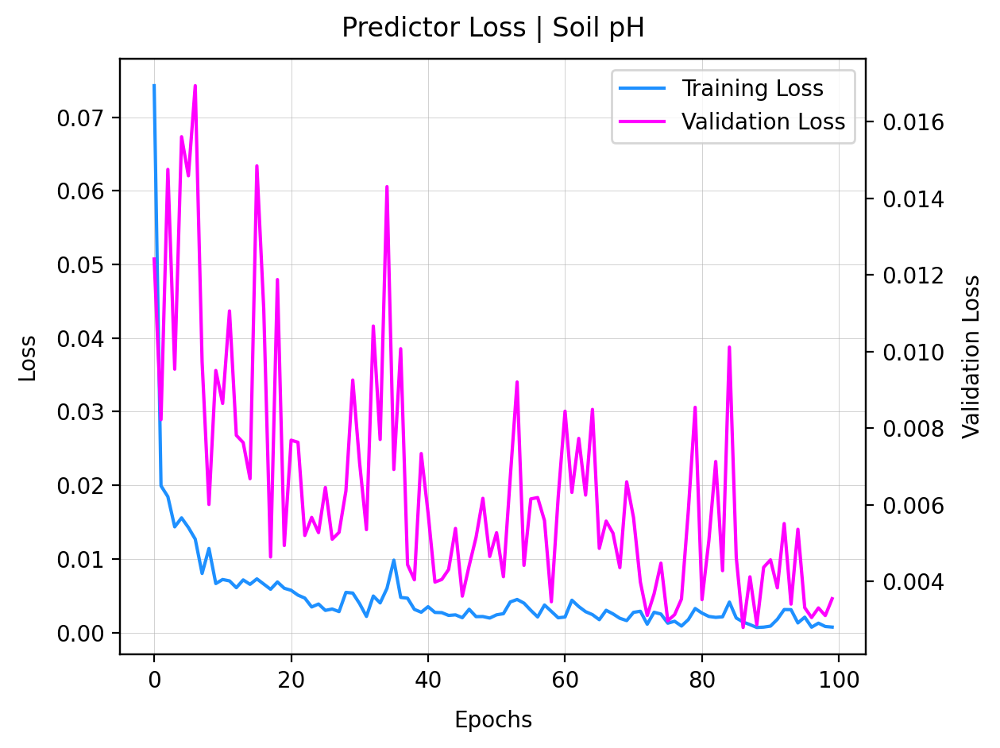

In [111]:
fig = plt.figure()
ax = fig.add_subplot(111)

lns1=ax.plot(history2.history['loss'], color='dodgerblue', label='Training Loss');
ax2 = ax.twinx()
lns2 = ax2.plot(history2.history['val_loss'], color='magenta', label = 'Validation Loss')

lns = lns1+lns2
labs = [l.get_label() for l in lns]
ax.legend(lns, labs, loc=0)

ax.grid(linewidth=0.2)
ax.set_xlabel("Epochs",labelpad=8)
ax.set_ylabel("Loss",labelpad=8)
ax2.set_ylabel("Validation Loss",labelpad=8)
#ax2.set_ylim(0, 35)
#ax.set_ylim(-20,100)
#plt.title('Predictor Loss | Soil Temperature (ºC)',pad=10)
#plt.title('Predictor Loss | Soil Moisture (%)',pad=10)
plt.title('Predictor Loss | Soil pH',pad=10)
plt.tight_layout()
plt.show()

In [ ]:
# X_test_encoded = encoder.predict(X_test)

In [2163]:
# plt.pcolormesh(X_train_encoded.T,cmap='nipy_spectral')
# plt.colorbar();
# plt.pcolormesh(y_train.reshape(160,1).T,cmap='nipy_spectral')
# plt.colorbar();

In [2164]:
# plt.pcolormesh(X_valid_encoded.T,cmap='nipy_spectral')
# plt.colorbar();
# plt.pcolormesh(y_valid.reshape(41,1).T,cmap='nipy_spectral')
# plt.colorbar();

In [2165]:
# plt.pcolormesh(X_test_encoded.T,cmap='nipy_spectral')
# plt.colorbar();
# plt.pcolormesh(y_test.reshape(45,1).T,cmap='nipy_spectral')
# plt.colorbar();

In [2255]:
# plt.pcolormesh(X_test_encoded.T,cmap='nipy_spectral')
# plt.colorbar();

In [2256]:
# plt.pcolormesh(y_test_pred.reshape(45,1).T,cmap='nipy_spectral')
# plt.colorbar();

In [173]:
# Make predictions
y_test_pred = predictor.predict(X_test_encoded)

# Reshape the predictions for comparison
y_test_pred = y_test_pred.reshape((y_test_pred.shape[0], 1, 1))
y_test = y_test.reshape((y_test.shape[0], 1, 1))

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


In [166]:
y_test_pred.shape

(15, 1, 1)

In [167]:
ls=[i for i in range(1,16)]
#ls=[i for i in range(1,67)]
#ls=[i for i in range(1,121)]
#ls=[i for i in range(1,46)]

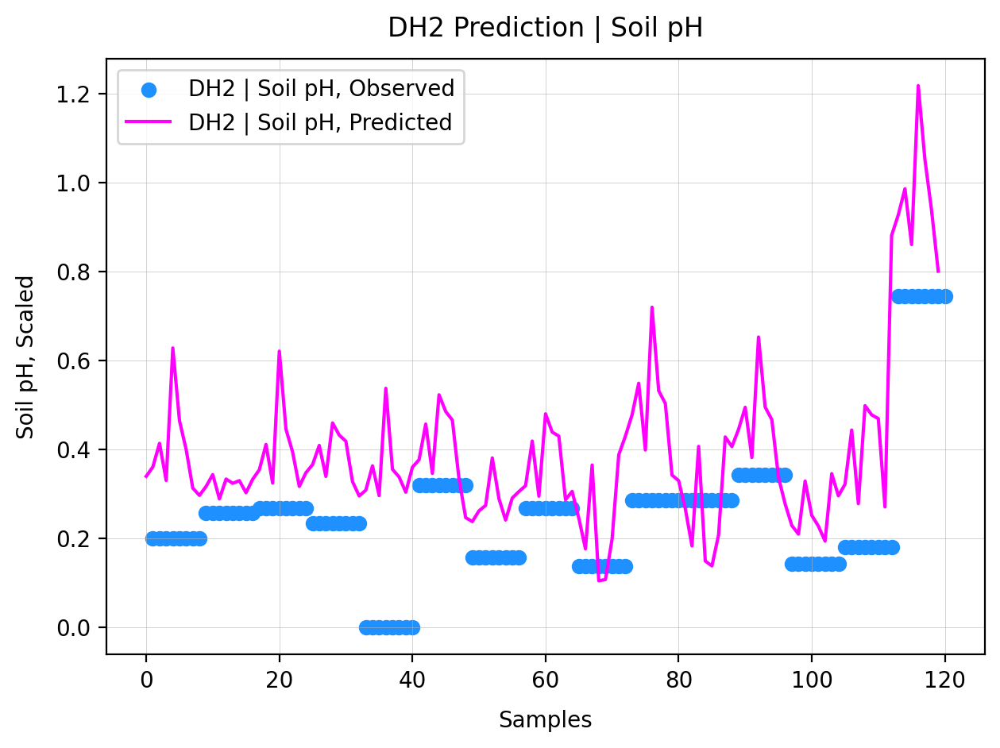

In [115]:
fig = plt.figure()
ax = fig.add_subplot(111)

#ax.plot(y_test.reshape(45,), color='dodgerblue', label='DH3 | Soil Temperature (ºC), Observed');
#ax.plot(y_test_pred.reshape(45,), color='magenta', label = 'DH3 | Soil Temperature (ºC), Predicted')

# ax.scatter(ls,newfeatures[:15]['sot'].values, color='dodgerblue', label='PB1 | Soil Temperature (ºC), Observed');
# ax.plot(y_test_pred.reshape(15,), color='magenta', label = 'PB1 | Soil Temperature (ºC), Predicted')
# ax.scatter(ls,newfeatures[:15]['som'].values, color='dodgerblue', label='PB1 | Soil Moisture (%), Observed');
# ax.plot(y_test_pred.reshape(15,), color='magenta', label = 'PB1 | Soil Moisture (%), Predicted')
# ax.scatter(ls,newfeatures[:15]['sph'].values, color='dodgerblue', label='PB1 | Soil pH, Observed');
# ax.plot(y_test_pred.reshape(15,), color='magenta', label = 'PB1 | Soil pH, Predicted')

# ax.scatter(ls,newfeatures[15:81]['sot'].values, color='dodgerblue', label='DH1 | Soil Temperature (ºC), Observed');
# ax.plot(y_test_pred.reshape(66,), color='magenta', label = 'DH1 | Soil Temperature (ºC), Predicted')
# ax.scatter(ls,newfeatures[15:81]['som'].values, color='dodgerblue', label='DH1 | Soil Moisture (%), Observed');
# ax.plot(y_test_pred.reshape(66,), color='magenta', label = 'DH1 | Soil Moisture (%), Predicted')
# ax.scatter(ls,newfeatures[15:81]['sph'].values, color='dodgerblue', label='DH1 | Soil pH, Observed');
# ax.plot(y_test_pred.reshape(66,), color='magenta', label = 'DH1 | Soil pH, Predicted')

# ax.scatter(ls,newfeatures[81:201]['sot'].values, color='dodgerblue', label='DH2 | Soil Temperature (ºC), Observed');
# ax.plot(y_test_pred.reshape(120,), color='magenta', label = 'DH2 | Soil Temperature (ºC), Predicted')
# ax.scatter(ls,newfeatures[81:201]['som'].values, color='dodgerblue', label='DH2 | Soil Moisture (%), Observed');
# ax.plot(y_test_pred.reshape(120,), color='magenta', label = 'DH2 | Soil Moisture (%), Predicted')
ax.scatter(ls,newfeatures[81:201]['sph'].values, color='dodgerblue', label='DH2 | Soil pH, Observed');
ax.plot(y_test_pred.reshape(120,), color='magenta', label = 'DH2 | Soil pH, Predicted')

#ax.scatter(ls,newfeatures[201:]['sot'].values, color='dodgerblue', label='DH3 | Soil Temperature (ºC), Observed');
#ax.plot(y_test_pred.reshape(45,), color='magenta', label = 'DH3 | Soil Temperature (ºC), Predicted')
# ax.scatter(ls,newfeatures[201:]['som'].values, color='dodgerblue', label='DH3 | Soil Moisture (%), Observed');
# ax.plot(y_test_pred.reshape(45,), color='magenta', label = 'DH3 | Soil Moisture (%), Predicted')
# ax.scatter(ls,newfeatures[201:]['sph'].values, color='dodgerblue', label='DH3 | Soil pH, Observed');
# ax.plot(y_test_pred.reshape(45,), color='magenta', label = 'DH3 | Soil pH, Predicted')

ax.grid(linewidth=0.2)
ax.set_xlabel("Samples",labelpad=8)
#ax.set_ylabel("Soil Temperature (ºC), Scaled",labelpad=8)
#ax.set_ylabel("Soil Moisture (%), Scaled",labelpad=8)
ax.set_ylabel("Soil pH, Scaled",labelpad=8)
#ax2.set_ylim(0, 35)
#ax.set_ylim(-20,100)
#plt.title('PB1 Prediction | Soil Temperature (ºC)',pad=10)
#plt.title('PB1 Prediction | Soil Moisture (%)',pad=10)
#plt.title('PB1 Prediction | Soil pH',pad=10)
#plt.title('DH1 Prediction | Soil Temperature (ºC)',pad=10)
#plt.title('DH1 Prediction | Soil Moisture (%)',pad=10)
#plt.title('DH1 Prediction | Soil pH',pad=10)
#plt.title('DH2 Prediction | Soil Temperature (ºC)',pad=10)
#plt.title('DH2 Prediction | Soil Moisture (%)',pad=10)
plt.title('DH2 Prediction | Soil pH',pad=10)
#plt.title('DH3 Prediction | Soil Temperature (ºC)',pad=10)
#plt.title('DH3 Prediction | Soil Moisture (%)',pad=10)
#plt.title('DH3 Prediction | Soil pH',pad=10)
plt.tight_layout()
plt.legend(loc='best')
#plt.legend(loc='upper right')
plt.show()

In [2177]:
# re=np.mean(np.abs(X_test - y_test_pred), axis=1)
# plt.plot(X_test.reshape(450,));
# plt.plot(re.reshape(450,));

In [2178]:
# re=np.mean(np.abs(y_test - y_test_pred), axis=1)
# plt.plot(y_test.reshape(45,));
# plt.plot(re.reshape(45,));

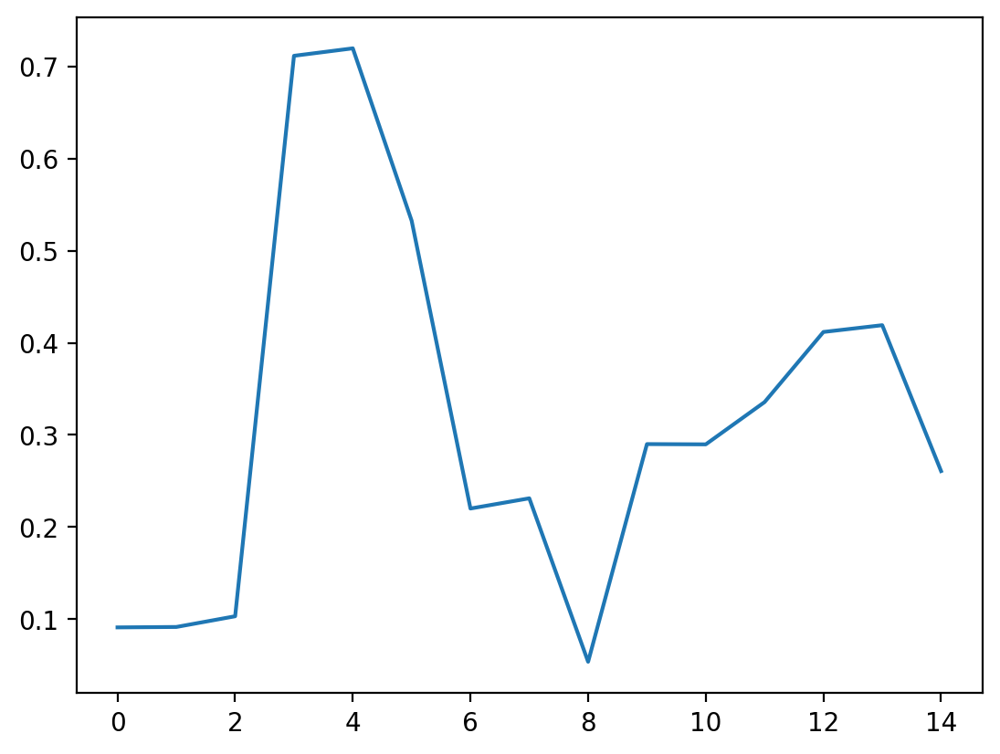

In [174]:
plt.plot(np.mean(np.abs(y_test.reshape(15,1) - y_test_pred.reshape(15,1)), axis=1));
#plt.plot(np.mean(np.abs(y_test.reshape(66,1) - y_test_pred.reshape(66,1)), axis=1));
#plt.plot(np.mean(np.abs(y_test.reshape(120,1) - y_test_pred.reshape(120,1)), axis=1));
#plt.plot(np.mean(np.abs(y_test.reshape(45,1) - y_test_pred.reshape(45,1)), axis=1));

In [175]:
#reconstruction error
np.mean(np.abs(y_test.reshape(15,1) - y_test_pred.reshape(15,1)), axis=1).mean() #0.3040874373336165, 0.19341305640354675, 
#np.mean(np.abs(y_test.reshape(66,1) - y_test_pred.reshape(66,1)), axis=1).mean() #0.17262816622006516,0.16050372597014906,0.1941655147288527
#np.mean(np.abs(y_test.reshape(120,1) - y_test_pred.reshape(120,1)), axis=1).mean() #0.12523114010128394, 0.3193470463638578, 0.15316625149831875
#np.mean(np.abs(y_test.reshape(45,1) - y_test_pred.reshape(45,1)), axis=1).mean()

0.31746752495425085

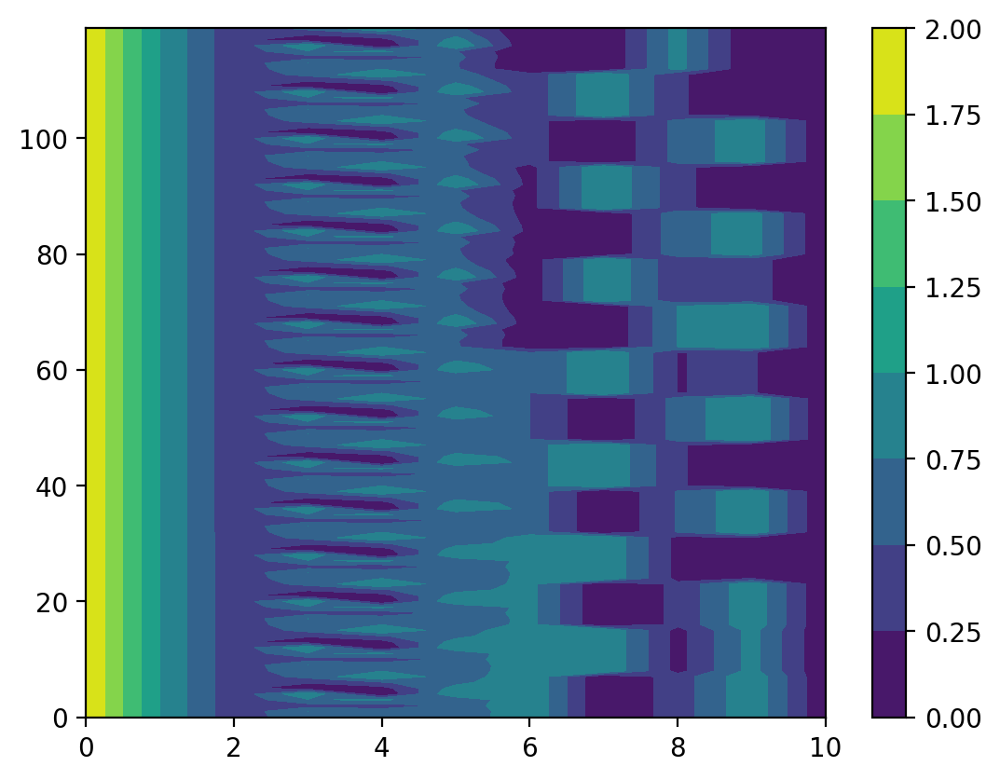

In [132]:
plt.contourf(X_test.reshape(120,11));
plt.colorbar();

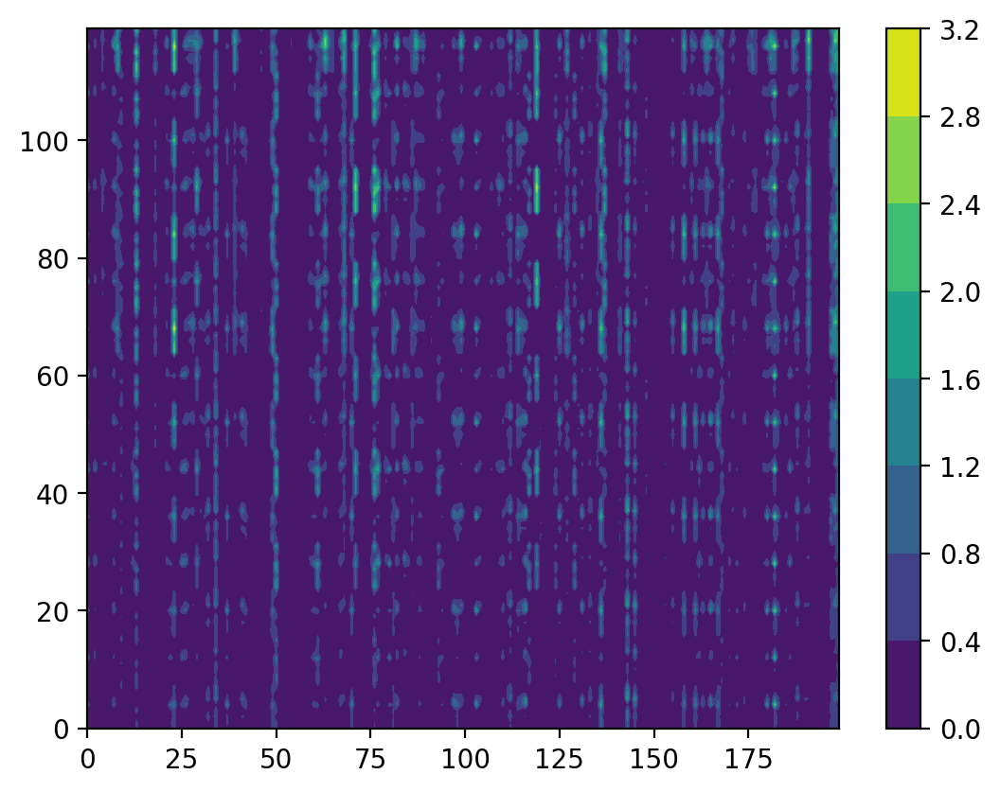

In [140]:
plt.contourf(X_test_encoded.reshape(120,200));
plt.colorbar();

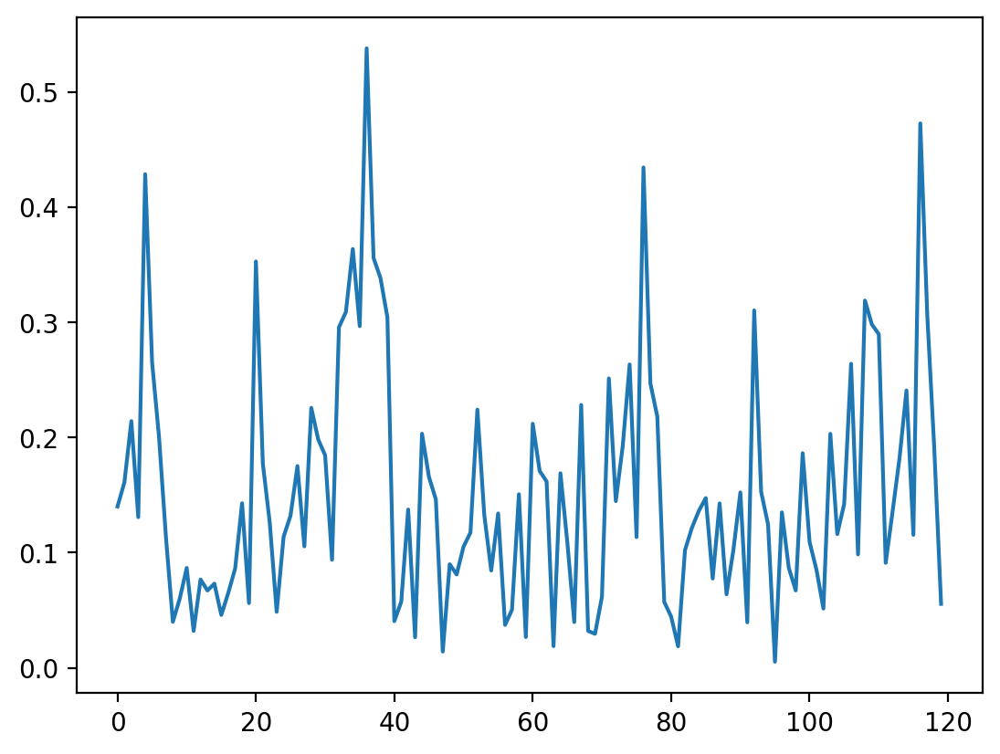

In [129]:
plt.plot(np.mean(np.abs(y_test.reshape(120,1) - y_test_pred.reshape(120,1)), axis=1).reshape(120,1));

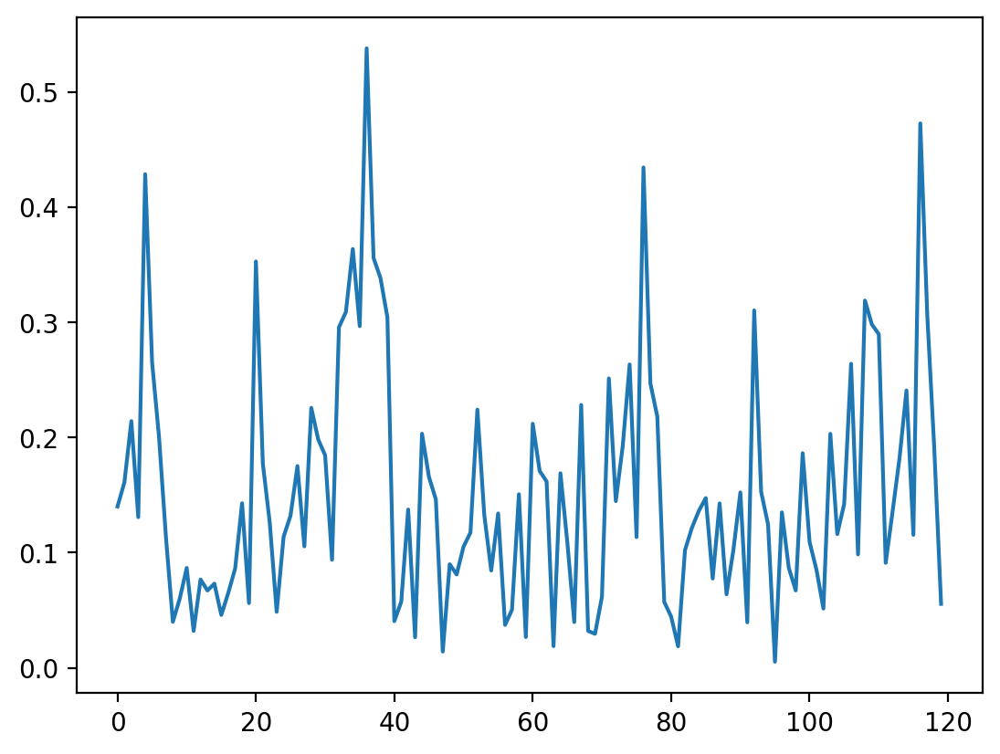

In [154]:
plt.plot(np.abs(y_test-y_test_pred).reshape(120,1));

In [213]:
#arr=np.array([newfeatures.dis.values,newfeatures.dep.values,newfeatures.sot.values,newfeatures.som.values,newfeatures.sph.values])

In [297]:
# newfeatures['sph'].plot()
# pd.DataFrame(np.diff(newfeatures)[1:]).iloc[:,-2].plot()

In [58]:
print(newfeatures.iloc[:,:-1].columns.tolist())

['loc', 'dat', 'lon', 'rh', 'wsp', 'hin', 'dis', 'dep', 'sot', 'som', 'sph']


In [443]:
#newfeatures[['hin','dep','sph']]

##### ML

In [ ]:
plt.contourf(X_test.reshape(45,10));
plt.colorbar();

In [ ]:
plt.contourf(reconstruction_error);
plt.colorbar();

In [ ]:
fig,ax=plt.subplots(1,1,figsize=(10,8),dpi=300)
ax.plot(y_test.reshape(45,));
ax.plot(reconstruction_error.reshape(450,));

In [ ]:
# Visualize original vs. reconstructed for a few samples
n = 5  # Number of samples to visualize
plt.figure(figsize=(15, n * 3))

for i in range(n):
    # Original data
    ax = plt.subplot(n, 2, 2 * i + 1)
    plt.plot(X_test[i])
    plt.title("Original")
    
    # Reconstructed data
    ax = plt.subplot(n, 2, 2 * i + 2)
    plt.plot(y_pred[i])
    plt.title("Reconstructed")

plt.tight_layout()
plt.show()

In [ ]:
mean_squared_error(y_pred.reshape(45,40),y_test.reshape(45,1))

In [ ]:
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)
rmse = root_mean_squared_error(y_test, y_pred)

print("MSE:", mse)
print("MAE:", mae)
print("MAPE:", mape)
print("RMSE:", rmse)

##### ML Playground

In [1249]:
data=features.values; labels=features.columns

In [1268]:
#df2.reset_index().merge(df.reset_index())

In [1293]:
#features.columns[np.where(features.columns!='sph')[0].tolist()].tolist()

In [1665]:
X_train, X_test, y_train, y_test = train_test_split(features[features.columns[np.where(features.columns!='sot')[0].tolist()].tolist()], 
                                                    features['sot'], test_size=0.2, random_state=42)

In [1576]:
X_train, X_test, y_train, y_test = train_test_split(features[features.columns[np.where(features.columns!='som')[0].tolist()].tolist()], 
                                                    features['som'], test_size=0.2, random_state=42)

In [1380]:
X_train, X_test, y_train, y_test = train_test_split(features[features.columns[np.where(features.columns!='sph')[0].tolist()].tolist()], 
                                                    features['sph'], test_size=0.2, random_state=42)

In [1673]:
X_train=X_train.values.reshape((len(X_train), np.prod(X_train.shape[1:])))
X_test=X_test.values.reshape((len(X_test), np.prod(X_test.shape[1:])))

In [1654]:
# y_train=y_train.values;
# y_train = y_train.reshape(-1, 1);
#X_train=X_train.values.reshape(-1,1);
X_train=X_train.values.reshape(196,9)
y_train=y_train.values.reshape(-1,1)

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import Mean

# Transformer model function
def create_transformer_model(input_shape, output_shape, num_layers, d_model, num_heads, dff, dropout_rate):
    inputs = Input(shape=input_shape)
    
    # Encoder
    x = inputs
    for _ in range(num_layers):
        # Multi-head self-attention
        x = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=d_model)(x, x)
        x = Dropout(dropout_rate)(x)
        # Feed forward
        x = tf.keras.layers.Dense(dff, activation='relu')(x)
        x = tf.keras.layers.Dropout(dropout_rate)(x)
        x = tf.keras.layers.Dense(d_model)(x)
        x = tf.keras.layers.Dropout(dropout_rate)(x)
        # Add & Norm
        x = tf.keras.layers.Add()([inputs, x])
        x = tf.keras.layers.LayerNormalization(epsilon=1e-6)(x)
    
    # Output layer
    outputs = Dense(output_shape)(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    return model

# Model parameters
input_shape = (196,)
output_shape = 1
num_layers = 4
d_model = 196 #toggle if error results in input shape mismatch
num_heads = 9
dff = 256
dropout_rate = 0.1

# Create model
model = create_transformer_model(input_shape, output_shape, num_layers, d_model, num_heads, dff, dropout_rate)
model.summary()

In [1657]:
optimizer = Adam(learning_rate=0.001)
loss = MeanSquaredError()
metrics = [Mean()]
model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

In [ ]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import Mean

# Generate sample data
num_instances = 246
num_variables = 10

# Assuming you have your dataframe df with shape (246, 10)
# Generate sample data
np.random.seed(0)
df = pd.DataFrame(np.random.rand(num_instances, num_variables), columns=[f"Var{i+1}" for i in range(num_variables)])
# Assuming you want to predict the first variable based on the rest
X_train = df.iloc[:, 1:].values  # Input data
y_train = df.iloc[:, 0].values    # Output data

# Reshape y_train to fit the model's output shape
y_train = y_train.reshape(-1, 1)

# Transformer model function
def create_transformer_model(input_shape, output_shape, num_layers=4, d_model=64, num_heads=8, dff=256, dropout_rate=0.1):
    inputs = Input(shape=input_shape)
    
    # Encoder
    x = inputs
    for _ in range(num_layers):
        # Multi-head self-attention
        x = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=d_model)(x, x)
        x = Dropout(dropout_rate)(x)
        # Feed forward
        x = tf.keras.layers.Dense(dff, activation='relu')(x)
        x = tf.keras.layers.Dropout(dropout_rate)(x)
        x = tf.keras.layers.Dense(d_model)(x)
        x = tf.keras.layers.Dropout(dropout_rate)(x)
        # Add & Norm
        x = tf.keras.layers.Add()([inputs, x])
        x = tf.keras.layers.LayerNormalization(epsilon=1e-6)(x)
    
    # Output layer
    outputs = Dense(output_shape)(x)
    
    model = Model(inputs=inputs, outputs=outputs)
    return model

# Model parameters
input_shape = (num_variables - 1,)
output_shape = 1
num_layers = 4
d_model = 9
num_heads = 8
dff = 256
dropout_rate = 0.1

# Create model
model = create_transformer_model(input_shape, output_shape, num_layers, d_model, num_heads, dff, dropout_rate)

# Compile model
optimizer = Adam(learning_rate=0.001)
loss = MeanSquaredError()
metrics = [Mean()]
model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

# Fit the model
model.fit(X_train, y_train, epochs=10, batch_size=32)

In [1713]:
#36x49

In [1765]:
import keras
from keras import layers

# This is the size of our encoded representations
encoding_dim = 32  # 32 floats -> compression of factor 24.5, assuming the input is 784 floats

# This is our input image
input_img = keras.Input(shape=(9,))
# "encoded" is the encoded representation of the input
encoded = layers.Dense(encoding_dim, activation='relu')(input_img)
# "decoded" is the lossy reconstruction of the input
decoded = layers.Dense(9, activation='sigmoid')(encoded)

# This model maps an input to its reconstruction
autoencoder = keras.Model(input_img, decoded)

# This model maps an input to its encoded representation
encoder = keras.Model(input_img, encoded)

# This is our encoded (32-dimensional) input
encoded_input = keras.Input(shape=(encoding_dim,))
# Retrieve the last layer of the autoencoder model
decoder_layer = autoencoder.layers[-1]
# Create the decoder model
decoder = keras.Model(encoded_input, decoder_layer(encoded_input))

autoencoder.compile(optimizer='adam', loss='mse')

In [1766]:
autoencoder.fit(X_train, X_train,
                epochs=100,
                batch_size=32,
                shuffle=True,
                validation_data=(X_test, X_test))

encoded_imgs = encoder.predict(X_test)
decoded_imgs = decoder.predict(encoded_imgs)

encoder = keras.Model(input_img, encoded)
encoded_imgs = encoder.predict(x_test)

Epoch 1/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - loss: 0.1406 - val_loss: 0.1489
Epoch 2/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.1341 - val_loss: 0.1423
Epoch 3/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.1304 - val_loss: 0.1363
Epoch 4/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.1218 - val_loss: 0.1310
Epoch 5/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.1191 - val_loss: 0.1261
Epoch 6/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.1119 - val_loss: 0.1217
Epoch 7/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.1082 - val_loss: 0.1176
Epoch 8/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.1043 - val_loss: 0.1136
Epoch 9/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.1003 - val_loss: 0.1098
Epoch 10/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0959 - val_loss: 0.1061
Epoch 11/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0948 - val_loss: 0.1024
Epoch 12/100
7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0898 - val_loss: 0.099

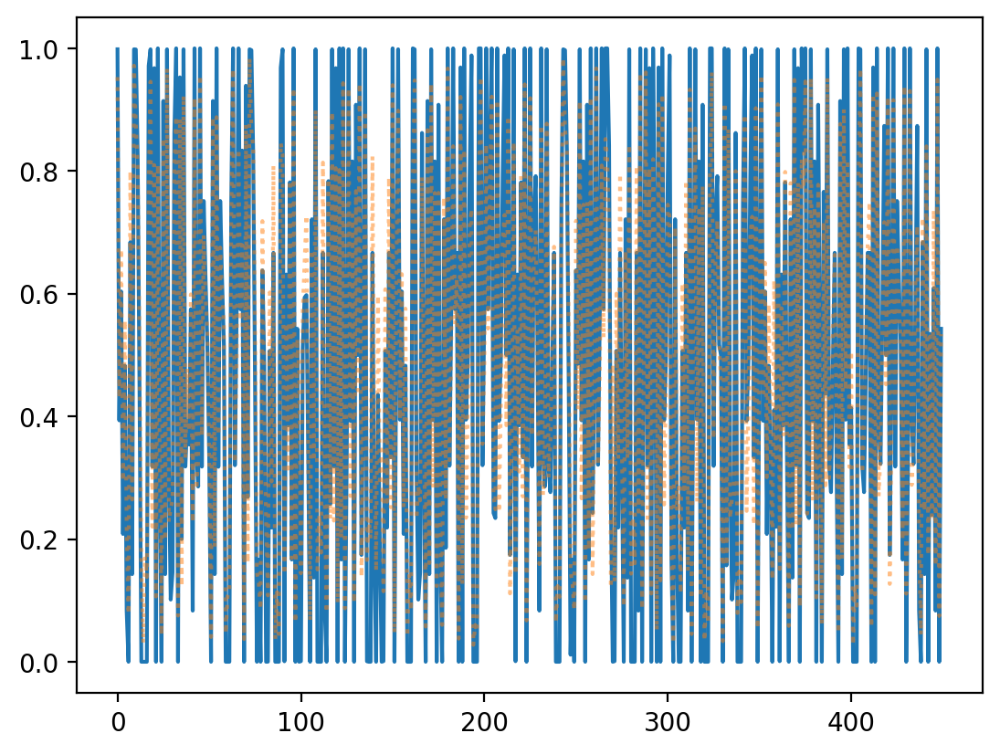

In [1767]:
plt.plot(X_test.reshape(-1,1));
#plt.plot(encoded_imgs.reshape(-1,1),linestyle='dotted',alpha=0.2);
plt.plot(decoded_imgs.reshape(-1,1),linestyle='dotted',alpha=0.5);

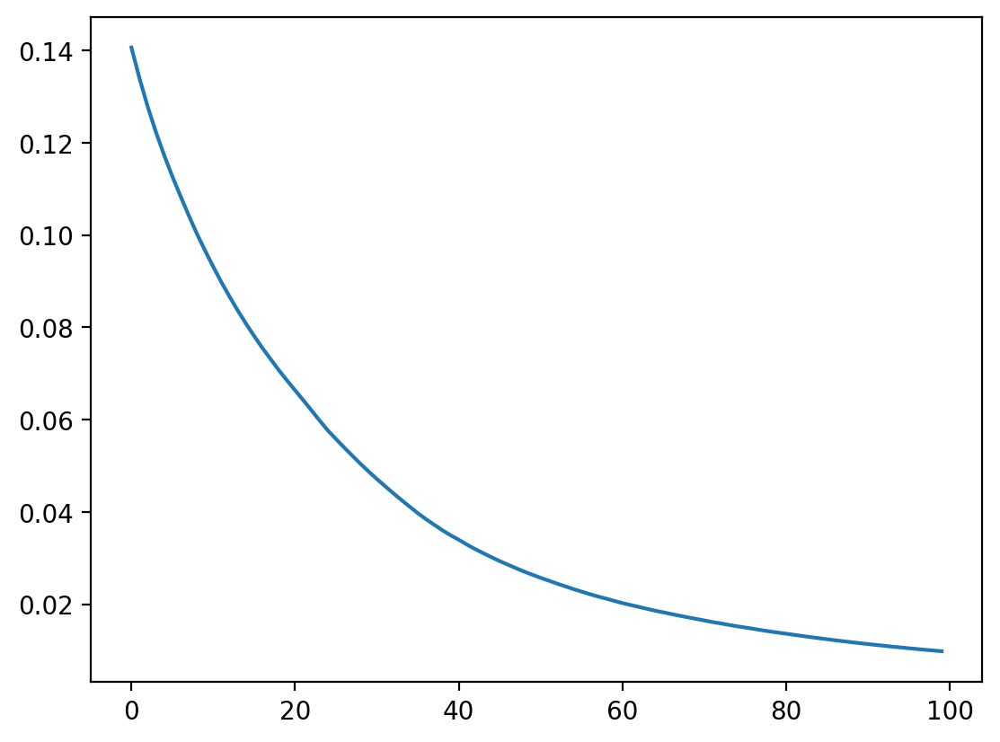

In [1770]:
plt.plot(autoencoder.history.history['loss']);

In [1771]:
from keras import regularizers

encoding_dim = 32

input_img = keras.Input(shape=(9,))
# Add a Dense layer with a L1 activity regularizer
encoded = layers.Dense(encoding_dim, activation='relu',
                activity_regularizer=regularizers.l1(10e-5))(input_img)
decoded = layers.Dense(9, activation='sigmoid')(encoded)

autoencoder = keras.Model(input_img, decoded)

In [1772]:
input_img = keras.Input(shape=(9,))
encoded = layers.Dense(128, activation='relu')(input_img)
encoded = layers.Dense(64, activation='relu')(encoded)
encoded = layers.Dense(32, activation='relu')(encoded)

decoded = layers.Dense(64, activation='relu')(encoded)
decoded = layers.Dense(128, activation='relu')(decoded)
decoded = layers.Dense(9, activation='sigmoid')(decoded)

In [1773]:
autoencoder = keras.Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

autoencoder.fit(X_train, X_train,
                epochs=100,
                batch_size=256,
                shuffle=True,
                validation_data=(X_test, X_test))

encoded_imgs = encoder.predict(X_test)
decoded_imgs = decoder.predict(encoded_imgs)

Epoch 1/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.6898 - val_loss: 0.6868
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.6864 - val_loss: 0.6830
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.6827 - val_loss: 0.6789
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.6786 - val_loss: 0.6744
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.6743 - val_loss: 0.6693
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.6694 - val_loss: 0.6637
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.6641 - val_loss: 0.6577
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.6583 - val_loss: 0.6512
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - loss: 0.6521 - val_loss: 0.6446
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.6458 - val_loss: 0.6378
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 0.6393 - val_loss: 0.6310
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 0.6328 - val_loss

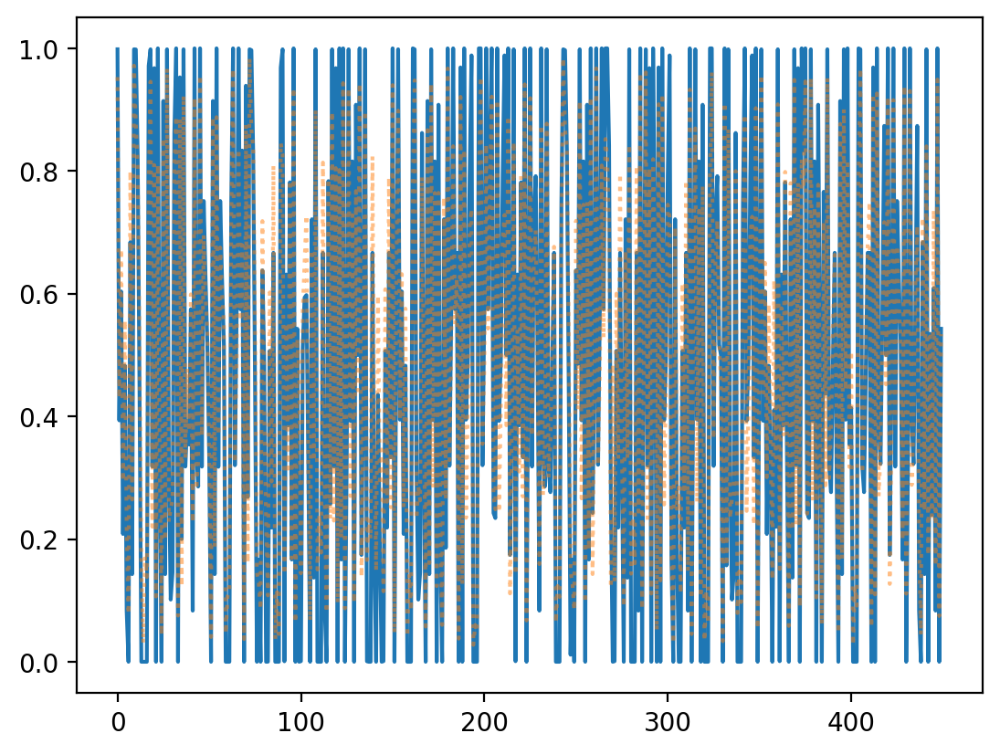

In [1774]:
plt.plot(X_test.reshape(-1,1));
#plt.plot(encoded_imgs.reshape(-1,1),linestyle='dotted',alpha=0.2);
plt.plot(decoded_imgs.reshape(-1,1),linestyle='dotted',alpha=0.5);

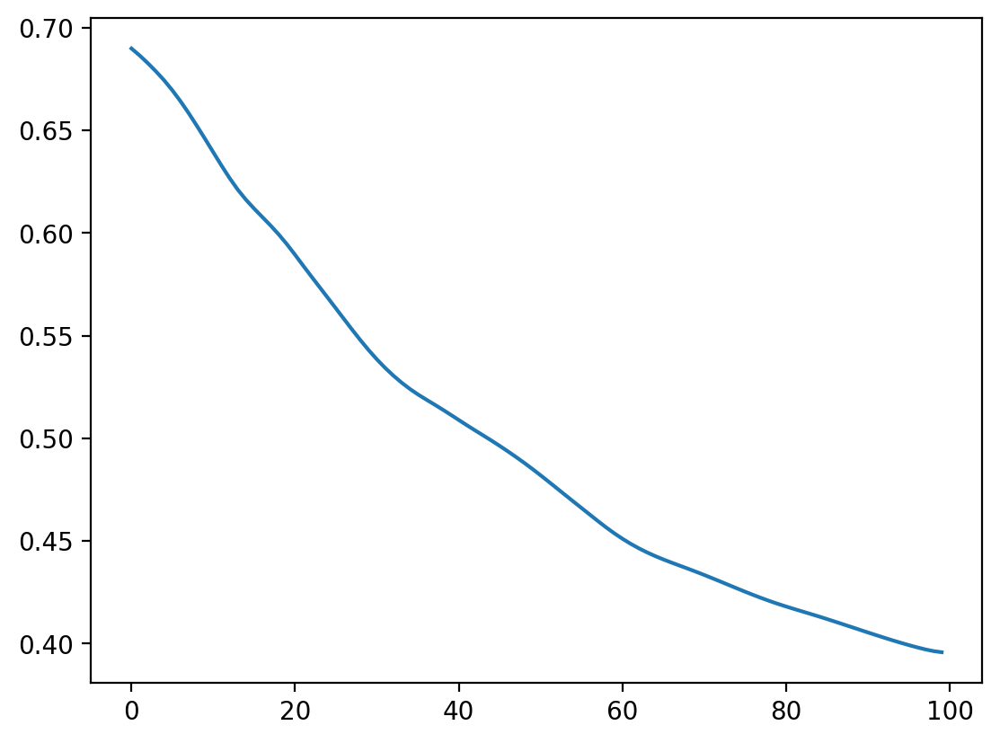

In [1776]:
plt.plot(autoencoder.history.history['loss']);

In [1777]:
X_train.shape

(196, 9)

In [1784]:
from keras.callbacks import TensorBoard

autoencoder.fit(X_train, X_train,
                epochs=100,
                batch_size=32,
                shuffle=True,
                validation_data=(X_test, X_test),
                callbacks=[TensorBoard(log_dir='/tmp/autoencoder')])

Epoch 1/100


ValueError: Input 0 of layer "functional_212" is incompatible with the layer: expected shape=(None, 196, 9, 1), found shape=(None, 9)

In [1780]:
encoded_imgs = encoder.predict(X_test)
decoded_imgs = decoder.predict(encoded_imgs)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


In [ ]:
from keras.datasets import mnist
import numpy as np

(x_train, _), (x_test, _) = mnist.load_data()

x_train = x_train.astype('float32') / 255.
x_test = x_test.astype('float32') / 255.
x_train = np.reshape(x_train, (len(x_train), 28, 28, 1))
x_test = np.reshape(x_test, (len(x_test), 28, 28, 1))

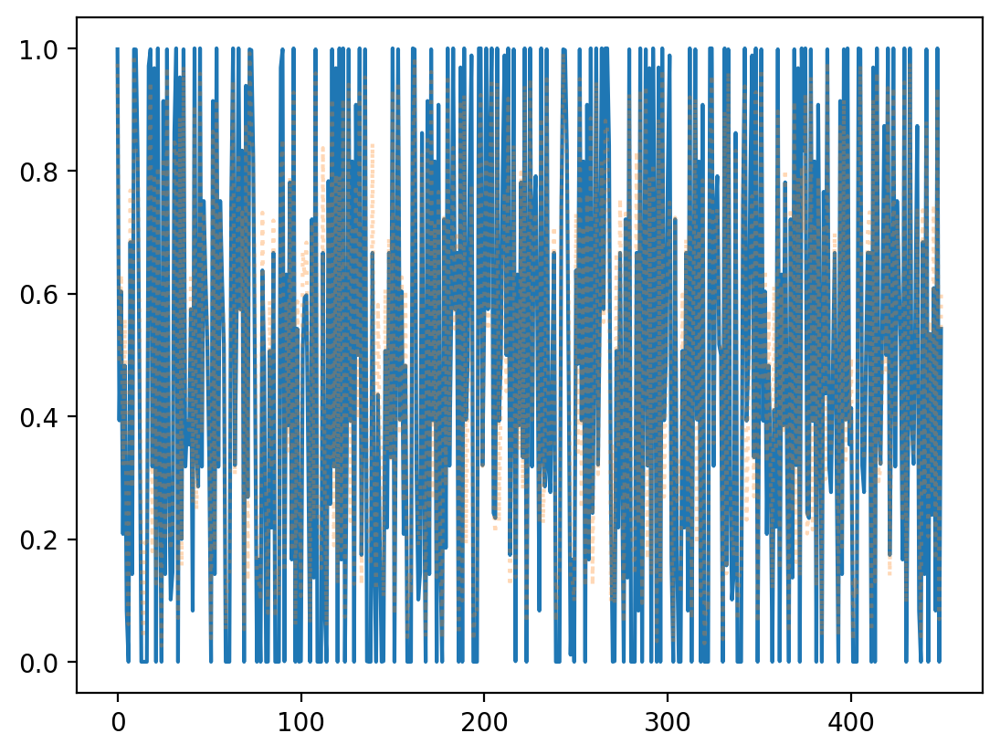

In [1741]:
plt.plot(X_test.reshape(-1,1));
#plt.plot(encoded_imgs.reshape(-1,1),linestyle='dotted',alpha=0.2);
plt.plot(decoded_imgs.reshape(-1,1),linestyle='dotted',alpha=0.3);

In [ ]:
plt.plot(decoded_imgs.

In [ ]:
#X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)

# Scale data (important for neural networks)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Neural network model
model = tf.keras.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

# Train the model
#history = model.fit(X_train_scaled, y_train, epochs=50, validation_split=0.2)
#history2 = model.fit(X_train_scaled, y_train, epochs=50, validation_split=0.2)
history3 = model.fit(X_train_scaled, y_train, epochs=50, validation_split=0.2)

# Evaluate the model
test_loss, test_acc = model.evaluate(X_test_scaled, y_test)
print(f"Test Accuracy: {test_acc:.3f}")

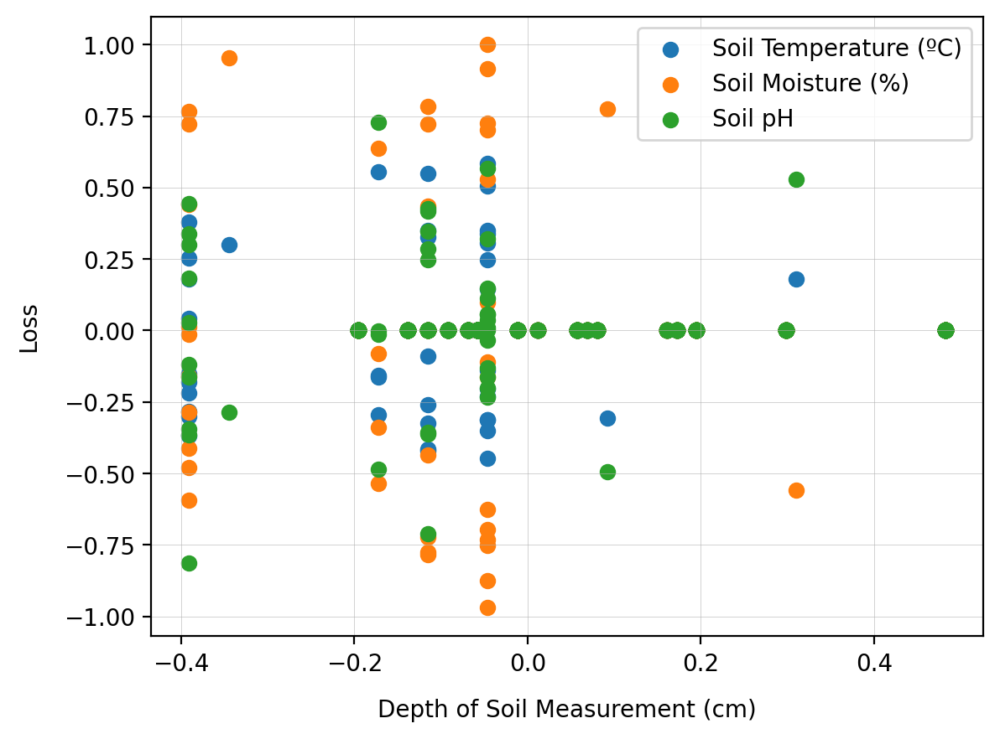

In [529]:
plt.scatter(newfeatures['hin'],newfeatures['sot'],label='Soil Temperature (ºC)');
plt.scatter(newfeatures['hin'],newfeatures['som'],label='Soil Moisture (%)');
plt.scatter(newfeatures['hin'],newfeatures['sph'],label='Soil pH');
plt.grid(linewidth=0.2)
plt.xlabel('Depth of Soil Measurement (cm)',labelpad=10)
plt.ylabel('Loss',labelpad=10)
plt.legend(loc='best')
plt.show();

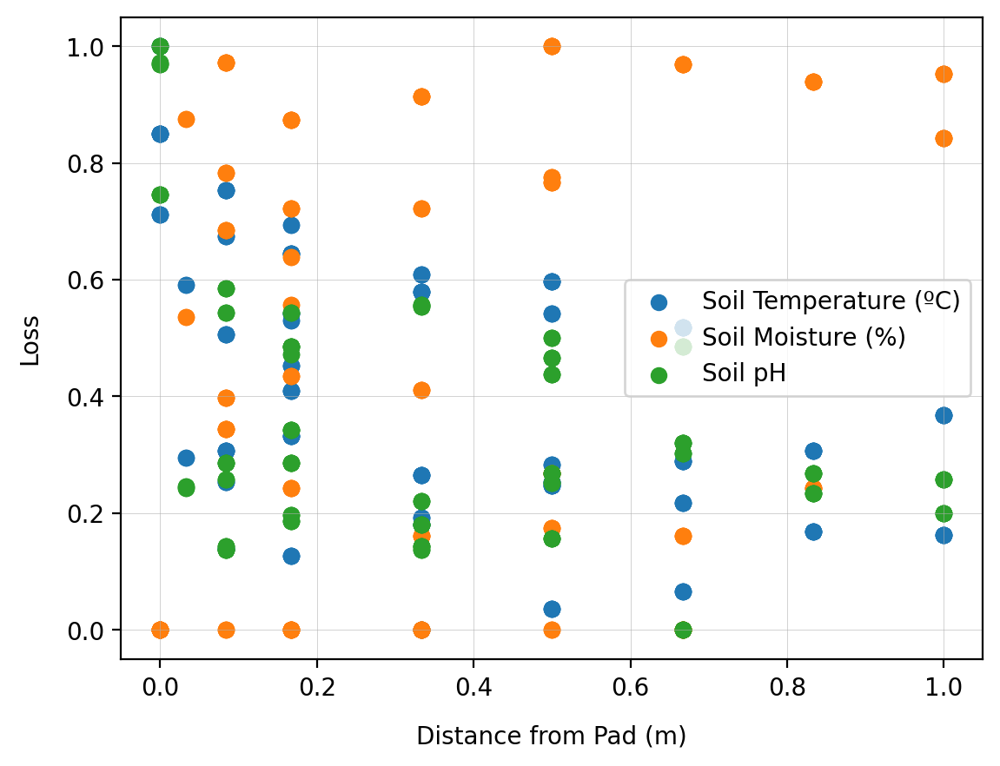

In [1384]:
plt.scatter(features['dis'],features['sot'],label='Soil Temperature (ºC)');
plt.scatter(features['dis'],features['som'],label='Soil Moisture (%)');
plt.scatter(features['dis'],features['sph'],label='Soil pH');
plt.grid(linewidth=0.2)
plt.xlabel('Distance from Pad (m)',labelpad=10)
plt.ylabel('Loss',labelpad=10)
plt.legend(loc='best')
plt.show();

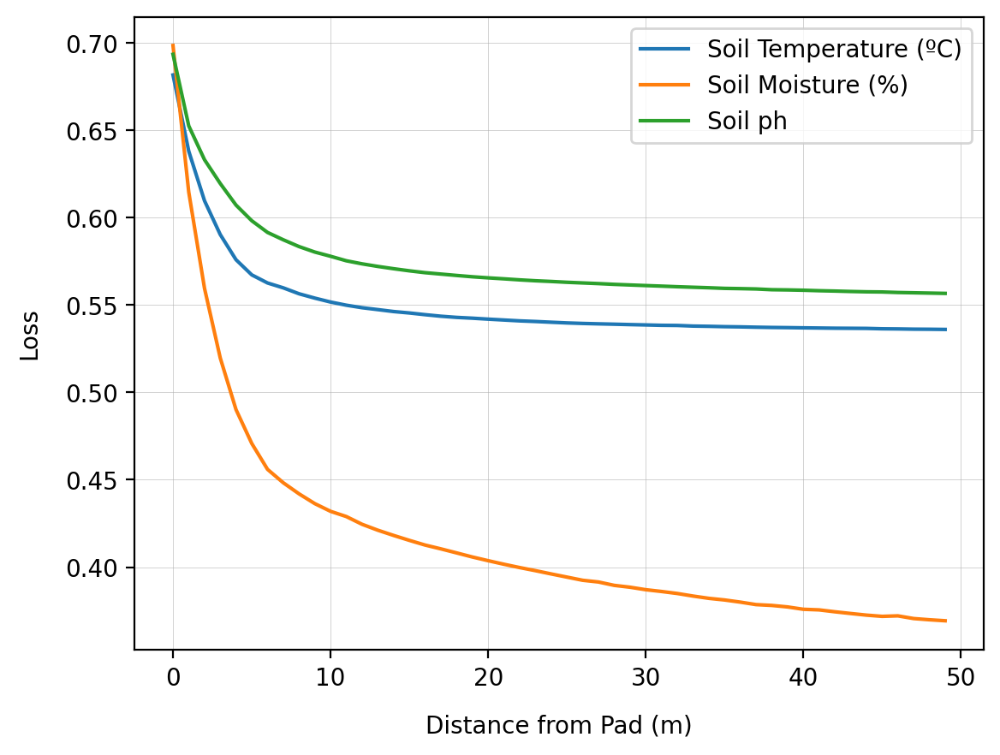

In [1383]:
plt.plot(history.history['loss'],label='Soil Temperature (ºC)');
plt.plot(history2.history['loss'],label='Soil Moisture (%)');
plt.plot(history3.history['loss'],label='Soil ph');
plt.grid(linewidth=0.2)
plt.xlabel('Distance from Pad (m)',labelpad=10)
plt.ylabel('Loss',labelpad=10)
plt.legend(loc='best')
plt.show();

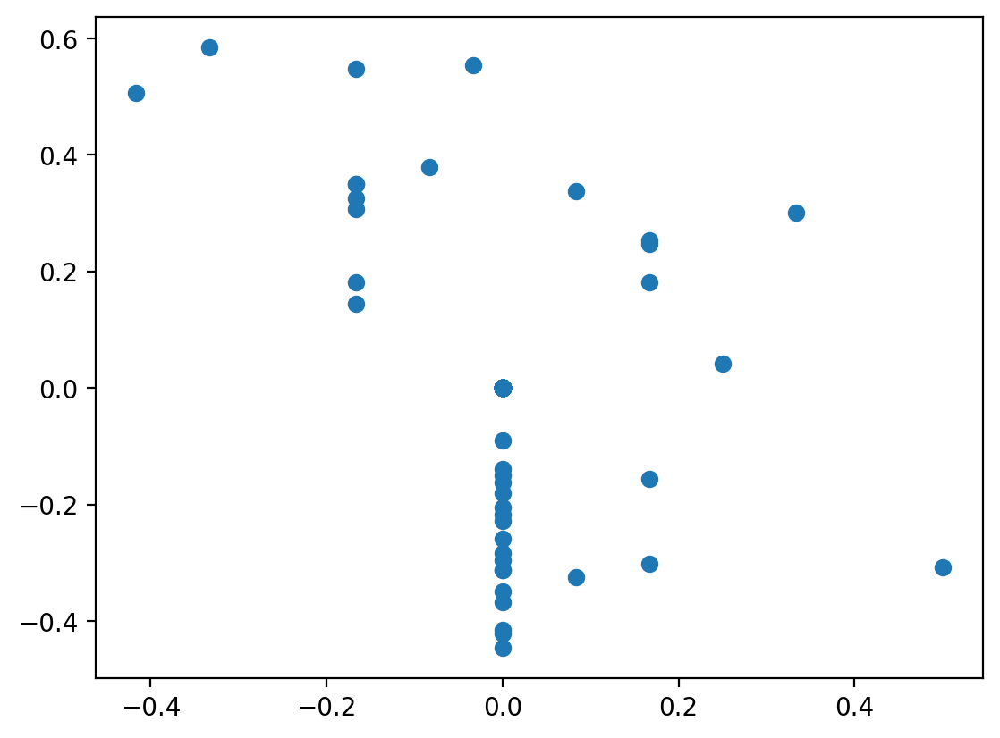

In [531]:
plt.scatter(newfeatures['dis'],newfeatures['sot']);
#plt.twiny()
#plt.plot(history.history['loss']);

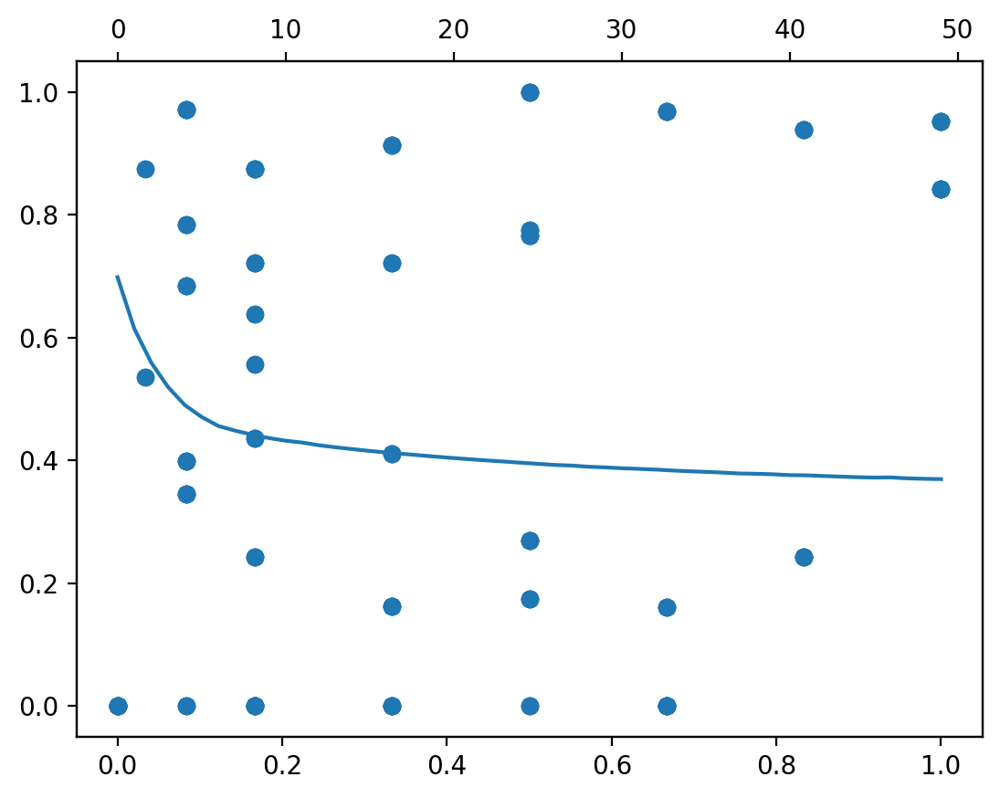

In [1379]:
plt.scatter(features['dis'],features['som']);
plt.twiny()
plt.plot(history2.history['loss']);

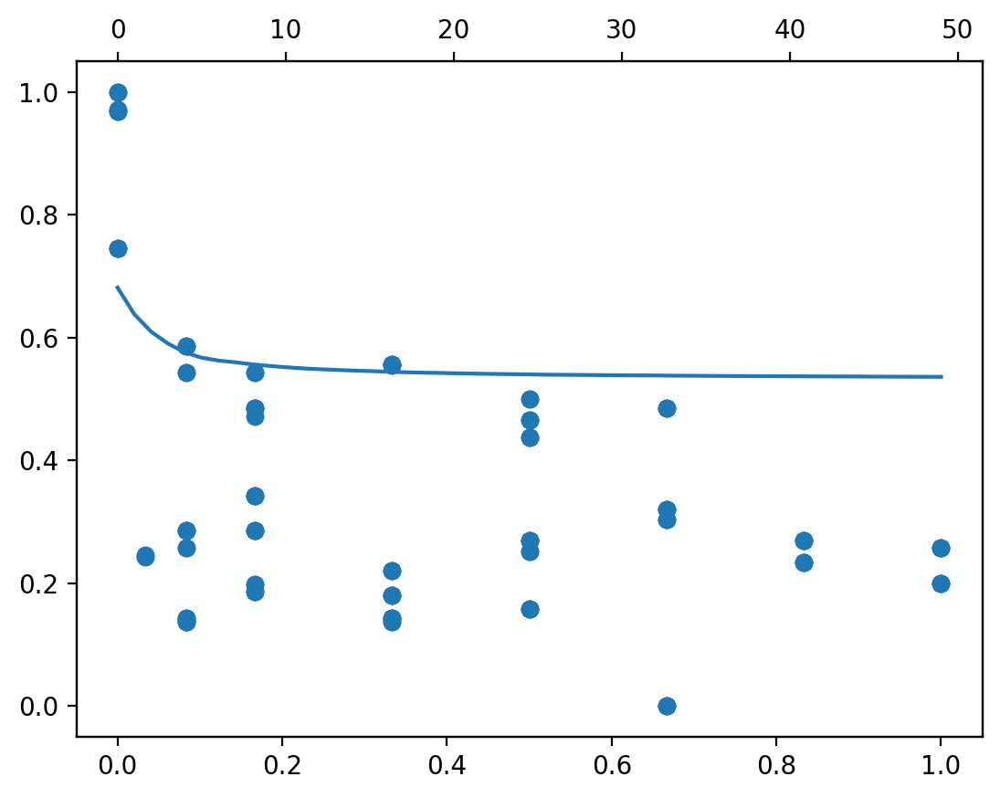

In [1382]:
plt.scatter(features['dis'],features['sph']);
plt.twiny()
plt.plot(history.history['loss']);

In [ ]:
#[:5]: SM,PH (-0.898); ST,PH (+0.814); D,ST (-0.796)

#[5:16]: D,ST (-0.731); SM,PH (-0.620); DIS,ST (-0.586); D,SM (-0.522)

#[16:31]: D,ST (-0.777); D,SM (-0.692); DIS,ST (-0.612); SM,PH (-0.608)

#[31:]: D,ST (-0.798); SM,PH (-0.793); D,SM (-0.770);

#>>> SM PH 4 (-0.898--0.608)
#>>> ST PH 1 (0.814)*
#####################>>> D ST 4 (-0.798--0.731)
#>>> DIS ST 2 (-0.612--0.586)
####################>>> D SM 3 (-0.770--0.522)

#========

################ D SM (-0.551)
################ D ST (-0.682)
# SM PH (-0.671)

In [ ]:
from statsmodels.tsa.statespace.varmax import VARMAX
from random import random

# def VARMA_model(train,test):
#     # fit model
#     model = VARMAX(train, order=(1, 2))
#     model_fit = model.fit(disp=False)
#     # make prediction
#     yhat = model_fit.forecast(steps=len(test))
#     res=pd.DataFrame({"Pred1":yhat['Act1'], "Pred2":yhat['Act2'], 
#                       "Act1":test["Act1"].values, "Act2":test["Act2"].values})
#     return res

def VARMAX_model(train,test):
    # fit model
    model = VARMAX(train.drop(['Exog','Exog2','Exog3'], axis=1), exog=train['Exog','Exog2','Exog3'], order=(1, 1))
    model_fit = model.fit(disp=False)
    # make prediction
    yhat = model_fit.forecast(steps=len(test),exog=test['Exog','Exog2','Exog3'])
    res=pd.DataFrame({"Pred1":yhat['Act1'], "Pred2":yhat['Act2'], 
            "Act1":test["Act1"].values, "Act2":test["Act2"].values, "Exog":test["Exog"].values, "Exog2":test["Exog2"].values, "Exog3":test["Exog3"].values})
    return res

In [ ]:
cols=without_outliers.columns.tolist()
indices=[0,1,2,3,4]
dist=np.array([without_outliers[np.take(cols, indices[i]).tolist()]for i in range(len(indices))])[0].tolist()
dep=np.array([without_outliers[np.take(cols, indices[i]).tolist()]for i in range(len(indices))])[1]
st=np.array([without_outliers[np.take(cols, indices[i]).tolist()]for i in range(len(indices))])[2]
sm=np.array([without_outliers[np.take(cols, indices[i]).tolist()]for i in range(len(indices))])[3]
ph=np.array([without_outliers[np.take(cols, indices[i]).tolist()]for i in range(len(indices))])[4]

In [ ]:
dist=np.interp(np.linspace(0, len(dist), 3200), np.arange(len(dist)), dist)
dep=np.interp(np.linspace(0, len(dep), 3200), np.arange(len(dep)), dep)
st=np.interp(np.linspace(0, len(st), 3200), np.arange(len(st)), st)
sm=np.interp(np.linspace(0, len(sm), 3200), np.arange(len(sm)), sm)
ph=np.interp(np.linspace(0, len(ph), 3200), np.arange(len(ph)), ph)

In [ ]:
import warnings
warnings.simplefilter('ignore')

# Common code for display result
def show_graph(df1,df2,title):
    data = pd.concat([df1, df2])
    data.reset_index(inplace=True, drop=True)
    for col in data.columns:
        if col.lower().startswith('pred'):
            data[col].plot(label=col,linestyle="dotted")
        else:
            data[col].plot(label=col)
    plt.title(title)
    plt.legend()
    plt.show()

In [ ]:
df_train = pd.DataFrame({'Act1':ph[:700],
                         'Act2':sm[:700]})
                         #'Exog':dist[:31],
                         #'Exog2':dep[:31],
                         #'Exog3':st[:31]})
df_test = pd.DataFrame({'Act1':ph[700:],
                        'Act2':sm[700:]})
                        #'Exog':dist[31:],
                        #'Exog2':dep[31:],
                        #'Exog3':st[31:]})
df_ret = VARMA_model(df_train, df_test)
show_graph(df_train, df_ret, "Vector Autoregression Moving-Average (VARMA)")

In [ ]:
df_ret

In [ ]:
df_train = pd.DataFrame({'Act1':ph[:700],
                         'Act2':sm[:700],
                         'Exog':dist[:700],
                         'Exog2':dep[:700],
                         'Exog3':st[:700]})
df_test = pd.DataFrame({'Act1':ph[700:],
                        'Act2':sm[700:],
                        'Exog':dist[700:],
                        'Exog2':dep[700:],
                        'Exog3':st[700:]})
df_ret = VARMA_model(df_train, df_test)
show_graph(df_train, df_ret, "Vector Autoregression Moving-Average (VARMA)")

In [ ]:
df_ret

In [1350]:
from numpy.polynomial import Chebyshev
from numpy.polynomial.chebyshev import chebfit
#np.polyfit(without_outliers['dist'][5:16],without_outliers['st'][5:16],1)
Chebyshev.fit(without_outliers['dis'],without_outliers['sot'], deg=1)
#chebfit(without_outliers['dist'][5:16],without_outliers['st'][5:16], deg=1)

Chebyshev([ 0.3422208 , -0.21108453], domain=[0., 1.], window=[-1.,  1.], symbol='x')

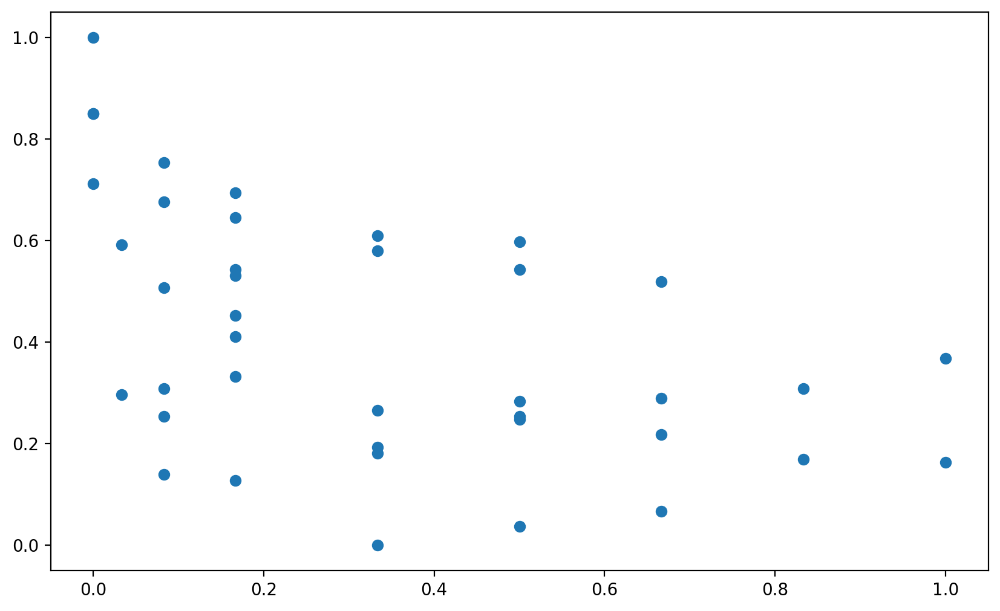

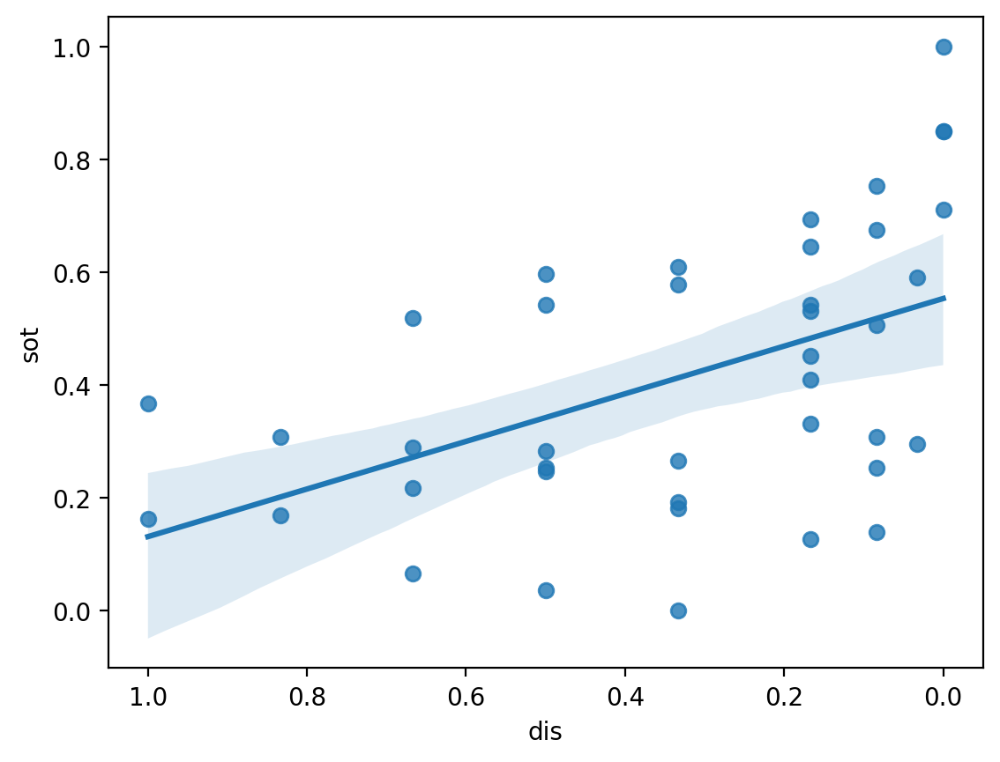

In [1351]:
plt.figure(figsize=(10,6),dpi=100)
# plt.scatter(without_outliers['dist'][:5],without_outliers['st'][:5])
# np.polyfit(without_outliers['dist'][:5],without_outliers['st'][:5],1)
plt.scatter(without_outliers['dis'],without_outliers['sot'])
np.polyfit(without_outliers['dis'],without_outliers['sot'],1)
plt.show()

# plot 1 with axes level-plot
#ax = sns.regplot(data=without_outliers[:][:5], x='dist', y='st').invert_xaxis()
sns.regplot(data=without_outliers[:], x='dis', y='sot').invert_xaxis()

# plot 2 corresponding figure-level plot
#g = sns.lmplot(data=penguins, x="bill_length_mm", y="bill_depth_mm")